In [2]:
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from pandas import Series, DataFrame
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
#import pydotplus
#import matplotlib as plt

In [3]:
df = pd.read_csv('network_backup_dataset.csv', header = 0) 

In [4]:
df.columns

Index(['Week #', 'Day of Week', 'Backup Start Time - Hour of Day',
       'Work-Flow-ID', 'File Name', 'Size of Backup (GB)',
       'Backup Time (hour)'],
      dtype='object')

In [17]:
df.head()

,Week #,Day of Week,Backup Start Time - Hour of Day,Work-Flow-ID,File Name,Size of Backup (GB),Backup Time (hour)
0,1,Monday,1,work_flow_0,File_0,0.0,0
1,1,Monday,1,work_flow_2,File_12,0.0,0
2,1,Monday,1,work_flow_2,File_13,0.0,0
3,1,Monday,1,work_flow_2,File_14,0.0,0
4,1,Monday,1,work_flow_2,File_16,0.0,0


In [94]:
di = {"Monday": 1, "Tuesday": 2, "Wednesday": 3, "Thursday": 4, "Friday": 5, "Saturday": 6, "Sunday": 7}

df_ = df.replace({"Day of Week": di})


#Map to Day Number
df_['Week_Index'] = df_['Week #'].apply(lambda x: 7*(x-1))
df_['Day_Number'] = df_['Week_Index'] + df_['Day of Week']


#Take data for first 20 days
df_ = df_[df_['Day_Number'] < 106]

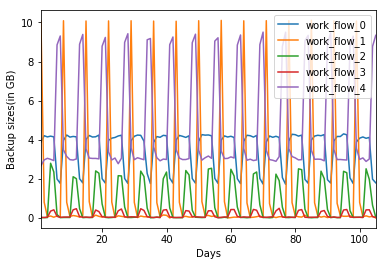

In [95]:
fig, ax = plt.subplots()
labels = []

for workflow_ids, workflow_grps in df_.groupby('Work-Flow-ID'):
   
   ax = workflow_grps.groupby('Day_Number').sum().plot(ax = ax, kind = 'line', y = 'Size of Backup (GB)')
   labels.append(workflow_ids)
   
   lines, _ = ax.get_legend_handles_labels()

   plt.xlabel('Days')
   plt.ylabel('Backup sizes(in GB)')

   ax.legend(lines, labels, loc='upper right')

plt.show()

In [96]:
di = {"Monday": 1, "Tuesday": 2, "Wednesday": 3, "Thursday": 4, "Friday": 5, "Saturday": 6, "Sunday": 7}

df105 = df.replace({"Day of Week": di})


#Map to Day Number
df105['Week_Index'] = df105['Week #'].apply(lambda x: 7*(x-1))
df105['Day_Number'] = df105['Week_Index'] + df105['Day of Week']


#Take data for first 105 days
df105 = df105[df105['Day_Number'] < 105]

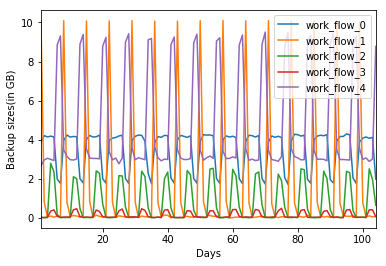

In [97]:
fig, ax = plt.subplots()
labels = []

for workflow_ids, workflow_grps in df105.groupby('Work-Flow-ID'):
   
   ax = workflow_grps.groupby('Day_Number').sum().plot(ax = ax, kind = 'line', y = 'Size of Backup (GB)')
   labels.append(workflow_ids)
   
   lines, _ = ax.get_legend_handles_labels()

   plt.xlabel('Days')
   plt.ylabel('Backup sizes(in GB)')

   ax.legend(lines, labels, loc='upper right')

plt.show()

## Function for Linear Regression

In [9]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.neighbors import KNeighborsRegressor

def getModel(modelName, arg=None):
    model = None
    if modelName == 'LinearRegression':
        model = LinearRegression()
        
    if modelName == 'Ridge':
        model = Ridge(alpha=arg[0])
        
    if modelName == 'Lasso':
        model = Lasso(alpha=arg[0])
        
    if modelName == 'ElasticNet':
        model = ElasticNet(alpha=arg[0], l1_ratio=arg[1])
        
    if modelName == 'RandomForestRegressor':
        model = RandomForestRegressor(n_estimators=arg[0], max_depth=arg[1], max_features=arg[2], oob_score=True)
    
    if modelName == 'MLPRegressor':
        model = MLPRegressor(activation=arg[0], alpha=1e-5, hidden_layer_sizes=(arg[1],), random_state=1)
        
    if modelName == 'KNeighborsRegressor':
        model = KNeighborsRegressor(n_neighbors=arg[0])
        
        
    return model

In [80]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from math import sqrt
from sklearn.metrics import mean_squared_error
import sys

def regression(X, y, modelName, plot=True, arg=None, verbose=True):
      
    kf = KFold(n_splits=10, shuffle=True)
    
    trainMSE = list()
    testMSE = list()
    
    bestModel = None
    bestMSE = float(sys.maxsize)
    
    for train_index, test_index in kf.split(X):
        model = getModel(modelName, arg)
            
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

        model.fit(X_train, y_train)
        predictionTest = model.predict(X_test)
        predictionTrain = model.predict(X_train)
        
        train_mse = mean_squared_error(y_train, predictionTrain)
        test_mse = mean_squared_error(y_test, predictionTest)

        if test_mse < bestMSE:
            bestMSE = test_mse
            bestModel = model

        trainMSE.append(train_mse)
        testMSE.append(test_mse)

    trainRMSE = sqrt(sum(trainMSE) / len(trainMSE))
    testRMSE = sqrt(sum(testMSE) / len(testMSE))
    if verbose:
        print("Training MSE for each fold : ", trainMSE, "\n\n")
        print("Testing MSE for each fold : ", testMSE, "\n\n")
        print("Training RMSE:",trainRMSE)
        print("Testing RMSE:",testRMSE)
    
    bestModel = getModel(modelName, arg)
    bestModel.fit(X, y)
    prediction = bestModel.predict(X)
    
    if plot:
        plt.plot(prediction, 'rx', markersize=1, label="Fitted Values" )
        plt.plot(y, 'bo', markersize=1, label = "True Values")
        plt.xlabel('Number of Data Points')
        plt.ylabel("Backup Size (GB)")
        plt.legend()
        plt.title('Fitted Values vs True Values')
        plt.show()

        residual = y - prediction
        plt.plot(residual,'rx', markersize=1, label="Residual")
        plt.plot(prediction,'bo', markersize=1, label="Fitted Values")
        plt.title('Residual vs Fitted Values')
        plt.xlabel('Number of Data Points')
        plt.ylabel("Backup Size (GB)")
        plt.legend()
        plt.show()
    
        plt.plot(prediction, y, 'bo', markersize=1)
        plt.title('Fitted Values vs True Values')
        plt.xlabel('Fitted Values')
        plt.ylabel('True Values')
        plt.show()
    
        plt.plot(prediction, residual, 'ro', markersize=1)
        plt.title('Residual vs Fitted Values')
        plt.xlabel('Fitted Values')
        plt.ylabel('Residuals')
        plt.show()
    
    return trainRMSE, testRMSE, prediction

In [33]:
from sklearn.preprocessing import LabelEncoder

def labelEncoder(data):
    le = LabelEncoder()
    
    for col in range(data.shape[1]):
        print(type(data[0,col]))
        if type(data[0,col]) == 'int64':
            continue
        else:
            encodedCol = le.fit_transform(data[:, col])
            data[:, col] = encodedCol
            print(le.classes_)
        
    data = data.astype('float')
    
    return data

## 2(a)(i)

('Training MSE for each fold : ', [0.010200172743727365, 0.010487346529481616, 0.010553533160502808, 0.010507987294689526, 0.01034953878805967, 0.010248091417052112, 0.01040914942873887, 0.010449368469935735, 0.01035867995358952, 0.01014493211159167], '\n\n')
('Testing MSE for each fold : ', [0.011919042554586104, 0.009331717494267758, 0.008735152401106849, 0.009143036193366524, 0.010567928408179389, 0.011488333268883084, 0.010038626395091899, 0.009670208052079587, 0.010487970961115029, 0.012412047525860127], '\n\n')
('Training RMSE:', 0.10183751759414056)
('Testing RMSE:', 0.10187937144217978)


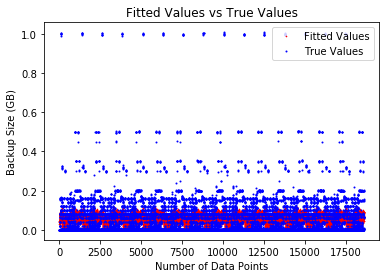

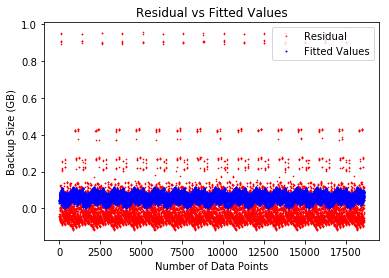

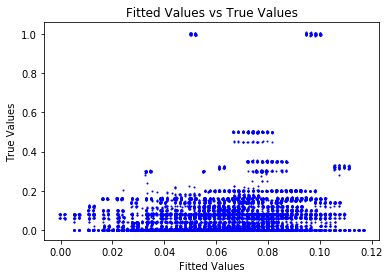

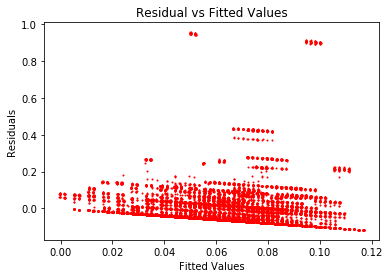

In [99]:
from sklearn.preprocessing import LabelEncoder

scalarEncodedDF = df.copy(deep=True)
del scalarEncodedDF['Backup Time (hour)']

scalarEncodedMatrix = scalarEncodedDF.as_matrix()

scalarEncX = scalarEncodedMatrix[:, 0 : scalarEncodedMatrix.shape[1] - 1]
scalarEncy = scalarEncodedMatrix[:, scalarEncodedMatrix.shape[1] - 1].astype('float')

#label encode the entire dataset
scalarEncX = labelEncoder(scalarEncX)

scalarEncTrainRMSE, scalarEncTestRMSE, scalarPred = regression(scalarEncX, scalarEncy, modelName='LinearRegression')

## 2(a)(ii)

('Training MSE for each fold : ', [0.010511645023526032, 0.010463760058099464, 0.010458667187262433, 0.010528509861329026, 0.010368206009844215, 0.01049456468010886, 0.010107011495347477, 0.010134458175936445, 0.010373080415304832, 0.010270111532247968], '\n\n')
('Testing MSE for each fold : ', [0.009110493103125193, 0.009539658363234428, 0.009586492750192403, 0.008958202448640021, 0.010402074226991815, 0.009264910661378562, 0.012755344700834701, 0.012510105263889282, 0.01035850372916768, 0.011284265913943462], '\n\n')
('Training RMSE:', 0.101838113905849)
('Testing RMSE:', 0.1018675861898168)


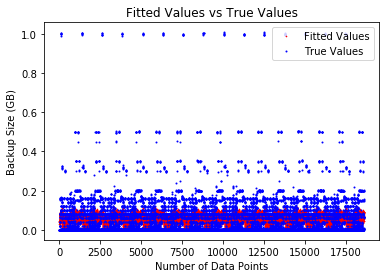

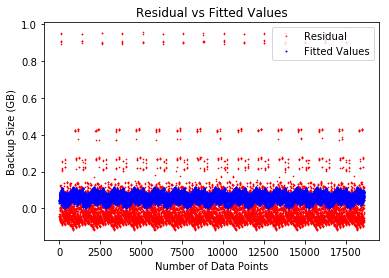

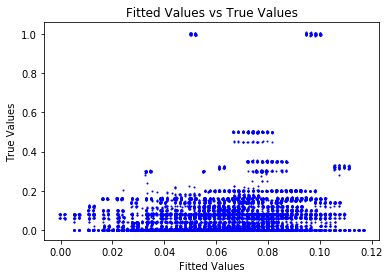

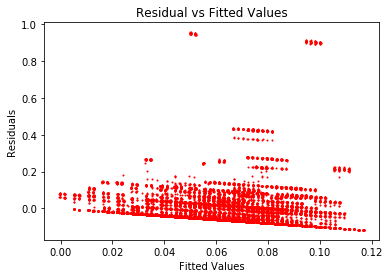

In [100]:
from sklearn.preprocessing import StandardScaler

standardizedDF = df.copy(deep = True)
del standardizedDF['Backup Time (hour)']

standardizedMatrix = standardizedDF.as_matrix()

standardizedX = standardizedMatrix[:, 0 : standardizedMatrix.shape[1] - 1]
standardizedy = standardizedMatrix[:, standardizedMatrix.shape[1] - 1].astype('float')

standardizedX = labelEncoder(standardizedX)
scaler = StandardScaler()
standardizedX = scaler.fit_transform(standardizedX)

standardizedTrainRMSE, standardizedTestRMSE, standardizedPred = regression(standardizedX, standardizedy, modelName='LinearRegression')

## 2(a)(iii)

In [34]:
from sklearn.feature_selection import f_regression
from sklearn.feature_selection import mutual_info_regression
from sklearn.feature_selection import SelectKBest

fSelectionDF = df.copy(deep = True)
del fSelectionDF['Backup Time (hour)']

fSelectionMatrix = fSelectionDF.as_matrix()

fSelX = fSelectionMatrix[:, 0 : fSelectionMatrix.shape[1] - 1]
fSely = fSelectionMatrix[:, fSelectionMatrix.shape[1] - 1].astype('float')

fSelX = labelEncoder(fSelX)
print(fSelectionDF.dtypes)
#f_Regression results
print("Feature Selection Using f Regression")

#X_fRegression = SelectKBest(mutual_info_regression, k=3).fit_transform(fSelX, fSely)

# print fSelX[0:5]

K_best_model = SelectKBest(f_regression, k=3)
X_fRegression = K_best_model.fit_transform(fSelX, fSely)
print(K_best_model.get_support())
# print(X_fRegression[0:5])

print ('***************')
print (K_best_model.scores_)
print ('***************')

fRegressionTrainRMSE, fRegressionTestRMSE, fRegressionPred = regression(X_fRegression, fSely, modelName='LinearRegression')

#mutual_info_regression results
print("Feature Selection Using Mutual Info Regression")

#X_mutualInfo = SelectKBest(mutual_info_regression, k=3).fit_transform(fSelX, fSely)

K_best_model = SelectKBest(mutual_info_regression, k=3)
X_mutualInfo = K_best_model.fit_transform(fSelX, fSely)

# print X_mutualInfo[0:5]

print ('***************')
print (K_best_model.scores_)
print ('***************')

mutualInfoTrainRMSE, mutualInfoTestRMSE, mutualInfoPred = regression(X_mutualInfo, fSely, modelName='LinearRegression')


<class 'type'>
<class 'int'>
[1 2 3 4 5 6 7 8 9 10 11 12 13 14 15]
<class 'type'>
<class 'int'>
['Friday' 'Monday' 'Saturday' 'Sunday' 'Thursday' 'Tuesday' 'Wednesday']
<class 'type'>
<class 'int'>
[1 5 9 13 17 21]
<class 'type'>
<class 'int'>
['work_flow_0' 'work_flow_1' 'work_flow_2' 'work_flow_3' 'work_flow_4']
<class 'type'>
<class 'int'>
['File_0' 'File_1' 'File_10' 'File_11' 'File_12' 'File_13' 'File_14'
 'File_15' 'File_16' 'File_17' 'File_18' 'File_19' 'File_2' 'File_20'
 'File_21' 'File_22' 'File_23' 'File_24' 'File_25' 'File_26' 'File_27'
 'File_28' 'File_29' 'File_3' 'File_4' 'File_5' 'File_6' 'File_7' 'File_8'
 'File_9']
Week #                               int64
Day of Week                         object
Backup Start Time - Hour of Day      int64
Work-Flow-ID                        object
File Name                           object
Size of Backup (GB)                float64
dtype: object
Feature Selection Using f Regression
[False  True  True False  True]
***************
[8

NameError: name 'regression' is not defined

## 2(a)(iv)

('\n\nCombination: ', '00000', '\tShape of X: ', (18588, 5))
('Training MSE for each fold : ', [0.010219398117829065, 0.010402613254301191, 0.010400116410064211, 0.010335833565159557, 0.010386967278000566, 0.010407502574657035, 0.010296414200639955, 0.010368198933078963, 0.010356417770015612, 0.01053660617371298], '\n\n')
('Testing MSE for each fold : ', [0.011739137878720855, 0.010090754197986858, 0.010115947794897369, 0.01069149124661203, 0.010232301626307467, 0.01004816927968533, 0.011049076404010318, 0.010404802038693973, 0.010509154840805442, 0.008886759507365484], '\n\n')
('Training RMSE:', 0.10183814033919666)
('Testing RMSE:', 0.10186638052619967)


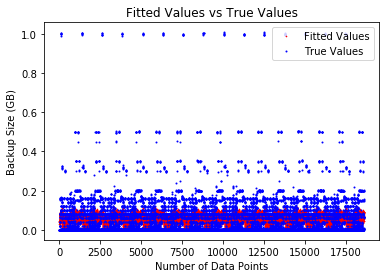

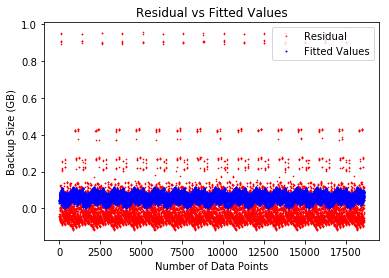

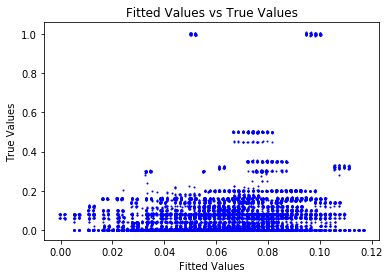

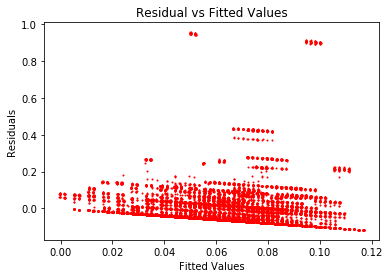

('\n\nCombination: ', '00001', '\tShape of X: ', (18588, 34))
('Training MSE for each fold : ', [0.008133292678848386, 0.0084173906338577, 0.008375892858115316, 0.00825655829009463, 0.008226512258933378, 0.008127110636898215, 0.008483558447879977, 0.008063349215780563, 0.008108444727691512, 0.008241340687501987], '\n\n')
('Testing MSE for each fold : ', [0.009275118954650682, 0.006709904863530531, 0.007082334998840726, 0.008149865725103064, 0.008433140443160252, 0.009315113069138266, 0.006109784572439023, 0.009910501609931475, 0.009496942695711606, 0.00829412821280174], '\n\n')
('Training RMSE:', 0.09079286890257497)
('Testing RMSE:', 0.09098177572750894)


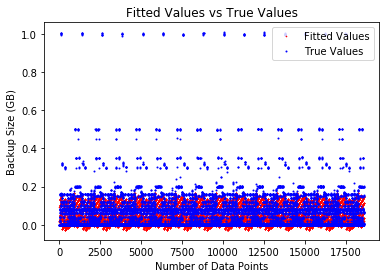

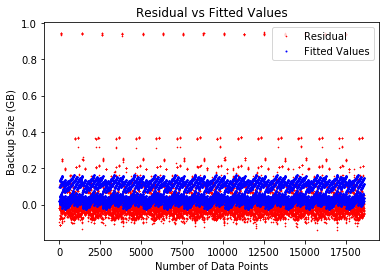

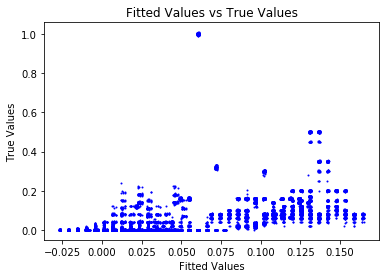

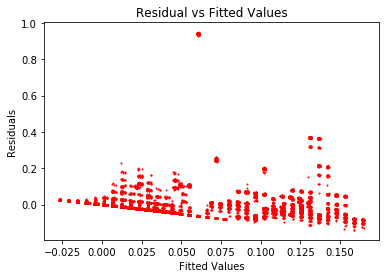

('\n\nCombination: ', '00010', '\tShape of X: ', (18588, 9))
('Training MSE for each fold : ', [0.008170889085182306, 0.00832476841078719, 0.008185409438785532, 0.008318362219939498, 0.008346542640877594, 0.008192138885577354, 0.007970567838567021, 0.008092739547608556, 0.008376811101888556, 0.00847010488882322], '\n\n')
('Testing MSE for each fold : ', [0.008921520898522278, 0.0075307639680885375, 0.00878796297388363, 0.007590046472813289, 0.007336421930241972, 0.008728312939905516, 0.01072538783944537, 0.009622041527638472, 0.007063929374693833, 0.006226255600485005], '\n\n')
('Training RMSE:', 0.0908010650036864)
('Testing RMSE:', 0.09084747851521137)


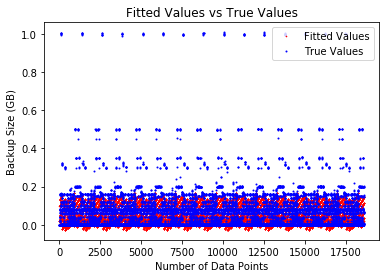

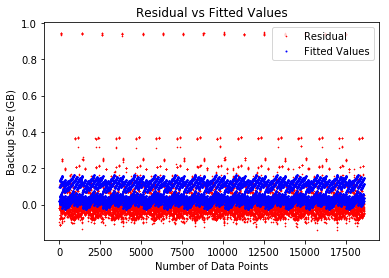

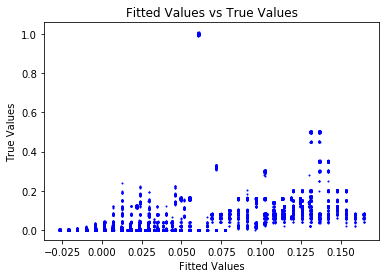

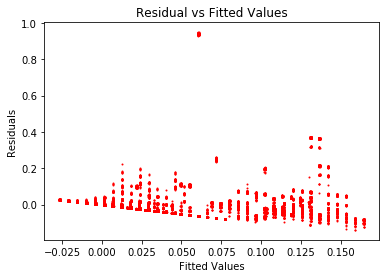

('\n\nCombination: ', '00011', '\tShape of X: ', (18588, 38))
('Training MSE for each fold : ', [0.008016891000876531, 0.008191201893093705, 0.008418032200972888, 0.00809098719029829, 0.007973473560461483, 0.008375693123973134, 0.008400211397942614, 0.008440028763376036, 0.0080531525888282, 0.0084784398573088], '\n\n')
('Testing MSE for each fold : ', [0.010309101307241513, 0.008740249536007001, 0.006699717095058786, 0.0096424635804693, 0.01071063670958961, 0.007078342338619541, 0.006858968562468553, 0.0065029091095407205, 0.009986575161626177, 0.006157855550757049], '\n\n')
('Training RMSE:', 0.09079543577577658)
('Testing RMSE:', 0.09093229291697107)


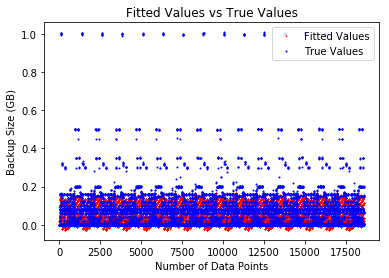

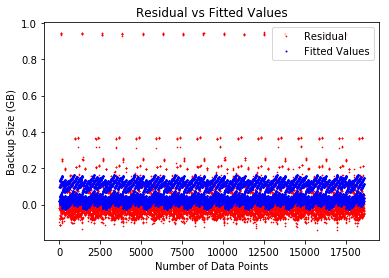

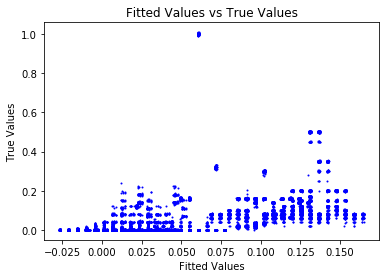

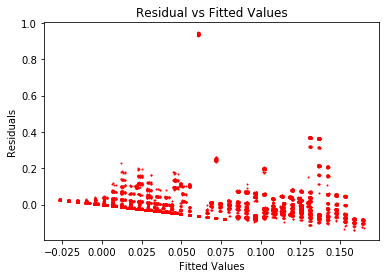

('\n\nCombination: ', '00100', '\tShape of X: ', (18588, 10))
('Training MSE for each fold : ', [0.010321581196690133, 0.01015348431087535, 0.0103771104599822, 0.010070087066251308, 0.009876652534202255, 0.010132770424387273, 0.010250897586840666, 0.009761205296424168, 0.010124642163667433, 0.010110208875842554], '\n\n')
('Testing MSE for each fold : ', [0.008295897961337985, 0.009809756924646145, 0.007804770282132546, 0.010560879797368555, 0.012305996533896146, 0.00999642079196302, 0.008937742910590461, 0.013350175391589109, 0.010079769425437935, 0.010197613457428003], '\n\n')
('Training RMSE:', 0.10058759362623372)
('Testing RMSE:', 0.10066728538924148)


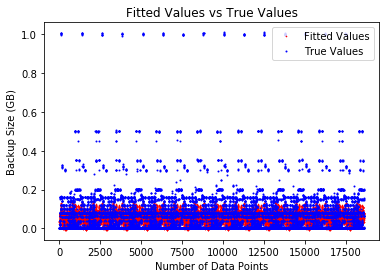

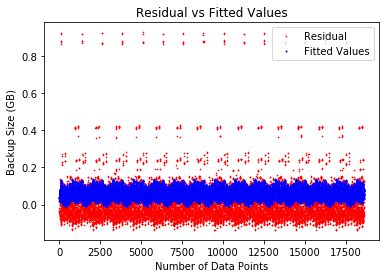

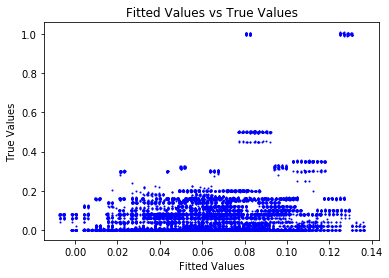

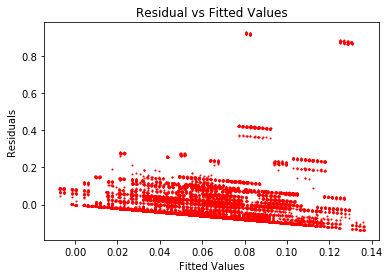

('\n\nCombination: ', '00101', '\tShape of X: ', (18588, 39))
('Training MSE for each fold : ', [0.00813147341067106, 0.007976969045744074, 0.007997122267563389, 0.007891777510456081, 0.007956233177513032, 0.008066937471245105, 0.007834145917970438, 0.007913853438072375, 0.007989769700008014, 0.00813845226554329], '\n\n')
('Testing MSE for each fold : ', [0.006744692548491843, 0.008135130971629531, 0.007960189761197492, 0.008900236801809843, 0.008316020512874792, 0.007321626882618956, 0.009416421879306323, 0.008697879509762274, 0.008024009415143257, 0.006685091938626466], '\n\n')
('Training RMSE:', 0.08938497312456209)
('Testing RMSE:', 0.08955517864504586)


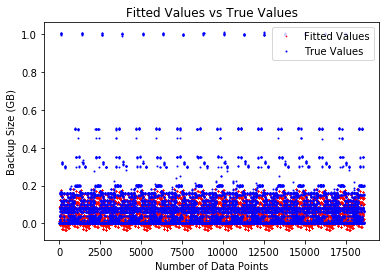

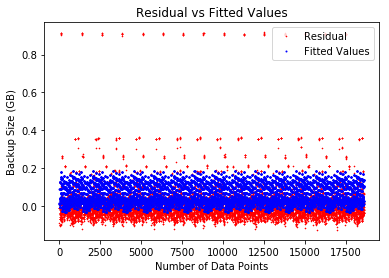

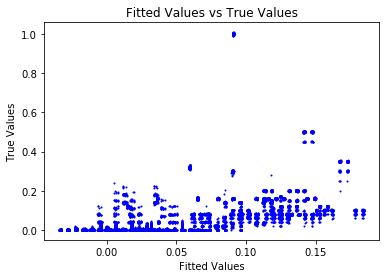

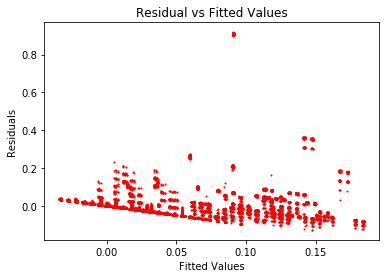

('\n\nCombination: ', '00110', '\tShape of X: ', (18588, 14))
('Training MSE for each fold : ', [0.008084943592970932, 0.008205519686433502, 0.008003404473959464, 0.008008405471869744, 0.008194969022828708, 0.008059969664075338, 0.007772232692481978, 0.0075472675620044645, 0.007921955423954593, 0.008106556415098156], '\n\n')
('Testing MSE for each fold : ', [0.007151477097409543, 0.006075652585280663, 0.007890121535918313, 0.007841391931937086, 0.006165772107112548, 0.007379918933122175, 0.009980988707970456, 0.01201610983808913, 0.008620883814171875, 0.006960205973750532], '\n\n')
('Training RMSE:', 0.08938972200744158)
('Testing RMSE:', 0.0894888387033614)


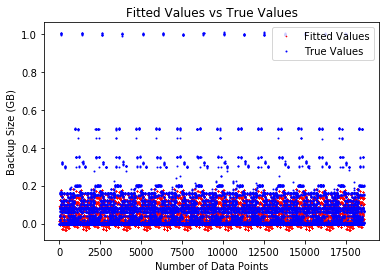

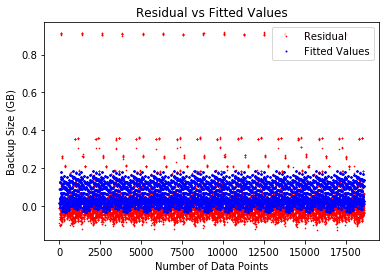

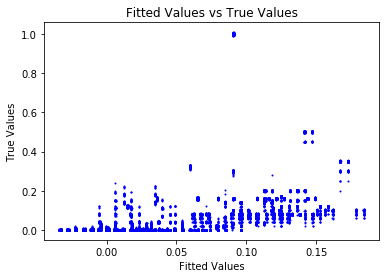

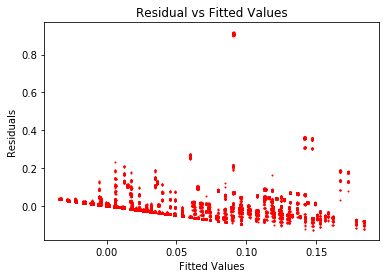

('\n\nCombination: ', '00111', '\tShape of X: ', (18588, 43))
('Training MSE for each fold : ', [0.007921729962211856, 0.007855711603260936, 0.008052064731079092, 0.008219134524618275, 0.007999556670808242, 0.0077687379841030945, 0.007857509681613603, 0.007974980536867994, 0.008205566514779505, 0.008042534529764285], '\n\n')
('Testing MSE for each fold : ', [0.008631858901907125, 0.009221045479320747, 0.007452176017358868, 0.005957249678990076, 0.007931398500620067, 0.010012440745830927, 0.009212330526566864, 0.008151947979604751, 0.006074478836056224, 0.007538944516577967], '\n\n')
('Training RMSE:', 0.08938541644983643)
('Testing RMSE:', 0.08954544722253253)


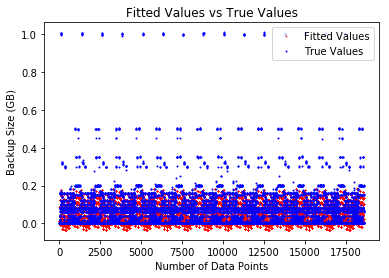

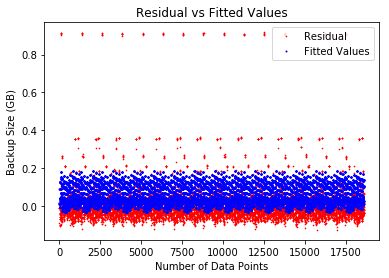

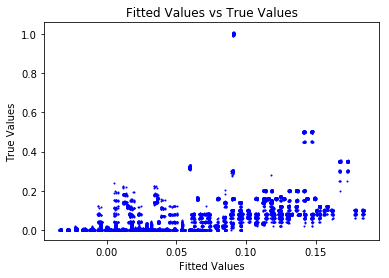

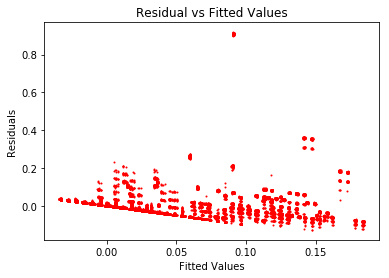

('\n\nCombination: ', '01000', '\tShape of X: ', (18588, 11))
('Training MSE for each fold : ', [0.010264506143862187, 0.010070372815008955, 0.01004347759548031, 0.010238333165746875, 0.01006551412720842, 0.01023157485420417, 0.010246634476024153, 0.010130134071251034, 0.010473324486659, 0.0100247507745543], '\n\n')
('Testing MSE for each fold : ', [0.009417039761123158, 0.011170963740089131, 0.011408549195238756, 0.009653891984160645, 0.011208246061382666, 0.009714267915860223, 0.009579984646034656, 0.010625431673253161, 0.0075425379984594846, 0.011577731170968055], '\n\n')
('Training RMSE:', 0.10089034766021941)
('Testing RMSE:', 0.10094485828736892)


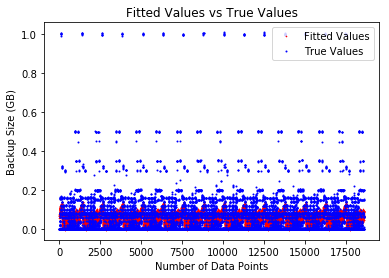

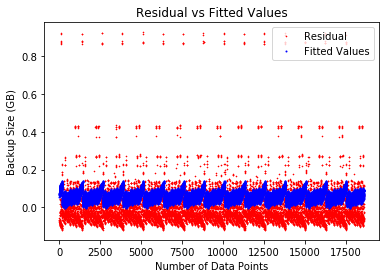

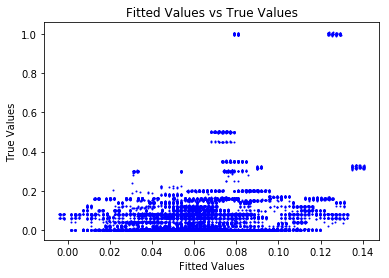

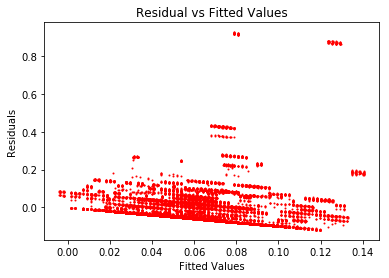

('\n\nCombination: ', '01001', '\tShape of X: ', (18588, 40))
('Training MSE for each fold : ', [0.008062088554713683, 0.007973381413001105, 0.007941329256806087, 0.007964161578547176, 0.008194994836152674, 0.007811266481397485, 0.008224417986489832, 0.008208973618813724, 0.008134123880957685, 0.008039271094663594], '\n\n')
('Testing MSE for each fold : ', [0.008026999303374215, 0.008827911342628952, 0.009122649484802887, 0.008911729799686767, 0.006827780540205042, 0.010293062206760085, 0.006569485315493369, 0.006702062513317263, 0.007377411080274079, 0.008245104979189748], '\n\n')
('Training RMSE:', 0.08975188505070134)
('Testing RMSE:', 0.08994676012271503)


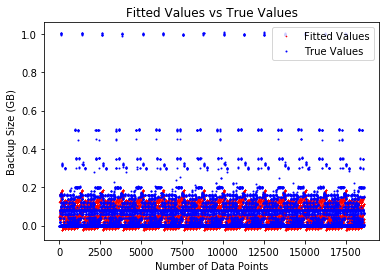

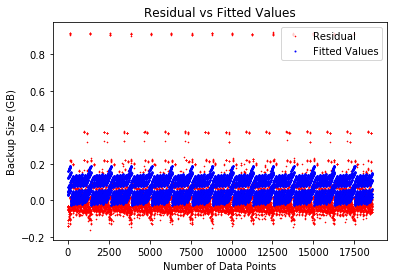

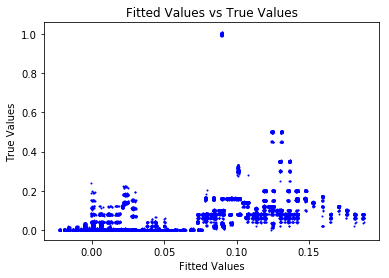

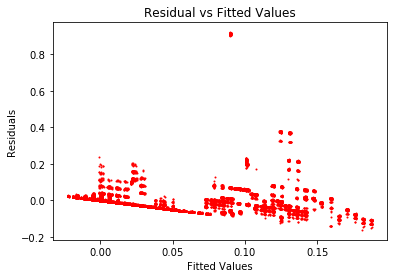

('\n\nCombination: ', '01010', '\tShape of X: ', (18588, 15))
('Training MSE for each fold : ', [0.007991406223487697, 0.008032302004144119, 0.007940807734459616, 0.008042847605334882, 0.007898088563784454, 0.008261671915407972, 0.008176801623634503, 0.008143222883760366, 0.007966855619040019, 0.00811351748464905], '\n\n')
('Testing MSE for each fold : ', [0.008654588388001856, 0.008287160263030764, 0.009111353367897486, 0.008193606296472231, 0.00949297948492273, 0.006228231329573699, 0.006986634491833988, 0.007286502393732513, 0.008875930334685029, 0.007557622600368422], '\n\n')
('Training RMSE:', 0.0897594126861928)
('Testing RMSE:', 0.08981904528022926)


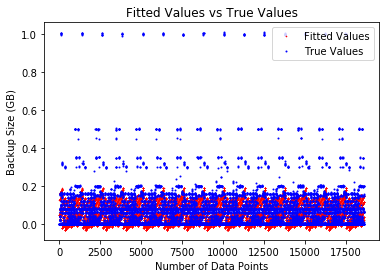

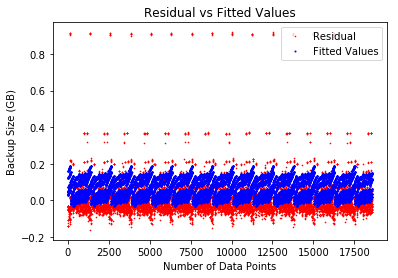

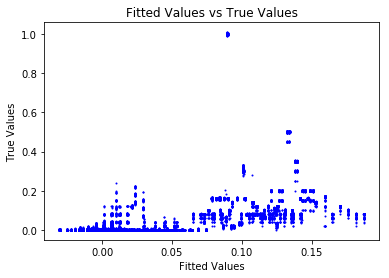

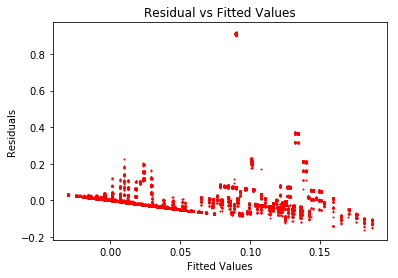

('\n\nCombination: ', '01011', '\tShape of X: ', (18588, 44))
('Training MSE for each fold : ', [0.007956510009660018, 0.008165020744216813, 0.00804312890296279, 0.008064350688075586, 0.008244763362797664, 0.008247076195992874, 0.007927862912081788, 0.007929451953872175, 0.007753035693266402, 0.008221370821191926], '\n\n')
('Testing MSE for each fold : ', [0.008970671831309304, 0.007107378967790178, 0.008200956751064584, 0.008002792538454083, 0.006389631742263611, 0.006363752229083319, 0.00923566499248438, 0.009222264519644101, 0.01083677483542677, 0.006590998402561867], '\n\n')
('Training RMSE:', 0.08975108427429611)
('Testing RMSE:', 0.08995603749058882)


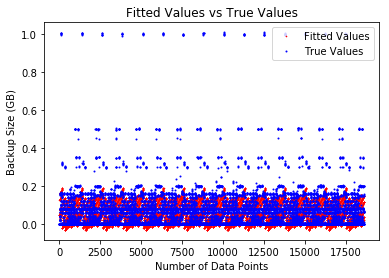

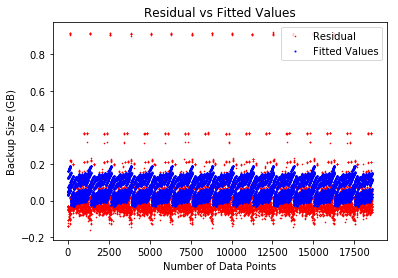

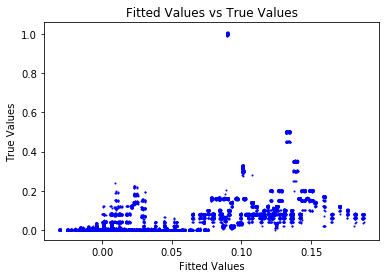

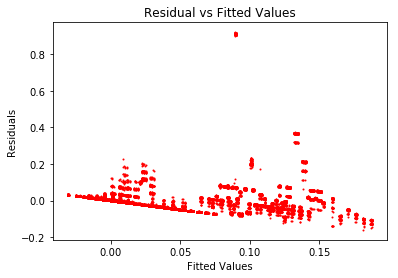

('\n\nCombination: ', '01100', '\tShape of X: ', (18588, 16))
('Training MSE for each fold : ', [0.010019607991113634, 0.009963661906968922, 0.009786649925123046, 0.010045122393142293, 0.010037170047919819, 0.009936300363146699, 0.009855941644504377, 0.009939278240218842, 0.010039699981464959, 0.00965385411729595], '\n\n')
('Testing MSE for each fold : ', [0.009112048613901087, 0.009616948613036504, 0.01121206983786424, 0.008891967620901945, 0.008955583277736536, 0.009864912825350432, 0.010582991951452816, 0.009836869331678247, 0.008930055513097356, 0.012413052707057507], '\n\n')
('Training RMSE:', 0.09963798804216119)
('Testing RMSE:', 0.09970782330994728)


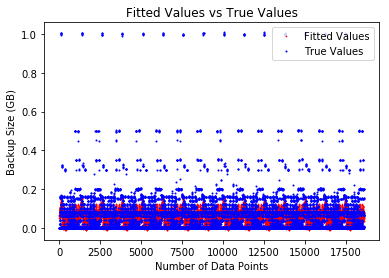

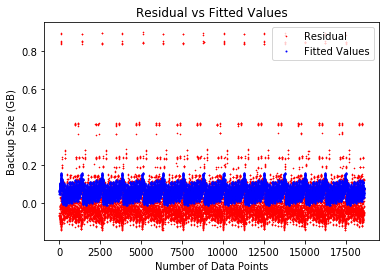

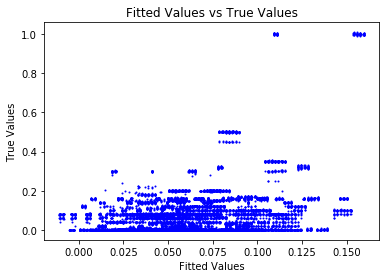

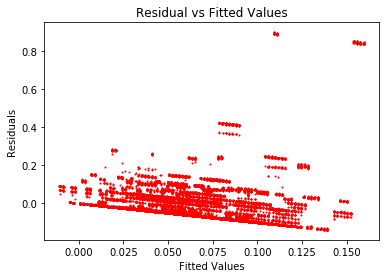

('\n\nCombination: ', '01101', '\tShape of X: ', (18588, 45))
('Training MSE for each fold : ', [0.007937661489446291, 0.0078492114941445, 0.008104735611372194, 0.007820739008034766, 0.00793904338116483, 0.00810895515070769, 0.007533854394218132, 0.00759137176231861, 0.007379356433368846, 0.0077596721449917595], '\n\n')
('Testing MSE for each fold : ', [0.006630514945752521, 0.007424562808275147, 0.005133348888206185, 0.007677585353783823, 0.006619753558098892, 0.005086367467337687, 0.010269076960046135, 0.00974953352154756, 0.011679395736713597, 0.008232266904065724], '\n\n')
('Training RMSE:', 0.08833153506521191)
('Testing RMSE:', 0.08860158358845922)


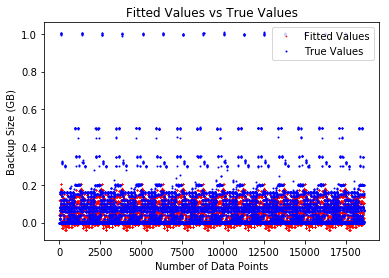

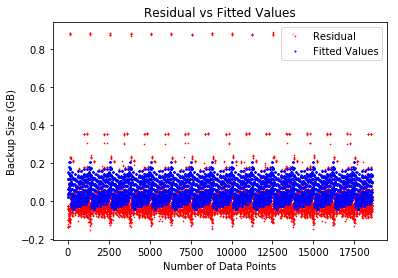

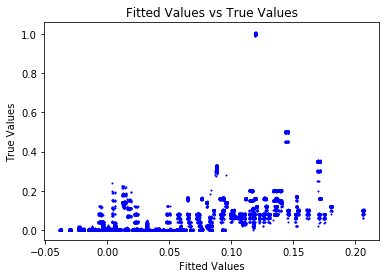

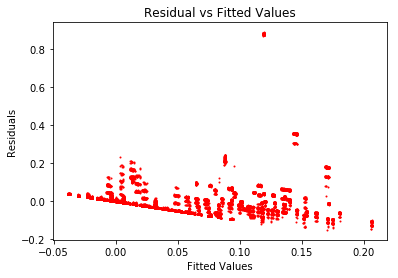

('\n\nCombination: ', '01110', '\tShape of X: ', (18588, 20))
('Training MSE for each fold : ', [0.007748012953752173, 0.007884275907857351, 0.007705733625086536, 0.00785988545586722, 0.007789002440011912, 0.007723082251903067, 0.007781252658067445, 0.007889102144280229, 0.00791360447919987, 0.007745897964470509], '\n\n')
('Testing MSE for each fold : ', [0.008323725443561046, 0.007096751465227977, 0.008705981723918, 0.007314708713913506, 0.007955424704028012, 0.008560002809505696, 0.008025242373185216, 0.007061638746792306, 0.0068494433535806675, 0.008346113549038407], '\n\n')
('Training RMSE:', 0.08834016633474057)
('Testing RMSE:', 0.0884528308663724)


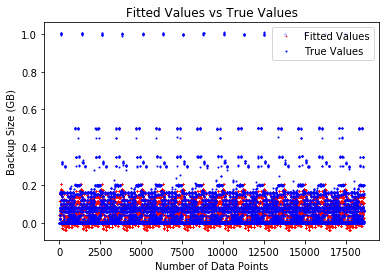

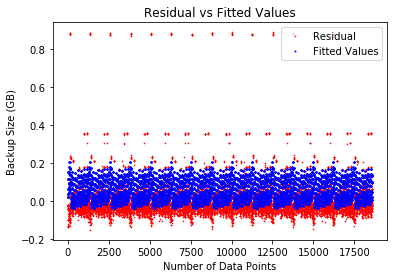

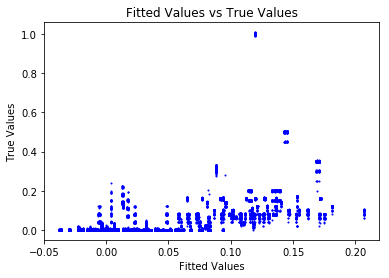

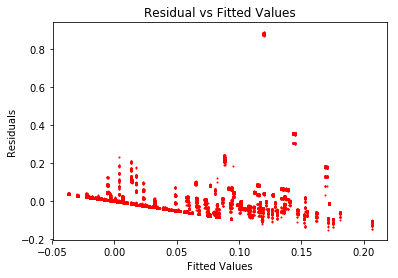

('\n\nCombination: ', '01111', '\tShape of X: ', (18588, 49))
('Training MSE for each fold : ', [0.007325592694270002, 0.00778275256346375, 0.007857803871855971, 0.007876151687659854, 0.00805948532764699, 0.007791203411273207, 0.007861511588470904, 0.007892404541275237, 0.007749984773310365, 0.007823282996277424], '\n\n')
('Testing MSE for each fold : ', [0.012199910753642013, 0.008017350993652405, 0.007361134540089694, 0.007177284459097438, 0.005535337791281526, 0.007947565548448993, 0.0073309850255073705, 0.007034878997391144, 0.008313655310890004, 0.007655370919947906], '\n\n')
('Training RMSE:', 0.08832902889509411)
('Testing RMSE:', 0.08864168000435715)


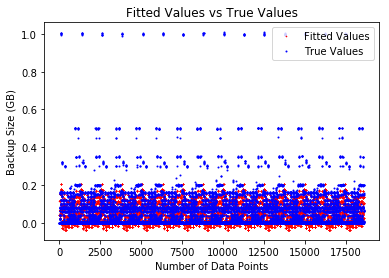

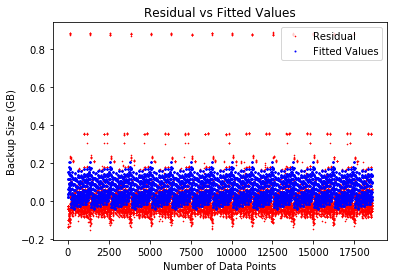

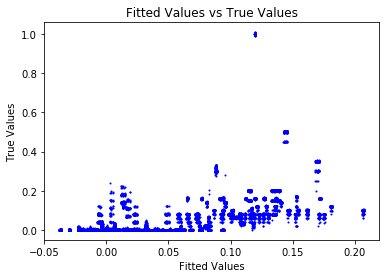

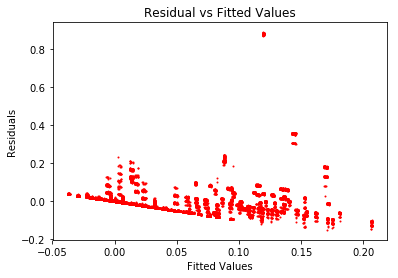

('\n\nCombination: ', '10000', '\tShape of X: ', (18588, 19))
('Training MSE for each fold : ', [0.010408393199623611, 0.010370619339746402, 0.010483415870976062, 0.010080983231193942, 0.010311306036471, 0.010020974131326753, 0.010464212109683202, 0.010427850537227824, 0.010605190733650639, 0.010526548193234142], '\n\n')
('Testing MSE for each fold : ', [0.01005108571729981, 0.010393723621738484, 0.009375751985787842, 0.013009736085952975, 0.010917086448178468, 0.013535479987064867, 0.009549693022409673, 0.009878207524053833, 0.00827080016466551, 0.008982396054555569], '\n\n')
('Training RMSE:', 0.10183294819611852)
('Testing RMSE:', 0.10196271897694129)


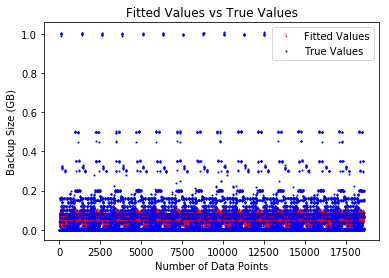

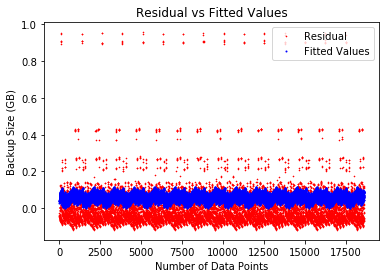

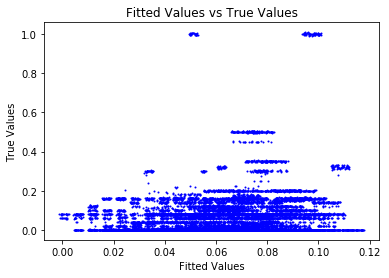

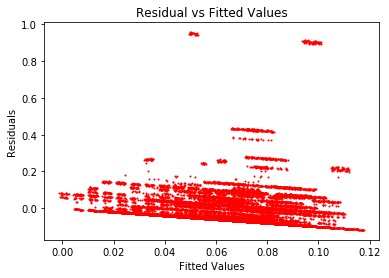

('\n\nCombination: ', '10001', '\tShape of X: ', (18588, 48))
('Training MSE for each fold : ', [0.008332073602867628, 0.008474608560617259, 0.008208962633376254, 0.007945790532374184, 0.007966826736531138, 0.008326866739289668, 0.008263773753767417, 0.00813108275035991, 0.008475481485059458, 0.008305598147806981], '\n\n')
('Testing MSE for each fold : ', [0.007474834544205157, 0.006199649823231296, 0.008588304048828608, 0.010961024442047206, 0.010776013490854304, 0.007524477583350462, 0.008096708820960667, 0.009280469599652461, 0.006186277643972945, 0.007715816204875755], '\n\n')
('Training RMSE:', 0.09079155519212671)
('Testing RMSE:', 0.09099647037219569)


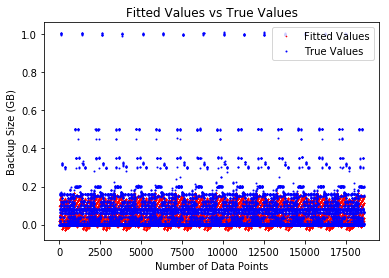

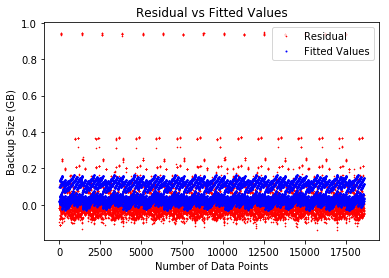

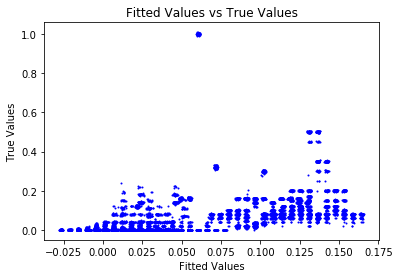

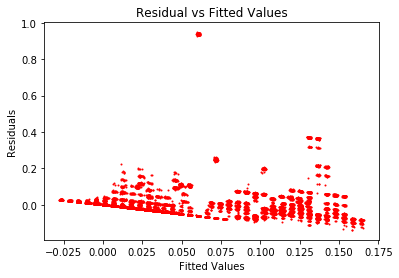

('\n\nCombination: ', '10010', '\tShape of X: ', (18588, 23))
('Training MSE for each fold : ', [0.00802912156883556, 0.00795678908362997, 0.008334121805667977, 0.008246162855205033, 0.008184357549578533, 0.008302936975627534, 0.008504107502252915, 0.00820713153197907, 0.008352874871124207, 0.008325741926887755], '\n\n')
('Testing MSE for each fold : ', [0.010199948868004828, 0.010853496331953191, 0.007454624410420758, 0.008255715040799886, 0.008800860440566272, 0.007733630352846077, 0.005925311538086803, 0.008598998176218498, 0.007278546160437412, 0.007534904966755285], '\n\n')
('Training RMSE:', 0.0907983180850772)
('Testing RMSE:', 0.09090436528907124)


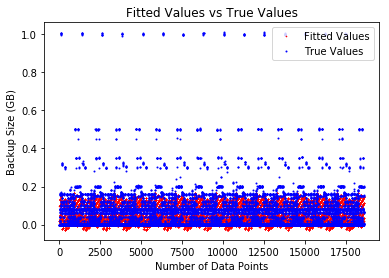

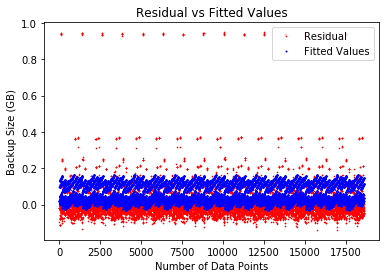

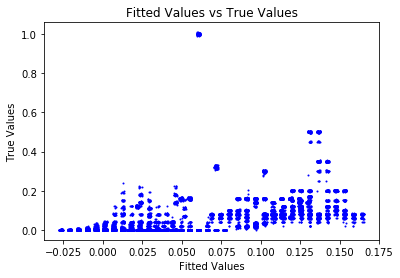

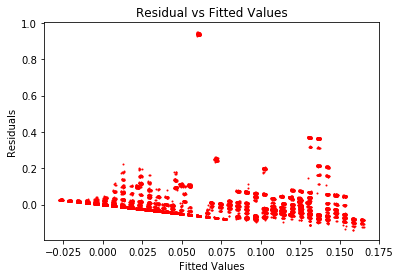

('\n\nCombination: ', '10011', '\tShape of X: ', (18588, 52))
('Training MSE for each fold : ', [0.008287738071065162, 0.008143859778416302, 0.008318226159643685, 0.008277212470656447, 0.008229144555128411, 0.008530430524562, 0.008155624700153163, 0.008150717797788112, 0.008072266998940071, 0.008261681244647113], '\n\n')
('Testing MSE for each fold : ', [0.00788034130154461, 0.009175936267034269, 0.007606982098149557, 0.007971011234029539, 0.008405395308817572, 0.005702601188506107, 0.009068021709780877, 0.00911843767277136, 0.009832643751256174, 0.008122888023953272], '\n\n')
('Training RMSE:', 0.09078926274675903)
('Testing RMSE:', 0.09104079226140517)


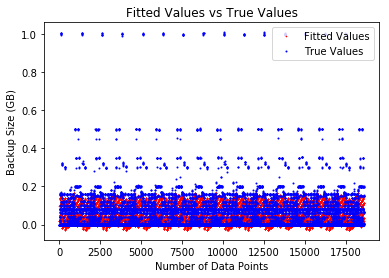

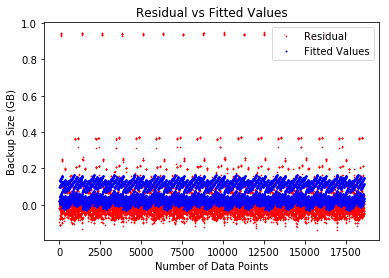

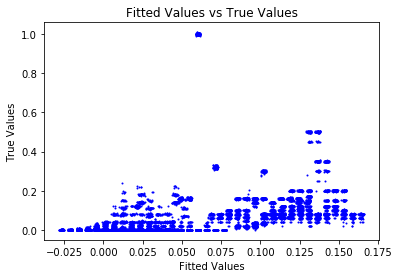

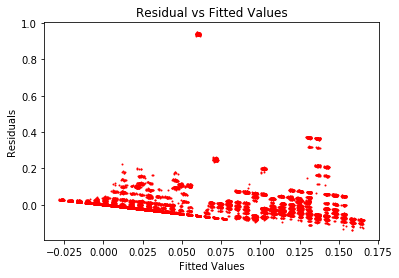

('\n\nCombination: ', '10100', '\tShape of X: ', (18588, 24))
('Training MSE for each fold : ', [0.010014379923937325, 0.010047458532190407, 0.010281395570399718, 0.009750029831575156, 0.0100260916853068, 0.010149496976612086, 0.01000065658315223, 0.010385114197662741, 0.010251560096835276, 0.010264573246028929], '\n\n')
('Testing MSE for each fold : ', [0.01106825770978935, 0.010771401038385055, 0.008665768927153528, 0.013464646124119998, 0.010964881173277532, 0.009856037818582741, 0.011191565062416437, 0.007733873431434425, 0.008932687877281268, 0.00881338530348601], '\n\n')
('Training RMSE:', 0.10058367493967431)
('Testing RMSE:', 0.10072859795804087)


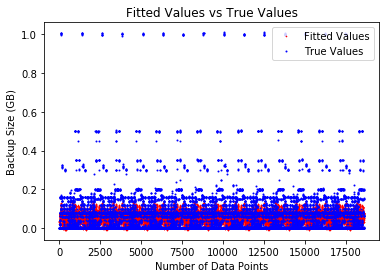

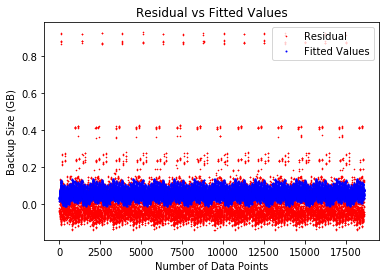

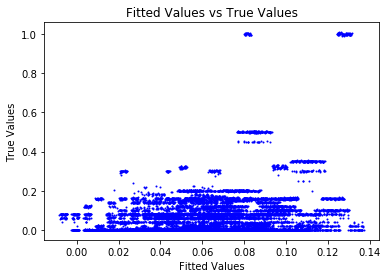

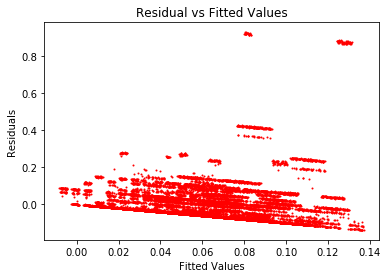

('\n\nCombination: ', '10101', '\tShape of X: ', (18588, 53))
('Training MSE for each fold : ', [0.008144856711160367, 0.00784982816842968, 0.007978424128080617, 0.008216126689188169, 0.0077897561065527286, 0.008086204937061432, 0.007922836876980545, 0.008011149176033757, 0.007987531950308878, 0.007903496448992815], '\n\n')
('Testing MSE for each fold : ', [0.006631249639755544, 0.009287474447012804, 0.008129510483471077, 0.005992438650760239, 0.009838485766268041, 0.007152753923380168, 0.008625152932870722, 0.007826292118100046, 0.00804615590120422, 0.008816682787434013], '\n\n')
('Training RMSE:', 0.08938132421976583)
('Testing RMSE:', 0.08963603998964752)


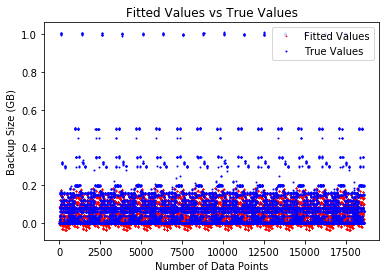

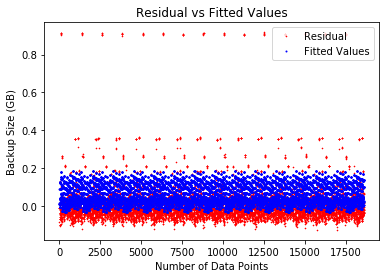

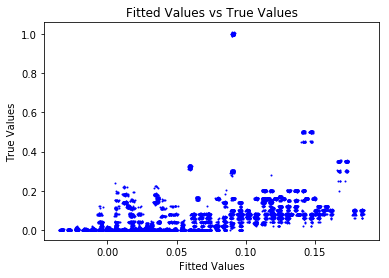

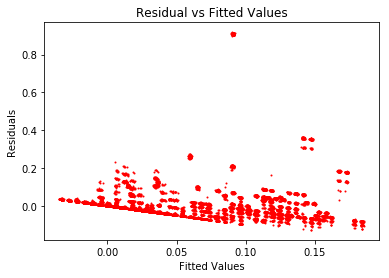

('\n\nCombination: ', '10110', '\tShape of X: ', (18588, 28))
('Training MSE for each fold : ', [0.00795063440434271, 0.008011912039954805, 0.007684535173658074, 0.00822523405908129, 0.008218182703253002, 0.007868338687853369, 0.008095311907916503, 0.007971771353256763, 0.008083148155557577, 0.007789828533737179], '\n\n')
('Testing MSE for each fold : ', [0.008366790019225937, 0.007813223409851909, 0.01078987243092721, 0.005904763983090732, 0.005962225073156968, 0.009108919942242161, 0.007065312289702537, 0.00817182522829187, 0.007175736605462712, 0.009820386819537464], '\n\n')
('Training RMSE:', 0.08938618294714865)
('Testing RMSE:', 0.08954275839032964)


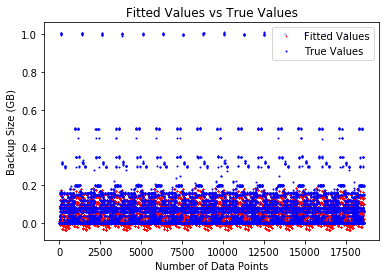

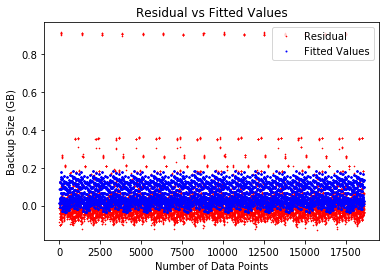

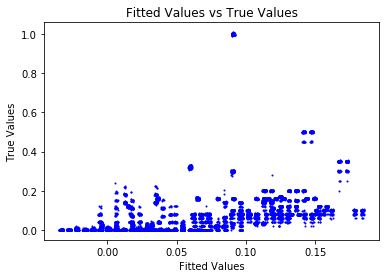

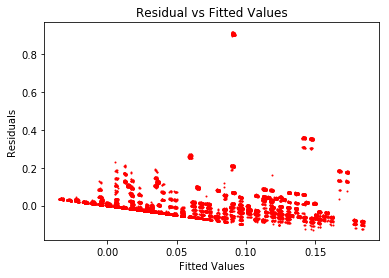

('\n\nCombination: ', '10111', '\tShape of X: ', (18588, 57))
('Training MSE for each fold : ', [0.008014753025557824, 0.008195933201200248, 0.007952799997957869, 0.008124214261493526, 0.007741591750889567, 0.0075715683310826915, 0.008047524436505932, 0.008242998910478668, 0.007993726941488415, 0.008082590418325385], '\n\n')
('Testing MSE for each fold : ', [0.007919459390642068, 0.006164244742493543, 0.00838068922133443, 0.006845320956785563, 0.010268243956459457, 0.011807746087792826, 0.008157470912226905, 0.005750665707698085, 0.008022849330878656, 0.0071872820108837615], '\n\n')
('Training RMSE:', 0.0894246617410321)
('Testing RMSE:', 0.08972400588314997)


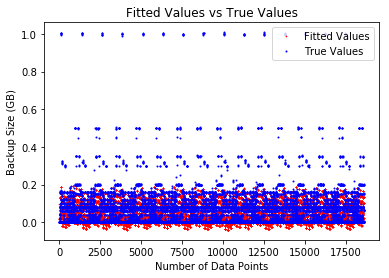

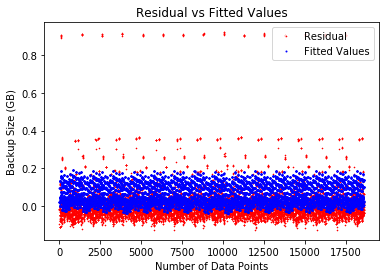

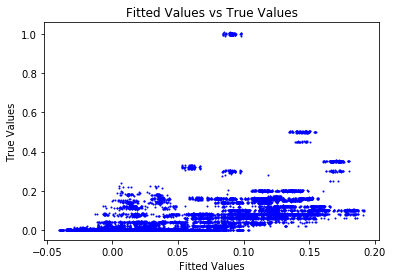

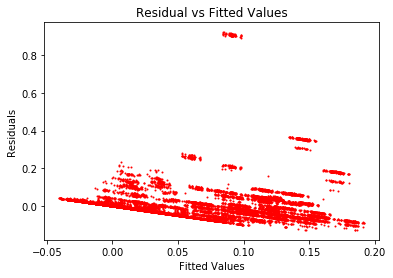

('\n\nCombination: ', '11000', '\tShape of X: ', (18588, 25))
('Training MSE for each fold : ', [0.010208671521612941, 0.010242063230462329, 0.010029551423224065, 0.01035427200564288, 0.010132085412230481, 0.010326141373656167, 0.010289930205014956, 0.010139849143938296, 0.010144211564479887, 0.009914482319681662], '\n\n')
('Testing MSE for each fold : ', [0.00993598933879422, 0.009623043065241671, 0.011540645010554556, 0.008614224550836396, 0.01061488522273018, 0.008883547812954758, 0.009196682825760758, 0.01054725854128074, 0.010503356607326556, 0.012583146670075008], '\n\n')
('Training RMSE:', 0.10088669793384243)
('Testing RMSE:', 0.10101622624388364)


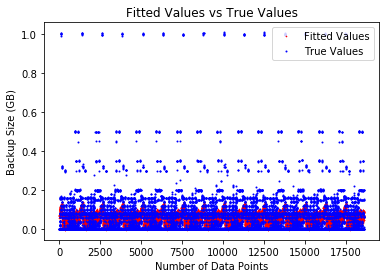

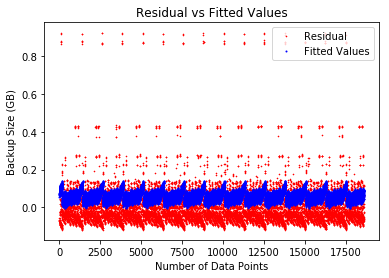

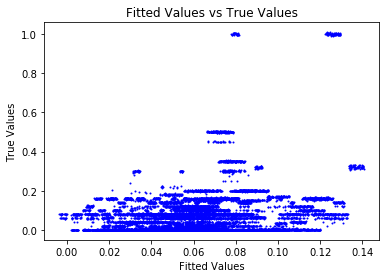

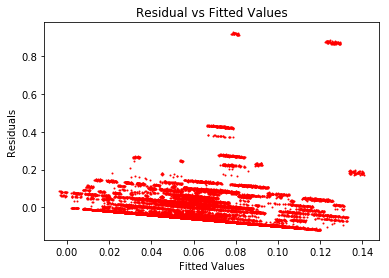

('\n\nCombination: ', '11001', '\tShape of X: ', (18588, 54))
('Training MSE for each fold : ', [0.008044471867093717, 0.007961912874210273, 0.008005399716271051, 0.008062501823000407, 0.008192013480584352, 0.007916999237275601, 0.00815281060963698, 0.007974231935116883, 0.008104257176127807, 0.008134163054623493], '\n\n')
('Testing MSE for each fold : ', [0.008194666856283794, 0.008934061078435975, 0.008551407346084236, 0.008026448053630394, 0.006864926152332936, 0.009356060726270172, 0.007215424317956042, 0.008829982345663888, 0.0076575657027099, 0.007378035941246865], '\n\n')
('Training RMSE:', 0.0897489619850506)
('Testing RMSE:', 0.09000476571860748)


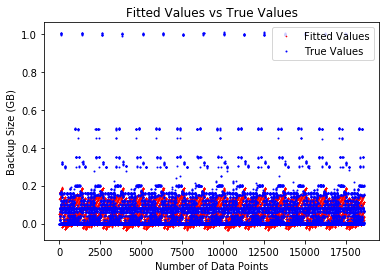

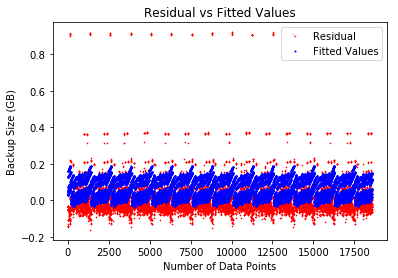

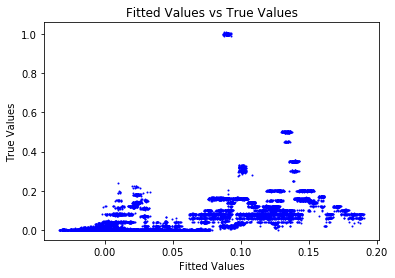

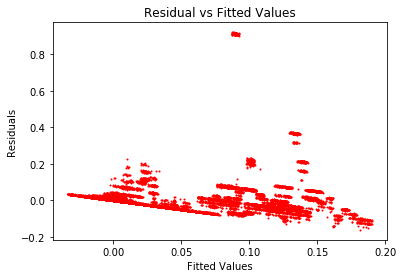

('\n\nCombination: ', '11010', '\tShape of X: ', (18588, 29))
('Training MSE for each fold : ', [0.007938728734890998, 0.008071974001547372, 0.007865094025204826, 0.00805689992758749, 0.008164206272618234, 0.008112490697815432, 0.008234682892283246, 0.008184238494304543, 0.00797507659681029, 0.007957272491685992], '\n\n')
('Testing MSE for each fold : ', [0.009141939068695839, 0.007933344619992504, 0.00979992987130168, 0.008069672224299612, 0.0071197458008862595, 0.007566245350078849, 0.006482593215885468, 0.006933454097613973, 0.008810941850729, 0.008967749767962333], '\n\n')
('Training RMSE:', 0.0897555926584792)
('Testing RMSE:', 0.08990306772710568)


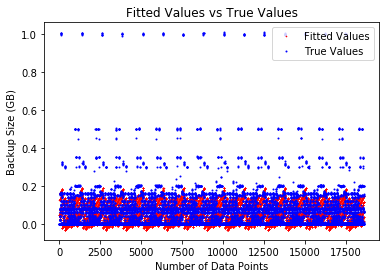

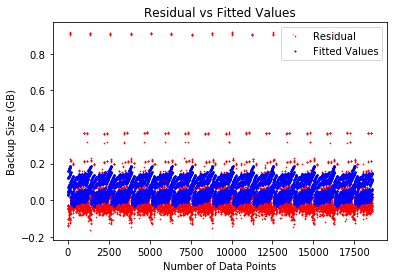

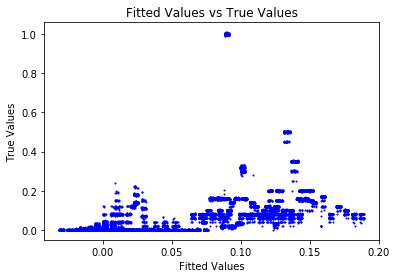

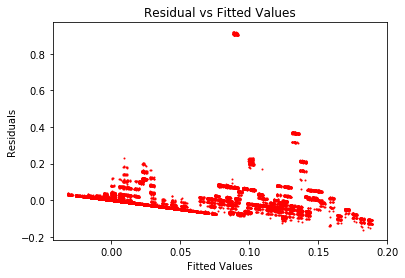

('\n\nCombination: ', '11011', '\tShape of X: ', (18588, 58))
('Training MSE for each fold : ', [0.008331825638303963, 0.008097350064769616, 0.00794117276984283, 0.008195285594589288, 0.007923644370944307, 0.007717428563314978, 0.008286441615039374, 0.008236062145969336, 0.0082493699182867, 0.007702640876013694], '\n\n')
('Testing MSE for each fold : ', [0.005615063260877732, 0.008965276733465371, 0.009125901471967084, 0.006856648338930592, 0.009299056611504333, 0.011199139280476176, 0.0060429565234144215, 0.006476877028687012, 0.00635863032412467, 0.011284664408226229], '\n\n')
('Training RMSE:', 0.08982272627630163)
('Testing RMSE:', 0.09012447724213087)


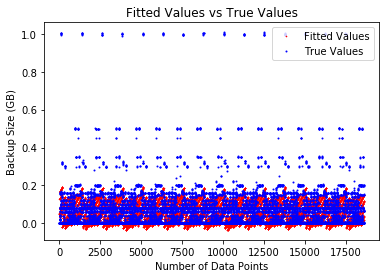

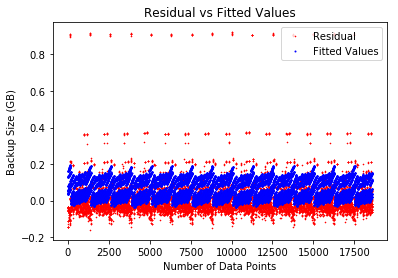

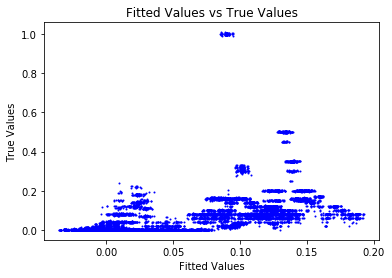

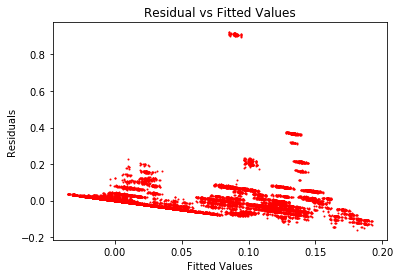

('\n\nCombination: ', '11100', '\tShape of X: ', (18588, 30))
('Training MSE for each fold : ', [0.009769280045611494, 0.010060628534735867, 0.009971721322710266, 0.009986986835105193, 0.00977327908868781, 0.009920186290456082, 0.009717627974875619, 0.010148601031521716, 0.009964615908352289, 0.009955159521196607], '\n\n')
('Testing MSE for each fold : ', [0.011379621515928093, 0.008756108065241573, 0.009545470408922436, 0.009418049092986273, 0.011346402275060926, 0.010013854924377409, 0.011851269168661737, 0.007971313083208255, 0.009612423809604035, 0.009708238525879908], '\n\n')
('Training RMSE:', 0.09963337119321665)
('Testing RMSE:', 0.09980117778356659)


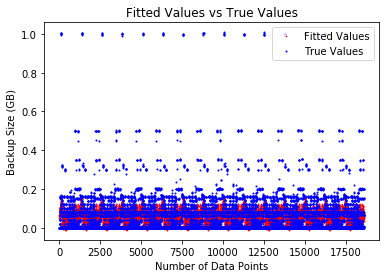

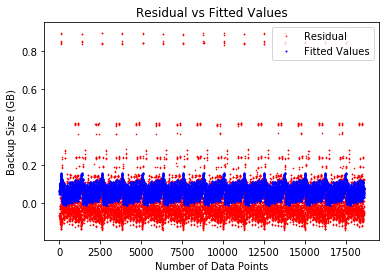

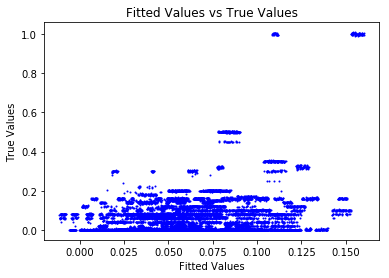

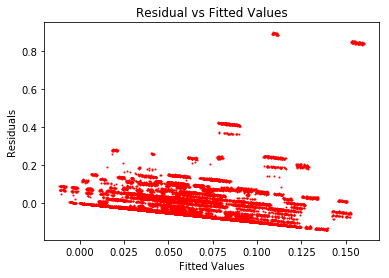

('\n\nCombination: ', '11101', '\tShape of X: ', (18588, 59))
('Training MSE for each fold : ', [0.008019328935853111, 0.007696705560555818, 0.0076591336951817015, 0.00788779341483359, 0.007832690635791019, 0.007942272005675467, 0.007836683881829997, 0.007471318819555663, 0.007891241099562345, 0.007792591154551235], '\n\n')
('Testing MSE for each fold : ', [0.00590330781444893, 0.0087988240344476, 0.009152335999295765, 0.0070974324232358985, 0.0075780702559625455, 0.006587214303691524, 0.007532972385775648, 0.010828693344442985, 0.007083097962168874, 0.007928750965911599], '\n\n')
('Training RMSE:', 0.0883344548878805)
('Testing RMSE:', 0.08859497699609237)


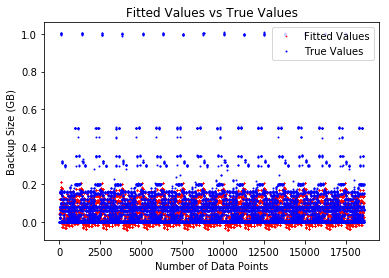

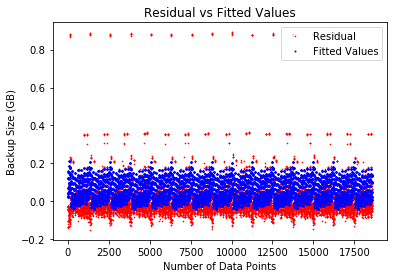

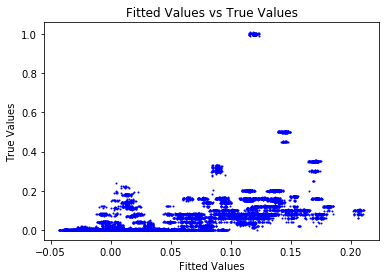

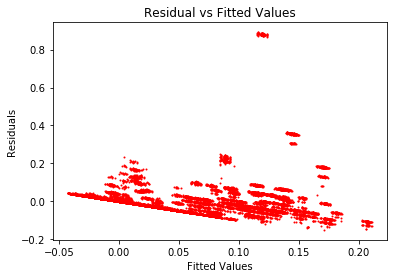

('\n\nCombination: ', '11110', '\tShape of X: ', (18588, 34))
('Training MSE for each fold : ', [0.007821670620869565, 0.007663759334999975, 0.007907529739760829, 0.007840387035076071, 0.007940048389188324, 0.007929134946932145, 0.007860278980960601, 0.007874951063316132, 0.0075744959582497605, 0.007623150993029739], '\n\n')
('Testing MSE for each fold : ', [0.007661189339521273, 0.009092947655003004, 0.006891824627532032, 0.007509878456555283, 0.006603334396703148, 0.006704025136478153, 0.007316861049652931, 0.007198592683296263, 0.009917834653941452, 0.009472670892638427], '\n\n')
('Training RMSE:', 0.08833765169076159)
('Testing RMSE:', 0.08852635703072953)


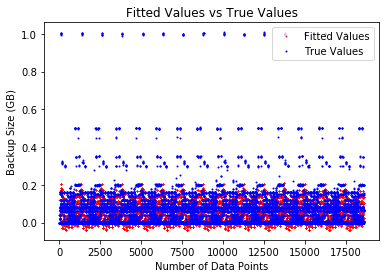

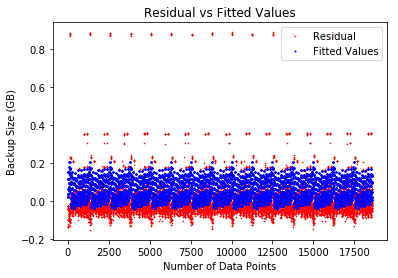

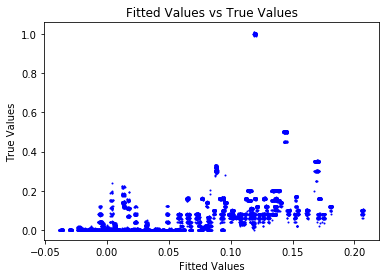

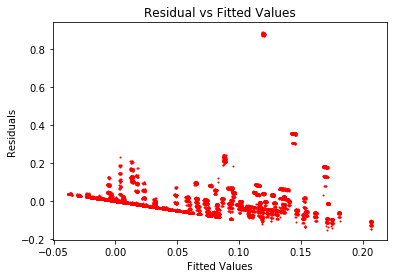

('\n\nCombination: ', '11111', '\tShape of X: ', (18588, 63))
('Training MSE for each fold : ', [0.00788445521243102, 0.007702109074283502, 0.007755610438557158, 0.007846361274080994, 0.007718292996581777, 0.00769860897435295, 0.007907755956769087, 0.007780369311929937, 0.007948678616433093, 0.00782502243338572], '\n\n')
('Testing MSE for each fold : ', [0.007167892968715268, 0.008832689133605897, 0.008302487925568921, 0.007461107624181852, 0.00862094757844002, 0.008819843793192573, 0.007047391111082185, 0.008061771808097123, 0.006542348671262754, 0.007664766865123096], '\n\n')
('Training RMSE:', 0.0883556813616449)
('Testing RMSE:', 0.08861221556832313)


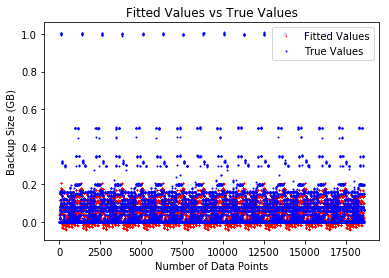

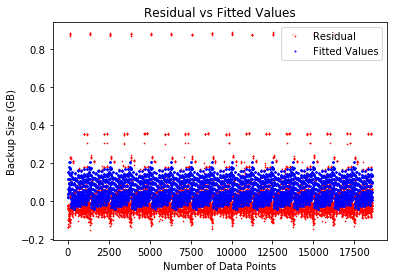

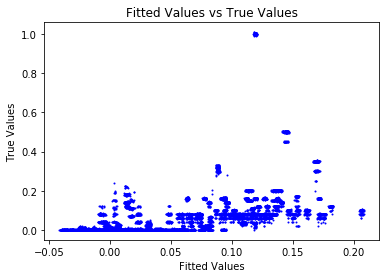

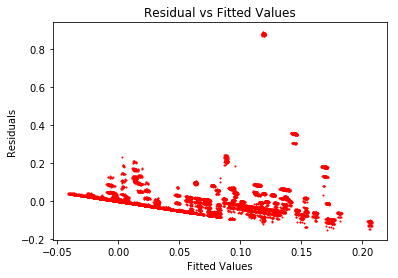

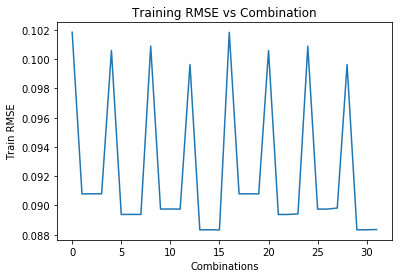

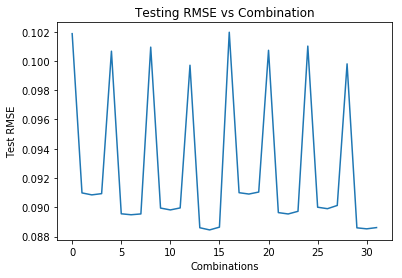

('Best combination: ', 14)


In [13]:
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from math import sqrt
from sklearn.metrics import mean_squared_error
import sys
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder

fEncDF = df.copy(deep=True)
del fEncDF['Backup Time (hour)']

fEncMatrix = fEncDF.as_matrix()
fEncX = fEncMatrix[:, 0 : fEncMatrix.shape[1] - 1]
fEncy = fEncMatrix[:, fEncMatrix.shape[1] - 1].astype('float')

#label encode the entire dataset
fEncX = labelEncoder(fEncX)

combo_train_rmse = list()
combo_test_rmse = list()
best_combination = -1
best_rmse = float(sys.maxsize)

for i in range(0, 32):
    binary = bin(i)[2:].zfill(5)
    
    newX = np.zeros((fEncX.shape[0], 1))
    field = 0
    for j in binary:
        if j == '0':
            #perform label encoding
            newX = np.concatenate((newX, np.expand_dims(fEncX[:, field], axis=1)), axis=1)
        if j == '1':
            #perform one hot encoding
            newCol = fEncX[:, field]
            ohe = OneHotEncoder(sparse=False)
            transformedCol = ohe.fit_transform(newCol.reshape(-1, 1))
            newX = np.concatenate((newX, transformedCol), axis=1)
            
        field += 1
            
    X_final = newX[:,1:]
    print("\n\nCombination: ", binary, "\tShape of X: ", X_final.shape)
    
    kfTrainRMSE, kfTestRMSE, kfPred = regression(X_final, fEncy, modelName='LinearRegression', plot=True, verbose=True)
    
    if kfTestRMSE < best_rmse:
        best_rmse = kfTestRMSE
        best_combination = i

    combo_train_rmse.append(kfTrainRMSE)
    combo_test_rmse.append(kfTestRMSE)

    
combinations = list(range(0,32))
plt.plot(combinations, combo_train_rmse)
plt.title('Training RMSE vs Combination')
plt.xlabel('Combinations')
plt.ylabel('Train RMSE')
plt.show()
plt.plot(combinations, combo_test_rmse)
plt.title('Testing RMSE vs Combination')
plt.xlabel('Combinations')
plt.ylabel('Test RMSE')
plt.show()

print("Best combination: ", best_combination)

In [123]:
#Coefficients for the best Unregularized Model

linear_model = LinearRegression()
linear_model.fit(X_final, fEncy)
linear_model.coef_

array([ 1.76468470e+10,  1.76468470e+10,  1.76468470e+10,  1.76468470e+10,
        1.76468470e+10,  1.76468470e+10,  1.76468470e+10,  1.76468470e+10,
        1.76468470e+10,  1.76468470e+10,  1.76468470e+10,  1.76468470e+10,
        1.76468470e+10,  1.76468470e+10,  1.76468470e+10, -6.43495217e+09,
       -6.43495217e+09, -6.43495217e+09, -6.43495217e+09, -6.43495217e+09,
       -6.43495217e+09, -6.43495217e+09, -3.59756909e+11, -3.59756909e+11,
       -3.59756909e+11, -3.59756909e+11, -3.59756909e+11, -3.59756909e+11,
        9.77362447e+10,  4.44081078e+10,  3.49429401e+11,  3.04586190e+10,
        6.83186214e+10,  7.02588794e+09,  7.02588794e+09,  6.03540248e+10,
        6.03540248e+10, -2.44667268e+11, -2.44667268e+11, -2.44667268e+11,
       -2.44667268e+11, -2.44667268e+11, -2.44667268e+11,  7.43035136e+10,
        7.43035136e+10,  7.02588794e+09,  7.43035136e+10,  7.43035136e+10,
        7.43035136e+10,  7.43035136e+10,  3.64435112e+10,  3.64435112e+10,
        3.64435112e+10,  

## 2(a)(v)

## Ridge

('For alpha: ', 0.001, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08843068267199139)
('Training MSE for each fold : ', [0.00788084726738119, 0.007947997736059052, 0.007936648475073176, 0.007677348905643933, 0.0078123536494883496, 0.00786287116342795, 0.0076005033780231195, 0.007944372925953114, 0.007495599757526571, 0.007881298231742714], '\n\n')
('Testing MSE for each fold : ', [0.007139184824943809, 0.006528714395937599, 0.006625409473786488, 0.008958881173271207, 0.007740505268873792, 0.007286764604196535, 0.009653116546678947, 0.006558321000499682, 0.010629959958892553, 0.007120105000870391], '\n\n')
('Training RMSE:', 0.08834016158595093)
('Testing RMSE:', 0.08845392147776773)


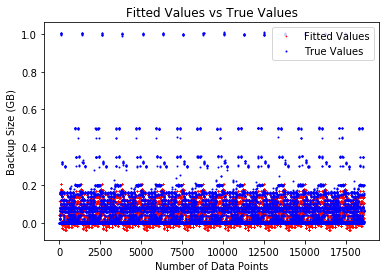

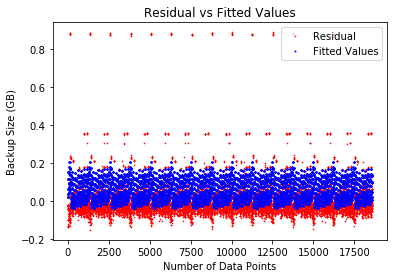

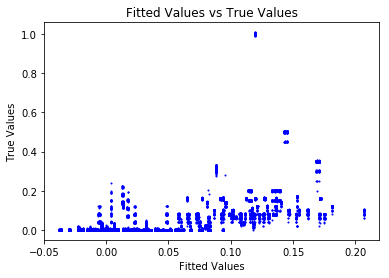

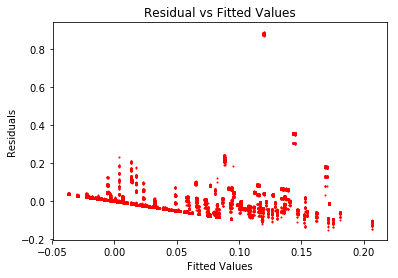

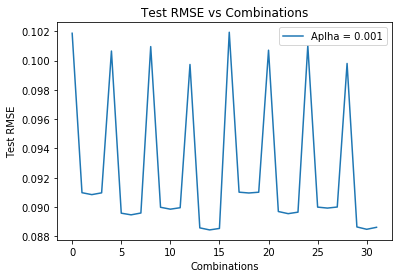

('For alpha: ', 0.01, '\tBest combination: ', 14, '\tTestRMSE: ', 0.0884379141097046)
('Training MSE for each fold : ', [0.007861198210863908, 0.007448470591883913, 0.007744923565404428, 0.008034075864537929, 0.007778143284331561, 0.008009514042198384, 0.007666855906637364, 0.007730962566832743, 0.007840252118745264, 0.00792211862259295], '\n\n')
('Testing MSE for each fold : ', [0.00730964098159971, 0.011072842937012111, 0.008351269255404277, 0.005754254446422434, 0.0080515386111373, 0.005973435316771764, 0.00905815036604184, 0.008478570487678853, 0.007496810612883689, 0.006755571584846608], '\n\n')
('Training RMSE:', 0.0883382786644773)
('Testing RMSE:', 0.08848846512387848)


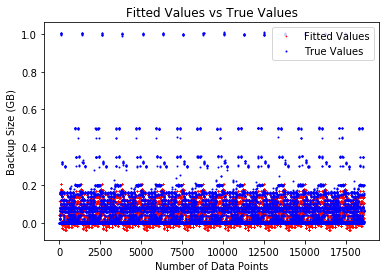

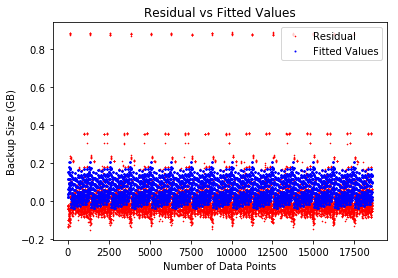

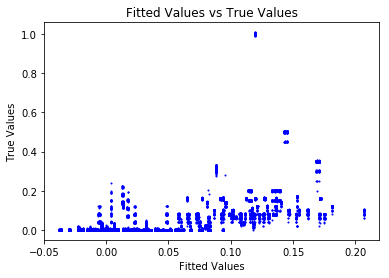

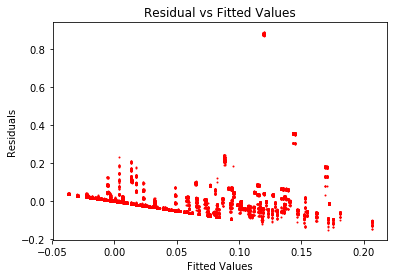

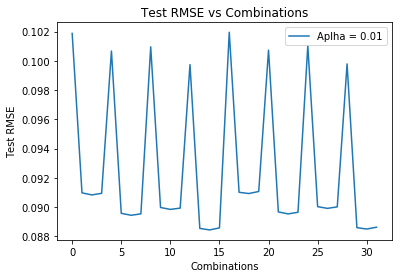

('For alpha: ', 0.1, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08841800984200665)
('Training MSE for each fold : ', [0.007888141129666466, 0.007691420684730094, 0.007884238583855148, 0.007750307007875215, 0.007685576133020277, 0.007855486263650185, 0.007778975423923269, 0.007807150884015818, 0.00788754507547561, 0.007815596246547946], '\n\n')
('Testing MSE for each fold : ', [0.007061617696839415, 0.008834163955195031, 0.007095016896071306, 0.008300054531656418, 0.008886485551808276, 0.007354768519363288, 0.008043538793963731, 0.007794620204633026, 0.007068725341589362, 0.00771267237909213], '\n\n')
('Training RMSE:', 0.08834276282342546)
('Testing RMSE:', 0.08840342972431102)


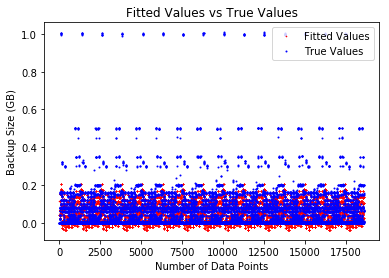

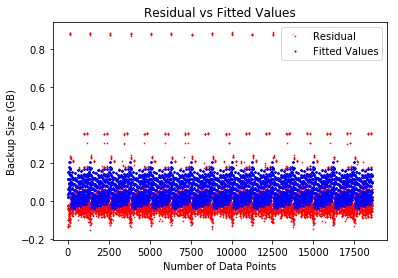

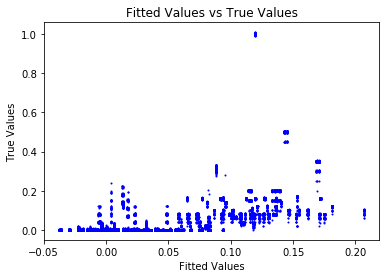

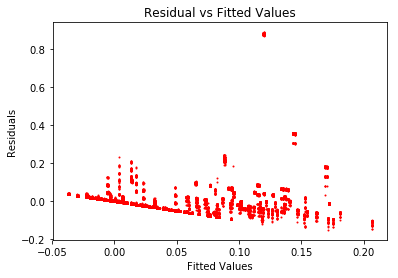

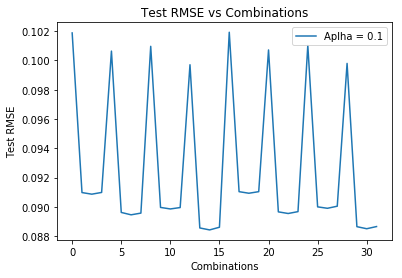

('For alpha: ', 0.2, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08845247128074146)
('Training MSE for each fold : ', [0.007999562573437804, 0.007621141743519847, 0.007681141494906687, 0.00802885195534019, 0.007982943811270819, 0.007624471093739991, 0.007827355882103216, 0.007775894886346507, 0.007715831730613003, 0.007782620965354365], '\n\n')
('Testing MSE for each fold : ', [0.006066330691511618, 0.009481727622026927, 0.008929544202832746, 0.0058045427041371655, 0.006209277793122158, 0.009440447875804489, 0.0076070136295335565, 0.008072618286412278, 0.008615503939254799, 0.008013608687344754], '\n\n')
('Training RMSE:', 0.08834014723591559)
('Testing RMSE:', 0.08845372543425206)


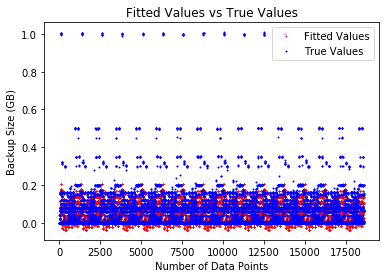

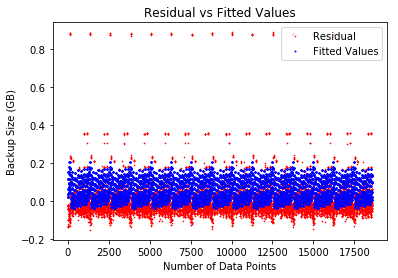

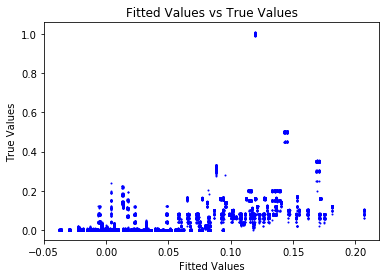

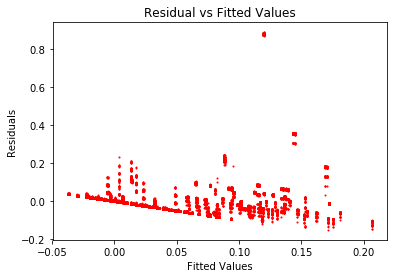

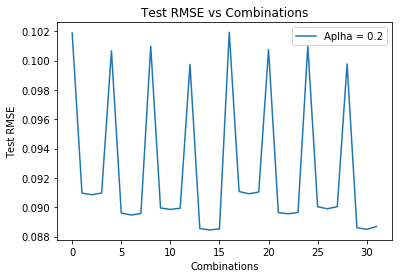

('For alpha: ', 0.5, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08843972158994408)
('Training MSE for each fold : ', [0.00779263576767013, 0.007698233926248823, 0.0075764109365396405, 0.0077958545445753445, 0.008022125283348868, 0.007806163904526598, 0.00801356780491052, 0.007713150826878496, 0.007895710261020452, 0.007728260406848311], '\n\n')
('Testing MSE for each fold : ', [0.007922495130774643, 0.00877278325295167, 0.009878914770864219, 0.007889781156934813, 0.005859302721048054, 0.0077991576910469325, 0.005938641640935297, 0.00863622105291042, 0.006993359096231179, 0.00850565824530459], '\n\n')
('Training RMSE:', 0.08834144761241304)
('Testing RMSE:', 0.08842868016599695)


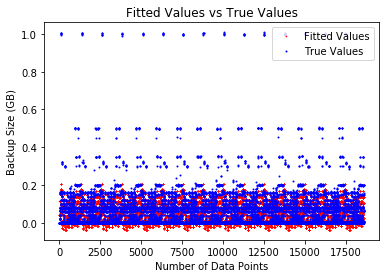

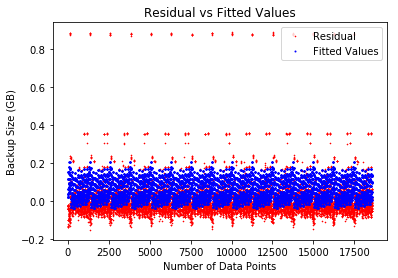

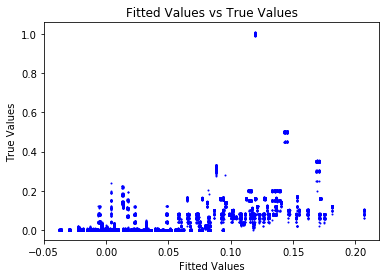

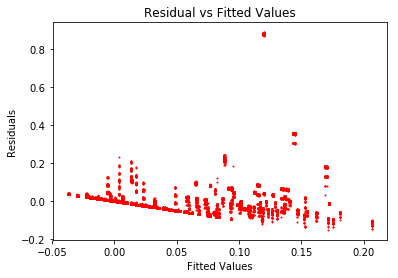

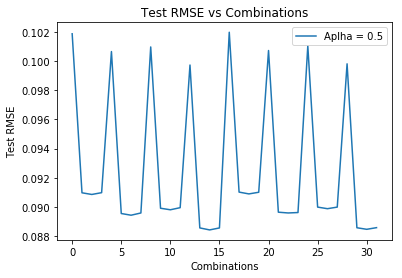

('For alpha: ', 1, '\tBest combination: ', 14, '\tTestRMSE: ', 0.0884356798460282)
('Training MSE for each fold : ', [0.00794302521801174, 0.007732609571805112, 0.007940645834044226, 0.0078090067489690095, 0.007885451634050038, 0.007805941581693449, 0.007830361648896377, 0.007602699377044366, 0.0077759387670406546, 0.0077178981265125235], '\n\n')
('Testing MSE for each fold : ', [0.006574618928631715, 0.008461623618026779, 0.0065903652164093695, 0.007775053532710501, 0.007084614305551066, 0.007798881375286966, 0.007580565736386041, 0.009635423154027363, 0.008072292647847746, 0.008595709405351527], '\n\n')
('Training RMSE:', 0.08834227669019375)
('Testing RMSE:', 0.08841331795619316)


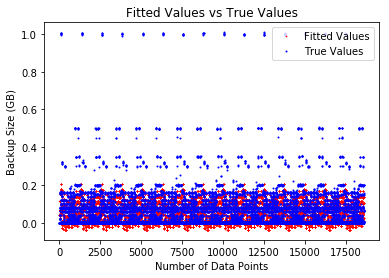

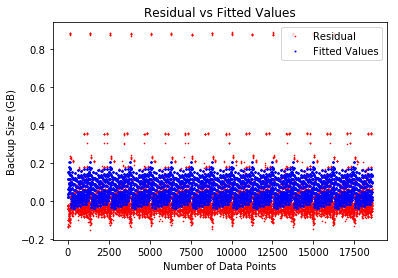

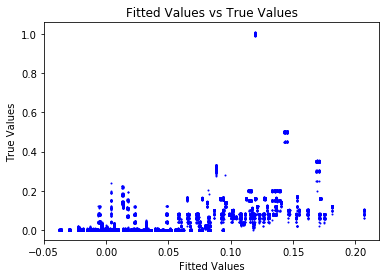

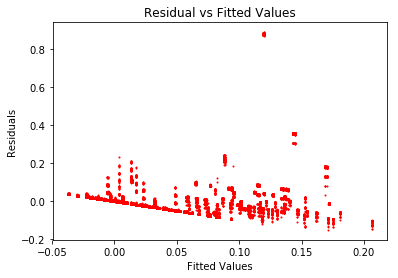

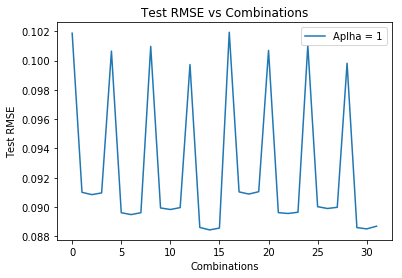

('For alpha: ', 2, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08842466001875092)
('Training MSE for each fold : ', [0.007756241629513192, 0.007822264733483632, 0.007791233522914223, 0.007728542021786207, 0.007958155273871769, 0.007920617293861409, 0.00790161708907111, 0.0075895720668862415, 0.007673228317487197, 0.007902537749070761], '\n\n')
('Testing MSE for each fold : ', [0.00824740923629738, 0.007651978694989314, 0.007938903502016424, 0.008496119947112291, 0.006431136806372354, 0.006767547171620057, 0.006944886030141336, 0.00975599144291057, 0.008996571107893451, 0.006930053340527511], '\n\n')
('Training RMSE:', 0.0883425207348906)
('Testing RMSE:', 0.08840848221742113)


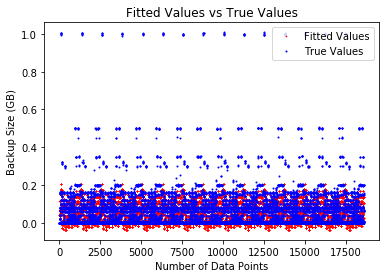

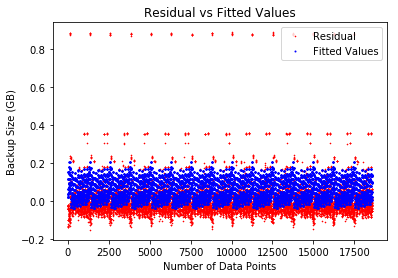

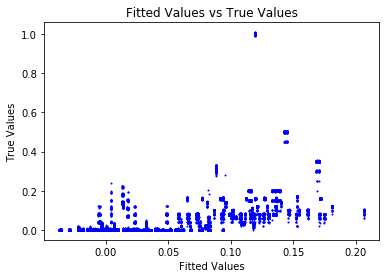

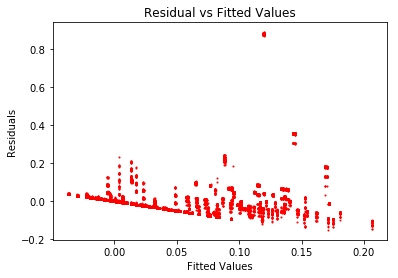

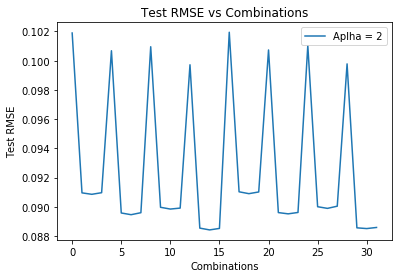

('For alpha: ', 5, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08842337354750107)
('Training MSE for each fold : ', [0.0074421426058454134, 0.007766027373307925, 0.007825591517024758, 0.007809142504784892, 0.0075678335806826985, 0.007779535151890798, 0.008046859921609844, 0.007971997721094422, 0.007884295666704623, 0.007946727042734645], '\n\n')
('Testing MSE for each fold : ', [0.011100299651997176, 0.008160751462879789, 0.007624532477899416, 0.007770660702196963, 0.00995972035489011, 0.008041650577851996, 0.005641338141962918, 0.0063066925867779015, 0.007095790434671986, 0.006532444738507026], '\n\n')
('Training RMSE:', 0.08834033794687456)
('Testing RMSE:', 0.08844991867132229)


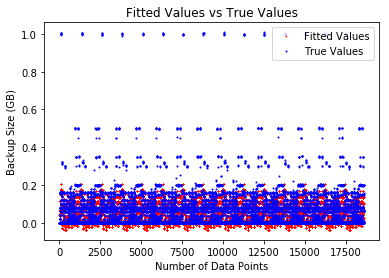

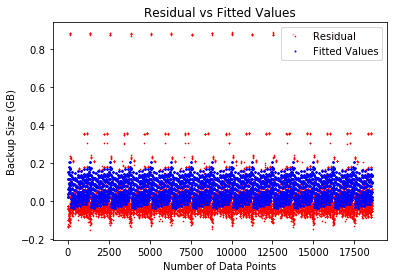

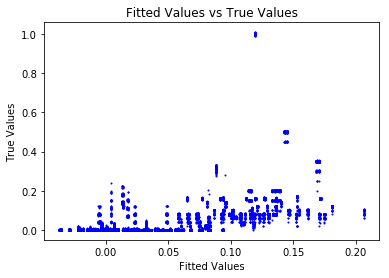

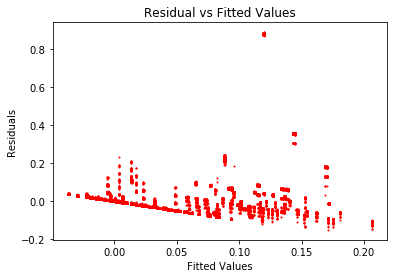

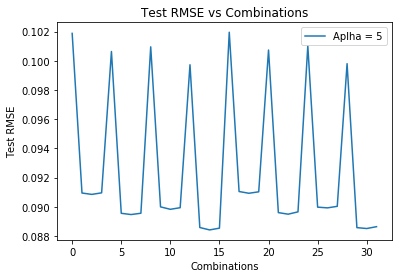

('For alpha: ', 10, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08842461067103205)
('Training MSE for each fold : ', [0.007857299293655721, 0.007844415975602249, 0.00754898564904901, 0.007928421008540097, 0.00796498171114609, 0.007808844023634953, 0.007769303101754572, 0.007606098924298146, 0.008008666884786608, 0.007702533050738892], '\n\n')
('Testing MSE for each fold : ', [0.007337963209709211, 0.007454037345687257, 0.010127762540023129, 0.006705376495983184, 0.006376994594296234, 0.007776435734032538, 0.00813067982338523, 0.009615680003005085, 0.005989755179786568, 0.00873601781212789], '\n\n')
('Training RMSE:', 0.08833999639076646)
('Testing RMSE:', 0.08845942727490176)


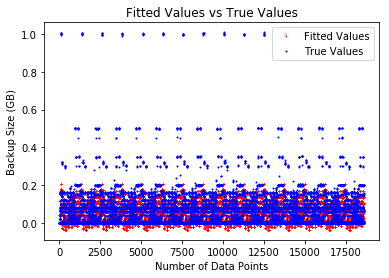

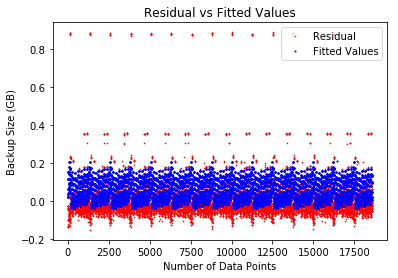

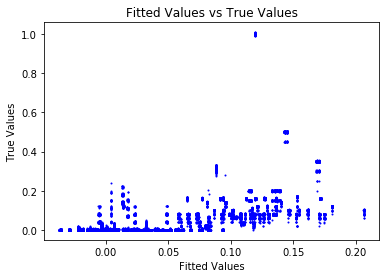

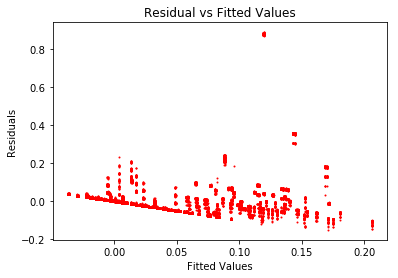

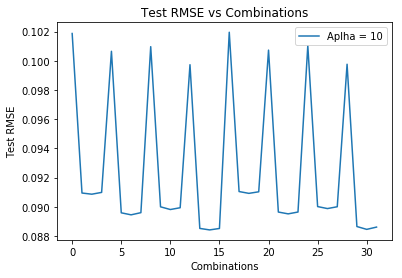

('For alpha: ', 50, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08841169464344878)
('Training MSE for each fold : ', [0.007746175908177558, 0.007882778246978346, 0.0077753842366226214, 0.0077493799909418406, 0.007711509338590016, 0.007578721388920017, 0.007889688843696467, 0.007888106527514937, 0.007982747148160075, 0.007846999075380029], '\n\n')
('Testing MSE for each fold : ', [0.008351357583723601, 0.007117374122178816, 0.008080412156887913, 0.008316470880157864, 0.00866323940596271, 0.00986881169897301, 0.007052133661366591, 0.00706670460609072, 0.006219198459502629, 0.007443053679457427], '\n\n')
('Training RMSE:', 0.08834675472533324)
('Testing RMSE:', 0.08841875154869655)


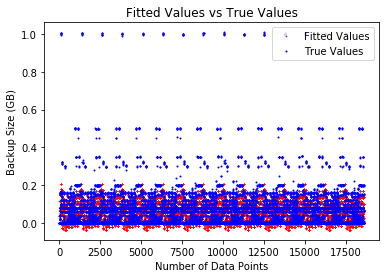

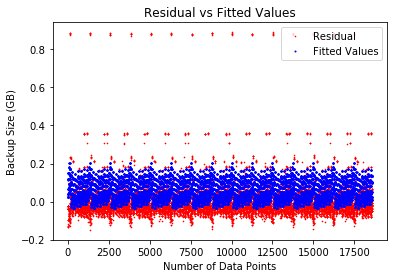

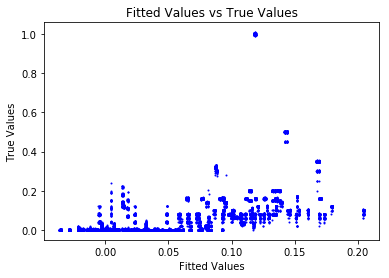

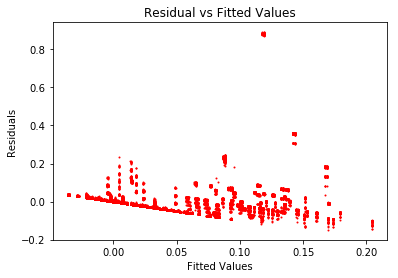

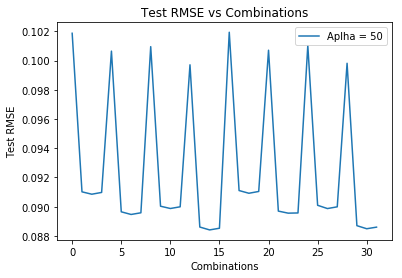

('For alpha: ', 100, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08842091225440515)
('Training MSE for each fold : ', [0.00786644154903447, 0.007955706398713475, 0.007662088051198872, 0.00814401576785449, 0.007714457916546355, 0.0075280556148246145, 0.007788706553568172, 0.007719302228108137, 0.007923432084376285, 0.0077687571007083135], '\n\n')
('Testing MSE for each fold : ', [0.007288783920755921, 0.0064793151468908175, 0.00912984106821036, 0.004814813162750993, 0.008677112299571658, 0.010360238534007696, 0.007978933313681573, 0.008612699369106703, 0.006758727106146425, 0.008174009519161286], '\n\n')
('Training RMSE:', 0.0883577745673425)
('Testing RMSE:', 0.08847286218964742)


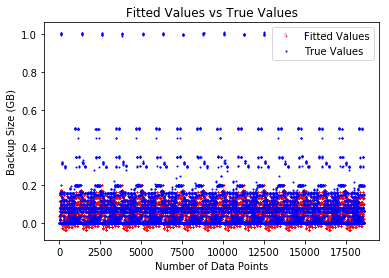

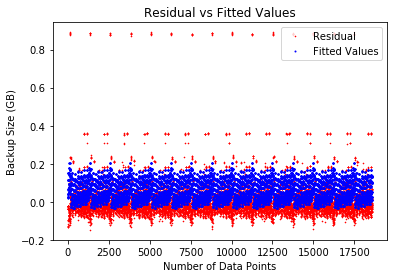

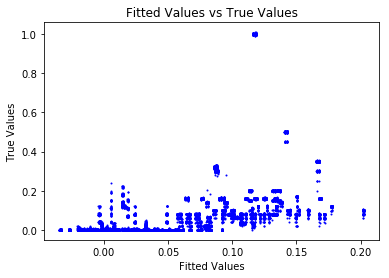

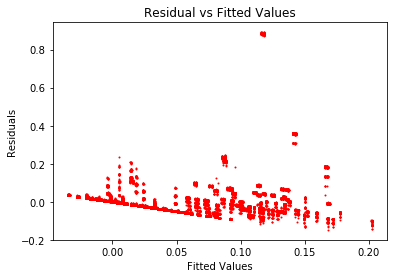

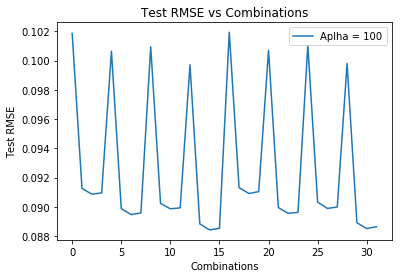



Overall Best Result
('Alpha = ', 50)
('Combination = ', 14)
('Training MSE for each fold : ', [0.007814544520186801, 0.007880258440562525, 0.007788323468980506, 0.007980052439725178, 0.007594352424313096, 0.007881760738977396, 0.008006340567949355, 0.007774149611909034, 0.007799812104741166, 0.0075307607955042806], '\n\n')
('Testing MSE for each fold : ', [0.0077396308849926355, 0.007134630317396567, 0.007967631436627832, 0.006241378857973698, 0.009727654967920822, 0.007122916842668217, 0.006001936083897376, 0.008099607616516343, 0.007865758415015769, 0.010302186243419385], '\n\n')
('Training RMSE:', 0.08834611203264654)
('Testing RMSE:', 0.08843264762881899)


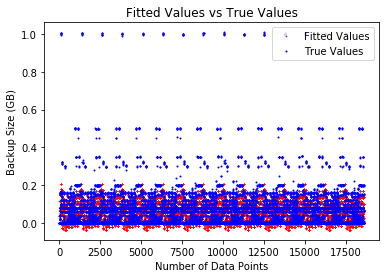

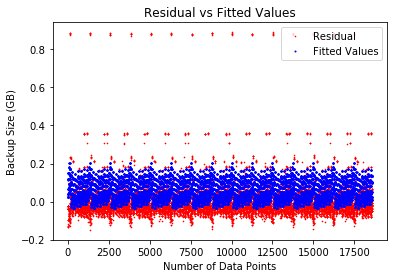

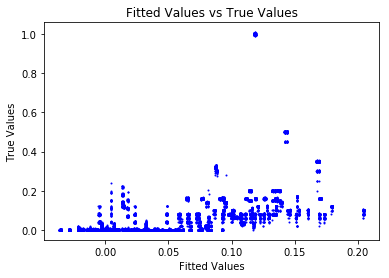

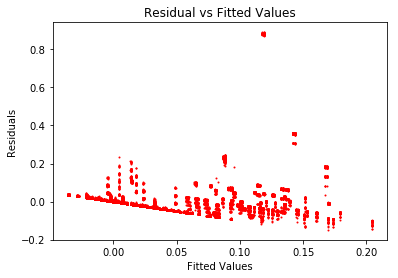

In [14]:
ridgeDF = df.copy(deep=True)
del ridgeDF['Backup Time (hour)']
ridgeMatrix = ridgeDF.as_matrix()

ridgeX = ridgeMatrix[:, 0 : ridgeMatrix.shape[1] - 1]
ridgey = ridgeMatrix[:, ridgeMatrix.shape[1] - 1].astype('float')
overallBestX = None
overallBestCombination = None
overallBestRMSE = float(sys.maxsize)
overallBestAlpha = None
#label encode the entire dataset
ridgeX = labelEncoder(ridgeX)

alphas = [0.001, 0.01, 0.1, 0.2, 0.5, 1, 2, 5, 10, 50, 100]
comboList = list(range(0, 32))
for alpha in alphas:
    combo_train_rmse = list()
    combo_test_rmse = list()
    best_combination = -1
    best_rmse = float(sys.maxsize)
    bestX = None
    for i in range(0, 32):
        binary = bin(i)[2:].zfill(5)

        newX = np.zeros((ridgeX.shape[0], 1))
        field = 0
        for j in binary:
            if j == '0':
                #perform label encoding
                newX = np.concatenate((newX, np.expand_dims(ridgeX[:, field], axis=1)), axis=1)
            if j == '1':
                #perform one hot encoding
                newCol = ridgeX[:, field]
                ohe = OneHotEncoder(sparse=False)
                transformedCol = ohe.fit_transform(newCol.reshape(-1, 1))
                newX = np.concatenate((newX, transformedCol), axis=1)

            field += 1

        X_final = newX[:,1:]

        kfTrainRMSE, kfTestRMSE, kfPred = regression(X_final, ridgey, modelName='Ridge', plot=False, arg=[alpha], verbose=False)

        if kfTestRMSE < best_rmse:
            best_rmse = kfTestRMSE
            best_combination = i
            bestX = X_final

        combo_train_rmse.append(kfTrainRMSE)
        combo_test_rmse.append(kfTestRMSE)
        
    print("For alpha: ", alpha, "\tBest combination: ", best_combination, "\tTestRMSE: ", best_rmse)
    
    if best_rmse < overallBestRMSE:
        overallBestRMSE = best_rmse
        overallBestAlpha = alpha
        overallBestCombination = best_combination
        overallBestX = bestX
    
    trainRMSE, testRMSE, pred = regression(bestX, ridgey, modelName='Ridge', plot=True, arg=[alpha], verbose=True)
    label = 'Aplha = ' + str(alpha)
    plt.plot(comboList, combo_test_rmse, label=label)    
    plt.xlabel('Combinations')
    plt.ylabel('Test RMSE')
    plt.title('Test RMSE vs Combinations')
    plt.legend()
    plt.show()
    
print("\n\nOverall Best Result")
print("Alpha = ", overallBestAlpha)
print("Combination = ", overallBestCombination)
bestTrainRMSE, bestTestRMSE, bestPred = regression(overallBestX, ridgey, modelName='Ridge', plot=True, arg=[overallBestAlpha], verbose=True)

In [118]:
#Coefficients for the best Ridge Model

ridge_model = Ridge(alpha=50)
ridge_model.fit(X_final, Ency)
ridge_model.coef_

array([-7.59429660e-04, -3.83365373e-05,  3.36953666e-04, -3.36613364e-04,
        3.16547870e-04, -2.05725282e-04,  7.76638907e-06,  7.91876068e-04,
        1.21694115e-04,  1.19487866e-04, -5.47226447e-04,  6.93885030e-04,
       -1.77627770e-04, -1.07999633e-05, -3.12451981e-04, -5.59670306e-03,
        3.85773695e-02,  3.21649081e-03,  1.46837553e-03, -5.15394786e-03,
       -1.26118864e-02, -1.98996986e-02, -1.98905508e-02, -2.07121511e-02,
        7.66858823e-03,  3.29308502e-02, -1.97795774e-03,  1.98122116e-03,
        3.23917798e-02, -1.19181244e-02, -3.40688896e-02, -4.82299982e-02,
        6.18252324e-02,  4.73376745e-03,  5.88864855e-03, -2.24234816e-03,
       -1.93965813e-03, -6.36862302e-03, -5.98398342e-03, -5.54548160e-03,
       -6.53342797e-03, -4.20333517e-03, -5.43403840e-03, -8.18717736e-03,
       -7.88414290e-03,  5.58443780e-03, -7.82959915e-03, -8.16278970e-03,
       -8.20782157e-03, -7.95846752e-03,  1.00634167e-02,  1.05853947e-02,
        1.07609576e-02,  

## Lasso

('For alpha: ', 0.001, '\tBest combination: ', 31, '\tTestRMSE: ', 0.08882029799849427)
('Training MSE for each fold : ', [0.007906526977378927, 0.007625505563573155, 0.007878215532267063, 0.007736253395001378, 0.007968282541120258, 0.008039852328937716, 0.007866077867436344, 0.007857187973185763, 0.007966518556512238, 0.007969959883651359], '\n\n')
('Testing MSE for each fold : ', [0.007654935500882503, 0.010327585510674373, 0.007911676171475352, 0.00921356415662992, 0.0071141435495819605, 0.0063963318763786935, 0.008063038932791486, 0.008118920901543722, 0.0071068455394549665, 0.007043515432781196], '\n\n')
('Training RMSE:', 0.08877746370507787)
('Testing RMSE:', 0.08885412628133495)


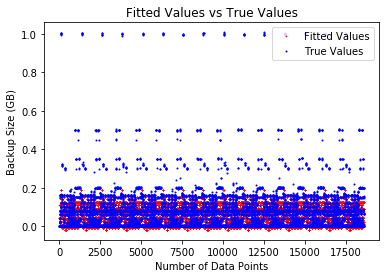

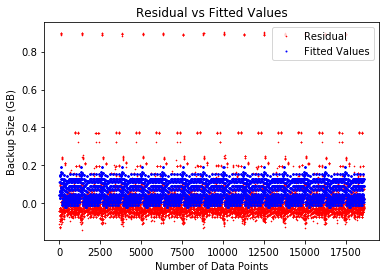

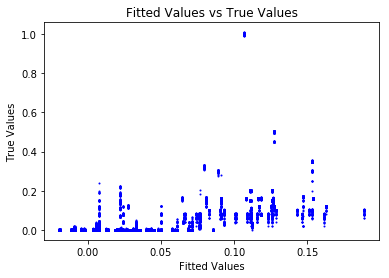

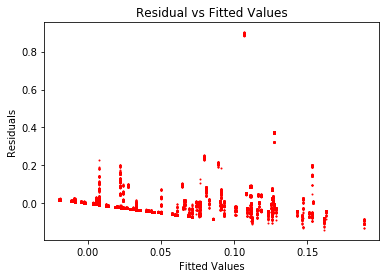

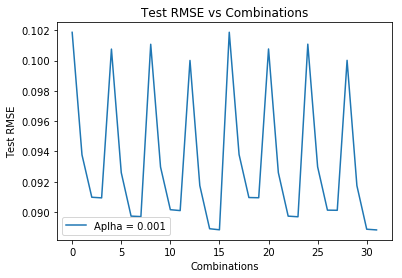

('For alpha: ', 0.01, '\tBest combination: ', 3, '\tTestRMSE: ', 0.09964199193441757)
('Training MSE for each fold : ', [0.009977423285704447, 0.009721682362517829, 0.009851765038989494, 0.01002938469726224, 0.009933067439119765, 0.010082490042638989, 0.009962292815835992, 0.009958389865364178, 0.00980820396890977, 0.009926454864696597], '\n\n')
('Testing MSE for each fold : ', [0.009345672399455779, 0.011801266105522455, 0.010525841220829918, 0.00913223640838824, 0.009863633640463639, 0.008212873286998615, 0.009583463435137557, 0.009402879839194094, 0.011298379905430679, 0.010118670672567954], '\n\n')
('Training RMSE:', 0.09962487359140754)
('Testing RMSE:', 0.09964181698162118)


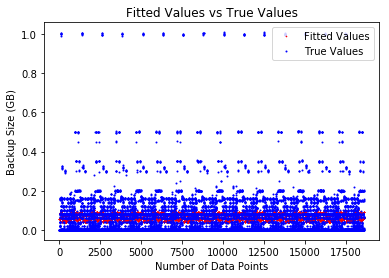

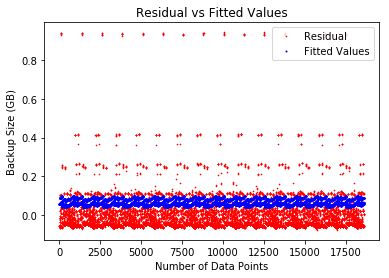

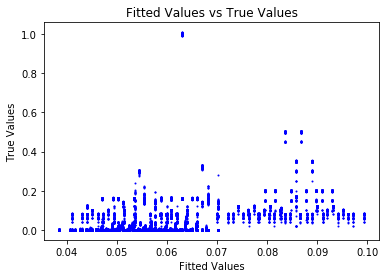

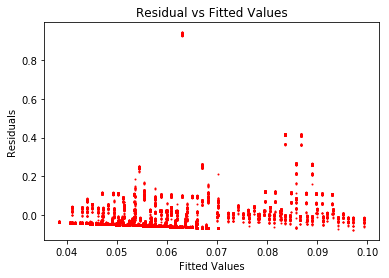

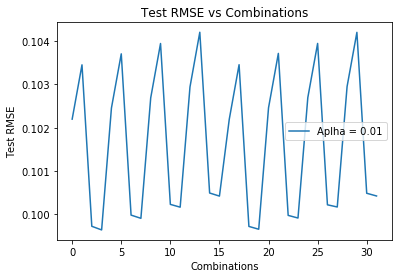

('For alpha: ', 0.1, '\tBest combination: ', 0, '\tTestRMSE: ', 0.1035832517126716)
('Training MSE for each fold : ', [0.01089338728085386, 0.010724003962232328, 0.010892806915526097, 0.010772678070726934, 0.010377445793939203, 0.01051737293148061, 0.010808238183897551, 0.01072291149614461, 0.010892352591421815, 0.01067934505149957], '\n\n')
('Testing MSE for each fold : ', [0.009213838987566109, 0.01076744720876166, 0.009138848746411493, 0.01032058471280792, 0.013999890181025104, 0.012619126310863628, 0.010025351091316127, 0.010807420701009854, 0.009259180514066358, 0.01115087502388045], '\n\n')
('Training RMSE:', 0.10357632078700353)
('Testing RMSE:', 0.10358695066354097)


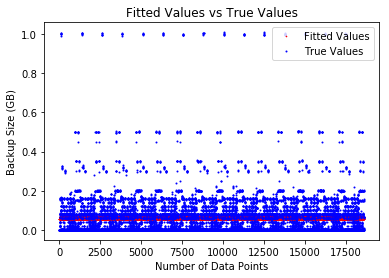

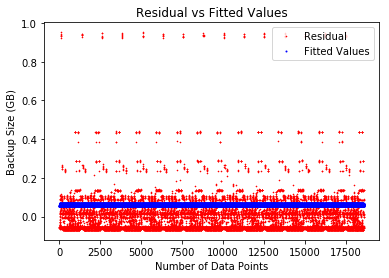

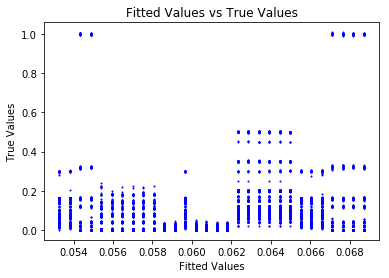

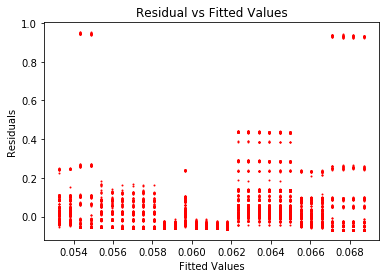

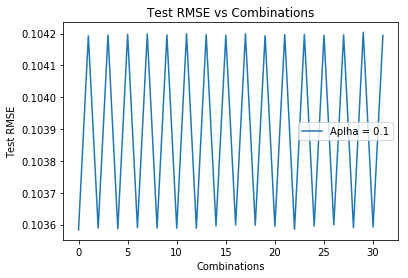

('For alpha: ', 0.2, '\tBest combination: ', 31, '\tTestRMSE: ', 0.10419124068785576)
('Training MSE for each fold : ', [0.0109149624122213, 0.010931279910617361, 0.011076234447165547, 0.010694009580653276, 0.010956425918943318, 0.010897821409646789, 0.010723246249003168, 0.010527069664604968, 0.01109442543606268, 0.01073887908007408], '\n\n')
('Testing MSE for each fold : ', [0.01032081865980144, 0.010174108295798356, 0.00886958858612305, 0.012309644118611546, 0.009947129992946153, 0.010474824999359322, 0.01204671084921333, 0.013811174520264471, 0.008703996235026925, 0.01190557114031133], '\n\n')
('Training RMSE:', 0.10418942082044245)
('Testing RMSE:', 0.10419384213928187)


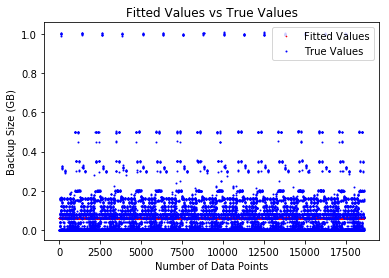

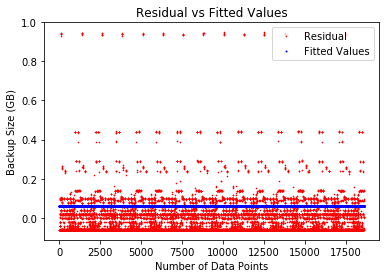

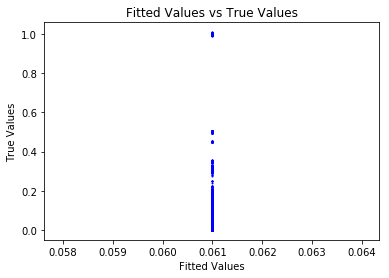

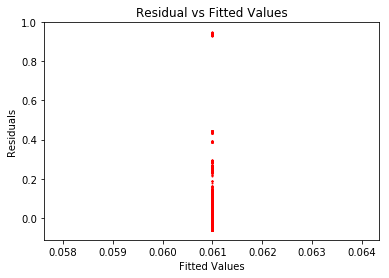

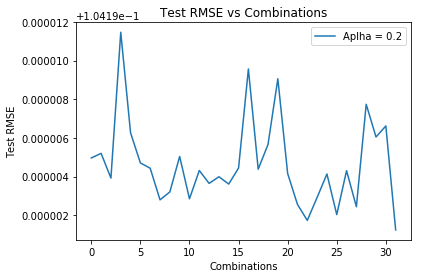

('For alpha: ', 0.5, '\tBest combination: ', 9, '\tTestRMSE: ', 0.1041912209088963)
('Training MSE for each fold : ', [0.010929998103560993, 0.010558873130130556, 0.01077514635202941, 0.010791738458665682, 0.011010095326288712, 0.01097247973083811, 0.010991869294571502, 0.011109374475089369, 0.010505046492222633, 0.010909770705607575], '\n\n')
('Testing MSE for each fold : ', [0.010185855045194848, 0.013525980967577806, 0.011578651620928363, 0.011429238741619807, 0.009464319188340372, 0.009802717218850867, 0.009628276352614625, 0.008572041540355369, 0.014011188507160535, 0.010367079542810789], '\n\n')
('Training RMSE:', 0.10418943903726736)
('Testing RMSE:', 0.10419469695020633)


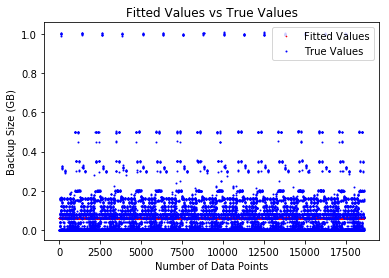

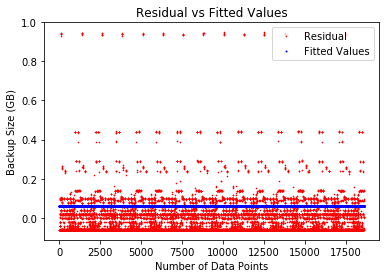

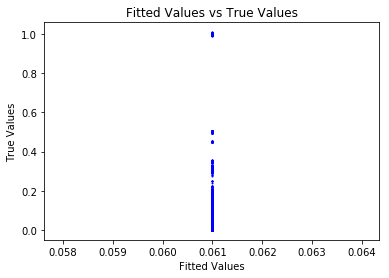

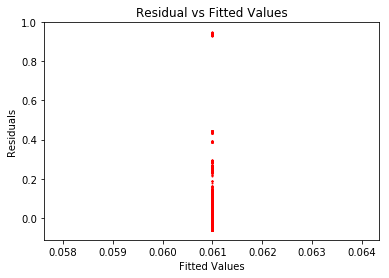

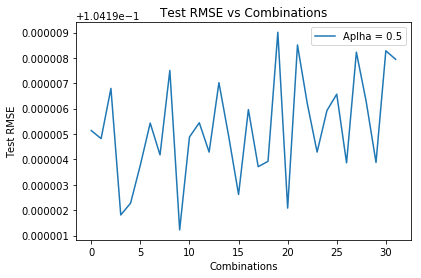

('For alpha: ', 1, '\tBest combination: ', 6, '\tTestRMSE: ', 0.10419185250164867)
('Training MSE for each fold : ', [0.010845459285883015, 0.01107864158291547, 0.010822029610006997, 0.01075427016328449, 0.010697049831903933, 0.010929104980701763, 0.010752570780050024, 0.01125688254399196, 0.010662648462197805, 0.010755630233461516], '\n\n')
('Testing MSE for each fold : ', [0.010945875359392728, 0.008847317451257802, 0.01115694885453897, 0.011766861920093878, 0.012281753456787519, 0.010193757810941239, 0.011781914228288571, 0.007245718751263637, 0.012592315035907997, 0.011754852264642112], '\n\n')
('Training RMSE:', 0.1041893888428169)
('Testing RMSE:', 0.10419564056769096)


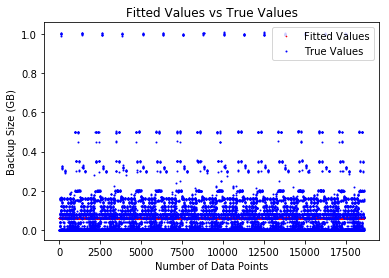

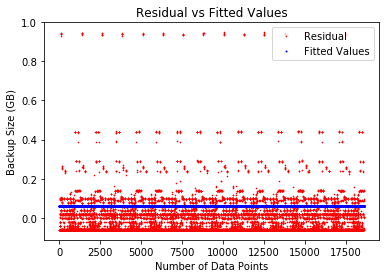

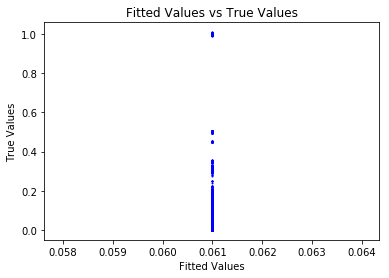

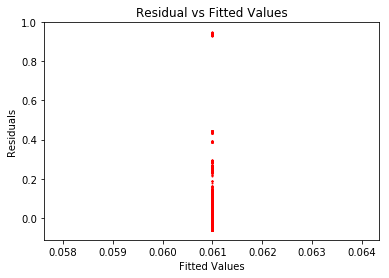

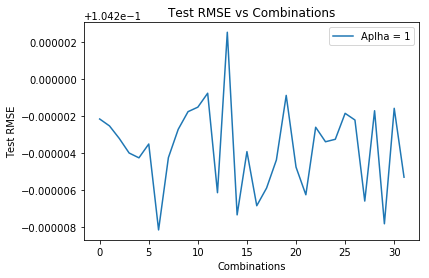

('For alpha: ', 2, '\tBest combination: ', 15, '\tTestRMSE: ', 0.10419113832365622)
('Training MSE for each fold : ', [0.010869667142896153, 0.011077405804678584, 0.010775918891992198, 0.010871900159224792, 0.010766100000482373, 0.010894734756323502, 0.010831503161230813, 0.010961603025422425, 0.010773061889125555, 0.010732720734820868], '\n\n')
('Testing MSE for each fold : ', [0.010727998249080831, 0.008859202768692167, 0.011571901493643618, 0.010707771478853241, 0.011660431039341885, 0.010502383610243032, 0.011071342048849943, 0.009900554682930185, 0.011597759608268693, 0.01196121377213992], '\n\n')
('Training RMSE:', 0.1041895462924171)
('Testing RMSE:', 0.10419239835613898)


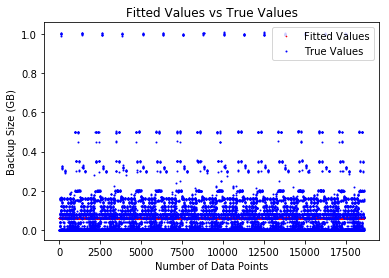

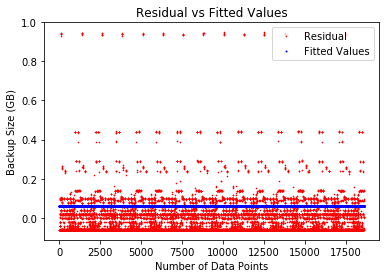

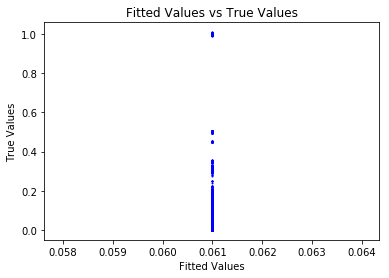

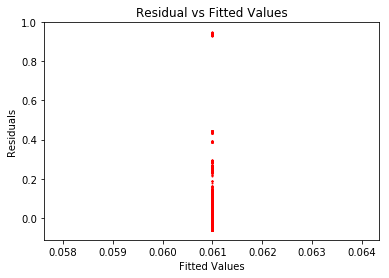

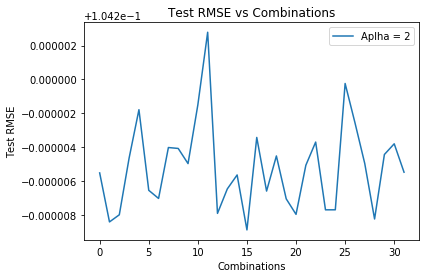

('For alpha: ', 5, '\tBest combination: ', 28, '\tTestRMSE: ', 0.10419153129075329)
('Training MSE for each fold : ', [0.010755167860386156, 0.010858881625241245, 0.010973260292251598, 0.010714388202333947, 0.010723812425065512, 0.01092568369692841, 0.011121852990226215, 0.010874953390053016, 0.010793930771047148, 0.010812457811779795], '\n\n')
('Testing MSE for each fold : ', [0.01175891723674813, 0.010825140323388186, 0.009795646622225745, 0.012125883818302144, 0.012040426986995095, 0.01022377413911025, 0.00846117937680918, 0.010680313525869943, 0.011409739528101193, 0.011243238623674321], '\n\n')
('Training RMSE:', 0.10418943759581058)
('Testing RMSE:', 0.10419417458822935)


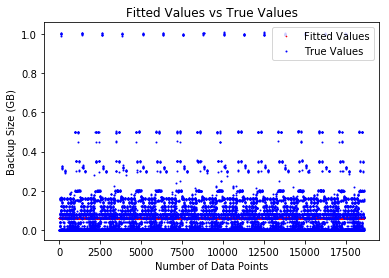

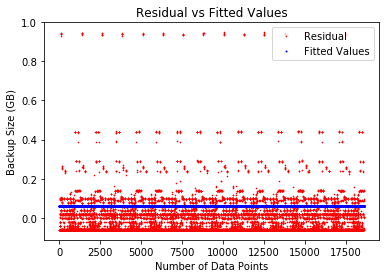

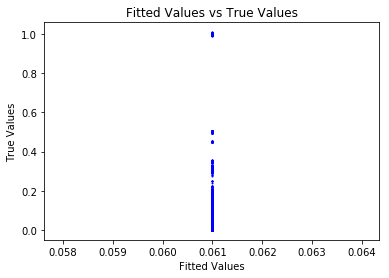

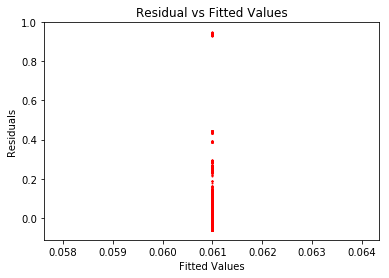

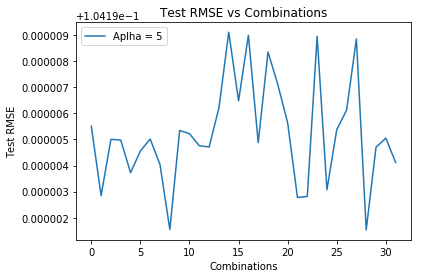

('For alpha: ', 10, '\tBest combination: ', 10, '\tTestRMSE: ', 0.10419091338503897)
('Training MSE for each fold : ', [0.010760340502474316, 0.010947168840159666, 0.011003732212570776, 0.010915167392718089, 0.010651412360005299, 0.011021449217848638, 0.010832662406970135, 0.01059543347280129, 0.010811444836330958, 0.011015640611066427], '\n\n')
('Testing MSE for each fold : ', [0.01171175297441802, 0.010030479902189623, 0.00952282273821239, 0.010319020180749816, 0.012691997614105272, 0.009362628663544434, 0.011060910169097207, 0.013196038461441338, 0.011252408086010902, 0.009413689122396504], '\n\n')
('Training RMSE:', 0.10418946772728306)
('Testing RMSE:', 0.10419296901046898)


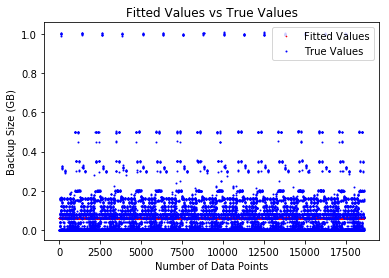

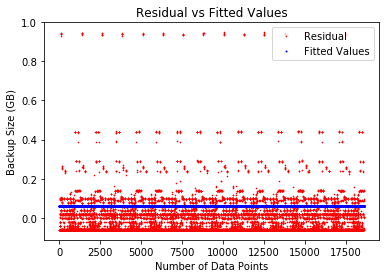

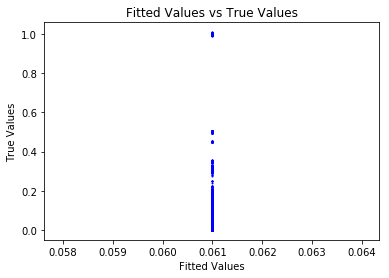

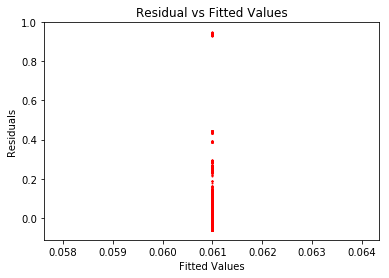

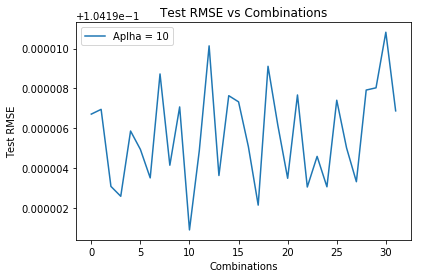

('For alpha: ', 50, '\tBest combination: ', 23, '\tTestRMSE: ', 0.10419187275648432)
('Training MSE for each fold : ', [0.011184658283147898, 0.010766481185714324, 0.010997192564606578, 0.010564043635315086, 0.010687824178249303, 0.010967640760579035, 0.010848921428512731, 0.010527744416703858, 0.011056496863789504, 0.010952994532452074], '\n\n')
('Testing MSE for each fold : ', [0.007893929538033913, 0.011656788443383989, 0.009580297131098236, 0.013479650136230908, 0.012365076203985631, 0.009847660640527686, 0.010914571704305771, 0.013805991312166574, 0.009047837151440875, 0.009977480890209138], '\n\n')
('Training RMSE:', 0.10418924985288569)
('Testing RMSE:', 0.10419658494949953)


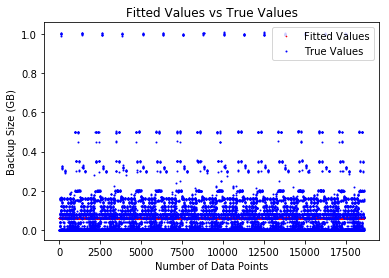

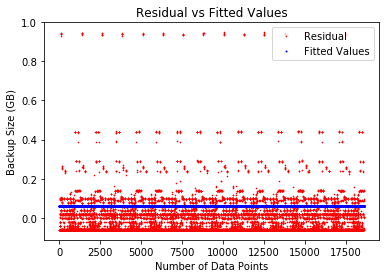

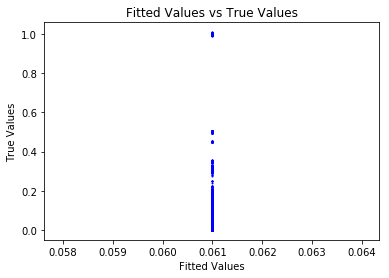

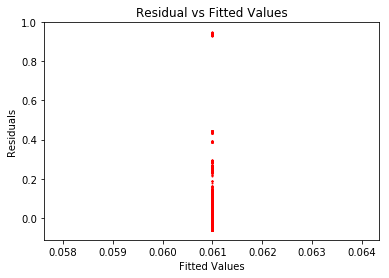

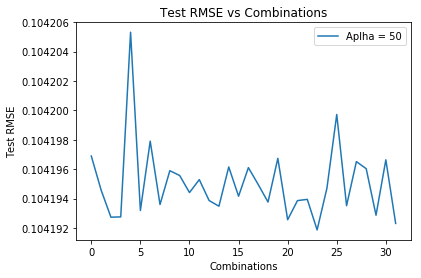

('For alpha: ', 100, '\tBest combination: ', 26, '\tTestRMSE: ', 0.1041902144879535)
('Training MSE for each fold : ', [0.011083279063740918, 0.010577743773278844, 0.011032251724208207, 0.010714125286046119, 0.010967284047539223, 0.01091741246433697, 0.010816813865423634, 0.010741990709514612, 0.010886915247460542, 0.010816755444981084], '\n\n')
('Testing MSE for each fold : ', [0.008805864667267127, 0.013355309556978952, 0.009265097047559777, 0.012128391176723291, 0.009849482295603196, 0.01029822319276696, 0.011203533079225935, 0.011877103114679677, 0.010572480303917086, 0.011204725890803957], '\n\n')
('Training RMSE:', 0.10418952520600626)
('Testing RMSE:', 0.10419223115257968)


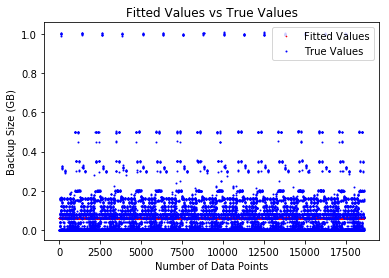

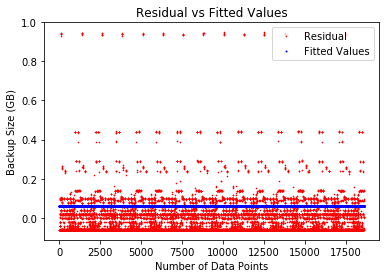

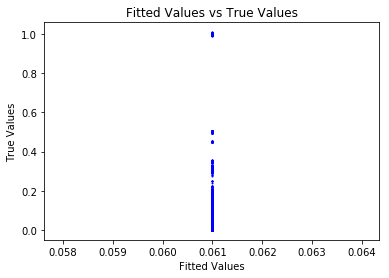

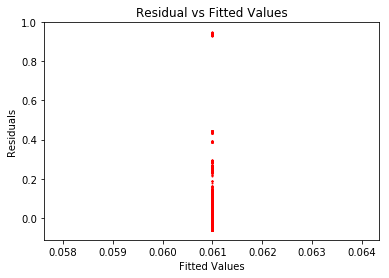

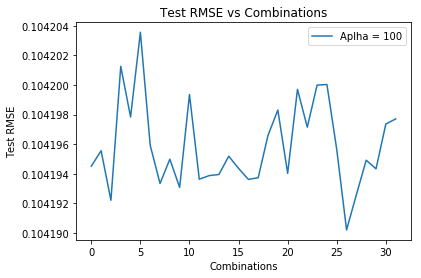



Overall Best Result
('Alpha = ', 0.001)
('Combination = ', 31)
('Training MSE for each fold : ', [0.007936149532097427, 0.007783753752546754, 0.007991025097271126, 0.007845977786020584, 0.007954155324190373, 0.007756827119942985, 0.007965376276644648, 0.008046805656597678, 0.007553597948863932, 0.007982949172705492], '\n\n')
('Testing MSE for each fold : ', [0.007401872299500392, 0.00878170895090143, 0.0068663299734706305, 0.008214306392750299, 0.0072309969829325365, 0.009057337700929652, 0.007066641571966196, 0.006375655566725708, 0.010953406645188506, 0.006987987700606817], '\n\n')
('Training RMSE:', 0.08877872361488477)
('Testing RMSE:', 0.08884607126090166)


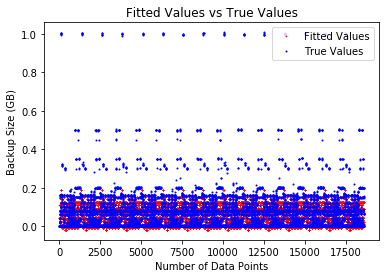

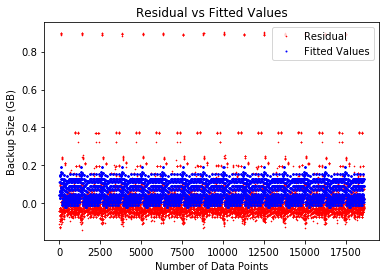

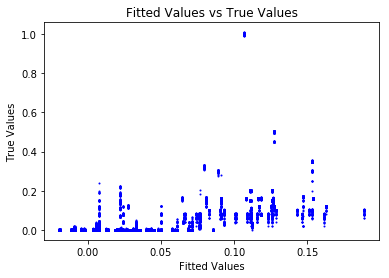

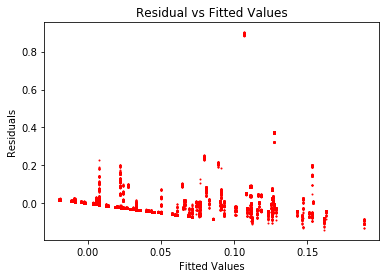

In [15]:
lassoDF = df.copy(deep=True)
del lassoDF['Backup Time (hour)']
lassoMatrix = lassoDF.as_matrix()

lassoX = lassoMatrix[:, 0 : lassoMatrix.shape[1] - 1]
lassoy = lassoMatrix[:, lassoMatrix.shape[1] - 1].astype('float')

overallBestX = None
overallBestCombination = None
overallBestRMSE = float(sys.maxsize)
overallBestAlpha = None

#label encode the entire dataset
lassoX = labelEncoder(lassoX)

alphas = [0.001, 0.01, 0.1, 0.2, 0.5, 1, 2, 5, 10, 50, 100]

for alpha in alphas:
    combo_train_rmse = list()
    combo_test_rmse = list()
    best_combination = -1
    best_rmse = float(sys.maxsize)
    bestX = None
    
    for i in range(0, 32):
        binary = bin(i)[2:].zfill(5)

        newX = np.zeros((lassoX.shape[0], 1))
        field = 0
        for j in binary:
            if j == '0':
                #perform label encoding
                newX = np.concatenate((newX, np.expand_dims(lassoX[:, field], axis=1)), axis=1)
            if j == '1':
                #perform one hot encoding
                newCol = lassoX[:, field]
                ohe = OneHotEncoder(sparse=False)
                transformedCol = ohe.fit_transform(newCol.reshape(-1, 1))
                newX = np.concatenate((newX, transformedCol), axis=1)

            field += 1

        X_final = newX[:,1:]

        kfTrainRMSE, kfTestRMSE, kfPred = regression(X_final, lassoy, modelName='Lasso', plot=False, arg=[alpha], verbose=False)

        if kfTestRMSE < best_rmse:
            best_rmse = kfTestRMSE
            best_combination = i
            bestX = X_final

        combo_train_rmse.append(kfTrainRMSE)
        combo_test_rmse.append(kfTestRMSE)
        
    print("For alpha: ", alpha, "\tBest combination: ", best_combination, "\tTestRMSE: ", best_rmse)
    
    if best_rmse < overallBestRMSE:
        overallBestRMSE = best_rmse
        overallBestAlpha = alpha
        overallBestCombination = best_combination
        overallBestX = bestX
    
    trainRMSE, testRMSE, pred = regression(bestX, lassoy, modelName='Lasso', plot=True, arg=[alpha], verbose=True)
    label = 'Aplha = ' + str(alpha)
    plt.plot(comboList, combo_test_rmse, label=label)    
    plt.xlabel('Combinations')
    plt.ylabel('Test RMSE')
    plt.title('Test RMSE vs Combinations')
    plt.legend()
    plt.show()
    
print("\n\nOverall Best Result")
print("Alpha = ", overallBestAlpha)
print("Combination = ", overallBestCombination)
bestTrainRMSE, bestTestRMSE, bestPred = regression(overallBestX, lassoy, modelName='Lasso', plot=True, arg=[overallBestAlpha], verbose=True)

In [122]:
#Coefficients for the best Lasso Model

lasso_model = Lasso(alpha=0.001)
lasso_model.fit(X_final, lassoy)
lasso_model.coef_

array([-0.        , -0.        ,  0.        , -0.        ,  0.        ,
       -0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
       -0.        ,  0.        , -0.        , -0.        , -0.        ,
       -0.        ,  0.03551031,  0.        ,  0.        , -0.        ,
       -0.0021173 , -0.01013452, -0.0143399 , -0.01480008,  0.00185475,
        0.02751801, -0.        ,  0.        ,  0.04725556, -0.        ,
       -0.02138538, -0.03814218,  0.08187752,  0.        ,  0.        ,
       -0.        ,  0.        , -0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.        ,
        0.        , -0.        , -0.        , -0.        , -0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
       -0.        ,  0.        , -0.        ])

## Elastic Net

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08845695532185671)
('Training MSE for each fold : ', [0.007895902117393367, 0.007765765890929555, 0.007509882717198196, 0.008031527485148566, 0.007921252894257692, 0.007762563784413659, 0.007799724940926981, 0.007894783448717826, 0.007715972521177026, 0.00774325019603469], '\n\n')
('Testing MSE for each fold : ', [0.006989578564385203, 0.008175739994891164, 0.010495258000831547, 0.005777741032833809, 0.0067630640794454746, 0.008195204101064904, 0.00786004201783193, 0.007004273887273738, 0.008611367610786952, 0.008371755519148602], '\n\n')
('Training RMSE:', 0.08834060561044256)
('Testing RMSE:', 0.08845565262236967)


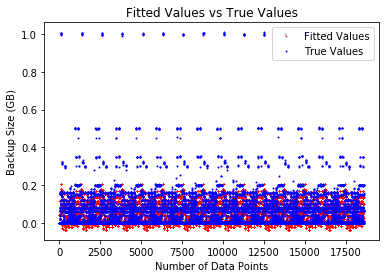

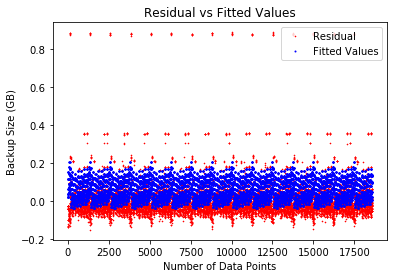

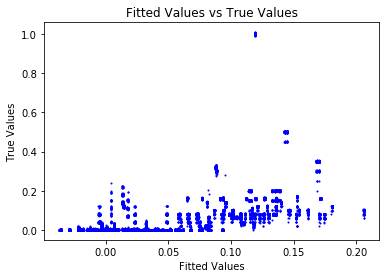

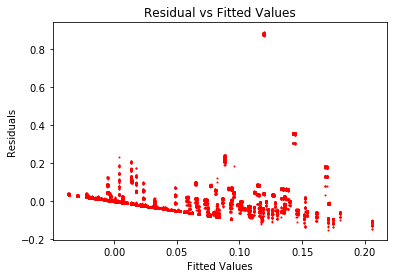

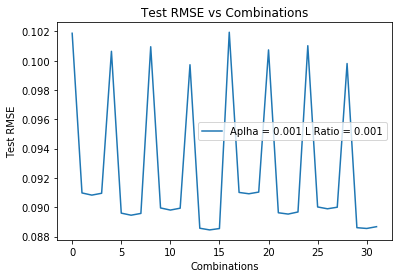

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08840950719355341)
('Training MSE for each fold : ', [0.007866534278601773, 0.007761620463586825, 0.0077397524615229266, 0.007858376103108862, 0.007610283543183057, 0.00794943371340854, 0.007825412693025065, 0.007665174503995475, 0.007896967057843065, 0.00786987133327968], '\n\n')
('Testing MSE for each fold : ', [0.007259792554826941, 0.008201638845149626, 0.008395381759949212, 0.00732752147037629, 0.009580338418778598, 0.006521816910111877, 0.007628954057546341, 0.009075202768018549, 0.006980955225255342, 0.007227488170007395], '\n\n')
('Training RMSE:', 0.08834219045934692)
('Testing RMSE:', 0.08843024945120317)


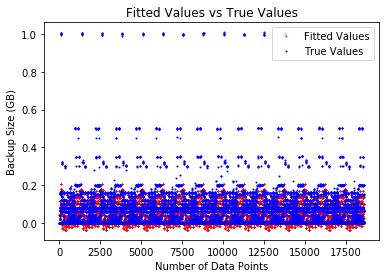

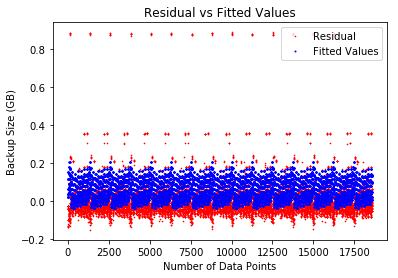

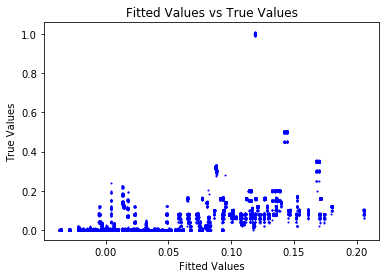

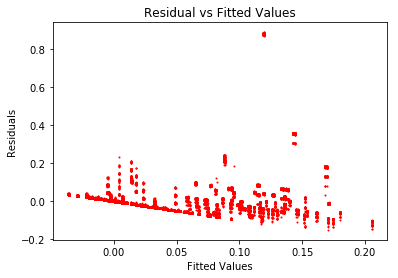

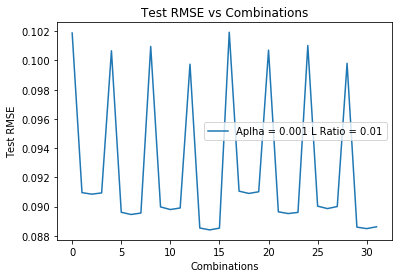

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 30, '\tTestRMSE: ', 0.08843481153245324)
('Training MSE for each fold : ', [0.007813544811501063, 0.00794593899391259, 0.00792833509413097, 0.007871868503182711, 0.007688492094697173, 0.007385670943210463, 0.007909036684213017, 0.00775313214940949, 0.007720437524509515, 0.008025298872694452], '\n\n')
('Testing MSE for each fold : ', [0.007733677097763846, 0.00654801705615116, 0.006712814037924421, 0.007211564526679228, 0.008873120539696768, 0.011617360974156596, 0.006873884854524264, 0.008288817681146338, 0.008579984234990302, 0.005836077911402407], '\n\n')
('Training RMSE:', 0.08834124499431815)
('Testing RMSE:', 0.08847334000388779)


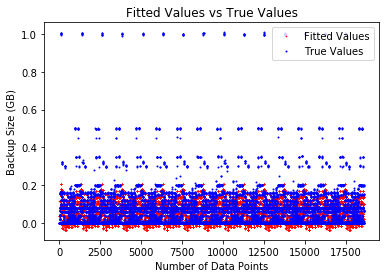

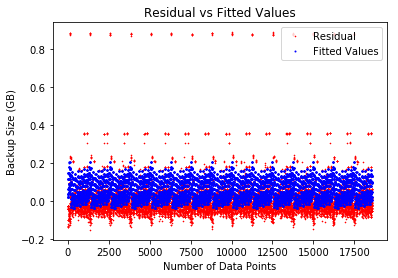

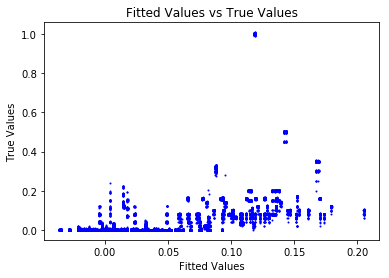

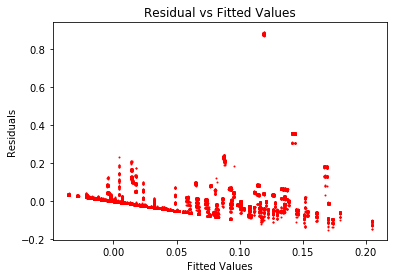

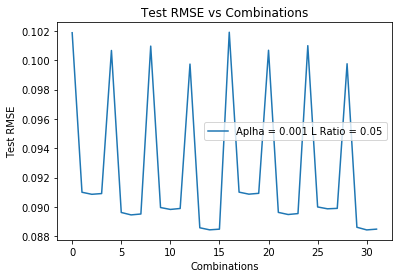

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08841957172401071)
('Training MSE for each fold : ', [0.007705916651660652, 0.007999907397518193, 0.007783450460880719, 0.007787059411077416, 0.007723923707856275, 0.008179253128377655, 0.007832219778736388, 0.007629493775227319, 0.007583109996524625, 0.007828706735910908], '\n\n')
('Testing MSE for each fold : ', [0.008724754464509678, 0.00606947182172445, 0.008031161824882298, 0.007989455359831144, 0.00856639793270927, 0.004458312440749199, 0.007579075163171064, 0.009417145482750454, 0.009829998948656715, 0.007618624635202901], '\n\n')
('Training RMSE:', 0.08834763213791876)
('Testing RMSE:', 0.08847847086957775)


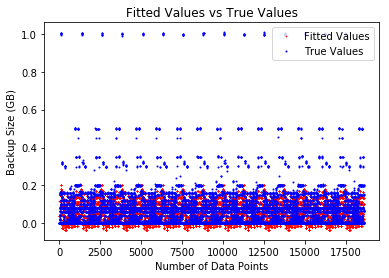

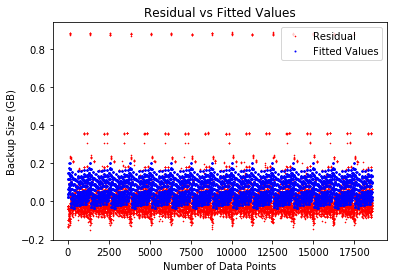

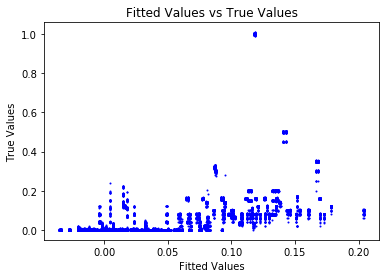

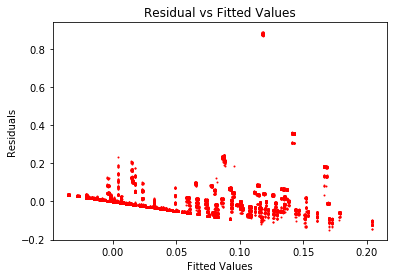

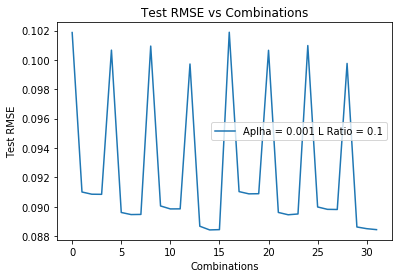

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 15, '\tTestRMSE: ', 0.08843639076440199)
('Training MSE for each fold : ', [0.007739121395593467, 0.00785779693833628, 0.00792555262728997, 0.007577661208700855, 0.007614841901428286, 0.008088359597736973, 0.007798590439413331, 0.007875308248708827, 0.0077738054056978294, 0.007836572552262803], '\n\n')
('Testing MSE for each fold : ', [0.008471311023541324, 0.007368845209354571, 0.006753395397846077, 0.009917926136147717, 0.009587281965947414, 0.005309567337813491, 0.007908128832010811, 0.0072123318160265005, 0.008144430483575396, 0.00756251527253844], '\n\n')
('Training RMSE:', 0.08836719431733059)
('Testing RMSE:', 0.08845096578036994)


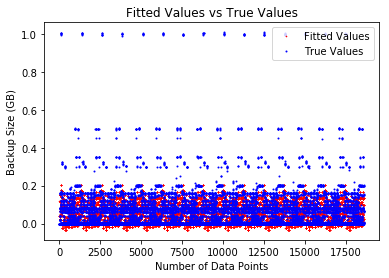

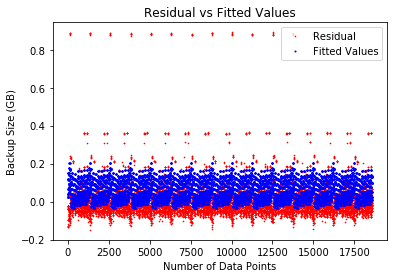

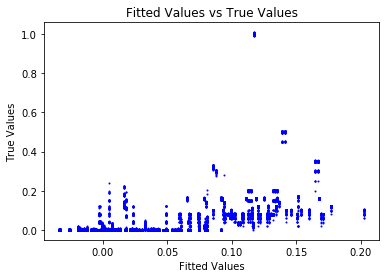

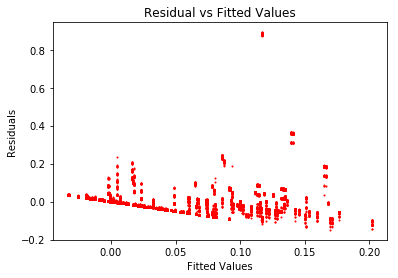

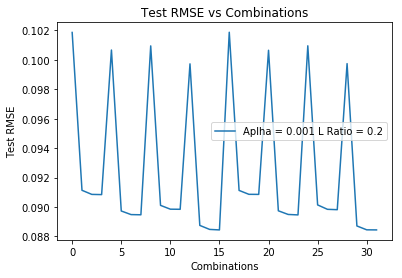

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 31, '\tTestRMSE: ', 0.08851749803620217)
('Training MSE for each fold : ', [0.007769930850510156, 0.00799947864621405, 0.00812689802049971, 0.00807011253235499, 0.007651832788291168, 0.007692222407427141, 0.0077519281047790075, 0.0078365930874368, 0.007744637687621659, 0.007627105677820666], '\n\n')
('Testing MSE for each fold : ', [0.008363846010792174, 0.006266184016158938, 0.005095086185818607, 0.005638306484096997, 0.009439570618796918, 0.009092466461146378, 0.008522099010212211, 0.007753976372698963, 0.008595332873415091, 0.009671119529713206], '\n\n')
('Training RMSE:', 0.08847075211783573)
('Testing RMSE:', 0.08856522317639666)


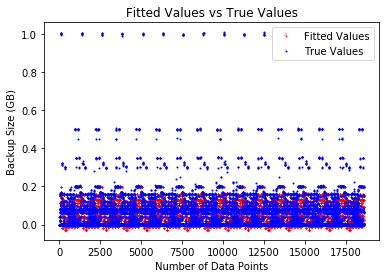

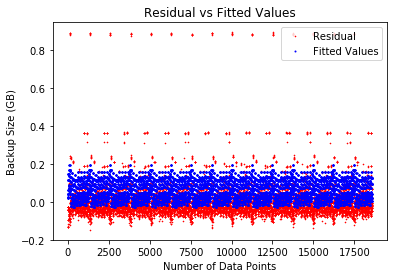

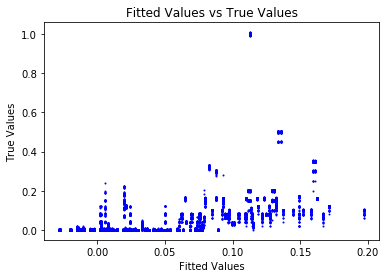

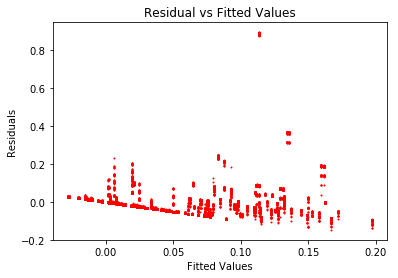

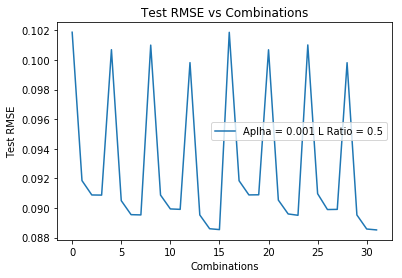

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 31, '\tTestRMSE: ', 0.08865172523691568)
('Training MSE for each fold : ', [0.007686319089133292, 0.007891511082924418, 0.007563999279908266, 0.007931843031297662, 0.00766571818242499, 0.007906399404068273, 0.007935296219049547, 0.007804964251142036, 0.00805671481475853, 0.008018720090279551], '\n\n')
('Testing MSE for each fold : ', [0.009308325149095813, 0.007457728414683729, 0.010458535371568387, 0.007058141619800362, 0.009510362714315587, 0.00730015716865932, 0.007047601459102046, 0.00825322613980735, 0.00593160677513427, 0.006264684349919856], '\n\n')
('Training RMSE:', 0.08857848804590569)
('Testing RMSE:', 0.0886512093330298)


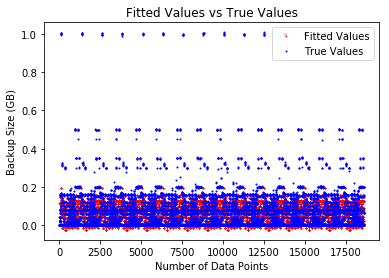

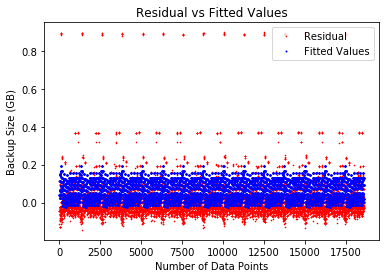

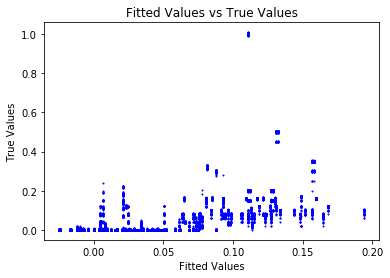

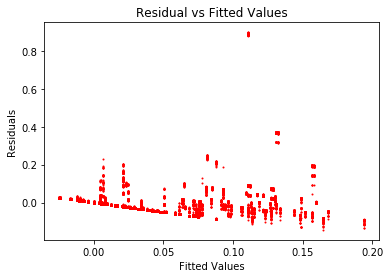

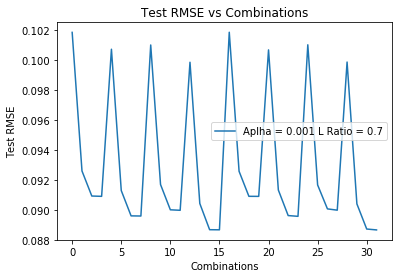

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 31, '\tTestRMSE: ', 0.08877157278316636)
('Training MSE for each fold : ', [0.0080429353469151, 0.007933704832692233, 0.00797975249512051, 0.007758517064573698, 0.007679279974817281, 0.007761093689766687, 0.00794470859286882, 0.007993053888173991, 0.007738989335504324, 0.007857912669064956], '\n\n')
('Testing MSE for each fold : ', [0.006274576521957843, 0.0072825630422074265, 0.006848301209837991, 0.00892268796805274, 0.009654042216586922, 0.00888843626417207, 0.007184687051671044, 0.006720852641425456, 0.009059180874379362, 0.00795602462127251], '\n\n')
('Training RMSE:', 0.0887073547624421)
('Testing RMSE:', 0.08876449313298836)


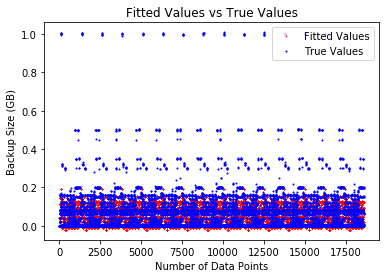

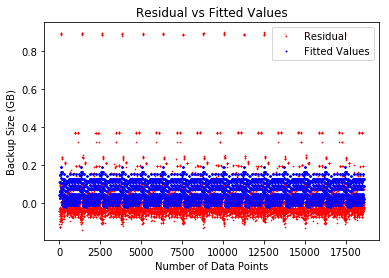

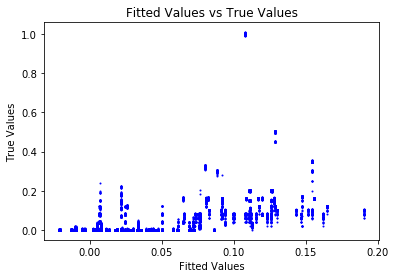

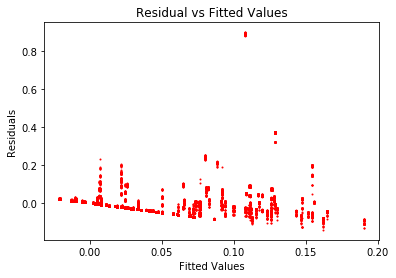

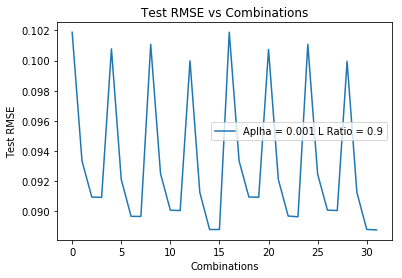

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 31, '\tTestRMSE: ', 0.08885290627083242)
('Training MSE for each fold : ', [0.007990399285684926, 0.007762707228074512, 0.007784348134750733, 0.00766804414005084, 0.008006801895873494, 0.007906713279606662, 0.007853051448001256, 0.007892059683026824, 0.007985244367732628, 0.007952645224547358], '\n\n')
('Testing MSE for each fold : ', [0.0068796863743677585, 0.008982125987942147, 0.008747892043889916, 0.00989247016423663, 0.006720126346359536, 0.0077053425899010295, 0.008128656962623161, 0.007735882023950007, 0.00690948697931154, 0.0071982262925967995], '\n\n')
('Training RMSE:', 0.08877049886496596)
('Testing RMSE:', 0.08882561329097509)


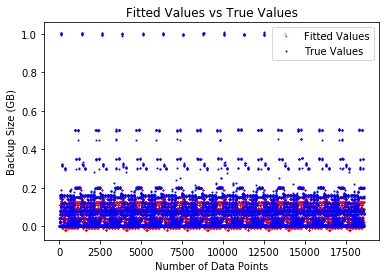

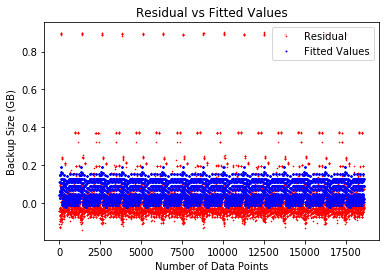

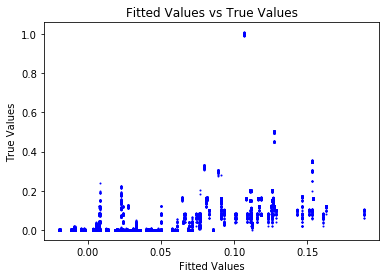

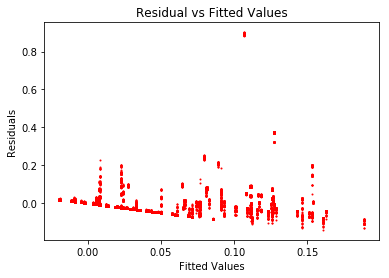

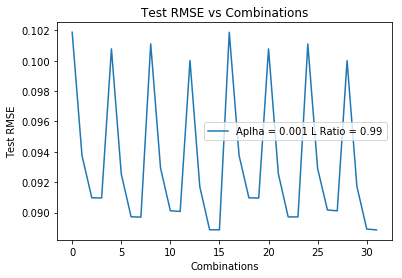

('For alpha: ', 0.001, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 31, '\tTestRMSE: ', 0.0888325669892301)
('Training MSE for each fold : ', [0.00785554893721758, 0.007817705133190791, 0.007854971944449611, 0.007812718072287535, 0.00784929400621681, 0.00796623682477699, 0.007814251308259672, 0.007909342471470323, 0.007964170023298932, 0.00797253518141822], '\n\n')
('Testing MSE for each fold : ', [0.008146082707778151, 0.00850400308542599, 0.008085569961743016, 0.008525759495796969, 0.008189864695548003, 0.007112814895313481, 0.008504620268907465, 0.007621901788555356, 0.007164411589783412, 0.007038688058825207], '\n\n')
('Training RMSE:', 0.08877881160647874)
('Testing RMSE:', 0.08882213493700603)


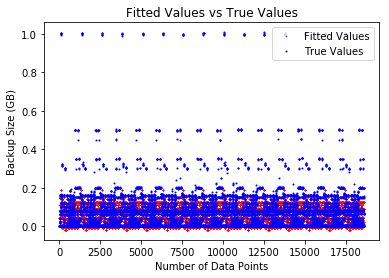

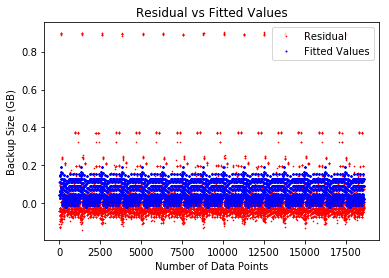

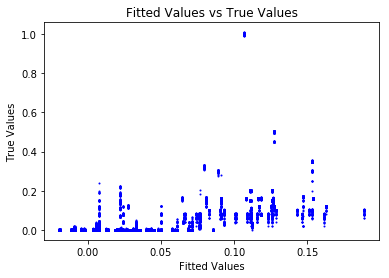

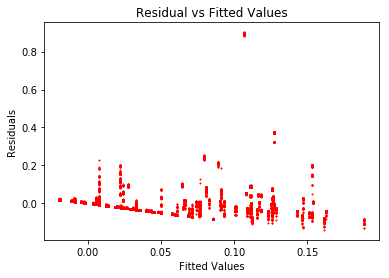

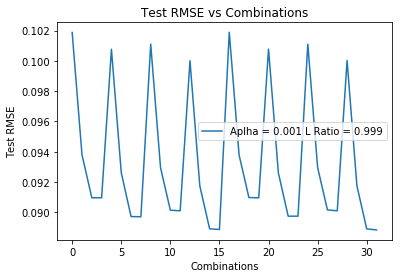

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08849935660492783)
('Training MSE for each fold : ', [0.007949484430887055, 0.007588493302380176, 0.007595163790794758, 0.007708664073268081, 0.007987954971334385, 0.007829242627651627, 0.007910474882652044, 0.0078049177084056785, 0.00784342456926705, 0.007909913856732221], '\n\n')
('Testing MSE for each fold : ', [0.006592880508322992, 0.00988518289316182, 0.009813744943367737, 0.008772342530363906, 0.006224397450202663, 0.007695878658216556, 0.006942094088462949, 0.007901881116038446, 0.007534274156085366, 0.006968726563465737], '\n\n')
('Training RMSE:', 0.08838989433943967)
('Testing RMSE:', 0.08850502974842062)


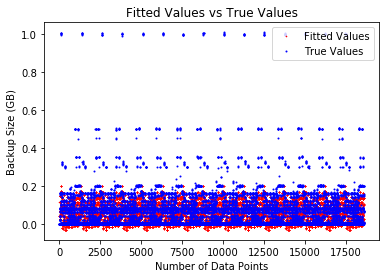

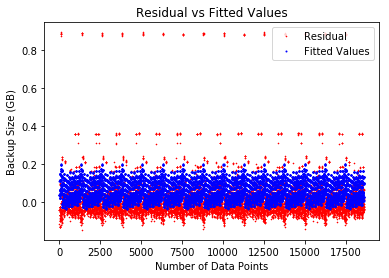

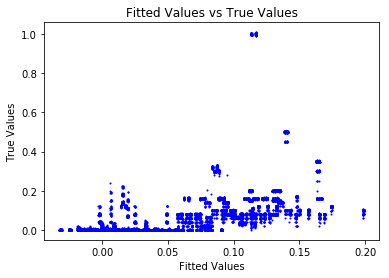

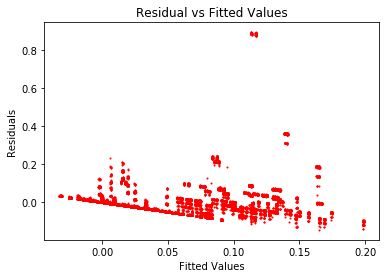

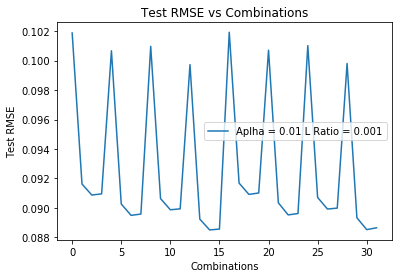

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 14, '\tTestRMSE: ', 0.08848711446581167)
('Training MSE for each fold : ', [0.0077539300899406235, 0.007616161274161333, 0.007952964454780694, 0.007791674469177816, 0.008014204702599987, 0.007558336163136118, 0.00803945733109817, 0.007847109717622768, 0.007746126868449231, 0.00785313009069508], '\n\n')
('Testing MSE for each fold : ', [0.008408657647758258, 0.009686783758691201, 0.006583904701004308, 0.008070458884884935, 0.0060531611026638675, 0.010209190949455039, 0.005830986248828468, 0.0075392887843845294, 0.008503728235707978, 0.007492500177959976], '\n\n')
('Training RMSE:', 0.08841555019433053)
('Testing RMSE:', 0.08853172340542036)


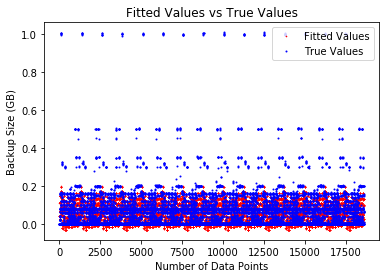

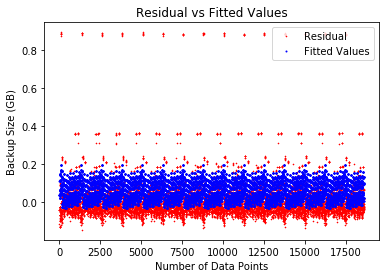

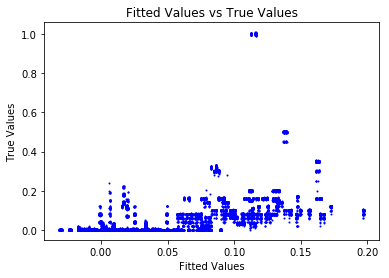

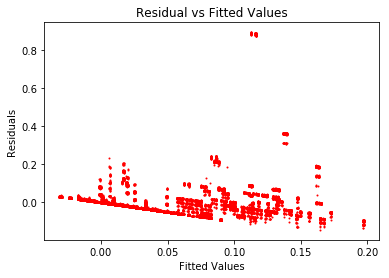

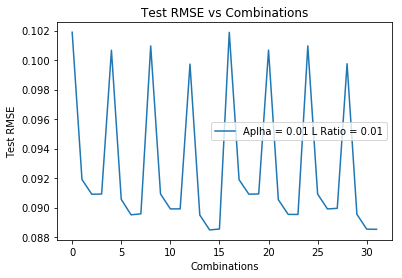

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 31, '\tTestRMSE: ', 0.08865705281127235)
('Training MSE for each fold : ', [0.00768606689399903, 0.00801090630158171, 0.007531052636034188, 0.008002447919487647, 0.007781021657192265, 0.007831646740525108, 0.007943041486254672, 0.007838880898254522, 0.007930239436639881, 0.007959631337053198], '\n\n')
('Testing MSE for each fold : ', [0.009414615422252842, 0.0064217457109676974, 0.010825809518934403, 0.00646603882858893, 0.008476490197864055, 0.008027357531633802, 0.007015545007430724, 0.007988067452247803, 0.007122030945994883, 0.006874782512706121], '\n\n')
('Training RMSE:', 0.08860865381384722)
('Testing RMSE:', 0.08867495877000521)


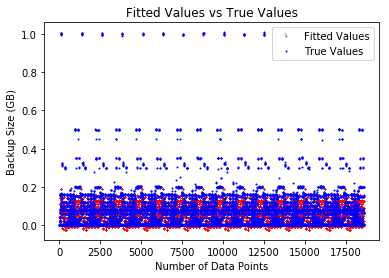

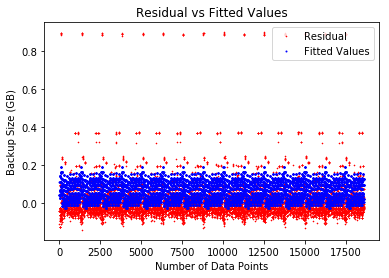

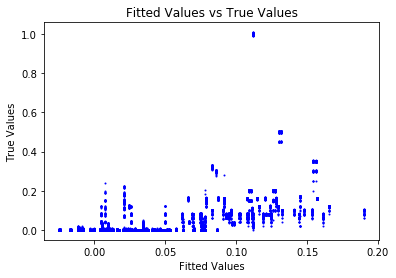

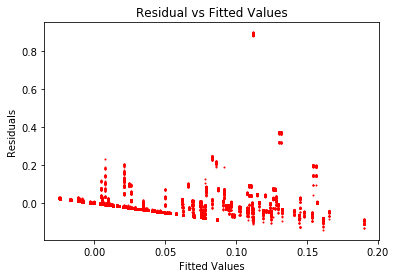

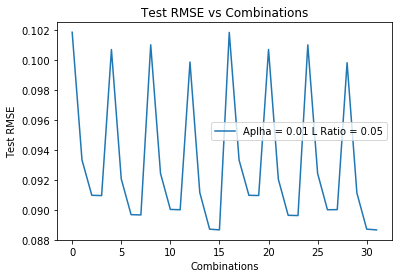

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 15, '\tTestRMSE: ', 0.089032886176531)
('Training MSE for each fold : ', [0.00802278020481436, 0.007799226218365, 0.007598363172233428, 0.007969642844295409, 0.007874526340452864, 0.007969419282127806, 0.008105118104627895, 0.007873604019204297, 0.008103054395102264, 0.007838643981578578], '\n\n')
('Testing MSE for each fold : ', [0.006894693815545693, 0.00904940567874749, 0.010944402279914275, 0.00742260930742657, 0.008264934457324501, 0.007409875276072786, 0.006176722009861761, 0.008273385810819564, 0.006216511877171596, 0.008593820063623001], '\n\n')
('Training RMSE:', 0.08896874651404385)
('Testing RMSE:', 0.0890204249464735)


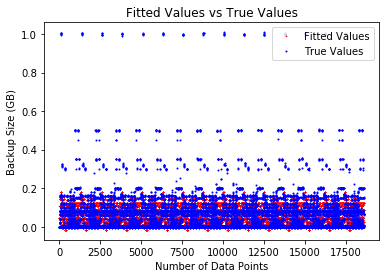

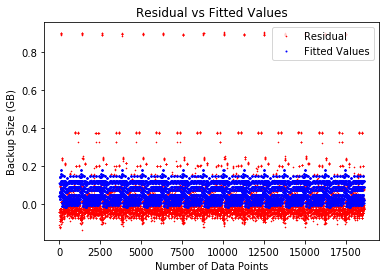

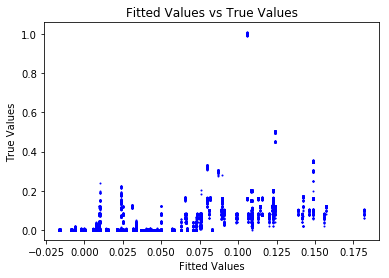

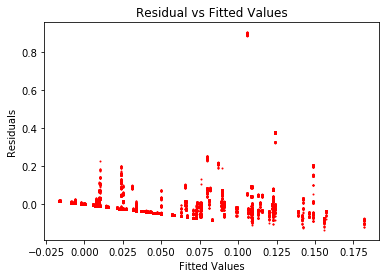

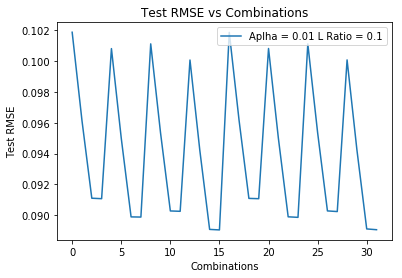

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 31, '\tTestRMSE: ', 0.09000391988702751)
('Training MSE for each fold : ', [0.008227693471460127, 0.00820024841834767, 0.008035023492905611, 0.008077780904493534, 0.007872443737357463, 0.008016120085688751, 0.008340278170290906, 0.007974154694958461, 0.00811265713216526, 0.008084395737204436], '\n\n')
('Testing MSE for each fold : ', [0.006821923844081895, 0.007083116267023226, 0.008661879976147245, 0.008265026309138748, 0.010252119838588305, 0.008879136725085298, 0.005767247384501238, 0.009249656586678567, 0.00785586600611774, 0.008206085680813201], '\n\n')
('Training RMSE:', 0.08996710279033787)
('Testing RMSE:', 0.09002336286663339)


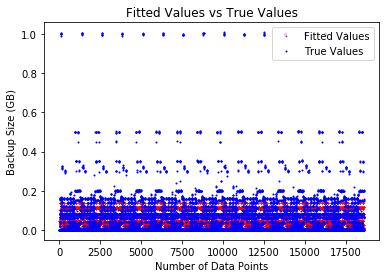

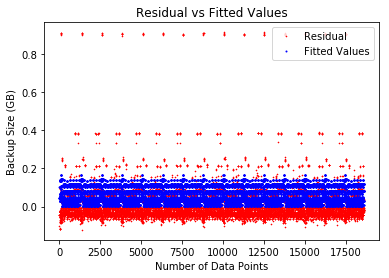

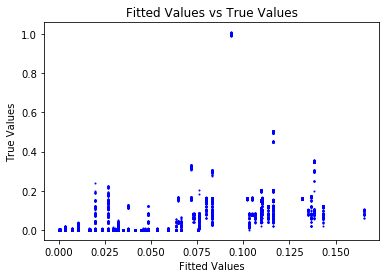

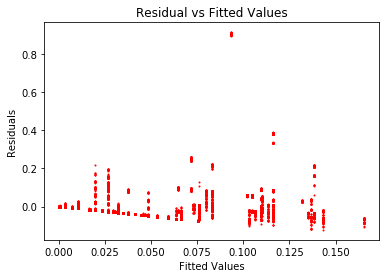

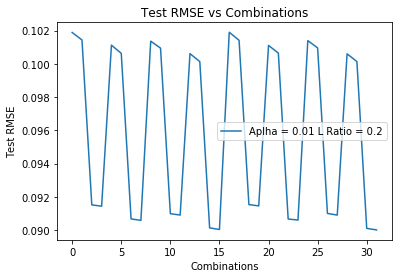

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 3, '\tTestRMSE: ', 0.09374405801226243)
('Training MSE for each fold : ', [0.008824041128248753, 0.00878002846300013, 0.009011016775043417, 0.008763780044226682, 0.008796589661007954, 0.008540335141307047, 0.008777180010311997, 0.00894783488049054, 0.008740637996017164, 0.008647316321227866], '\n\n')
('Testing MSE for each fold : ', [0.008277375023499924, 0.008803198460368143, 0.00683945780161054, 0.009081710245506382, 0.008618775578593037, 0.01094175743821763, 0.008808495584627391, 0.0073146359247076975, 0.009124988030730842, 0.010083111956809951], '\n\n')
('Training RMSE:', 0.0937169997497154)
('Testing RMSE:', 0.09375153654456632)


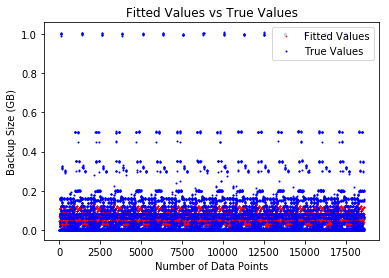

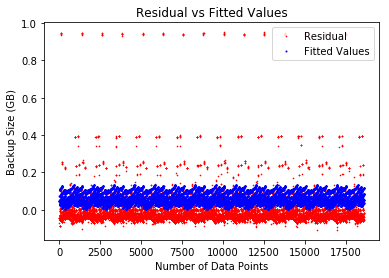

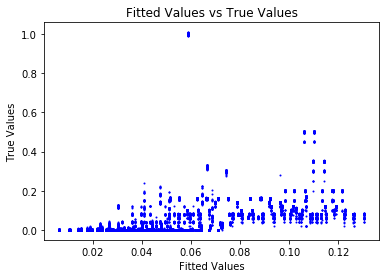

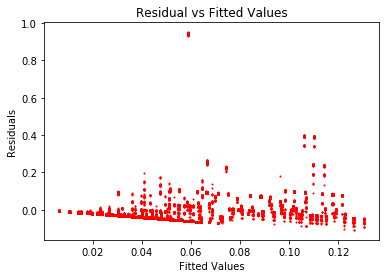

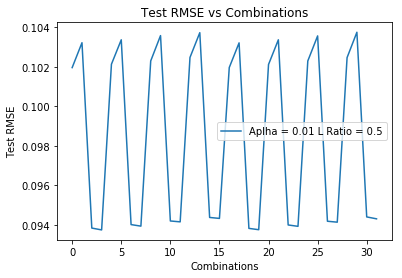

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 19, '\tTestRMSE: ', 0.09600340629735502)
('Training MSE for each fold : ', [0.009338025729072804, 0.0091010658616042, 0.009245259375733669, 0.009108764130002557, 0.009339890393969508, 0.009328941466478379, 0.009528231516441651, 0.009043071094415132, 0.008955127659314282, 0.009133233516651395], '\n\n')
('Testing MSE for each fold : ', [0.008075803169459286, 0.010220643134343482, 0.008889620677843699, 0.01012726005821717, 0.008034072293538315, 0.008224391331670878, 0.006310062968844969, 0.010787469432631832, 0.011488093037180446, 0.010015916180969473], '\n\n')
('Training RMSE:', 0.09598000351306701)
('Testing RMSE:', 0.0960069436471652)


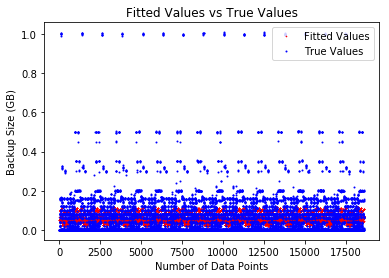

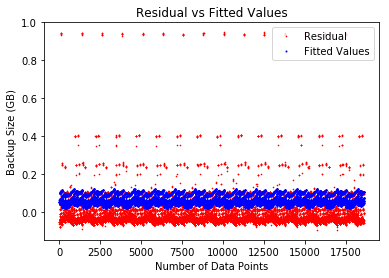

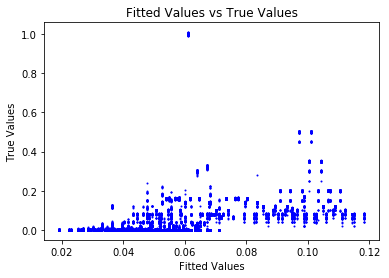

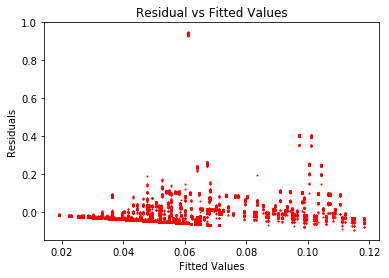

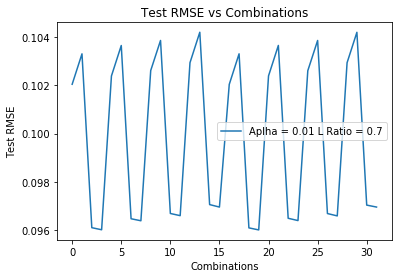

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 3, '\tTestRMSE: ', 0.09865839236306437)
('Training MSE for each fold : ', [0.009689856603553988, 0.009631853714501861, 0.00997609251579755, 0.009768382565238721, 0.009723667246276413, 0.009727211390623795, 0.009681650667731011, 0.009813948117583182, 0.009885675495063124, 0.009407307951516786], '\n\n')
('Testing MSE for each fold : ', [0.0101603423529026, 0.01052132758712722, 0.007405422135242423, 0.009370361708597886, 0.009848834059666259, 0.00953275482106806, 0.010477744316262161, 0.008900884862518136, 0.008432777370170593, 0.012701822072643105], '\n\n')
('Training RMSE:', 0.09864362435955323)
('Testing RMSE:', 0.09866725459147956)


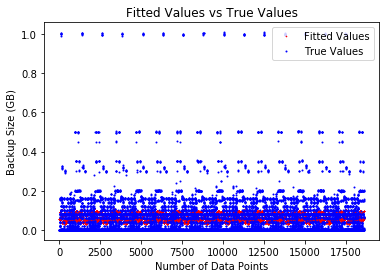

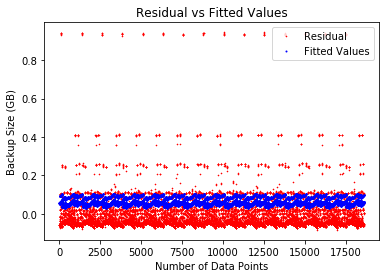

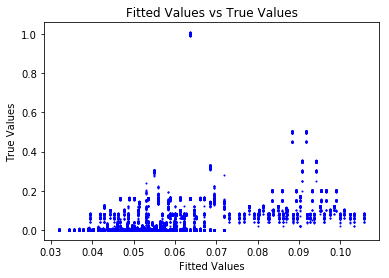

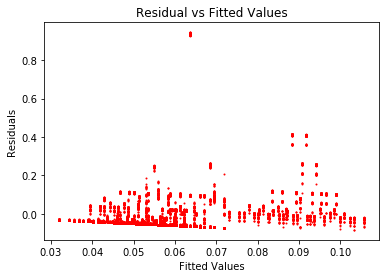

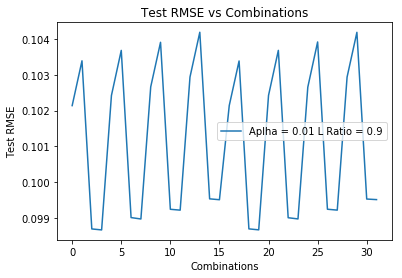

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 19, '\tTestRMSE: ', 0.09955029315421332)
('Training MSE for each fold : ', [0.009801754264227566, 0.01000233895167093, 0.01011934493375926, 0.009904159195310019, 0.00976295471467337, 0.009980329434508859, 0.009746061649081964, 0.009881040027362373, 0.0098307054209855, 0.010017364900640499], '\n\n')
('Testing MSE for each fold : ', [0.011096249910895133, 0.008916084656275254, 0.007964461219848042, 0.009871132499636715, 0.011334433376452393, 0.009048337574786456, 0.011190103486723703, 0.010147792693134339, 0.010650696625051257, 0.008881842060430467], '\n\n')
('Training RMSE:', 0.09952188377046545)
('Testing RMSE:', 0.09954955253703242)


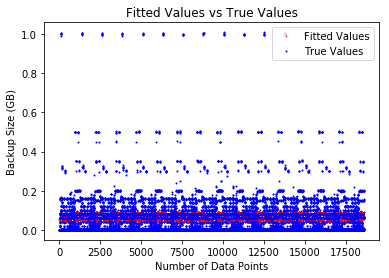

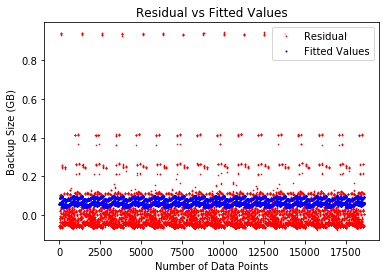

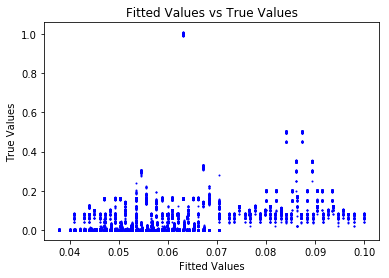

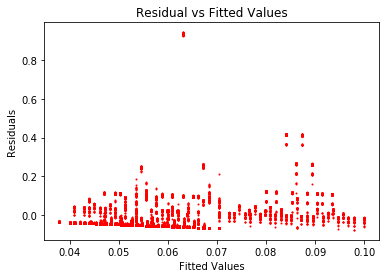

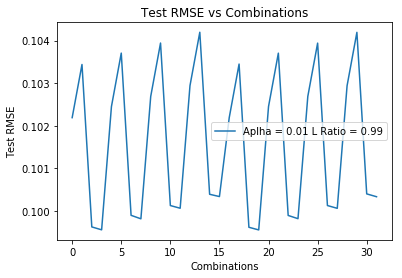

('For alpha: ', 0.01, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 3, '\tTestRMSE: ', 0.09963430585854312)
('Training MSE for each fold : ', [0.00999405525550249, 0.00999229676042709, 0.009809104899332342, 0.010033395766290058, 0.00990877079517014, 0.010111709295329162, 0.009726108610727454, 0.010013960605337595, 0.0095979514349469, 0.01004313415302153], '\n\n')
('Testing MSE for each fold : ', [0.00950873200921044, 0.009242886902525348, 0.01122565471117766, 0.008597618422248819, 0.010183735589414468, 0.008122433911770692, 0.011714960685365481, 0.009156389011153817, 0.012847646734226646, 0.008689905243079582], '\n\n')
('Training RMSE:', 0.09961450073964372)
('Testing RMSE:', 0.09964434917253107)


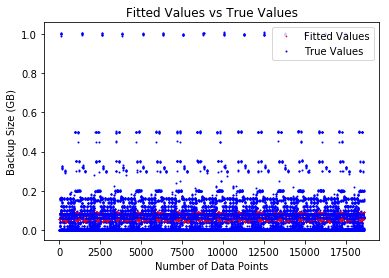

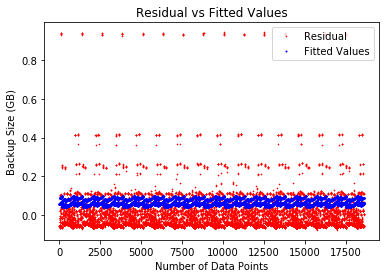

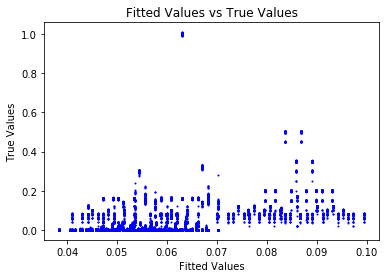

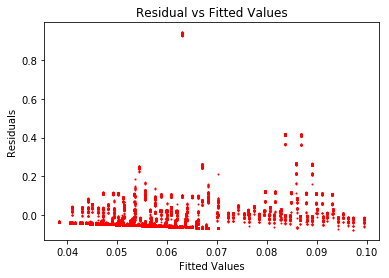

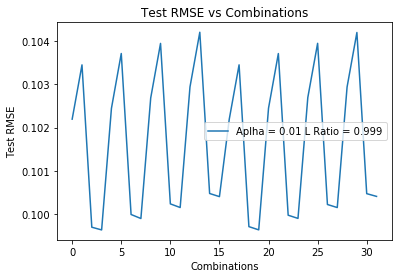

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 15, '\tTestRMSE: ', 0.09031932777943458)
('Training MSE for each fold : ', [0.008003409929254161, 0.008203358668151027, 0.008345677181416905, 0.007965627002483103, 0.007896939532411874, 0.007965797431510118, 0.008316013929622551, 0.008320831645530394, 0.008249546048911843, 0.008144505808005196], '\n\n')
('Testing MSE for each fold : ', [0.009359765784423173, 0.007614152895366318, 0.00624424860457827, 0.009806723525558492, 0.010444535591154514, 0.009794350457430089, 0.006511449167925669, 0.006483162102560078, 0.007163829055346429, 0.008135332256796175], '\n\n')
('Training RMSE:', 0.0902284363032504)
('Testing RMSE:', 0.09030921848911062)


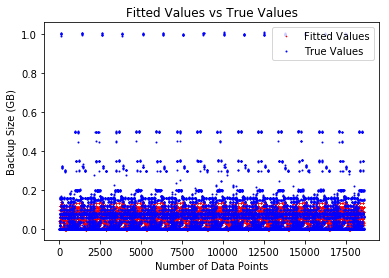

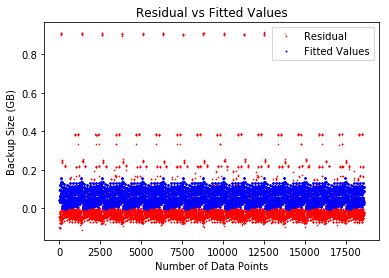

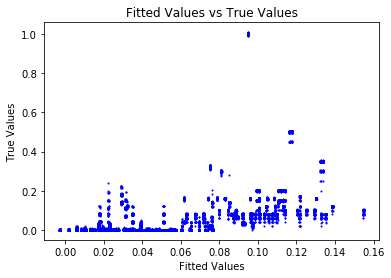

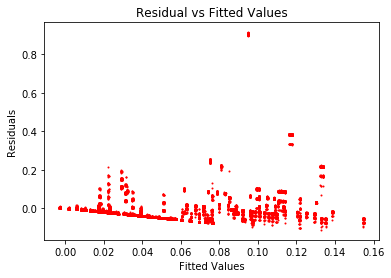

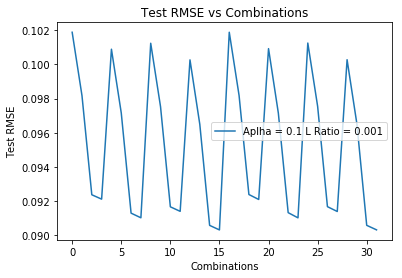

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 15, '\tTestRMSE: ', 0.09153293435646205)
('Training MSE for each fold : ', [0.008187762610052673, 0.008219455587289353, 0.008493463366294933, 0.008305443140569257, 0.008414406935257454, 0.00843304734394089, 0.008221846686337882, 0.00849978373705816, 0.00851070334678489, 0.008418548688432816], '\n\n')
('Testing MSE for each fold : ', [0.010162342439402183, 0.009879308165600948, 0.007201640287664977, 0.008880642641156018, 0.007998249270424782, 0.007810625131101257, 0.009784792230545944, 0.007157777600566931, 0.006989021216587049, 0.007916470909481471], '\n\n')
('Training RMSE:', 0.09149014233348765)
('Testing RMSE:', 0.09153189055871815)


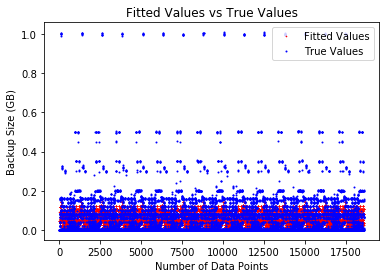

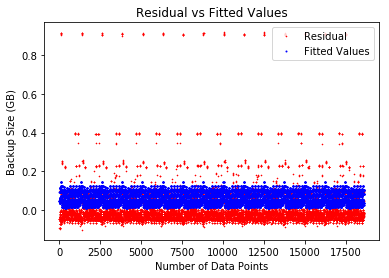

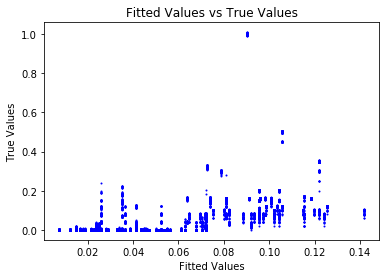

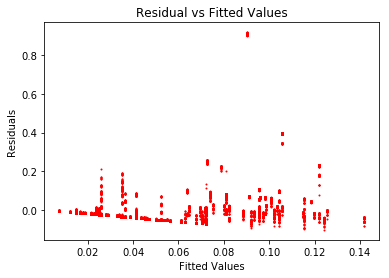

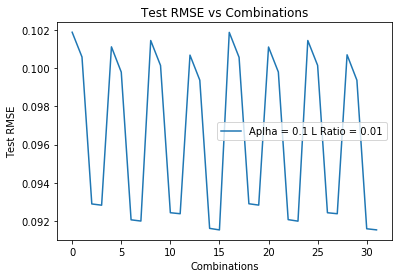

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 19, '\tTestRMSE: ', 0.09597417989706167)
('Training MSE for each fold : ', [0.009259669423267315, 0.009447572848864036, 0.009134643558395723, 0.009221148863730497, 0.009153172361930348, 0.009160369608857676, 0.009360962154415864, 0.009137476242914867, 0.009093510969180096, 0.009110471861325664], '\n\n')
('Testing MSE for each fold : ', [0.008795886122966537, 0.006945587191553203, 0.009953130819701454, 0.009021763860887731, 0.009828100829562508, 0.009766871827020355, 0.00772758030314786, 0.009859381586852291, 0.01015666350569613, 0.010065727184795986], '\n\n')
('Training RMSE:', 0.09595780212826993)
('Testing RMSE:', 0.0959795255417446)


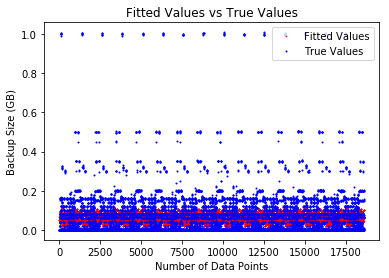

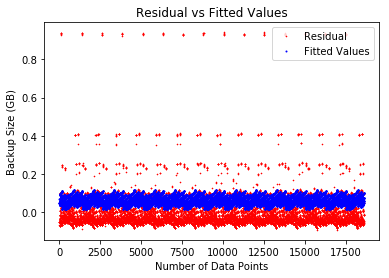

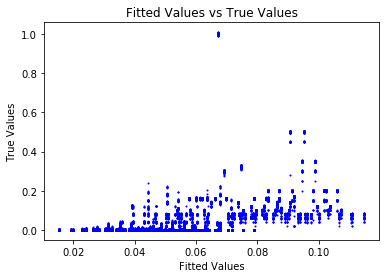

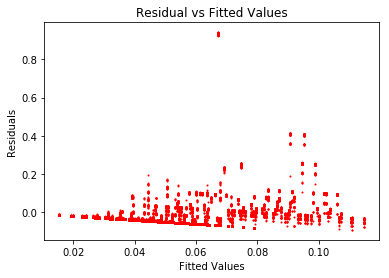

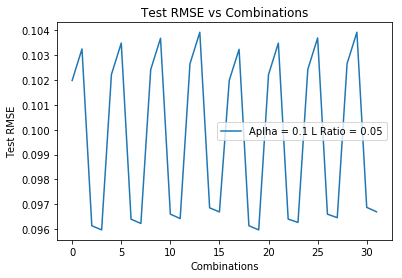

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 2, '\tTestRMSE: ', 0.1004779170989483)
('Training MSE for each fold : ', [0.010332177563642218, 0.010000276703142633, 0.00987771898561249, 0.01022180882778508, 0.009886325396271432, 0.010013522658846379, 0.00992106521264927, 0.010386994239783948, 0.01030298750305652, 0.009971304069531261], '\n\n')
('Testing MSE for each fold : ', [0.00784473976379537, 0.010871064084893042, 0.011916200582540714, 0.008934972937679996, 0.012067279550063911, 0.010820656344082065, 0.0116523744801594, 0.0074010505232109626, 0.008156997148035743, 0.01131665331062336], '\n\n')
('Training RMSE:', 0.1004560506690967)
('Testing RMSE:', 0.10048979486748122)


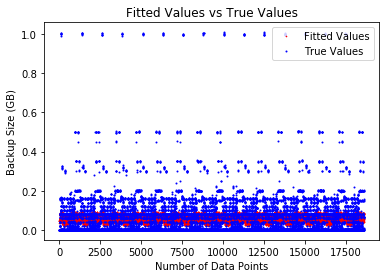

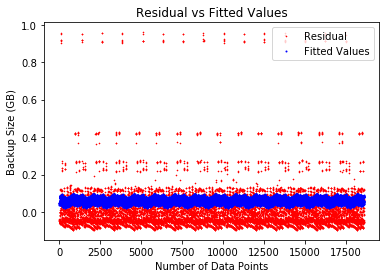

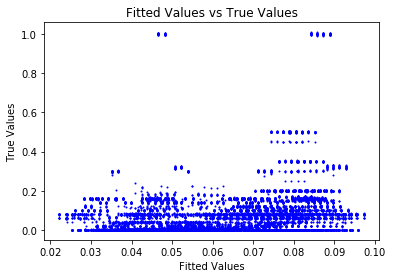

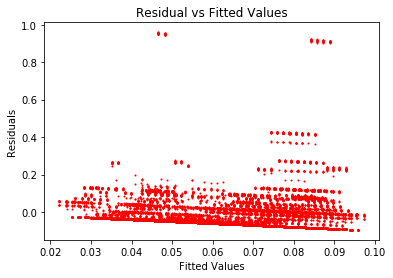

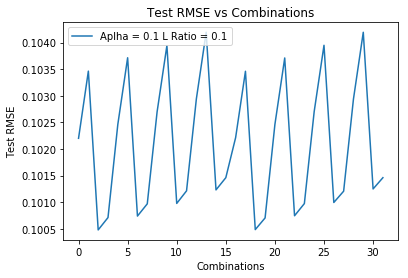

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 4, '\tTestRMSE: ', 0.10283875802193461)
('Training MSE for each fold : ', [0.010449418076866593, 0.01040857884230694, 0.010469670969162537, 0.010832009681925369, 0.010603060450868134, 0.010666203576453143, 0.010404840698698367, 0.01059992047680517, 0.01074763696566358, 0.010542365656809851], '\n\n')
('Testing MSE for each fold : ', [0.011706596645323383, 0.012099969970829367, 0.011514849279882193, 0.008189745918329865, 0.010331627438396877, 0.009710562265103641, 0.012064824963851774, 0.010355687481313436, 0.008979450040749945, 0.010821052265889945], '\n\n')
('Training RMSE:', 0.10282203333700403)
('Testing RMSE:', 0.10284666560937716)


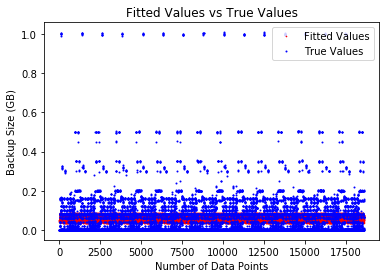

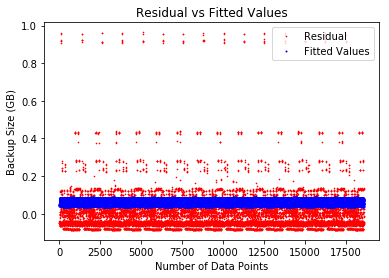

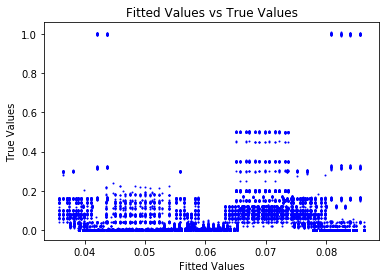

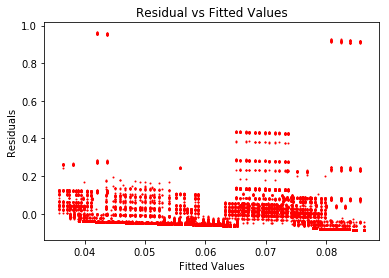

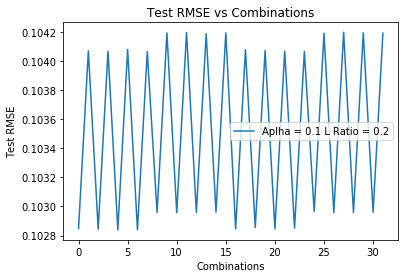

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 6, '\tTestRMSE: ', 0.10309513950520252)
('Training MSE for each fold : ', [0.010636714620104796, 0.010147478436628922, 0.010766016339438966, 0.010743043685727522, 0.010749147851713194, 0.010558329241870676, 0.010638676755662494, 0.01058164624150691, 0.01080982415930783, 0.01063524814604141], '\n\n')
('Testing MSE for each fold : ', [0.010537004929215363, 0.015020067321093436, 0.009317374286476558, 0.009582217359412205, 0.009522720093905462, 0.011202480490846834, 0.010493447720472946, 0.01103422364726849, 0.008979737469715742, 0.010608471702139997], '\n\n')
('Training RMSE:', 0.10308546234945194)
('Testing RMSE:', 0.10310079777603422)


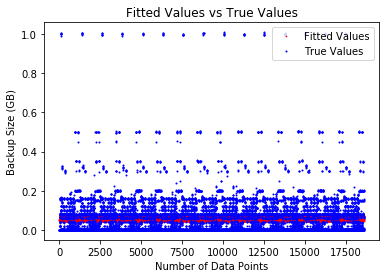

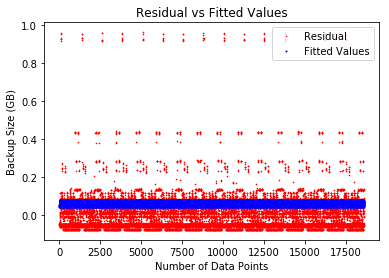

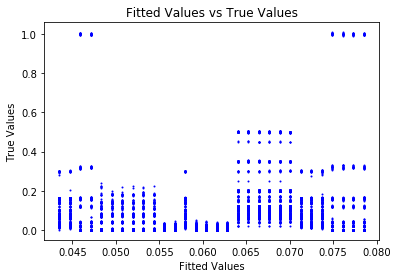

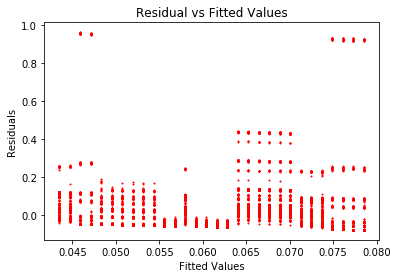

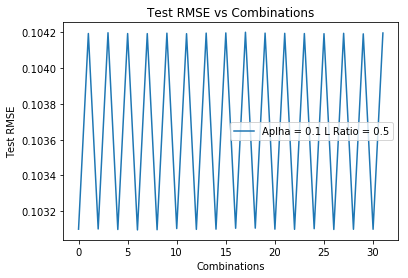

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 6, '\tTestRMSE: ', 0.10325140917340968)
('Training MSE for each fold : ', [0.010541413284060422, 0.010417105239028855, 0.010517226995108113, 0.010875067480923335, 0.010646762984002373, 0.010711207742864272, 0.010681173361996756, 0.01096125981493052, 0.010470294334565951, 0.010769500176821946], '\n\n')
('Testing MSE for each fold : ', [0.01172788012225089, 0.012890795347893178, 0.011953287863974675, 0.008689505398415598, 0.010725553496394811, 0.010205804275093785, 0.01045281275913655, 0.00791043569383374, 0.012361716148799252, 0.009696631942493796], '\n\n')
('Training RMSE:', 0.10324292296051218)
('Testing RMSE:', 0.10325426046816968)


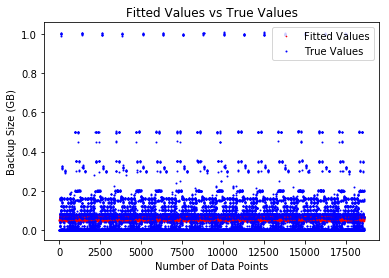

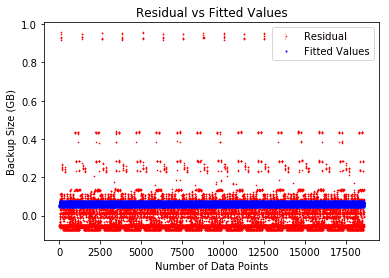

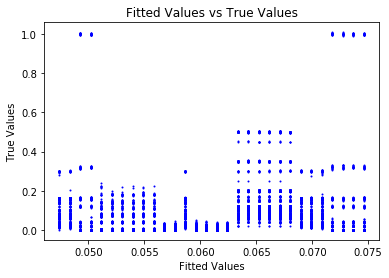

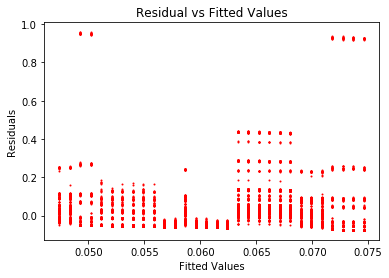

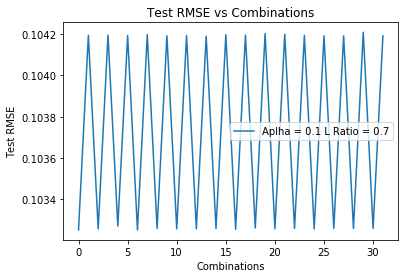

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 8, '\tTestRMSE: ', 0.10346102350171835)
('Training MSE for each fold : ', [0.010625737899292909, 0.010894297914941628, 0.010761418962664564, 0.010807691183132326, 0.010772271388723135, 0.010659606755712137, 0.010607428332946445, 0.010361642124112308, 0.010647534203827618, 0.010885672436650486], '\n\n')
('Testing MSE for each fold : ', [0.011435879978813556, 0.009030074427469567, 0.010098965430012236, 0.00978855587597422, 0.009971194498322499, 0.011157140324234455, 0.011519056667071549, 0.013788012422275842, 0.011179311372560499, 0.009082525818647762], '\n\n')
('Training RMSE:', 0.10345206677587623)
('Testing RMSE:', 0.10346531632164575)


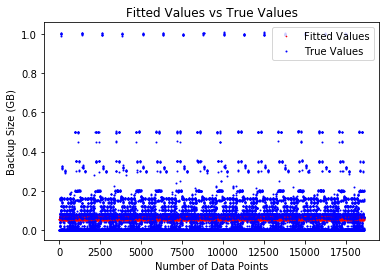

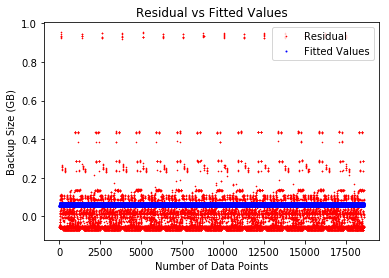

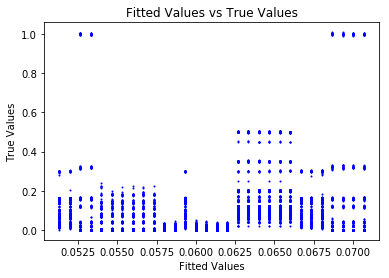

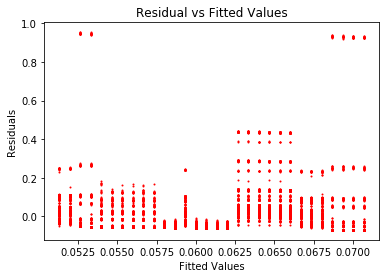

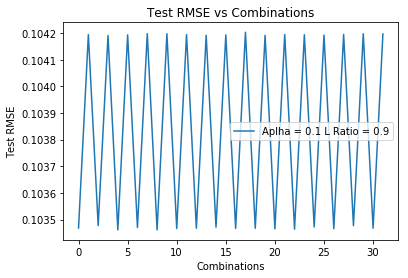

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 12, '\tTestRMSE: ', 0.10356932564016746)
('Training MSE for each fold : ', [0.010511890623587442, 0.010745643009805341, 0.010728396140254436, 0.010644029684679524, 0.010777445019083537, 0.01084918376278857, 0.010704884329860092, 0.010798750106671574, 0.010674791954133699, 0.010818669527133213], '\n\n')
('Testing MSE for each fold : ', [0.012673253816573745, 0.01049546603662761, 0.010697775530564141, 0.01152060339305375, 0.010257946475234642, 0.009576298900012065, 0.01102519810958119, 0.010012437360388805, 0.011212831410990899, 0.009802209470784333], '\n\n')
('Training RMSE:', 0.10356335459900738)
('Testing RMSE:', 0.10357317244528681)


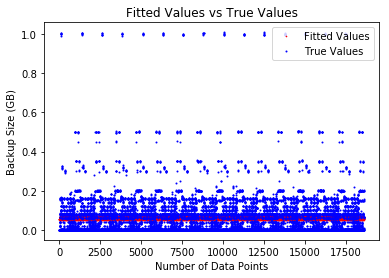

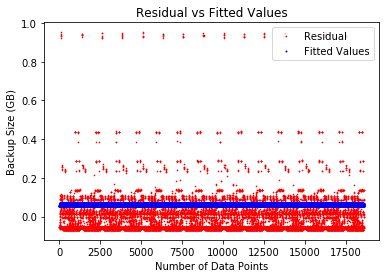

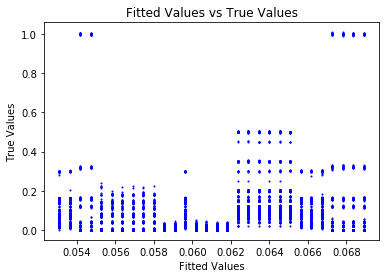

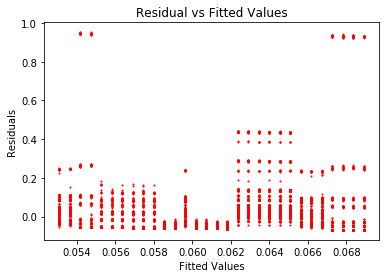

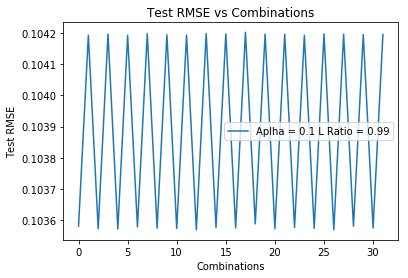

('For alpha: ', 0.1, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 4, '\tTestRMSE: ', 0.10358120342155354)
('Training MSE for each fold : ', [0.01067387686627875, 0.010728229843373549, 0.010989403501820736, 0.010709218947233538, 0.010505671421151453, 0.010640286108423266, 0.011015226052464872, 0.010506685892176595, 0.010868580182933884, 0.010640164111802653], '\n\n')
('Testing MSE for each fold : ', [0.011294535742487472, 0.010788132243645143, 0.008417072055479135, 0.01080681682190747, 0.012698990737735954, 0.011447691949906491, 0.008184296304432959, 0.012646973474350216, 0.009438072200747806, 0.011584107012276247], '\n\n')
('Training RMSE:', 0.10357477633461695)
('Testing RMSE:', 0.10358894175681539)


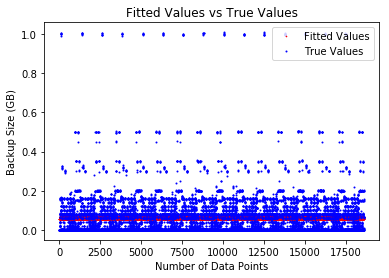

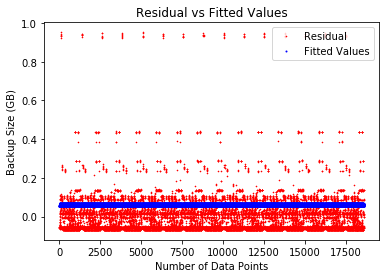

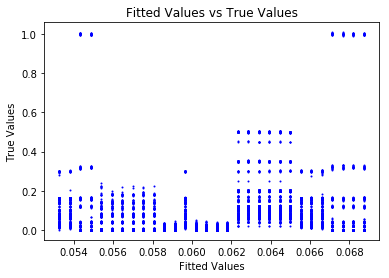

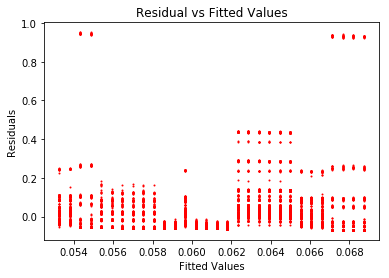

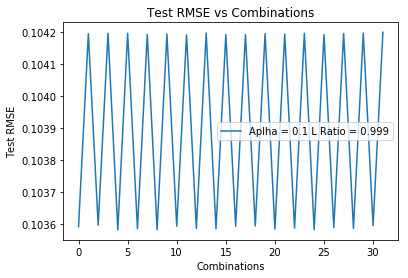

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 15, '\tTestRMSE: ', 0.09262938105602625)
('Training MSE for each fold : ', [0.008641038408923909, 0.008533997896071946, 0.008401542411843906, 0.00863766418412992, 0.008571743631772795, 0.008582813311754414, 0.008695172881200528, 0.008438544961249078, 0.008708399304459042, 0.00850126936969643], '\n\n')
('Testing MSE for each fold : ', [0.007998306099745662, 0.008884698086900527, 0.010113741746440322, 0.008008042950900768, 0.008560063011392664, 0.008537148859926662, 0.007402046286567108, 0.009845842367700386, 0.007277715986036548, 0.009184065286568063], '\n\n')
('Training RMSE:', 0.09258087619001128)
('Testing RMSE:', 0.09263458894072922)


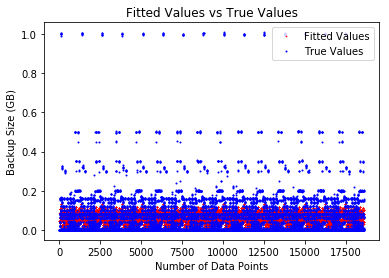

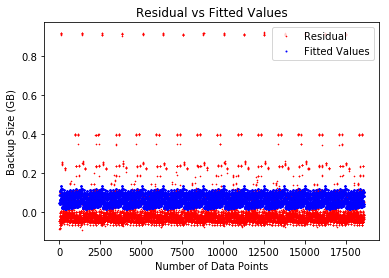

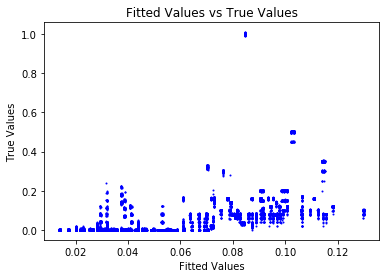

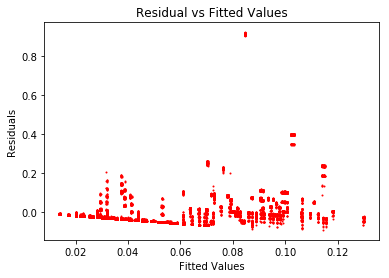

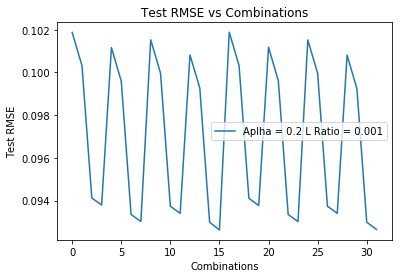

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 6, '\tTestRMSE: ', 0.09498236121308301)
('Training MSE for each fold : ', [0.009067714169905289, 0.008981295422986955, 0.009017917836511487, 0.008930044225145537, 0.009204295813724851, 0.009011066471502934, 0.008783815039734825, 0.008940793008089188, 0.009280699773201366, 0.008932152633333914], '\n\n')
('Testing MSE for each fold : ', [0.008544428855522253, 0.009301379764513949, 0.008962396428367107, 0.009685543763305493, 0.007355610529385004, 0.009056615908486276, 0.011217545596942862, 0.009658278617417717, 0.006626125076389869, 0.00982537495907057], '\n\n')
('Training RMSE:', 0.09494724555990887)
('Testing RMSE:', 0.09499120985617622)


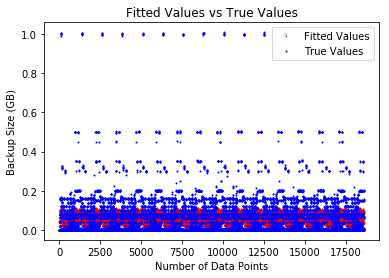

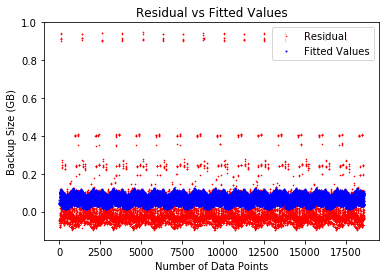

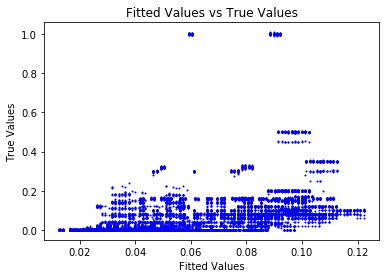

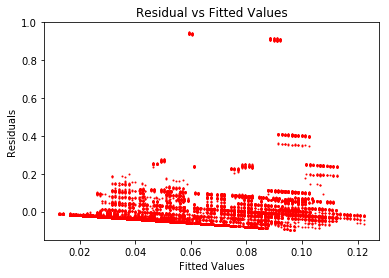

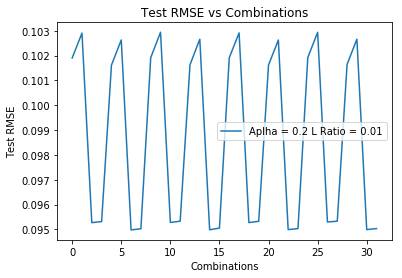

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 2, '\tTestRMSE: ', 0.10093828522467309)
('Training MSE for each fold : ', [0.010405718682944853, 0.010037606222848178, 0.010162829495426623, 0.010074192096479171, 0.010212877843271425, 0.010272811296805849, 0.010364785715059787, 0.010190856124209807, 0.010221393944833427, 0.00988547150109104], '\n\n')
('Testing MSE for each fold : ', [0.008063947886863087, 0.011532678415450316, 0.010476503713499372, 0.011209575258834039, 0.009849105258319904, 0.009171544697721275, 0.008615737416989197, 0.010216415473985184, 0.009842056245274641, 0.012897614324205029], '\n\n')
('Training RMSE:', 0.10091012978039922)
('Testing RMSE:', 0.1009332347104471)


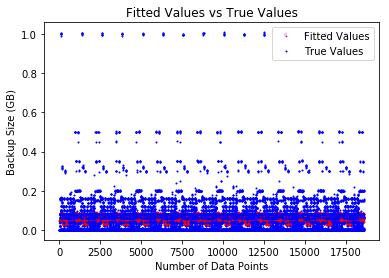

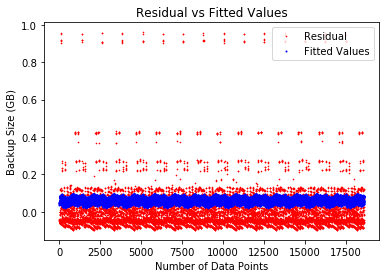

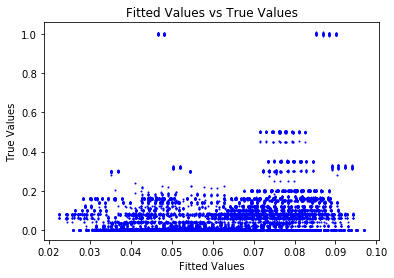

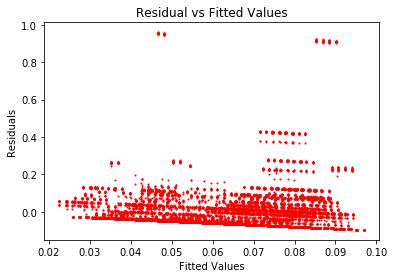

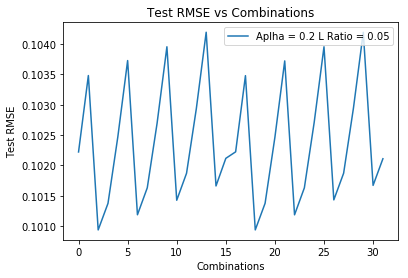

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 4, '\tTestRMSE: ', 0.1028337691068582)
('Training MSE for each fold : ', [0.010488888479217364, 0.010643573651142591, 0.0105108595048057, 0.010654106243399254, 0.010609368936768577, 0.01039474803638916, 0.01049139798969455, 0.010585607788057842, 0.010739557385101054, 0.01061161573795122], '\n\n')
('Testing MSE for each fold : ', [0.01131376654057254, 0.009914139826393935, 0.011148447857978578, 0.009789401162035496, 0.010221403680172408, 0.012267812018627516, 0.011302496496732428, 0.0105270988441677, 0.009064991185616482, 0.010241047112811671], '\n\n')
('Training RMSE:', 0.10282495988451798)
('Testing RMSE:', 0.10285455980417628)


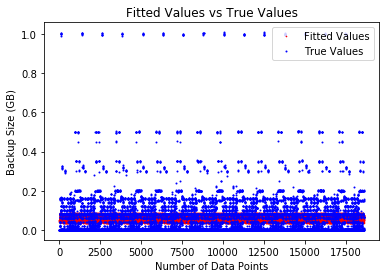

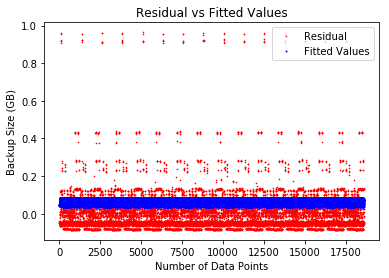

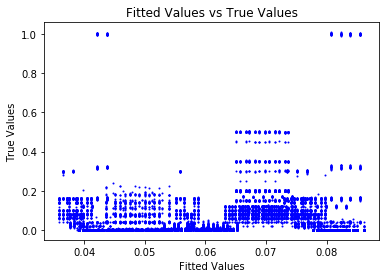

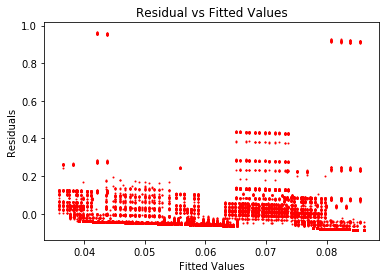

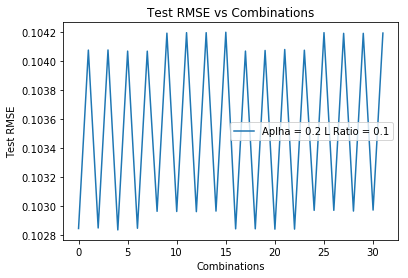

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 26, '\tTestRMSE: ', 0.10303563661207184)
('Training MSE for each fold : ', [0.010665857881195614, 0.01063292142132501, 0.010633600827487207, 0.010671329704050998, 0.010809955543469323, 0.01069565941896102, 0.01036001338212865, 0.010542631542627294, 0.010486956965368983, 0.010646529015003065], '\n\n')
('Testing MSE for each fold : ', [0.01020274107095189, 0.01043378224882041, 0.010450173599819397, 0.010080688529803476, 0.008844361418617852, 0.009821625714907113, 0.012941973828436435, 0.01125271220341427, 0.011811201175622727, 0.010346478645207], '\n\n')
('Training RMSE:', 0.10302691672646384)
('Testing RMSE:', 0.10304646448840474)


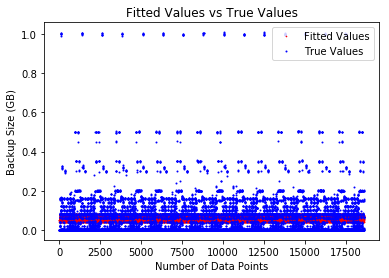

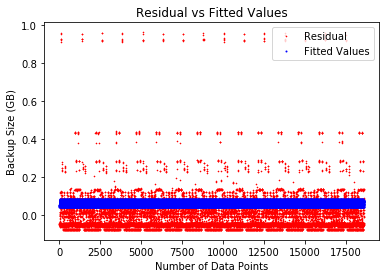

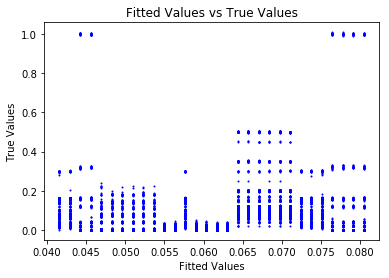

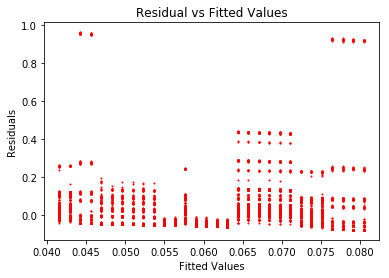

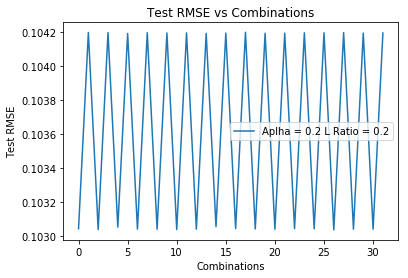

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 4, '\tTestRMSE: ', 0.10358323646370206)
('Training MSE for each fold : ', [0.01075485543867457, 0.01077038718997494, 0.010497188594521692, 0.010637819151108166, 0.01107907223918574, 0.010727242422091611, 0.010724662311859263, 0.01058728940701806, 0.010815377463238397, 0.010687092869867541], '\n\n')
('Testing MSE for each fold : ', [0.01037985411807926, 0.010189371965604203, 0.012853153752863144, 0.011548595626850258, 0.007522485533888613, 0.01072212090253619, 0.010729601374453135, 0.012117087655911634, 0.009998852147191853, 0.0112622819295954], '\n\n')
('Training RMSE:', 0.10357653551241225)
('Testing RMSE:', 0.10359701009535636)


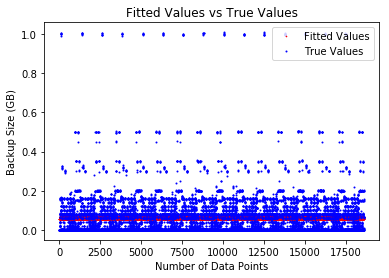

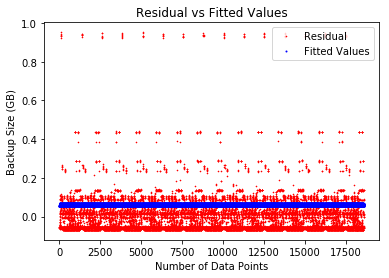

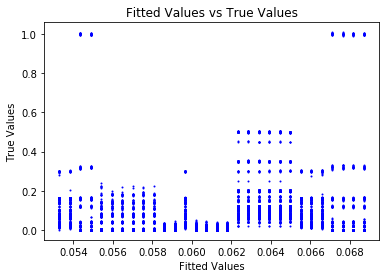

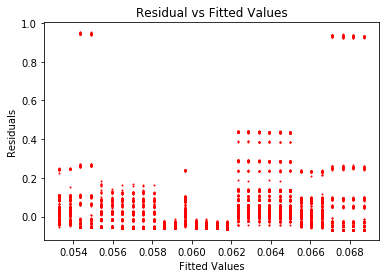

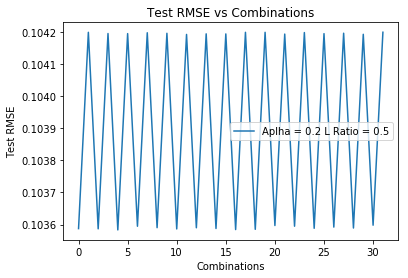

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 16, '\tTestRMSE: ', 0.10417931480076877)
('Training MSE for each fold : ', [0.010535620939543059, 0.011055853154283523, 0.011085746881373012, 0.010683237572883541, 0.010802794625050537, 0.011139225034802858, 0.010777480315795732, 0.01082880270351586, 0.010978163760987153, 0.010641974127968676], '\n\n')
('Testing MSE for each fold : ', [0.013738168876533719, 0.00893991883139298, 0.008784939297640038, 0.01240728166137302, 0.011224553550149757, 0.008285360518710922, 0.01155751701234158, 0.01109602105502867, 0.009746727168784431, 0.012778262702803208], '\n\n')
('Training RMSE:', 0.10417720437610328)
('Testing RMSE:', 0.10419153068976303)


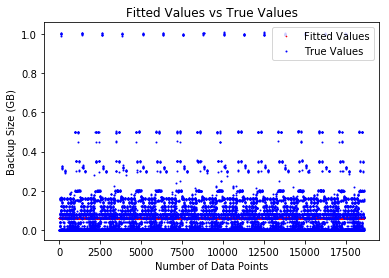

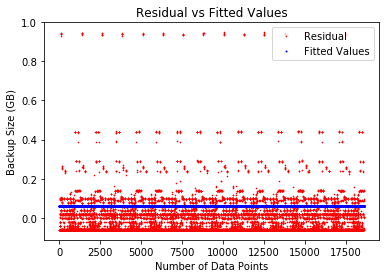

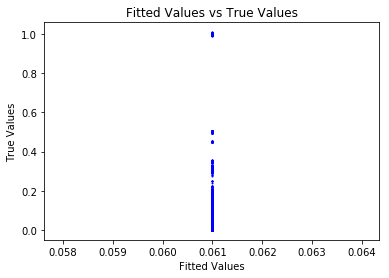

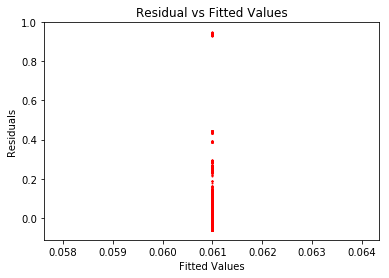

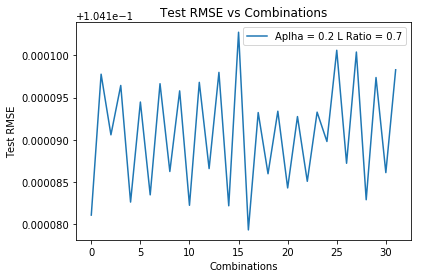

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 9, '\tTestRMSE: ', 0.10419108667361131)
('Training MSE for each fold : ', [0.010986333073669342, 0.010898868998047706, 0.010776297677823373, 0.010825026905368004, 0.010830980036932596, 0.01100917108103506, 0.010873386402108503, 0.010946634972068577, 0.010705261374382354, 0.010702845714493332], '\n\n')
('Testing MSE for each fold : ', [0.009678076323638433, 0.010465095886250811, 0.011568092280281246, 0.011129581793789398, 0.011076197205235123, 0.009472567896585746, 0.010694497166722109, 0.010035310907616488, 0.012208185734227894, 0.012229915091402283], '\n\n')
('Training RMSE:', 0.1041896377937503)
('Testing RMSE:', 0.10419094024230204)


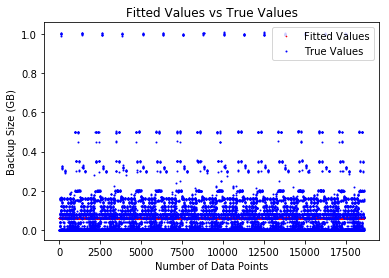

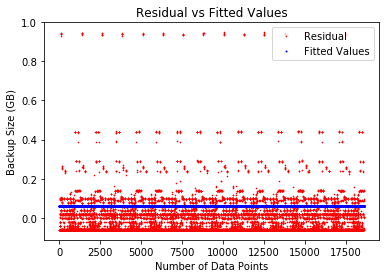

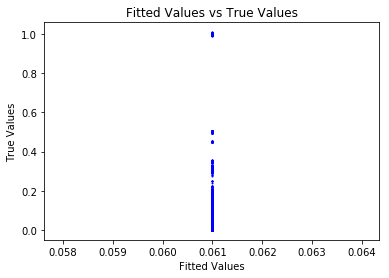

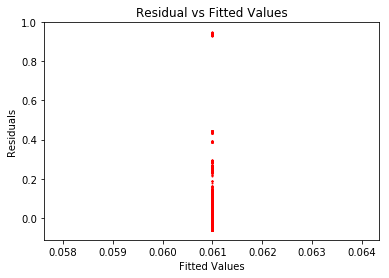

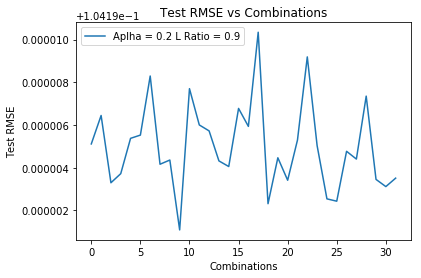

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 3, '\tTestRMSE: ', 0.10419166002807798)
('Training MSE for each fold : ', [0.010834774617223689, 0.010740204918440978, 0.010918487007933136, 0.011025835573846962, 0.010943862056632074, 0.010557471118972277, 0.010971379220811008, 0.010898032064749867, 0.010810645461961064, 0.01085356675554686], '\n\n')
('Testing MSE for each fold : ', [0.011041858773376349, 0.011892883177694496, 0.010288693162077154, 0.0093242283655617, 0.010060744205705272, 0.013539980964913186, 0.009812791712200824, 0.010472638446988184, 0.011259510068214703, 0.010873060518311418], '\n\n')
('Training RMSE:', 0.1041893750802441)
('Testing RMSE:', 0.10419519633603234)


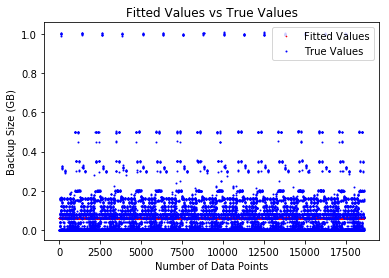

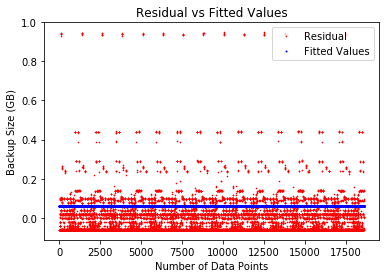

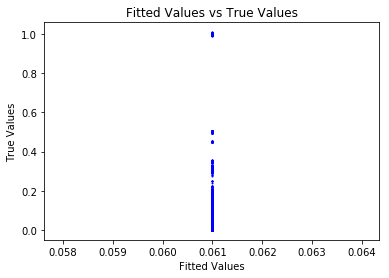

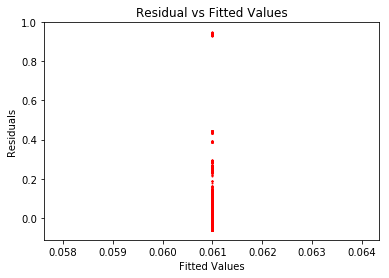

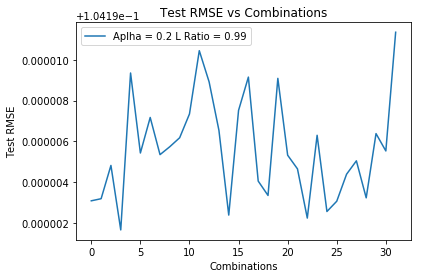

('For alpha: ', 0.2, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 16, '\tTestRMSE: ', 0.1041929628515954)
('Training MSE for each fold : ', [0.010958421251042785, 0.010839775029709921, 0.010965027065562197, 0.01107065981173104, 0.010777243472429998, 0.010732298987864009, 0.010715255446441469, 0.01071699850690838, 0.010855809767693158, 0.010923025251996201], '\n\n')
('Testing MSE for each fold : ', [0.009929555847771455, 0.010997341445808833, 0.009870099524251448, 0.008919303772134374, 0.01155965081836545, 0.011965459549198714, 0.012117555860841176, 0.012101717817889008, 0.010852569053752535, 0.010247590637541168], '\n\n')
('Training RMSE:', 0.10418949783513651)
('Testing RMSE:', 0.10419253539844117)


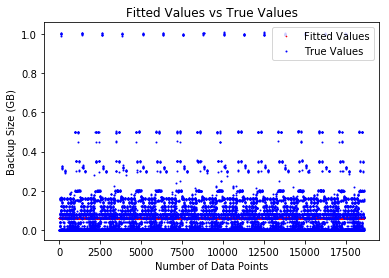

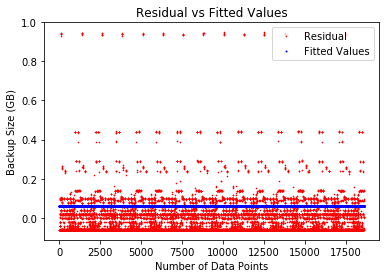

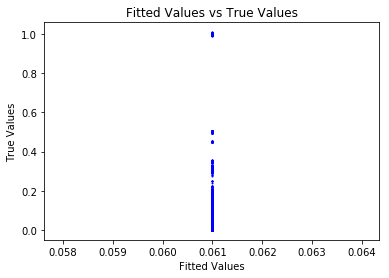

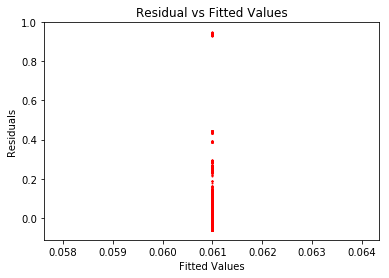

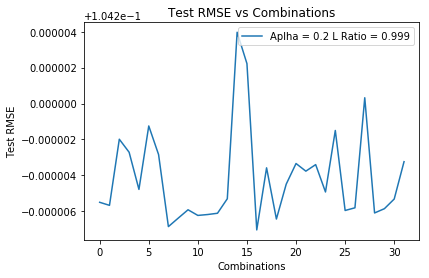

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 6, '\tTestRMSE: ', 0.09692179116162879)
('Training MSE for each fold : ', [0.009495028366562713, 0.00922919114950704, 0.009475127481344344, 0.009441408368712477, 0.00933867765253989, 0.009182802453915815, 0.009524522374371552, 0.009628156213819846, 0.009286772690370267, 0.009272102704383972], '\n\n')
('Testing MSE for each fold : ', [0.008376738563879204, 0.010866347290078399, 0.00861839194797685, 0.008914202463009432, 0.00977991569769862, 0.011156997273979513, 0.008188159644252261, 0.007245558872648303, 0.010287029337292995, 0.010499019897196666], '\n\n')
('Training RMSE:', 0.09688848716722122)
('Testing RMSE:', 0.09691870871406214)


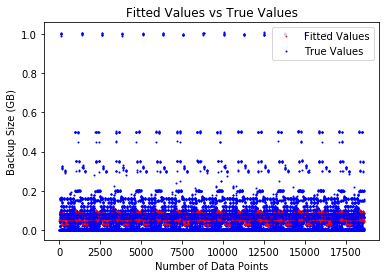

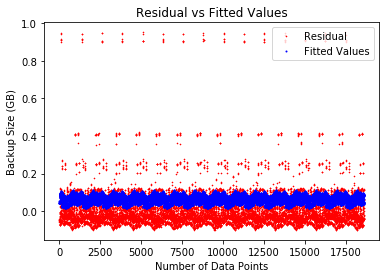

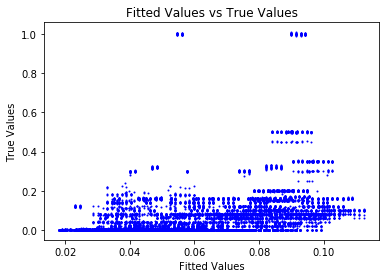

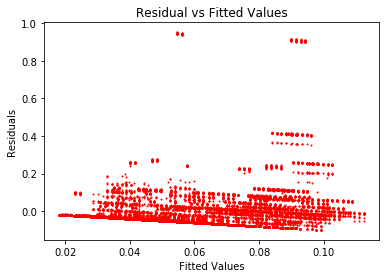

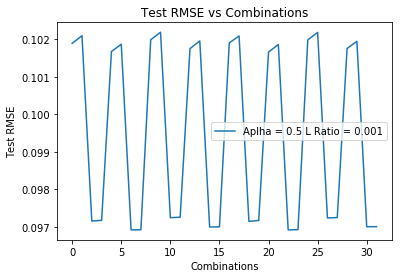

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 18, '\tTestRMSE: ', 0.09940694207137707)
('Training MSE for each fold : ', [0.009858791855492512, 0.009920921703386515, 0.009498670734837792, 0.01008697442289433, 0.009797491497016872, 0.0100976633312732, 0.009835115250994642, 0.009978767426978478, 0.009718096647956217, 0.009993790649221648], '\n\n')
('Testing MSE for each fold : ', [0.010050355445981967, 0.009463176458812492, 0.01325663883925953, 0.008054386461623762, 0.01069383620133154, 0.007931088266145152, 0.010255633056726414, 0.008946376018951334, 0.011356690104967818, 0.00882733724551267], '\n\n')
('Training RMSE:', 0.09939128911532047)
('Testing RMSE:', 0.09941605408550104)


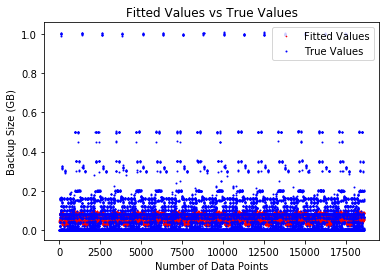

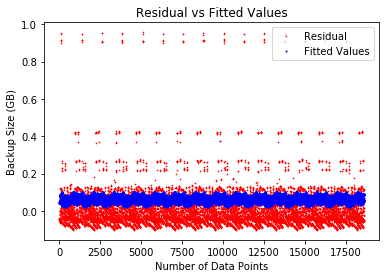

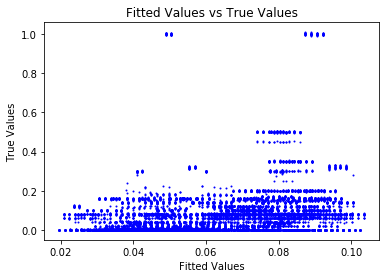

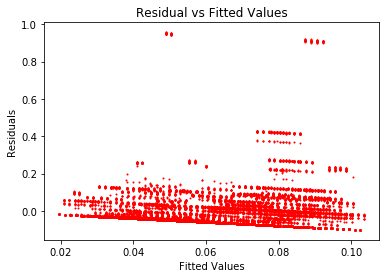

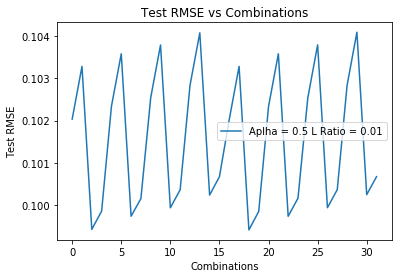

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 26, '\tTestRMSE: ', 0.10297261076065481)
('Training MSE for each fold : ', [0.010936700763974464, 0.010788201147630372, 0.010544578183242804, 0.010395884901558015, 0.010745995469279008, 0.010584764799530452, 0.010509455743181333, 0.010720496721216298, 0.010348167387528936, 0.010442171893639949], '\n\n')
('Testing MSE for each fold : ', [0.007579690627384429, 0.008916200087839374, 0.011120366447986004, 0.01244893332647182, 0.009282680419717257, 0.01075104492838001, 0.011452026305356968, 0.009525595412653187, 0.012932855190097788, 0.012045679056951879], '\n\n')
('Training RMSE:', 0.10296427390642914)
('Testing RMSE:', 0.10298304316868807)


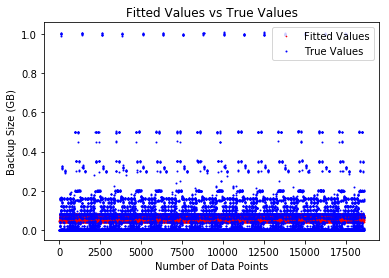

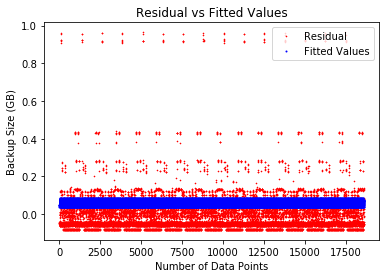

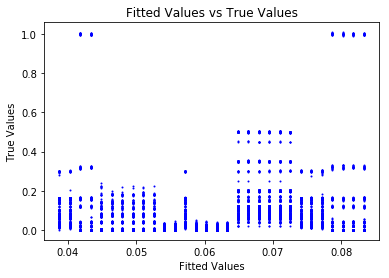

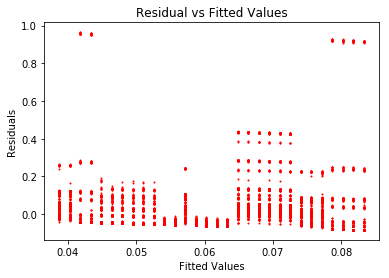

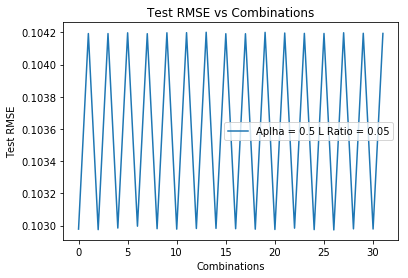

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 12, '\tTestRMSE: ', 0.10309950643043041)
('Training MSE for each fold : ', [0.010744404274272616, 0.010665296013659228, 0.01056546562891376, 0.01049611638507526, 0.01056982851302695, 0.010583941715453918, 0.01081447388909807, 0.01078538140041902, 0.010747263989815911, 0.01030074785428969], '\n\n')
('Testing MSE for each fold : ', [0.009598664785250484, 0.010318772523530736, 0.011218302364135851, 0.011795679026405576, 0.011120525666269438, 0.01103978115924848, 0.008904314197576578, 0.009225333247717809, 0.009537242524175678, 0.01354355569661601], '\n\n')
('Training RMSE:', 0.10308875771102513)
('Testing RMSE:', 0.10310294427945627)


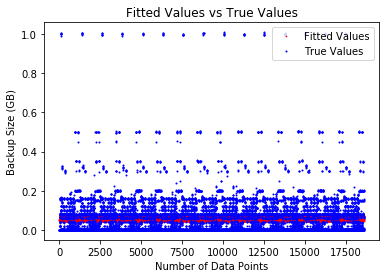

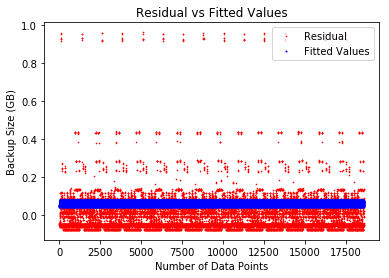

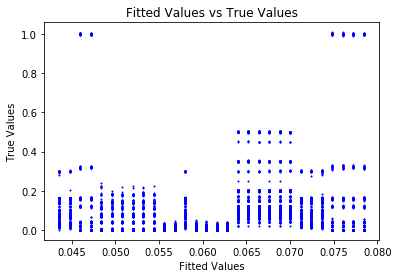

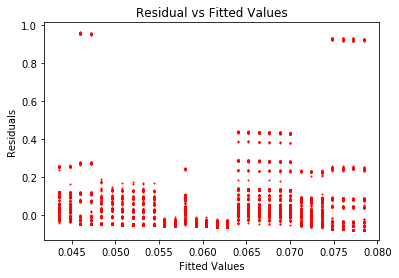

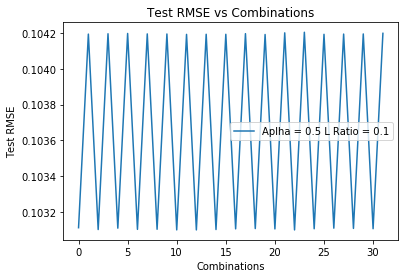

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 8, '\tTestRMSE: ', 0.10358537137730867)
('Training MSE for each fold : ', [0.01086311673778865, 0.010860311355249421, 0.010858903193454282, 0.010774283466939968, 0.010279349915672777, 0.010916190746122267, 0.010614277983451633, 0.01077957165719799, 0.010850712921214449, 0.010488699880002533], '\n\n')
('Testing MSE for each fold : ', [0.009480592907932028, 0.00953744565385295, 0.009543791124132506, 0.010395843786109332, 0.014913562296871817, 0.008881157889938228, 0.011693418221609546, 0.010375277583394134, 0.009711985702831794, 0.012798754933444066], '\n\n')
('Training RMSE:', 0.1035786743770618)
('Testing RMSE:', 0.10360107629755418)


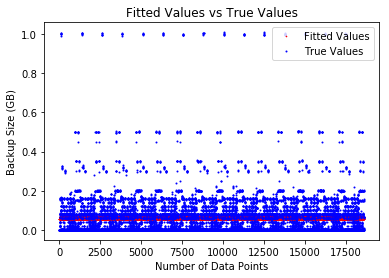

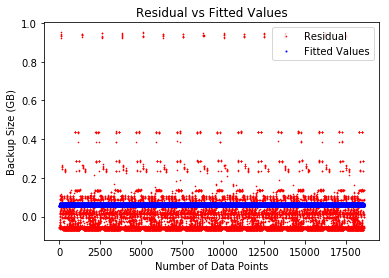

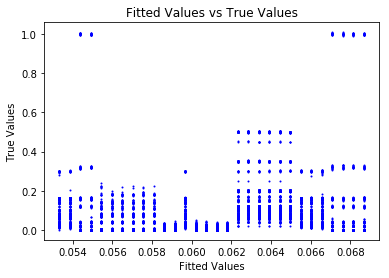

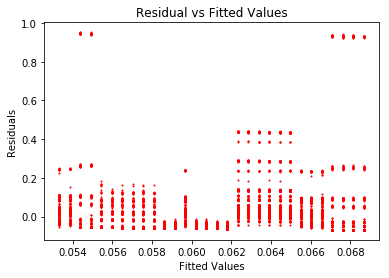

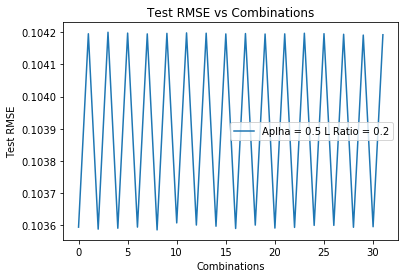

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 15, '\tTestRMSE: ', 0.10419098749164231)
('Training MSE for each fold : ', [0.010703332349430291, 0.01082088210024, 0.011158261852349659, 0.011029156451842588, 0.011024764402267528, 0.010856523074850853, 0.010666188473921714, 0.010825486992947365, 0.010737936596024405, 0.01073113035737792], '\n\n')
('Testing MSE for each fold : ', [0.012225159956586797, 0.01116719856192687, 0.008131656792949473, 0.009297070125256502, 0.009333173133892475, 0.010847137026591618, 0.012560227087210248, 0.011125939934359789, 0.011914268867103622, 0.01197705096753535], '\n\n')
('Training RMSE:', 0.10418908899268307)
('Testing RMSE:', 0.10420119118964655)


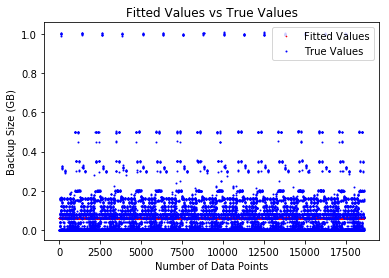

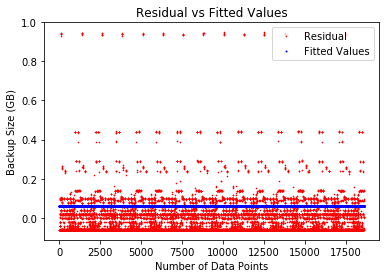

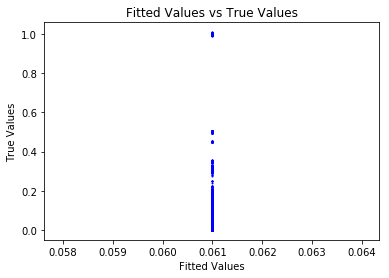

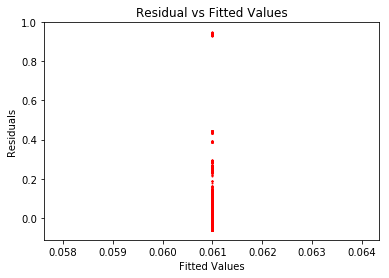

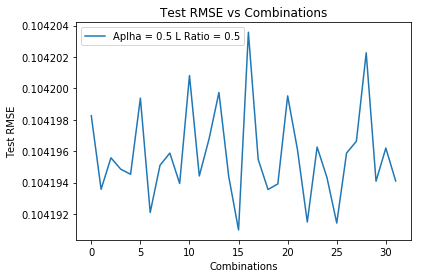

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 11, '\tTestRMSE: ', 0.10419143706003318)
('Training MSE for each fold : ', [0.011057784471588878, 0.010994922390506541, 0.011126023702527741, 0.011021933746443115, 0.010774854996832466, 0.010780636112246042, 0.010658152068825014, 0.01042521127921394, 0.010999661089698026, 0.010714733175880436], '\n\n')
('Testing MSE for each fold : ', [0.009036441191602922, 0.009600712776977128, 0.008421783011447323, 0.009358329155493804, 0.01158115279140671, 0.011529564762625611, 0.012631981748802703, 0.014731148035352007, 0.009558628231476051, 0.012122916775887975], '\n\n')
('Training RMSE:', 0.10418920915035405)
('Testing RMSE:', 0.10419820462996099)


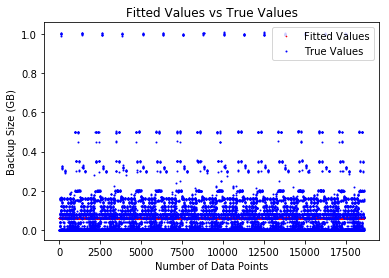

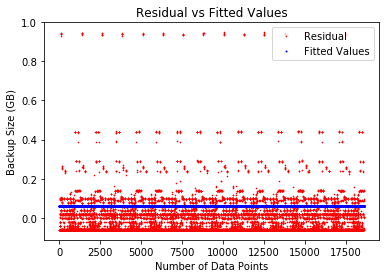

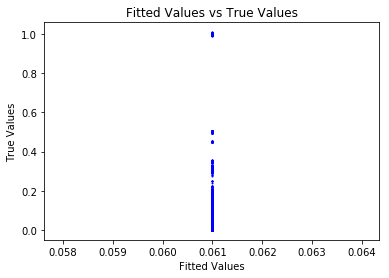

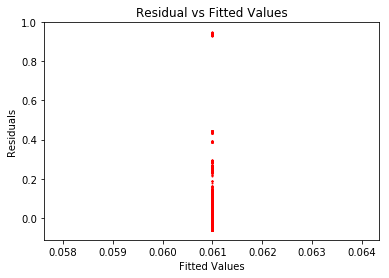

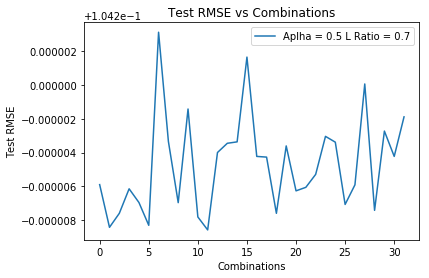

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 22, '\tTestRMSE: ', 0.10419202649517033)
('Training MSE for each fold : ', [0.010885123499284987, 0.010685423410995869, 0.010952808255182701, 0.010620320818572193, 0.01089961325208897, 0.010891500184088796, 0.010922375714369072, 0.010676367085225284, 0.011093673532588468, 0.01092689901618742], '\n\n')
('Testing MSE for each fold : ', [0.010588773305403653, 0.012386778775630193, 0.009980106948518443, 0.012973647720755668, 0.010459564225664663, 0.010531493822726959, 0.01025384500701062, 0.012467804972116161, 0.008712712573149609, 0.010212458126132341], '\n\n')
('Training RMSE:', 0.10418930116311548)
('Testing RMSE:', 0.10419557835009523)


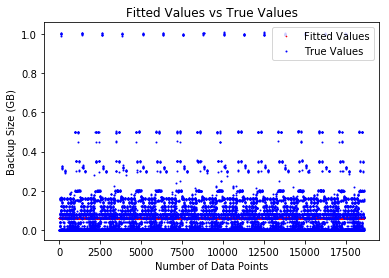

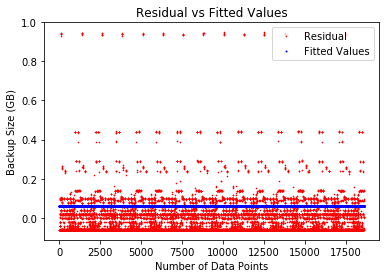

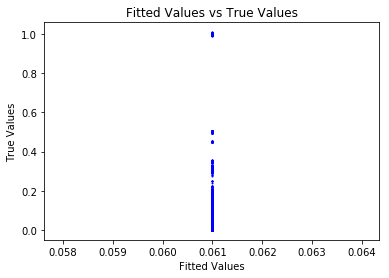

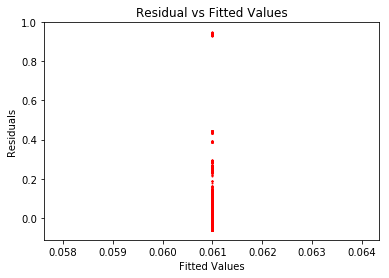

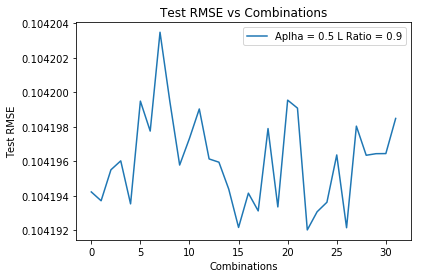

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 8, '\tTestRMSE: ', 0.10419207142444772)
('Training MSE for each fold : ', [0.01059512858455865, 0.011057102411225801, 0.01086369596028967, 0.01085622302877488, 0.01093103786388461, 0.010630874965002837, 0.01103787719670208, 0.010590846631207471, 0.011071335325776819, 0.010919045878584256], '\n\n')
('Testing MSE for each fold : ', [0.013199721589116234, 0.00904492794539349, 0.01078162114007576, 0.010848918866304649, 0.010175708746230049, 0.012882648839573926, 0.009214436580807835, 0.013239252856334514, 0.008913237457940445, 0.010284691923495393], '\n\n')
('Training RMSE:', 0.10418885153700806)
('Testing RMSE:', 0.1042042062228163)


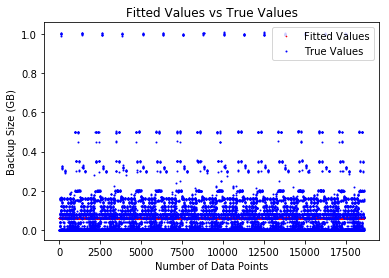

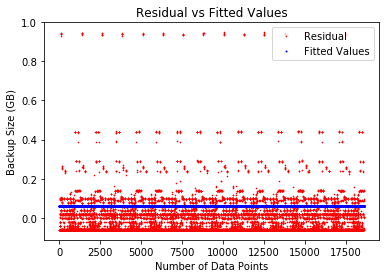

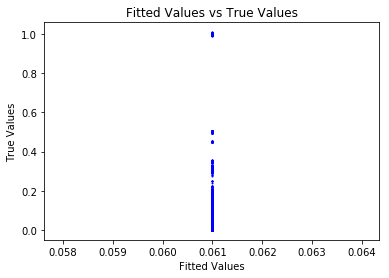

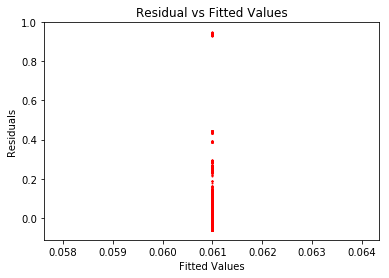

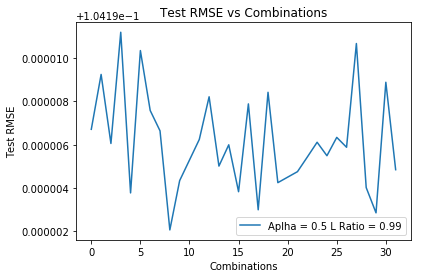

('For alpha: ', 0.5, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 14, '\tTestRMSE: ', 0.10419161040555365)
('Training MSE for each fold : ', [0.01078267599058571, 0.011011436621291431, 0.010982012007040562, 0.010770873733874418, 0.01087960151032543, 0.010857461838484062, 0.01081324457562602, 0.01070797470730803, 0.010998500646304452, 0.010750764504473152], '\n\n')
('Testing MSE for each fold : ', [0.011510815497414499, 0.009452156802359266, 0.009717591035211576, 0.011616935761943042, 0.01063848365161246, 0.010837747160117393, 0.011235636466214083, 0.012183551927789237, 0.00956779229799116, 0.011799711786114518], '\n\n')
('Training RMSE:', 0.1041895129729059)
('Testing RMSE:', 0.10419233291695087)


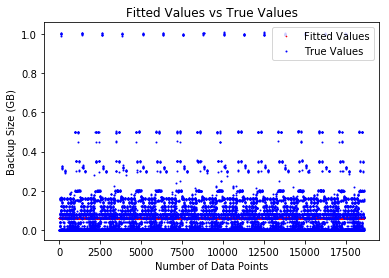

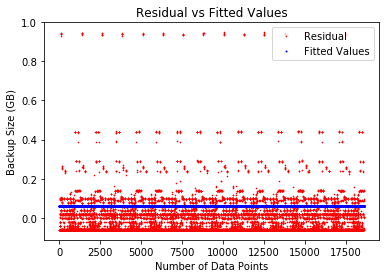

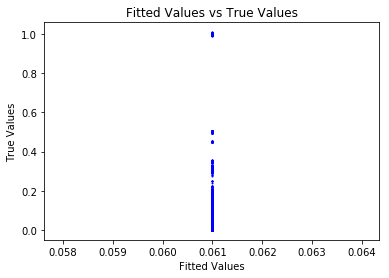

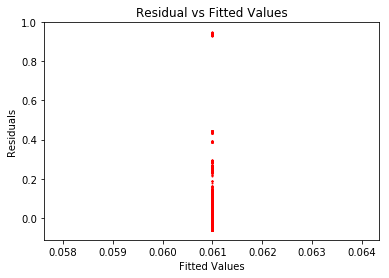

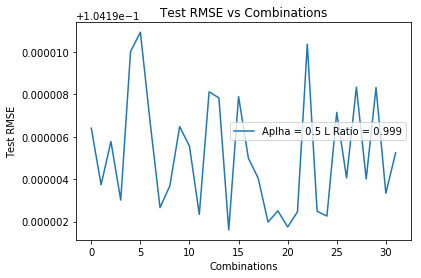

('For alpha: ', 1, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 2, '\tTestRMSE: ', 0.09921201732100915)
('Training MSE for each fold : ', [0.009907830857987713, 0.009934860449246881, 0.0097178322901858, 0.009827012620876622, 0.009752952382251151, 0.009854810476299715, 0.009764019012316464, 0.009962839347558655, 0.009988055626925268, 0.009682792747203586], '\n\n')
('Testing MSE for each fold : ', [0.009207975957624967, 0.008956473703315274, 0.010941340012133751, 0.009949860849522282, 0.010610198594058226, 0.009690011528342807, 0.01053805477166417, 0.008722210095389999, 0.00852331044805584, 0.011280330970987101], '\n\n')
('Training RMSE:', 0.0991932486668583)
('Testing RMSE:', 0.09920673713568773)


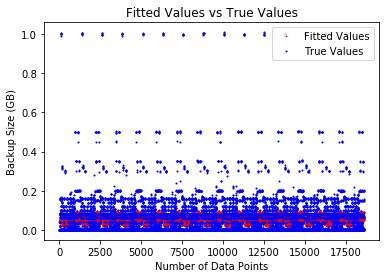

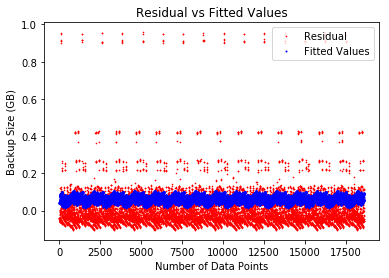

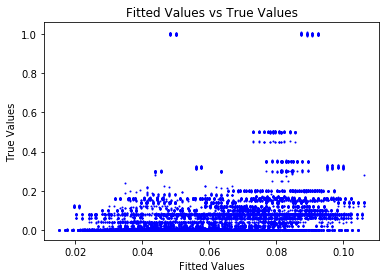

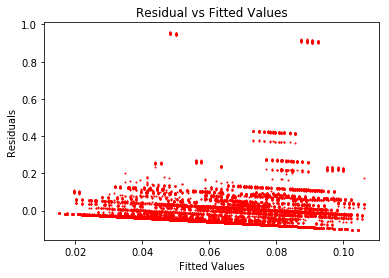

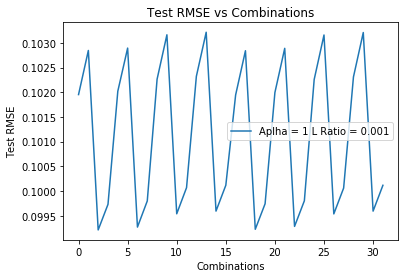

('For alpha: ', 1, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 2, '\tTestRMSE: ', 0.10189871065613891)
('Training MSE for each fold : ', [0.01052260778704066, 0.010483790966552152, 0.01056816662990175, 0.010349549217347683, 0.010275167346272795, 0.010257992287780196, 0.010183908593314498, 0.01018321398319754, 0.010610655683859037, 0.010344869529863342], '\n\n')
('Testing MSE for each fold : ', [0.009060770128781448, 0.009403473873470665, 0.008666448489729271, 0.010619754942543727, 0.011371779125458663, 0.011453789966806458, 0.012144496496138512, 0.012171049166378416, 0.0082472735037908, 0.010679813482190008], '\n\n')
('Training RMSE:', 0.10187243102288746)
('Testing RMSE:', 0.10189143691954097)


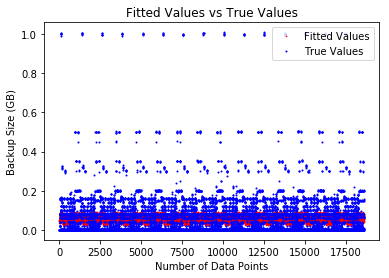

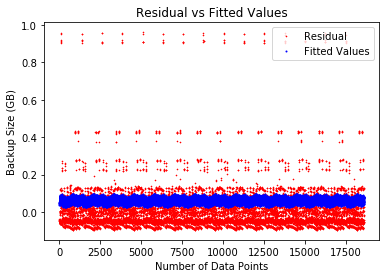

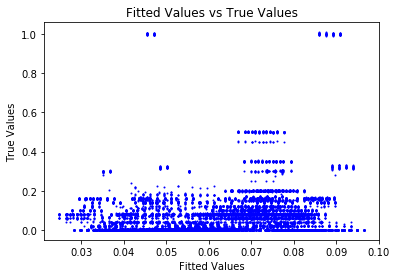

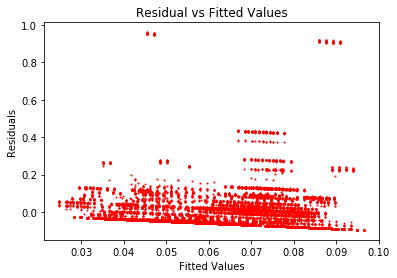

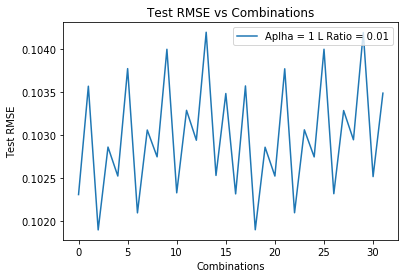

('For alpha: ', 1, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 16, '\tTestRMSE: ', 0.1031006861936205)
('Training MSE for each fold : ', [0.010861194288626754, 0.01052398394306892, 0.01063549392955288, 0.010886241671527137, 0.010769283610768824, 0.010351933459886466, 0.010850346180235311, 0.010276753093801775, 0.010468633111152034, 0.01065778883134626], '\n\n')
('Testing MSE for each fold : ', [0.008523486220492713, 0.011579788473096334, 0.010578789239609233, 0.008288789852333611, 0.009378494654521858, 0.013069864074398184, 0.008650591536659692, 0.013789565654965105, 0.012038867719914312, 0.01039954848444722], '\n\n')
('Training RMSE:', 0.10309299303054809)
('Testing RMSE:', 0.10310081760608801)


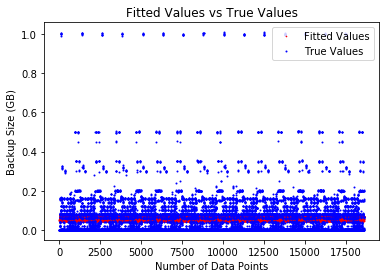

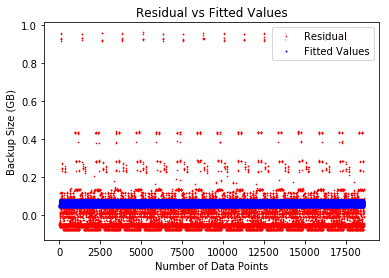

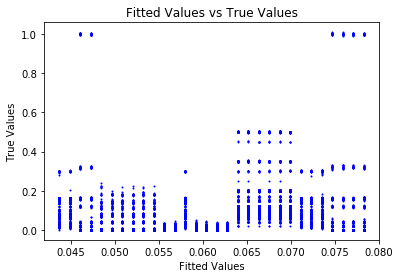

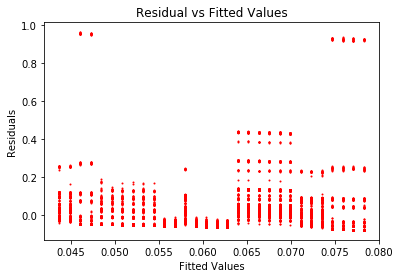

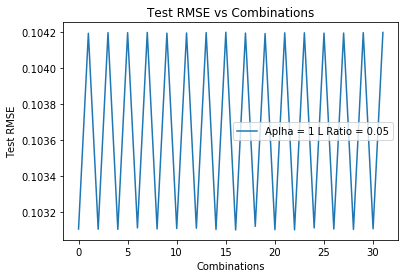

('For alpha: ', 1, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 28, '\tTestRMSE: ', 0.10358774880590962)
('Training MSE for each fold : ', [0.010652490961465495, 0.010585795397273464, 0.01064317273857735, 0.010836352460714368, 0.010914990981295364, 0.01078617598664005, 0.010624669257548281, 0.010394085697184799, 0.010837163979537873, 0.01101850765569595], '\n\n')
('Testing MSE for each fold : ', [0.011410535744522492, 0.0119579829995365, 0.011594418174537071, 0.00969719741108309, 0.009038583514174435, 0.010243036703505518, 0.011652876121727518, 0.013749665665314603, 0.00984158812038211, 0.008128043767928132], '\n\n')
('Training RMSE:', 0.10358252995362345)
('Testing RMSE:', 0.10359243612480183)


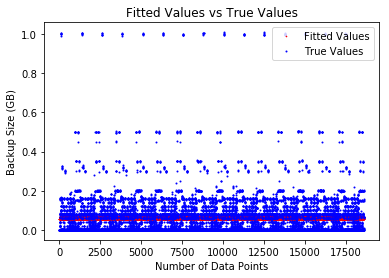

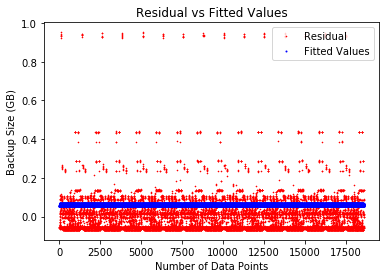

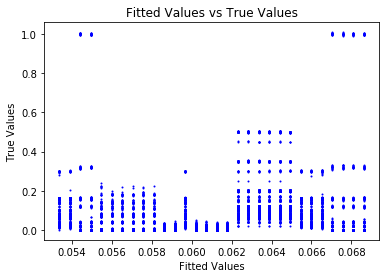

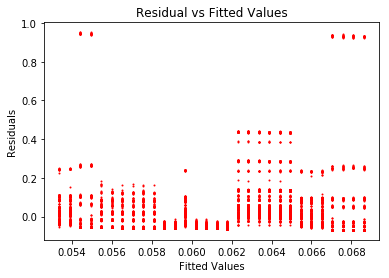

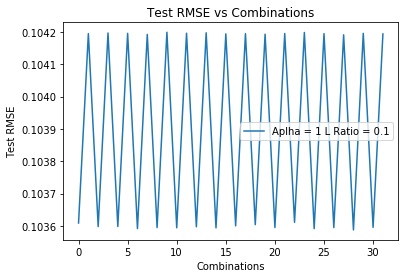

('For alpha: ', 1, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 12, '\tTestRMSE: ', 0.10419166551485982)
('Training MSE for each fold : ', [0.010892094465680612, 0.011082988281109268, 0.010726191649384344, 0.010903401410378594, 0.010857697388882568, 0.010946320535850495, 0.010777806899295786, 0.010748095509533524, 0.010782890082819734, 0.010837185644926145], '\n\n')
('Testing MSE for each fold : ', [0.010526162588560496, 0.008808274696766847, 0.012019483129321436, 0.010424558525649767, 0.010835627795725698, 0.010038304128374972, 0.011554737445211315, 0.011821910996191705, 0.011509406065637844, 0.011020340336476246], '\n\n')
('Training RMSE:', 0.10418957331127769)
('Testing RMSE:', 0.1041915570993717)


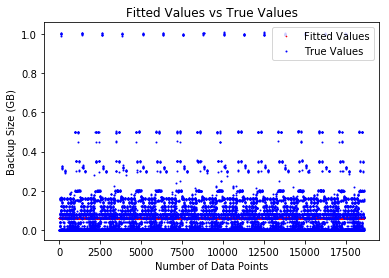

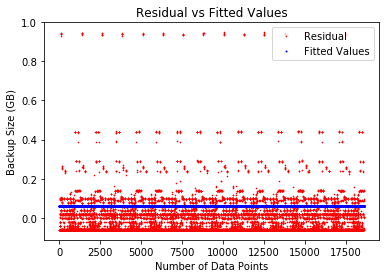

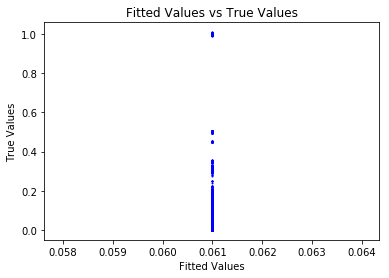

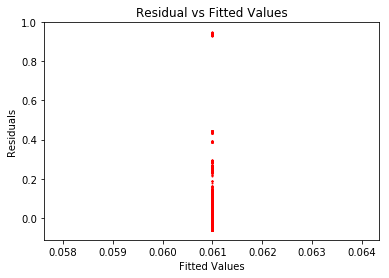

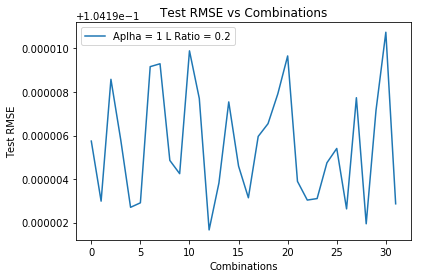

('For alpha: ', 1, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 12, '\tTestRMSE: ', 0.10419173386278557)
('Training MSE for each fold : ', [0.010962294237758165, 0.011032812301684148, 0.010745745274168559, 0.010609162730448122, 0.010710442852751759, 0.010839375672749186, 0.010869792701684311, 0.010937063183992684, 0.01085721150331847, 0.010990384913771254], '\n\n')
('Testing MSE for each fold : ', [0.009894331671054009, 0.009260700962756935, 0.011843259622688956, 0.013073561921229403, 0.012161147927285513, 0.011000705868470385, 0.010727524223015355, 0.010121598961192932, 0.010840100740304552, 0.009641856409004087], '\n\n')
('Training RMSE:', 0.10418938783404318)
('Testing RMSE:', 0.10419442802136886)


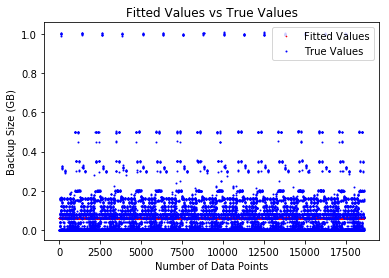

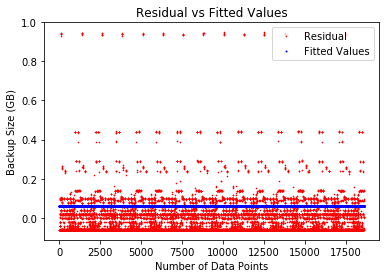

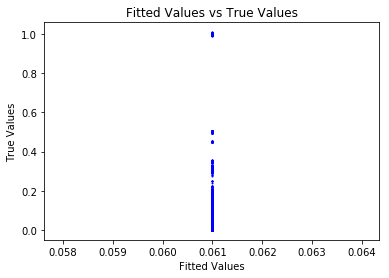

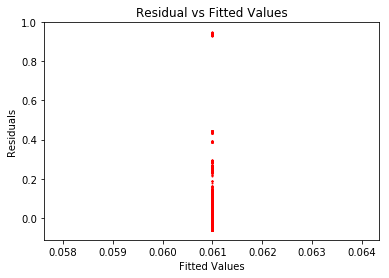

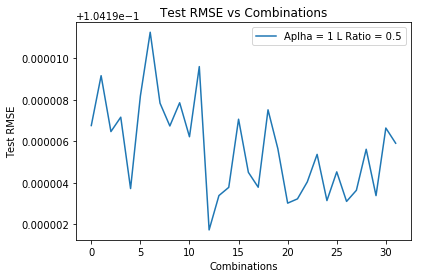

('For alpha: ', 1, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 19, '\tTestRMSE: ', 0.10419108011372395)
('Training MSE for each fold : ', [0.010949612876344848, 0.011018377526977664, 0.010583243367171096, 0.0108727277519316, 0.01072652160312137, 0.010313364101365994, 0.01100333149906573, 0.011198752374103331, 0.010855165120891214, 0.011032073583152315], '\n\n')
('Testing MSE for each fold : ', [0.010008445970386292, 0.009390778501163629, 0.013310512693335861, 0.010700360094192944, 0.01201605027612985, 0.015737015507491747, 0.009525103715495451, 0.007773460564890718, 0.010858389836317832, 0.009265627038906299], '\n\n')
('Training RMSE:', 0.1041888524767046)
('Testing RMSE:', 0.10420448368391381)


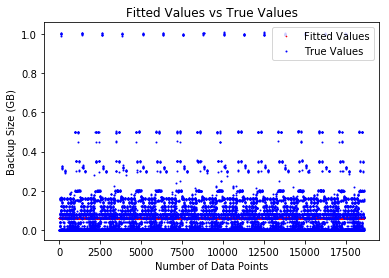

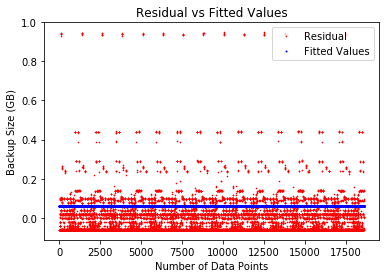

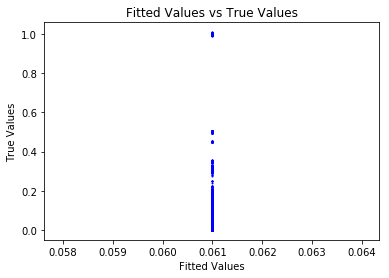

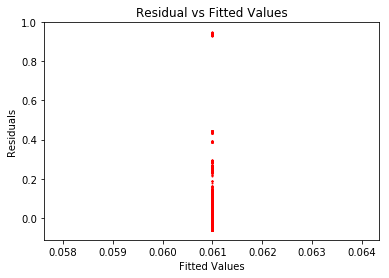

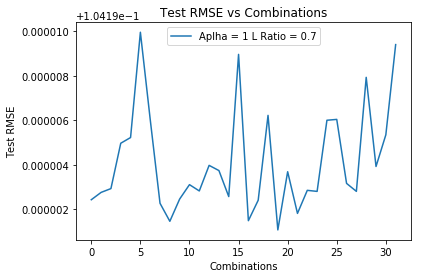

('For alpha: ', 1, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 8, '\tTestRMSE: ', 0.10419058900605827)
('Training MSE for each fold : ', [0.010893801496852014, 0.010562989859324157, 0.010903465012119893, 0.01097828556009813, 0.010891000343623692, 0.010873389290842183, 0.010704705484242577, 0.010818663454471996, 0.010985928468761692, 0.010942288577495308], '\n\n')
('Testing MSE for each fold : ', [0.010510681720409797, 0.013487760310675228, 0.010423730600570953, 0.009750441569589964, 0.010536792211114773, 0.01069447162646505, 0.012212946223414982, 0.011187387714620857, 0.009681792798049366, 0.010073890482885425], '\n\n')
('Training RMSE:', 0.10418949925392272)
('Testing RMSE:', 0.10419207995706603)


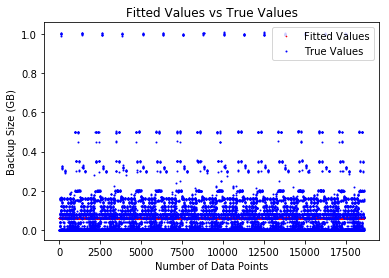

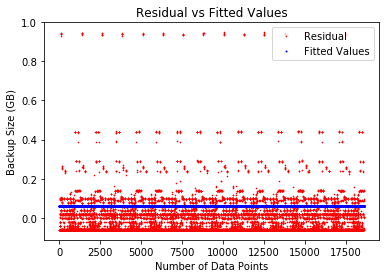

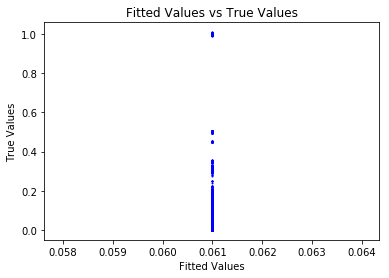

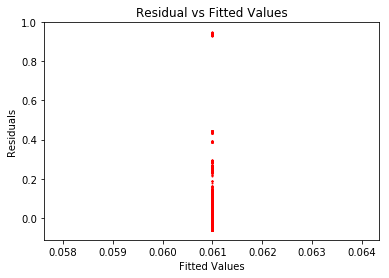

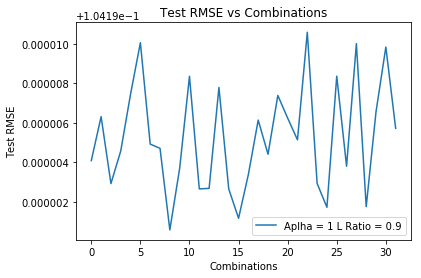

('For alpha: ', 1, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 13, '\tTestRMSE: ', 0.10419194186491466)
('Training MSE for each fold : ', [0.01079517278464805, 0.010855991406921898, 0.010916203901334886, 0.010772779682222698, 0.011139196157911911, 0.010441757793261435, 0.011150926602463682, 0.010638375922196354, 0.011103369128994612, 0.010740299118274312], '\n\n')
('Testing MSE for each fold : ', [0.011398840728123473, 0.010851193310060403, 0.010309839893098352, 0.011599814883665481, 0.00830304989540083, 0.014579807110997647, 0.008197405472537257, 0.01281076843115003, 0.008625479681660272, 0.011892656924480589], '\n\n')
('Training RMSE:', 0.1041892856767095)
('Testing RMSE:', 0.10419638013442421)


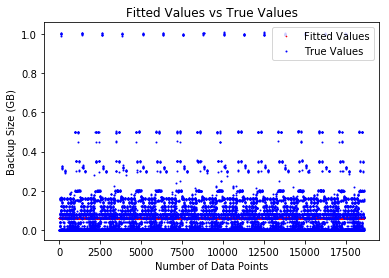

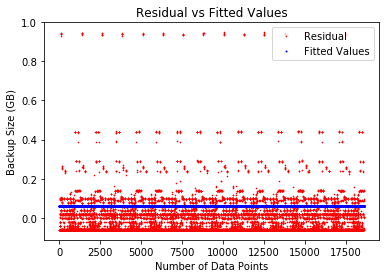

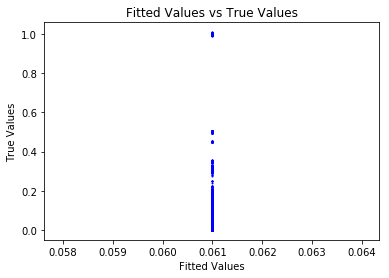

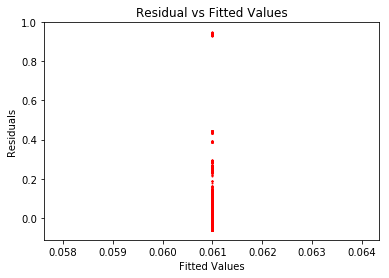

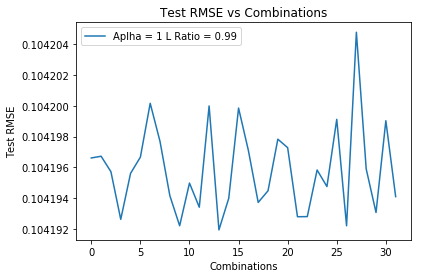

('For alpha: ', 1, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 1, '\tTestRMSE: ', 0.10419187004203624)
('Training MSE for each fold : ', [0.01097437066050404, 0.010911905677614351, 0.010726290808531056, 0.010628591592162943, 0.011028673581934188, 0.01065688384032665, 0.010816399399032305, 0.010913256352372886, 0.010868341570597363, 0.011029618105181884], '\n\n')
('Testing MSE for each fold : ', [0.009786406374077931, 0.010349090454185224, 0.01201827617093109, 0.012897794529429157, 0.009297754133742524, 0.012643040215307284, 0.011207219872898496, 0.010336765075738929, 0.010739722197732662, 0.009287539566861897], '\n\n')
('Training RMSE:', 0.10418941001285)
('Testing RMSE:', 0.10419386190697857)


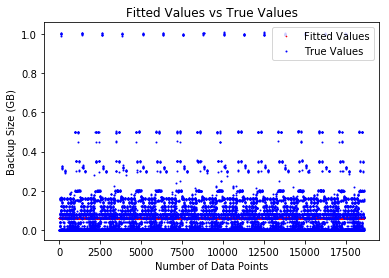

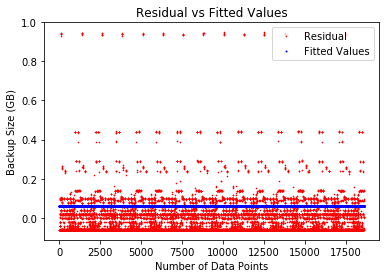

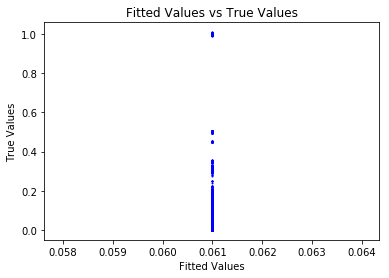

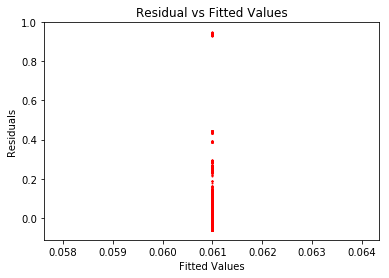

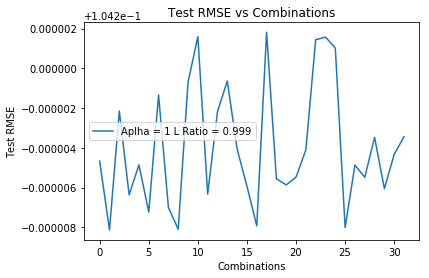

('For alpha: ', 2, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 18, '\tTestRMSE: ', 0.1007279968665664)
('Training MSE for each fold : ', [0.010026530013125722, 0.010098958612438232, 0.010188067628653017, 0.010346152326341543, 0.010154132380730575, 0.00987583261788603, 0.009981868064059757, 0.01037349764996053, 0.010115586925201779, 0.010255211297364232], '\n\n')
('Testing MSE for each fold : ', [0.011181472319453331, 0.01051360965472027, 0.009736909303743688, 0.008314400331035567, 0.010026093487349822, 0.012548904774823394, 0.01159339619028906, 0.00804119398960915, 0.01035335966818906, 0.009146960094332766], '\n\n')
('Training RMSE:', 0.10070543059625008)
('Testing RMSE:', 0.10072551802475187)


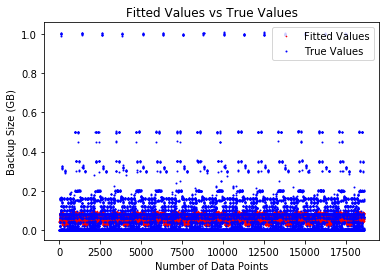

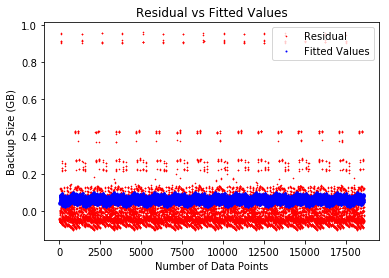

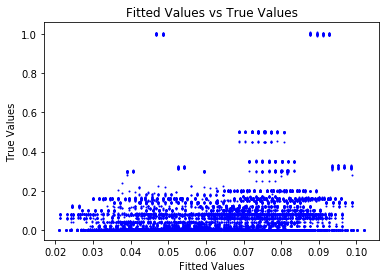

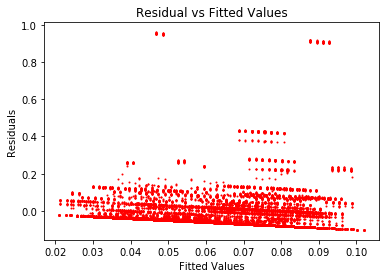

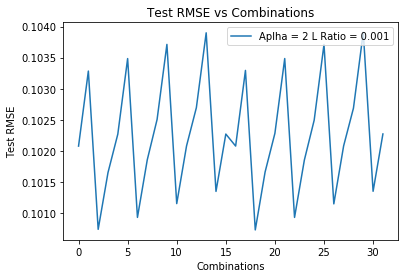

('For alpha: ', 2, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 18, '\tTestRMSE: ', 0.10288158897793774)
('Training MSE for each fold : ', [0.010364777473443039, 0.01049383917564865, 0.010741953367003754, 0.01076688748282594, 0.010550392687021215, 0.010576543734400512, 0.010500029090124714, 0.010718079397243474, 0.01067441336382946, 0.010433939745244161], '\n\n')
('Testing MSE for each fold : ', [0.01259606271580255, 0.011383835374976423, 0.009103159898238445, 0.008961950305645163, 0.010868220169460626, 0.01064207589398442, 0.011323472929428306, 0.009310320025749023, 0.009700223849887833, 0.011959586179155138], '\n\n')
('Training RMSE:', 0.10286926436831602)
('Testing RMSE:', 0.10288289816209882)


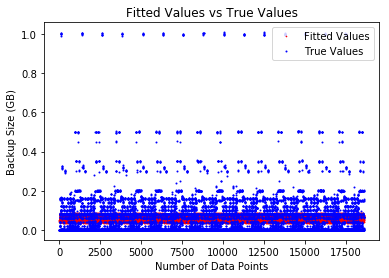

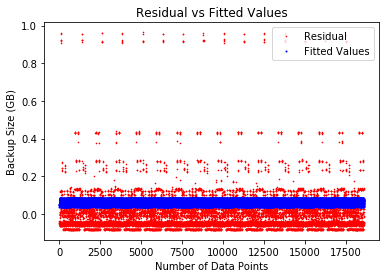

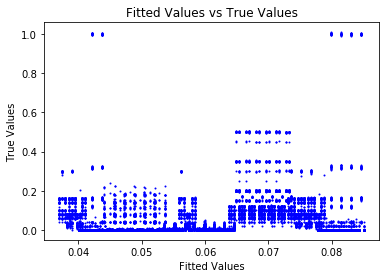

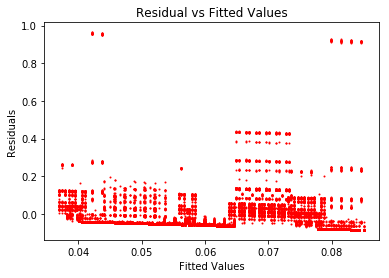

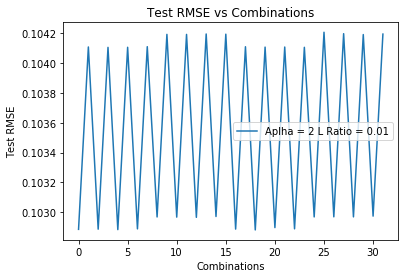

('For alpha: ', 2, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 30, '\tTestRMSE: ', 0.10359687002543037)
('Training MSE for each fold : ', [0.010818083131626015, 0.010626354646313002, 0.010619534126007567, 0.010502413076246381, 0.01057065905805081, 0.010927258353231705, 0.010565407943457427, 0.010709699192896192, 0.010870184391302096, 0.011097133541139108], '\n\n')
('Testing MSE for each fold : ', [0.00987648472888195, 0.011650374816194941, 0.011666486066763203, 0.01285037569539583, 0.012292374550890623, 0.008938241637777938, 0.012309199168933645, 0.01085989411911958, 0.00947150710027221, 0.007425048162262586], '\n\n')
('Training RMSE:', 0.1035889605413001)
('Testing RMSE:', 0.10360501244944306)


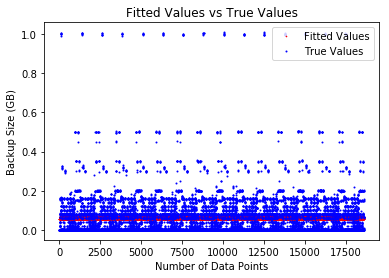

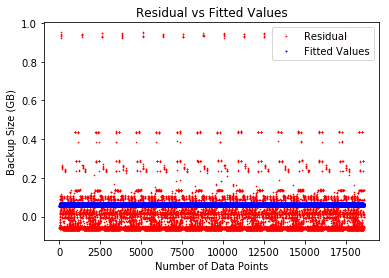

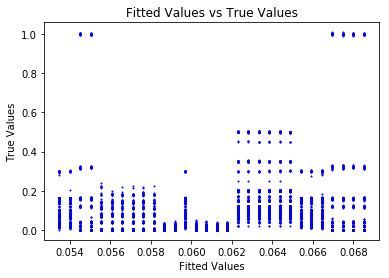

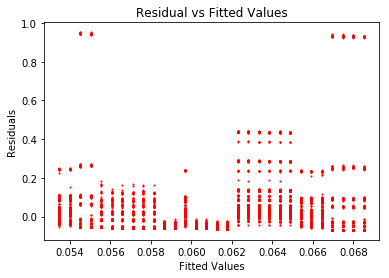

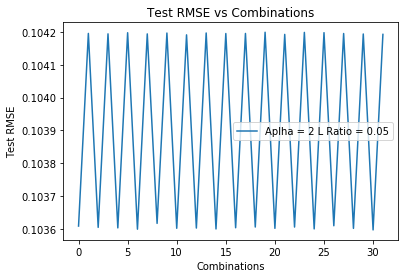

('For alpha: ', 2, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 10, '\tTestRMSE: ', 0.10419101537540854)
('Training MSE for each fold : ', [0.011111864308383797, 0.010642679748791723, 0.010906167906023608, 0.011029006235040951, 0.010419166793336362, 0.010990969528357718, 0.01069386145228657, 0.011014904980940989, 0.011129998816251253, 0.010615195736117272], '\n\n')
('Testing MSE for each fold : ', [0.008550354202665044, 0.012770570710803064, 0.010400481054370173, 0.009294734171858705, 0.014784662158241873, 0.009636280902071973, 0.012310162662067895, 0.009421111026916427, 0.008383863757321667, 0.01302210734083685], '\n\n')
('Training RMSE:', 0.10418916234692083)
('Testing RMSE:', 0.10419900574724966)


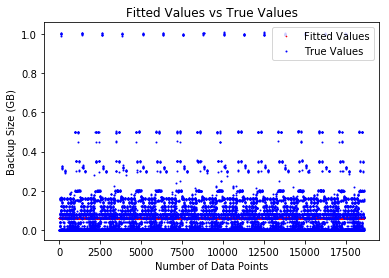

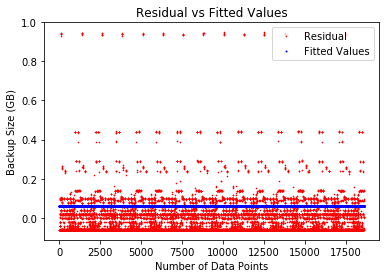

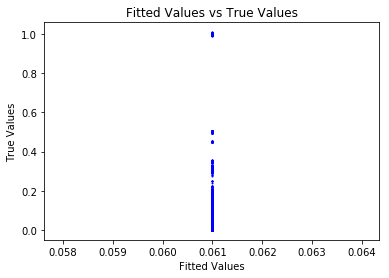

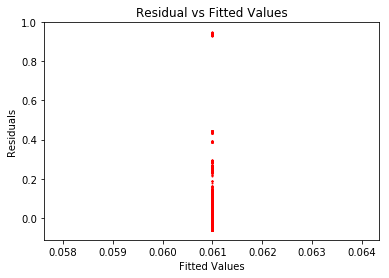

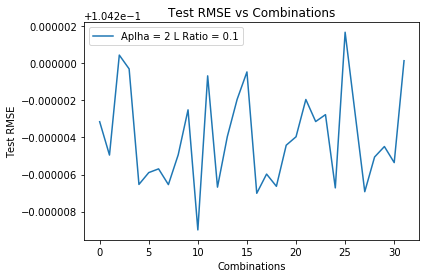

('For alpha: ', 2, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 24, '\tTestRMSE: ', 0.10419240993821074)
('Training MSE for each fold : ', [0.01099655599135424, 0.011041035057341709, 0.010951368988838606, 0.010668868427439453, 0.010924679450825703, 0.01066420413475026, 0.01086781391554434, 0.010836543263147548, 0.010628263444278972, 0.010975055042848979], '\n\n')
('Testing MSE for each fold : ', [0.009586543045662045, 0.009186598302850211, 0.009992633669185947, 0.01253543133776384, 0.010232920892362656, 0.01257782221436207, 0.010744793853823362, 0.011026232425736034, 0.012902149618804662, 0.009779179142416931], '\n\n')
('Training RMSE:', 0.10418943694845934)
('Testing RMSE:', 0.1041941958570475)


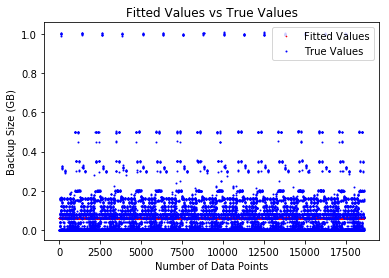

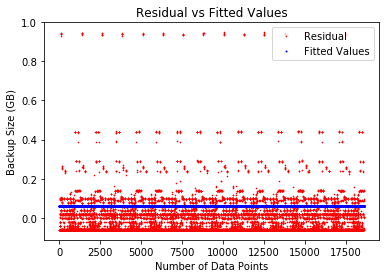

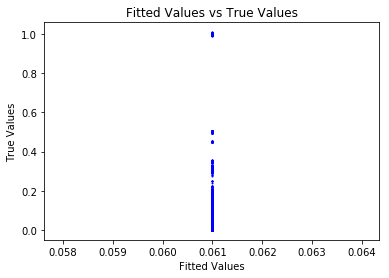

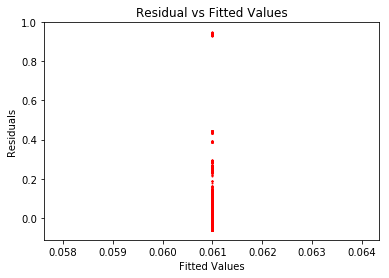

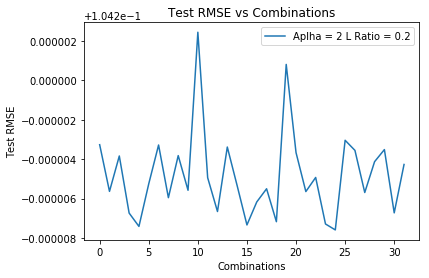

('For alpha: ', 2, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 3, '\tTestRMSE: ', 0.10419200851200916)
('Training MSE for each fold : ', [0.01096518655908436, 0.010572160873582283, 0.010747121391996396, 0.011046734291024908, 0.010628876405780035, 0.01095436724175176, 0.010901655561850033, 0.01094877121330817, 0.010744490349403245, 0.011044938470472295], '\n\n')
('Testing MSE for each fold : ', [0.009868424582694149, 0.013406329380322459, 0.011830659958395391, 0.009134585164652093, 0.01289592060925093, 0.009965681109110407, 0.010440339140936674, 0.010016170405876105, 0.011855820443298023, 0.009150883087374146], '\n\n')
('Training RMSE:', 0.10418939598550972)
('Testing RMSE:', 0.1041944402940533)


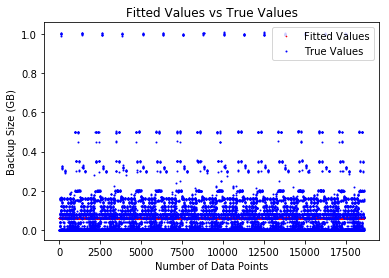

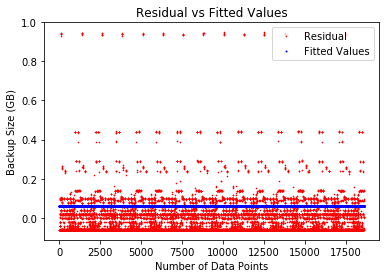

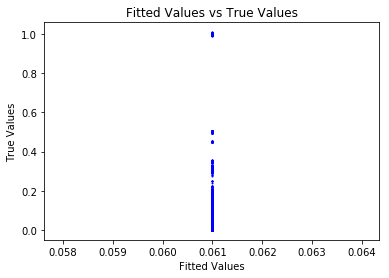

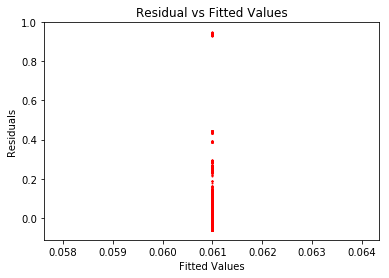

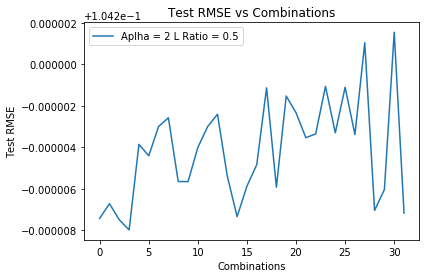

('For alpha: ', 2, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 27, '\tTestRMSE: ', 0.10419097778359562)
('Training MSE for each fold : ', [0.010752646121786665, 0.01086978032427945, 0.01084981197889629, 0.011007806756518758, 0.011148525629531973, 0.010703865954519482, 0.010732198630599673, 0.010791748461696636, 0.01085783318397692, 0.010840080116301621], '\n\n')
('Testing MSE for each fold : ', [0.011781233527737831, 0.01072732396757923, 0.010906546076185804, 0.009484882220663984, 0.008220145987680408, 0.012220364355083425, 0.011965696773341361, 0.01143038509551801, 0.010834550904930382, 0.010994330071530238], '\n\n')
('Training RMSE:', 0.10418939348998413)
('Testing RMSE:', 0.10419474985825854)


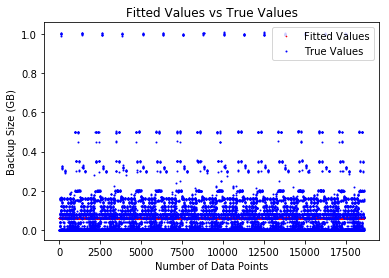

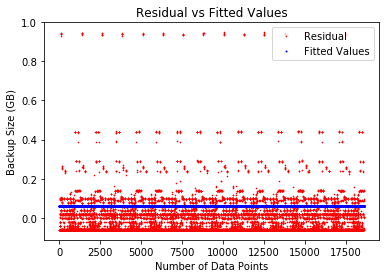

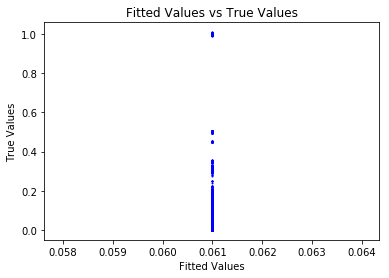

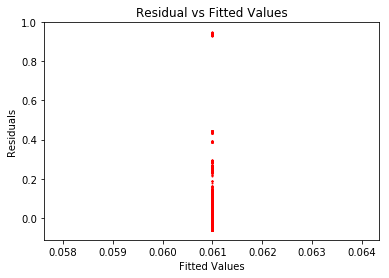

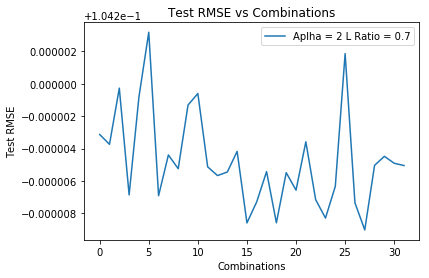

('For alpha: ', 2, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 28, '\tTestRMSE: ', 0.10419160853031509)
('Training MSE for each fold : ', [0.01089228263199242, 0.010973469326921208, 0.010633332171420658, 0.010496282625328906, 0.010714829124630725, 0.010837891413761996, 0.010942062599644328, 0.011057096936757079, 0.010989307337393684, 0.011017463900080876], '\n\n')
('Testing MSE for each fold : ', [0.01052467467274679, 0.009794134861522575, 0.012854847750027626, 0.014092186858076653, 0.012121876251438022, 0.011014395408169073, 0.010076460494773742, 0.009042724194452371, 0.00965062756002121, 0.009396986199044315], '\n\n')
('Training RMSE:', 0.10418925955583515)
('Testing RMSE:', 0.10419640792765957)


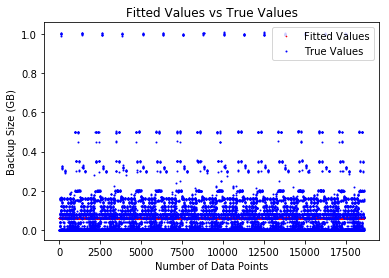

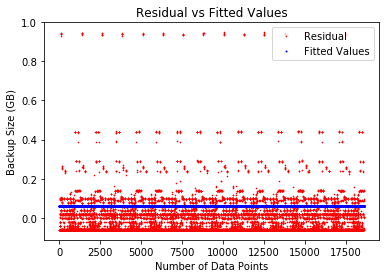

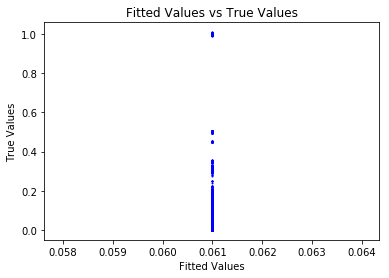

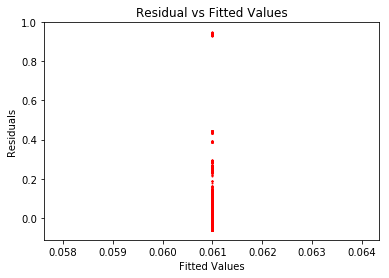

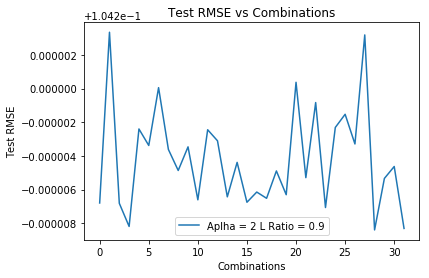

('For alpha: ', 2, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 2, '\tTestRMSE: ', 0.1041902638820812)
('Training MSE for each fold : ', [0.010906095380019241, 0.011041398166056355, 0.010684605098362585, 0.01111232537738516, 0.010739665472478064, 0.01099993473509778, 0.010738643905804148, 0.01084054957309877, 0.010786628893641013, 0.010704546042099116], '\n\n')
('Testing MSE for each fold : ', [0.010400142375015551, 0.009182736436158226, 0.012393228405403592, 0.008546755056318052, 0.01189822336118868, 0.009555609086666316, 0.011907475324218823, 0.010989914373595326, 0.011475498022626783, 0.012215298834526359], '\n\n')
('Training RMSE:', 0.10418943931322514)
('Testing RMSE:', 0.10419447263445299)


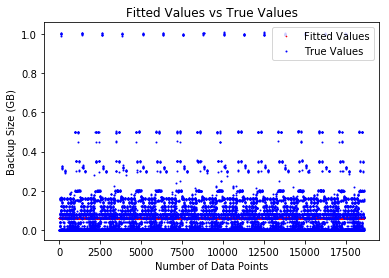

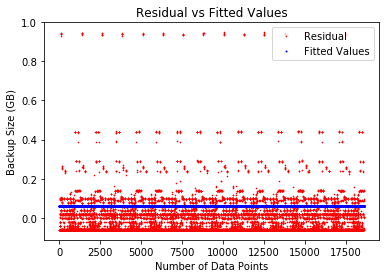

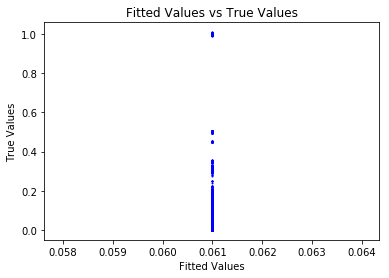

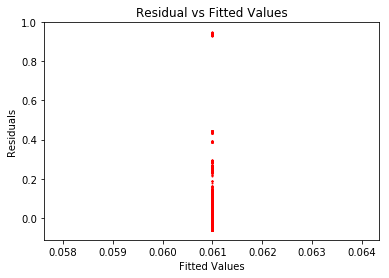

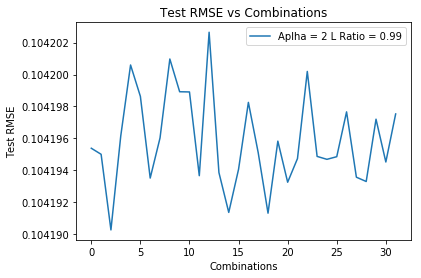

('For alpha: ', 2, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 26, '\tTestRMSE: ', 0.10419232587013104)
('Training MSE for each fold : ', [0.011047847789505742, 0.01073345340421283, 0.010518811309983379, 0.011027730821358698, 0.010982575610600172, 0.010657948690387824, 0.010901651326918638, 0.010928173871688422, 0.010883385566234473, 0.010872264909998642], '\n\n')
('Testing MSE for each fold : ', [0.009126173162960152, 0.011955761493542414, 0.013887945121024476, 0.009306680683739193, 0.009712177527616326, 0.012633358736134408, 0.010440068312647674, 0.010201482530716618, 0.010604634137342112, 0.010705454881776537], '\n\n')
('Training RMSE:', 0.10418917568581143)
('Testing RMSE:', 0.10419872196313154)


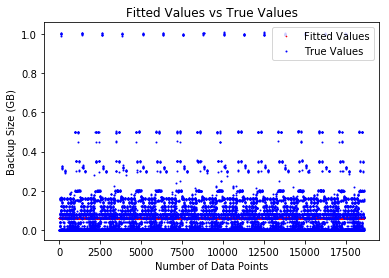

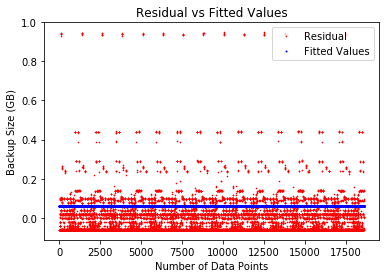

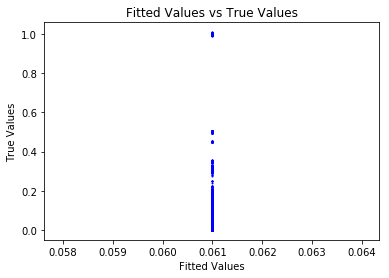

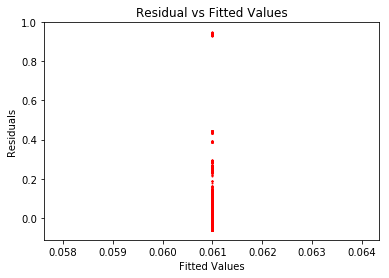

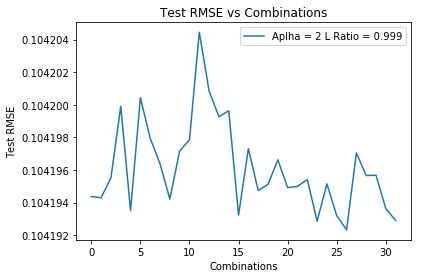

('For alpha: ', 5, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 18, '\tTestRMSE: ', 0.10204117780629926)
('Training MSE for each fold : ', [0.010282096970046034, 0.0103548992925676, 0.010680221157186481, 0.01046118137013577, 0.010331373449675713, 0.010620161457136318, 0.010120125247594805, 0.010423031740535469, 0.01073445905381091, 0.010088553274850172], '\n\n')
('Testing MSE for each fold : ', [0.011562740445251733, 0.010884202806518984, 0.007969151541217492, 0.009935098948361325, 0.01112975268436779, 0.008499167987397846, 0.013053809446623077, 0.010281728769504592, 0.007464959770592651, 0.013343205282896007], '\n\n')
('Training RMSE:', 0.10202749777071829)
('Testing RMSE:', 0.1020410788274661)


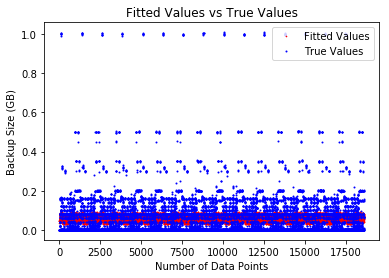

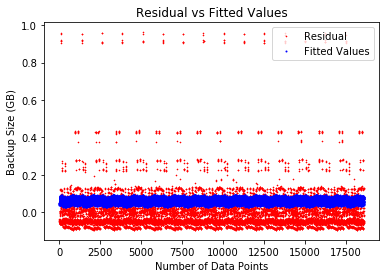

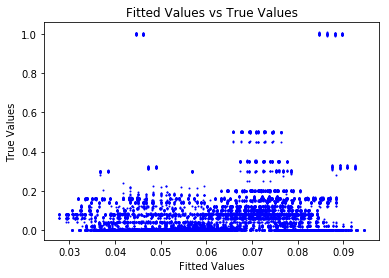

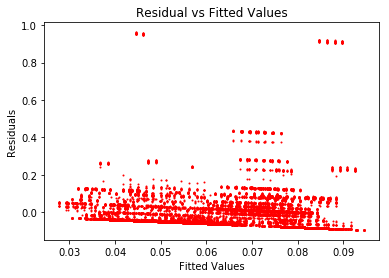

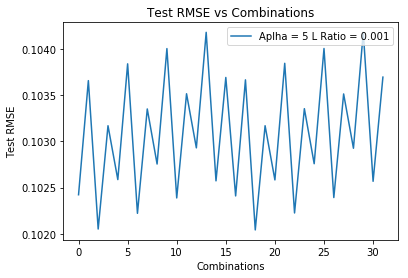

('For alpha: ', 5, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 20, '\tTestRMSE: ', 0.10313224220300621)
('Training MSE for each fold : ', [0.010354368357536628, 0.010560774479737646, 0.01092073457772383, 0.010923189034781393, 0.010618299869886638, 0.010894170489361667, 0.010807121794153544, 0.0106035788812042, 0.010334143159825353, 0.010329068021735797], '\n\n')
('Testing MSE for each fold : ', [0.013152379261681151, 0.011294603167390926, 0.008070602655435596, 0.008056949784780311, 0.010726355622826637, 0.00826592737969886, 0.009071902918336242, 0.01093084097808654, 0.013384032027387683, 0.013427315894713587], '\n\n')
('Training RMSE:', 0.10312392965066193)
('Testing RMSE:', 0.10314112162001028)


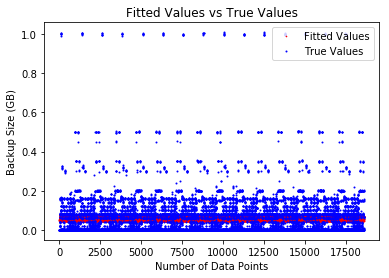

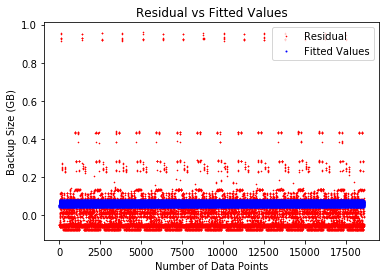

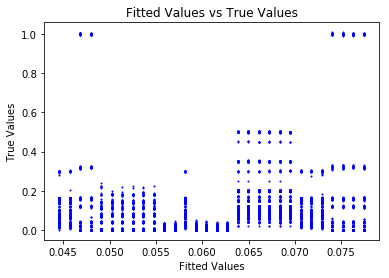

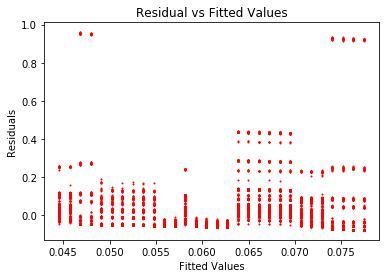

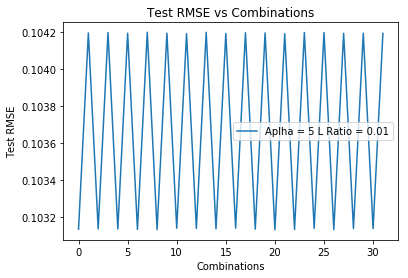

('For alpha: ', 5, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 17, '\tTestRMSE: ', 0.10419055848428696)
('Training MSE for each fold : ', [0.011153179836117862, 0.010785461061748013, 0.010924703277515428, 0.010960832457065315, 0.010433814115365295, 0.010879157187242324, 0.010832442540358526, 0.010654346951427935, 0.011079163782103475, 0.010850802937310913], '\n\n')
('Testing MSE for each fold : ', [0.008178339036019678, 0.01148579015499113, 0.010232888859587222, 0.009907530917807892, 0.014653634215782871, 0.010642612781996168, 0.011063077486458121, 0.012666133505584157, 0.008843684742068399, 0.010897847172494523], '\n\n')
('Training RMSE:', 0.10418920488527356)
('Testing RMSE:', 0.10419766737926053)


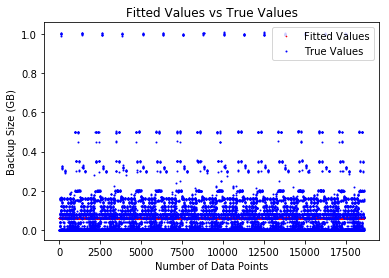

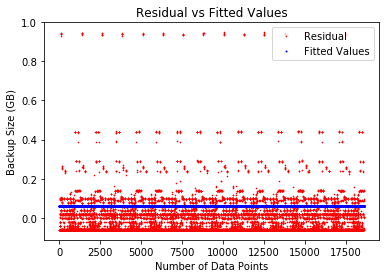

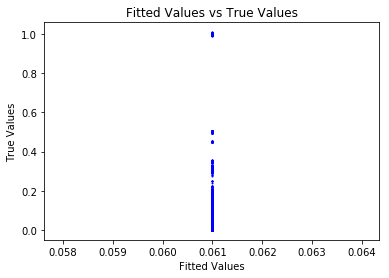

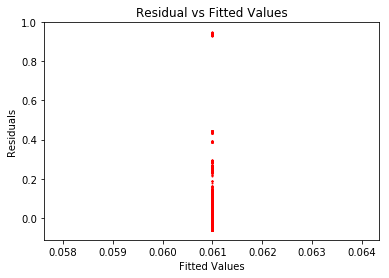

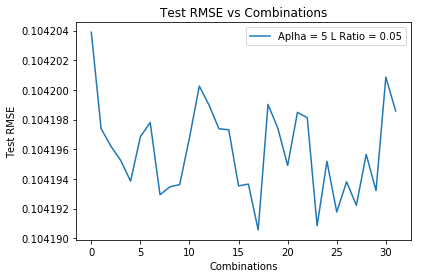

('For alpha: ', 5, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 21, '\tTestRMSE: ', 0.10419136721686184)
('Training MSE for each fold : ', [0.010780729677242135, 0.010844728055279362, 0.011116277509476736, 0.010869587923333734, 0.010784286814726651, 0.010916751249160852, 0.01096762952666523, 0.011003626153935714, 0.010611819135536793, 0.010658839231604928], '\n\n')
('Testing MSE for each fold : ', [0.011528207762311952, 0.01095230578138098, 0.0085097049220132, 0.010728762831904689, 0.011496410582375171, 0.010304360908340653, 0.009846404016052758, 0.009525103110506083, 0.013050319926738918, 0.01262685005064701], '\n\n')
('Training RMSE:', 0.10418938298932486)
('Testing RMSE:', 0.10419617550192109)


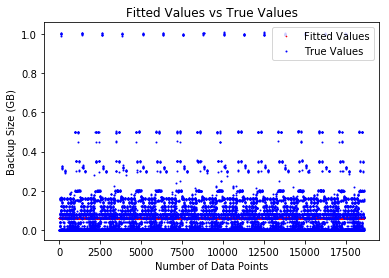

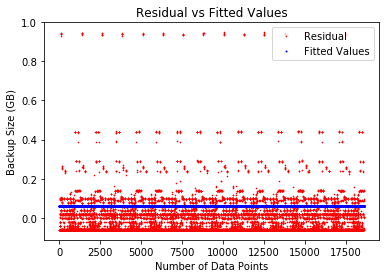

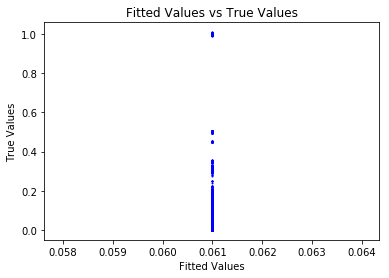

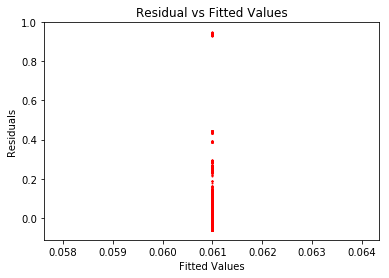

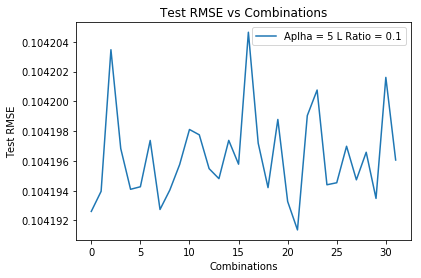

('For alpha: ', 5, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 31, '\tTestRMSE: ', 0.10419068028969797)
('Training MSE for each fold : ', [0.010972751511196043, 0.010823673005191782, 0.010820369232052382, 0.010960029263430976, 0.010696412310739273, 0.010846313849267571, 0.011052092150461218, 0.010665138704655136, 0.011002877764747945, 0.010714402459998764], '\n\n')
('Testing MSE for each fold : ', [0.00980174934746129, 0.011141832457262269, 0.011171694444581198, 0.009915059947277574, 0.012287171260208535, 0.010941153400941659, 0.009087440378329648, 0.012569224949811319, 0.00952850305348825, 0.0121260146631059], '\n\n')
('Training RMSE:', 0.10418927979967088)
('Testing RMSE:', 0.10419685403238796)


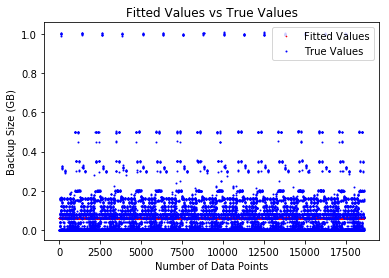

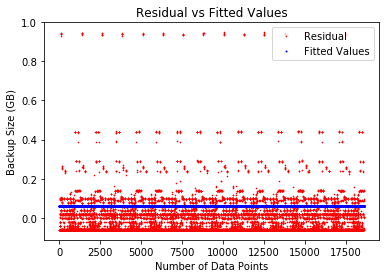

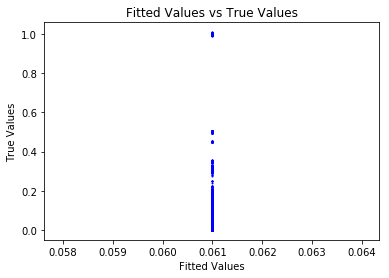

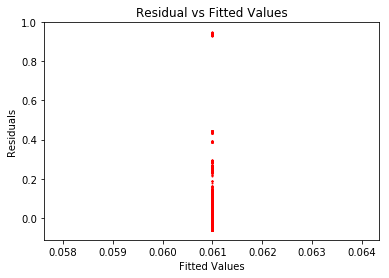

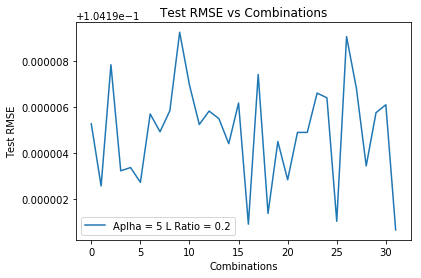

('For alpha: ', 5, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 3, '\tTestRMSE: ', 0.10419160875314469)
('Training MSE for each fold : ', [0.010761251320843353, 0.01099858203834575, 0.010903225305609106, 0.011015187644408467, 0.010706685256002954, 0.010546207616400727, 0.01081011402633161, 0.010915652668622822, 0.011090121706235374, 0.010807040513704378], '\n\n')
('Testing MSE for each fold : ', [0.011705084378750825, 0.00956975499386277, 0.010427180930881507, 0.009418422131908605, 0.012194565421306845, 0.013639590788287427, 0.011264509995017474, 0.010314385142032706, 0.008743396640259513, 0.011291729039920722], '\n\n')
('Training RMSE:', 0.10418928356434003)
('Testing RMSE:', 0.10419626646969093)


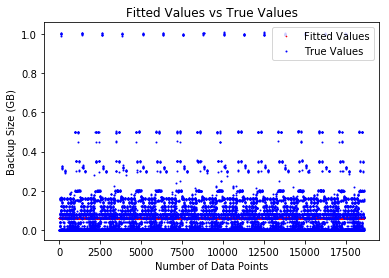

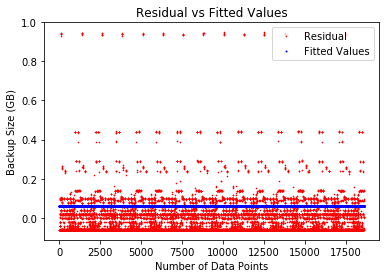

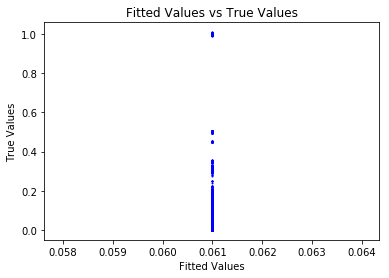

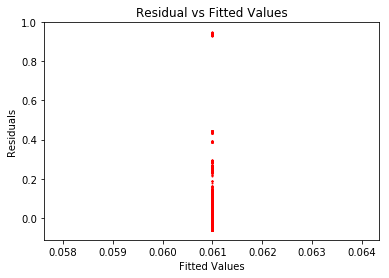

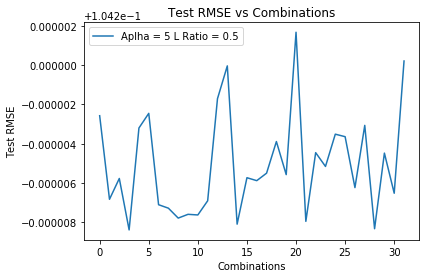

('For alpha: ', 5, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 12, '\tTestRMSE: ', 0.10419228752911446)
('Training MSE for each fold : ', [0.010870276930346253, 0.011096210832398366, 0.010740954039848887, 0.010881891260970361, 0.010624510937350565, 0.010825715446805115, 0.011114772128397362, 0.010826616172090797, 0.010629426322139084, 0.010944410692557121], '\n\n')
('Testing MSE for each fold : ', [0.01072239065325093, 0.008689407329614403, 0.011886170662315166, 0.010617859316071784, 0.012934097496113472, 0.011123645721548569, 0.008522266964728027, 0.011115288885489766, 0.012890991994532723, 0.010054818258647354], '\n\n')
('Training RMSE:', 0.10418962748897027)
('Testing RMSE:', 0.10419066046547176)


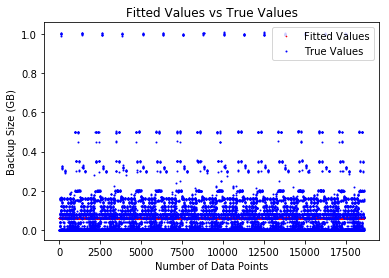

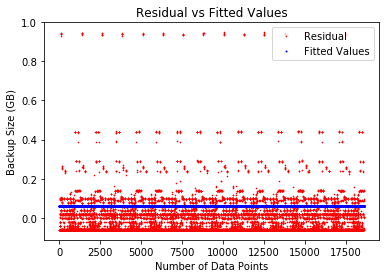

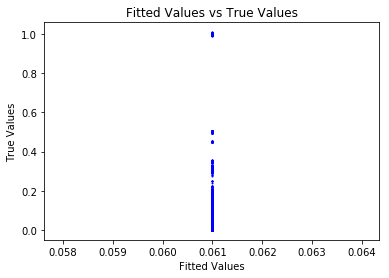

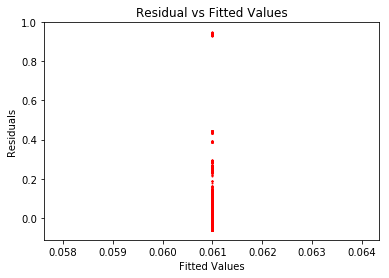

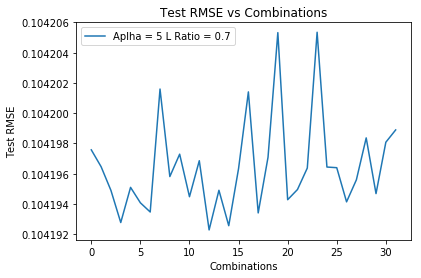

('For alpha: ', 5, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 30, '\tTestRMSE: ', 0.10419228392135513)
('Training MSE for each fold : ', [0.010900813461560459, 0.010647803196524728, 0.010822829329340068, 0.010804987431752592, 0.010859223305729023, 0.010989793784637863, 0.010858837676437357, 0.011060055732220573, 0.010624391492155747, 0.010985428672911687], '\n\n')
('Testing MSE for each fold : ', [0.010449534413463033, 0.01272463398570789, 0.01114990417958834, 0.011311075167106239, 0.010822730941599381, 0.009647467938975082, 0.010825320520729069, 0.009014719654024296, 0.012937682332982533, 0.009685445204799532], '\n\n')
('Training RMSE:', 0.10418932962797588)
('Testing RMSE:', 0.10419621602485159)


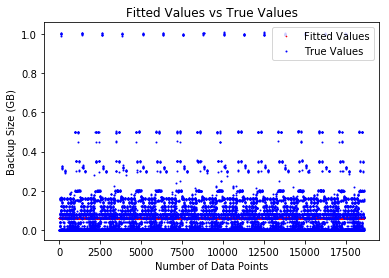

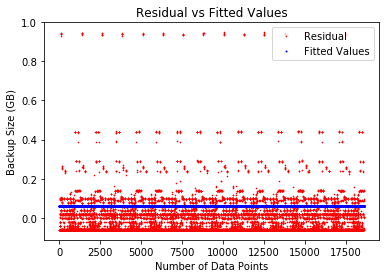

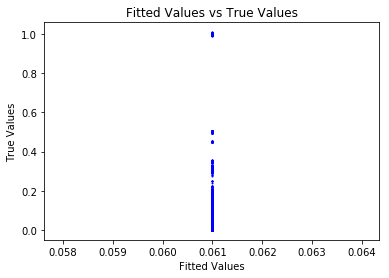

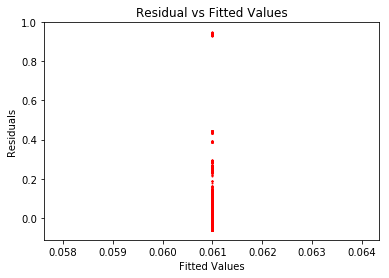

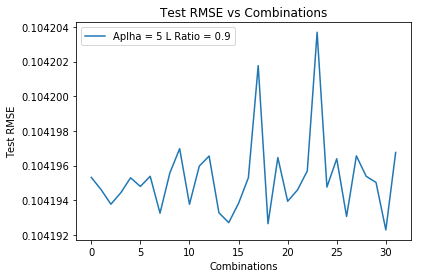

('For alpha: ', 5, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 28, '\tTestRMSE: ', 0.10419057027201556)
('Training MSE for each fold : ', [0.010805265911905447, 0.010481005048207563, 0.01097667262421419, 0.010945164256760835, 0.010961184152990881, 0.010842324838344759, 0.010882271232073356, 0.010821414477532373, 0.010777682086240793, 0.011061344530707628], '\n\n')
('Testing MSE for each fold : ', [0.011307419484941565, 0.014228471152355194, 0.009765892947472855, 0.010048501454249695, 0.00990484050920141, 0.010973916541162108, 0.010614440201421157, 0.011162181610102306, 0.011556100485283763, 0.009002242937233638], '\n\n')
('Training RMSE:', 0.1041894088470502)
('Testing RMSE:', 0.10419405324845737)


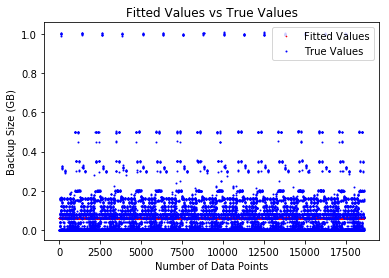

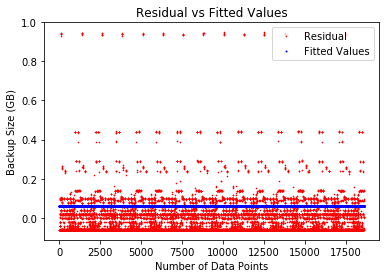

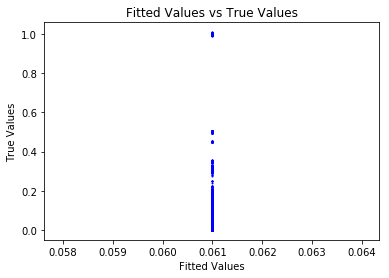

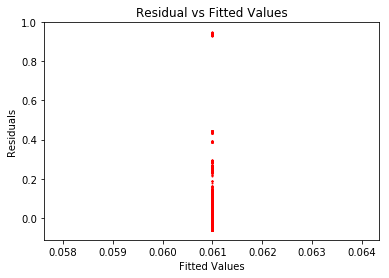

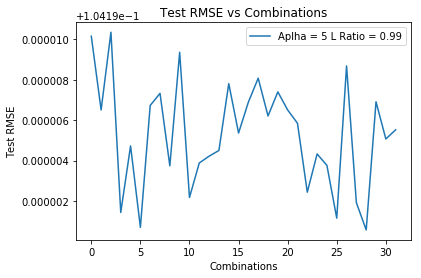

('For alpha: ', 5, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 11, '\tTestRMSE: ', 0.1041919250583318)
('Training MSE for each fold : ', [0.010688933659161551, 0.010661278868216327, 0.010904791397465212, 0.010741943873950291, 0.011080101608552327, 0.01127806705331397, 0.011020647362614945, 0.010806834649605055, 0.010710255823451099, 0.010660554440262053], '\n\n')
('Testing MSE for each fold : ', [0.012357784497798447, 0.01260388418125049, 0.010412226683593815, 0.011878486486869322, 0.008835238744883733, 0.007055271704885789, 0.00937129235919029, 0.011294365553874967, 0.012163919321838003, 0.012611824104871055], '\n\n')
('Training RMSE:', 0.1041889671398046)
('Testing RMSE:', 0.10420378766583098)


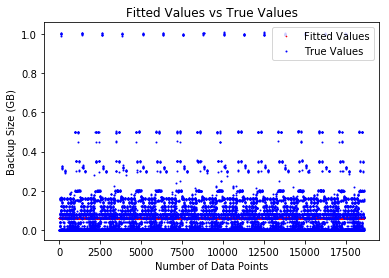

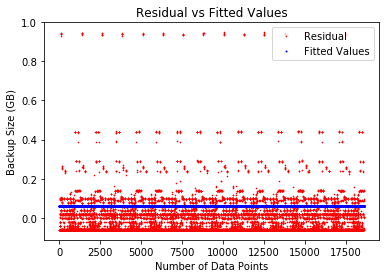

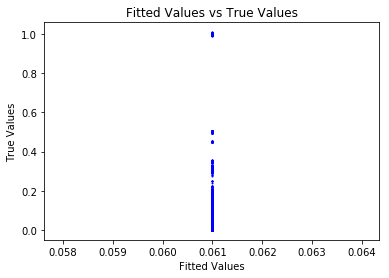

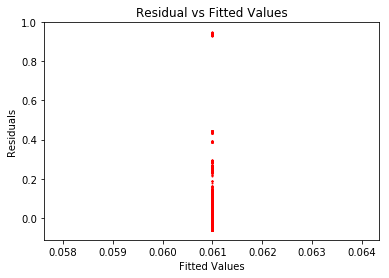

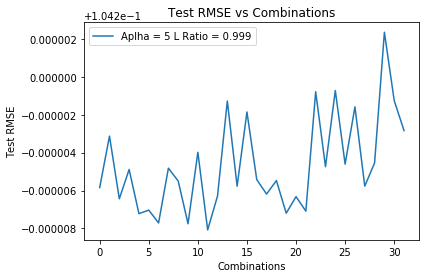

('For alpha: ', 10, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 2, '\tTestRMSE: ', 0.1026747241928765)
('Training MSE for each fold : ', [0.010404649544552134, 0.010866398726399565, 0.010453400585348743, 0.010790601183357456, 0.010539875019272251, 0.010723395043658353, 0.010462803381222704, 0.010386989610192264, 0.010468374298523889, 0.010299819486133208], '\n\n')
('Testing MSE for each fold : ', [0.011779870078369751, 0.007561213960749794, 0.011350403813059498, 0.008295196357131338, 0.010530511700000371, 0.008869480888775656, 0.011240412814110647, 0.011882687033678424, 0.011197937898739971, 0.012735081943909977], '\n\n')
('Training RMSE:', 0.10266270348995324)
('Testing RMSE:', 0.10268534291150097)


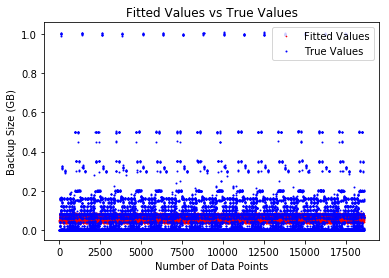

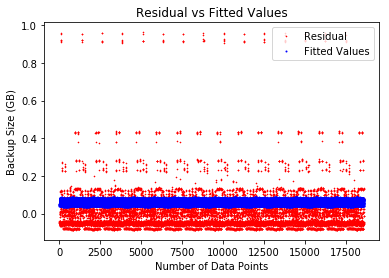

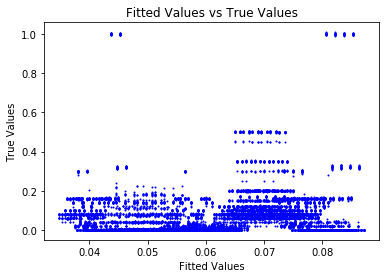

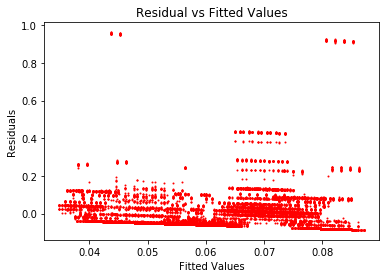

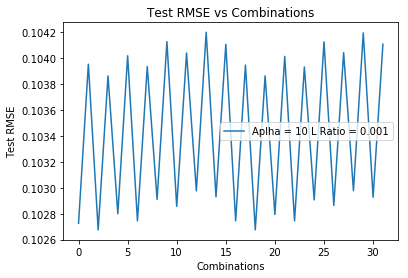

('For alpha: ', 10, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 8, '\tTestRMSE: ', 0.10364627791330401)
('Training MSE for each fold : ', [0.010430525144175163, 0.010859459036677963, 0.01093489902003815, 0.010709044357201433, 0.010851906233388588, 0.010429642348166238, 0.01095947205882661, 0.010751578859306504, 0.010758731296708485, 0.010722354970512379], '\n\n')
('Testing MSE for each fold : ', [0.013695829457968225, 0.009645485508306786, 0.008827507132182397, 0.011132922428066383, 0.009716769094019872, 0.013545368932112015, 0.008745963683407442, 0.010600476447576182, 0.010618475758568497, 0.010929864628383506], '\n\n')
('Training RMSE:', 0.10363764437934775)
('Testing RMSE:', 0.10366227041242697)


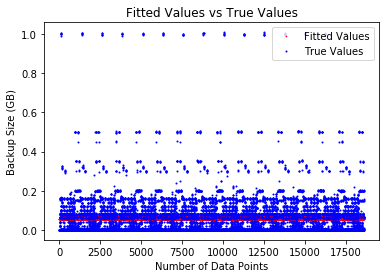

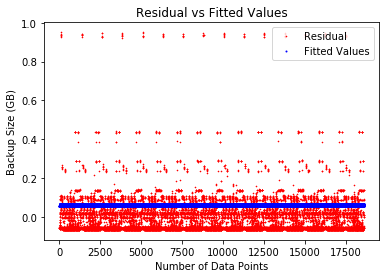

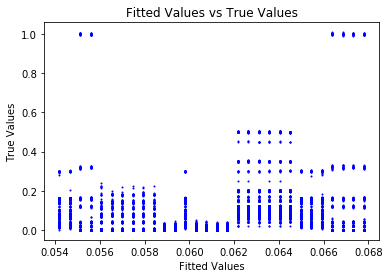

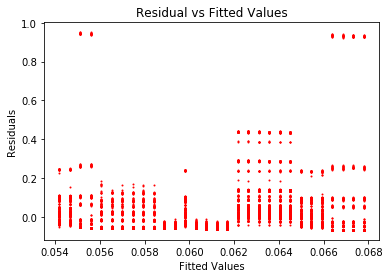

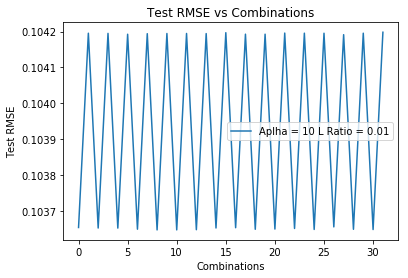

('For alpha: ', 10, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 5, '\tTestRMSE: ', 0.10419217583646262)
('Training MSE for each fold : ', [0.010830772289729111, 0.010883320460757216, 0.011028463443183973, 0.010679524174954262, 0.010947144281710276, 0.010669838392665961, 0.011097046828461786, 0.0110463863421893, 0.010926185922090015, 0.010445258198248382], '\n\n')
('Testing MSE for each fold : ', [0.011078951945024394, 0.01060561278357559, 0.00929891956391411, 0.012439798684431158, 0.010031329037243646, 0.01252839940003284, 0.008683112576268321, 0.009137755329476778, 0.010219461754845165, 0.014550849699261088], '\n\n')
('Training RMSE:', 0.10418922225162748)
('Testing RMSE:', 0.10419893990539111)


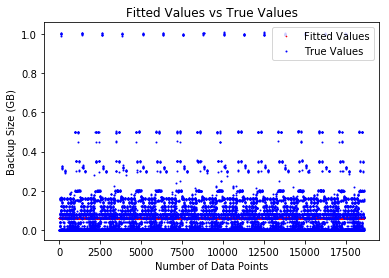

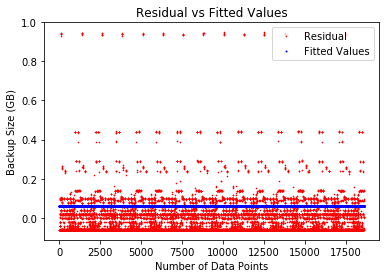

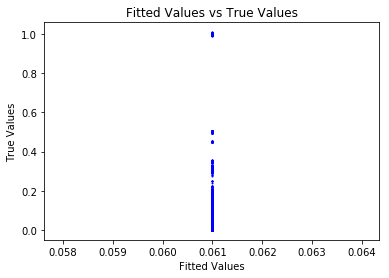

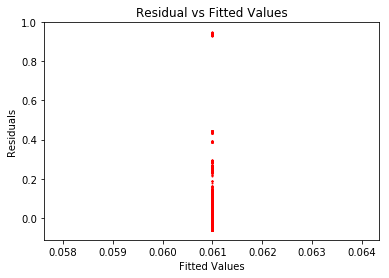

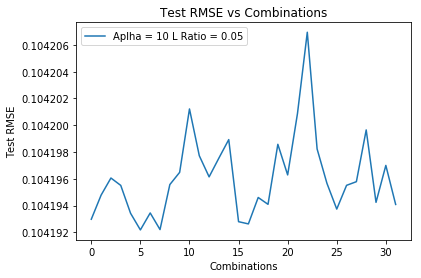

('For alpha: ', 10, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 7, '\tTestRMSE: ', 0.10419154508681538)
('Training MSE for each fold : ', [0.010646709852627476, 0.010853779884333446, 0.010785602061459421, 0.01091665951649462, 0.01102211952804458, 0.0110735965311815, 0.01062744133451701, 0.01102142719805907, 0.010819064491045758, 0.010788194309515938], '\n\n')
('Testing MSE for each fold : ', [0.012734345609709903, 0.010871006901182843, 0.01148447902946118, 0.010305033788437404, 0.009357102067443897, 0.00889285004918273, 0.01290834048616665, 0.00936229893488459, 0.01118342947252487, 0.011461461763984925], '\n\n')
('Training RMSE:', 0.10418953628233443)
('Testing RMSE:', 0.1041922972695098)


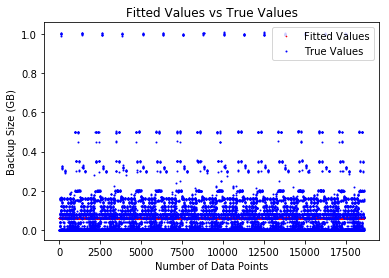

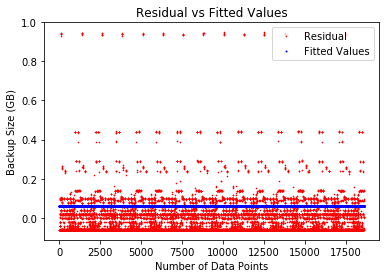

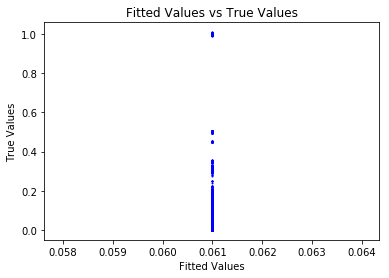

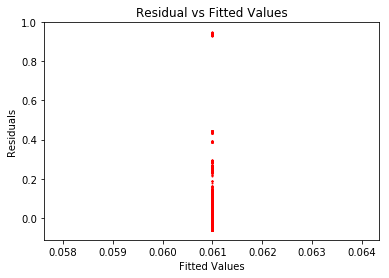

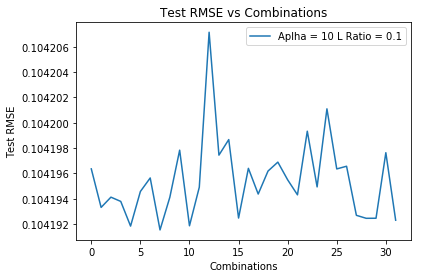

('For alpha: ', 10, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 21, '\tTestRMSE: ', 0.10419182210820287)
('Training MSE for each fold : ', [0.010791011457043349, 0.010774928858453247, 0.011045740458251848, 0.010661127816638598, 0.010806056745234693, 0.010718257809596026, 0.010979024998071928, 0.010825682680193596, 0.01086000034532036, 0.011092711737754184], '\n\n')
('Testing MSE for each fold : ', [0.011435884596099021, 0.011580597928938657, 0.009143597781503452, 0.012604567187527128, 0.01130122556941843, 0.012090417045835345, 0.00974470293400773, 0.011123756435664862, 0.010814877872608241, 0.008719639393552605], '\n\n')
('Training RMSE:', 0.10418951142344313)
('Testing RMSE:', 0.10419177834414549)


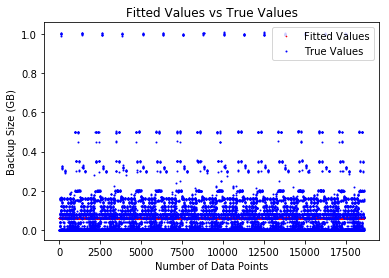

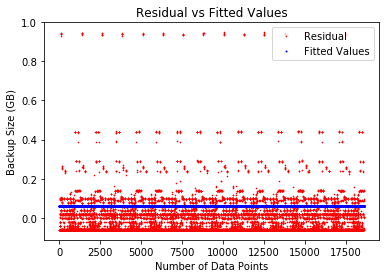

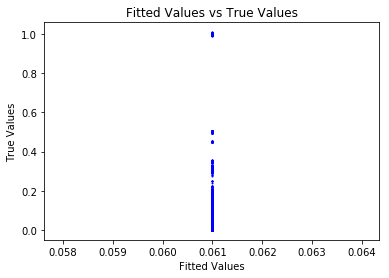

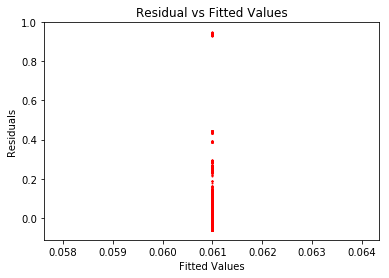

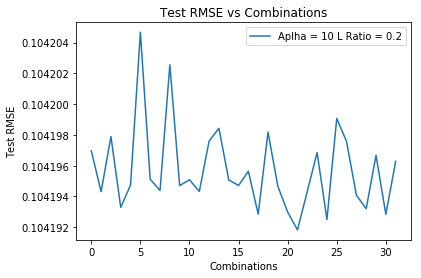

('For alpha: ', 10, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 4, '\tTestRMSE: ', 0.10419281981002695)
('Training MSE for each fold : ', [0.011012843751891386, 0.010897304475716607, 0.010736673575712475, 0.010676897557681517, 0.010966289101764172, 0.010889625721276275, 0.010868989825164833, 0.010765806989688077, 0.010884852298287097, 0.010855056224953098], '\n\n')
('Testing MSE for each fold : ', [0.009440740495865775, 0.0104791702115382, 0.011924942303995285, 0.012464334283389096, 0.009859648121275197, 0.010548389832904749, 0.010733958789338824, 0.011662671029584092, 0.01059112095082004, 0.010859426942757454], '\n\n')
('Training RMSE:', 0.10418941382028)
('Testing RMSE:', 0.10419424310463064)


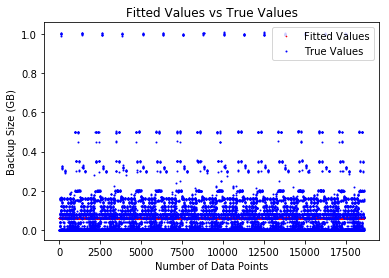

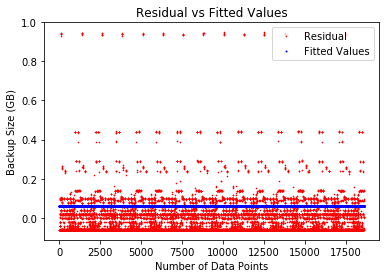

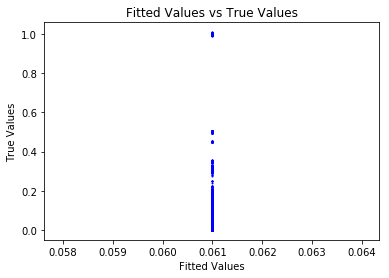

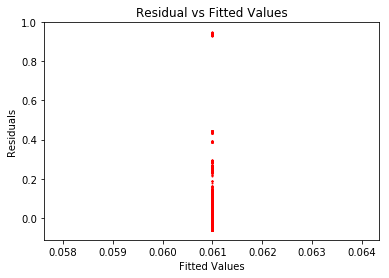

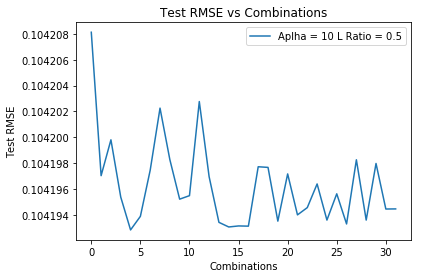

('For alpha: ', 10, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 17, '\tTestRMSE: ', 0.10419114564750169)
('Training MSE for each fold : ', [0.01081987037896089, 0.010864527879138152, 0.010706663508947301, 0.010819026092376569, 0.011001200880250613, 0.010909363542689196, 0.010987114749075585, 0.010777612273606229, 0.01109854554877355, 0.010570371701394549], '\n\n')
('Testing MSE for each fold : ', [0.01117612787199117, 0.01077413809280735, 0.012194742011008048, 0.011183751660721256, 0.009544222506844042, 0.010372631991488083, 0.009671134488614244, 0.011556310293487918, 0.008668051742299402, 0.013424534400247469], '\n\n')
('Training RMSE:', 0.10418939320065773)
('Testing RMSE:', 0.10419483915219072)


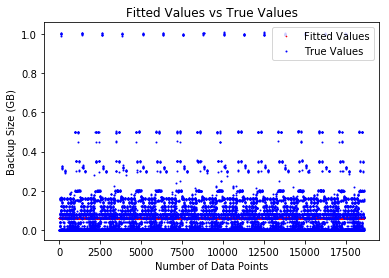

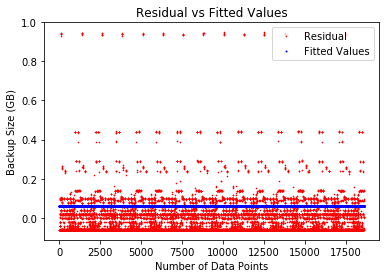

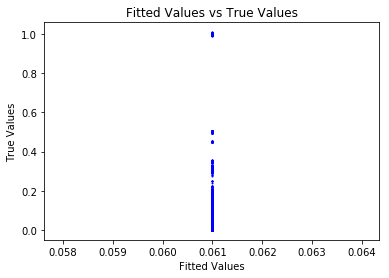

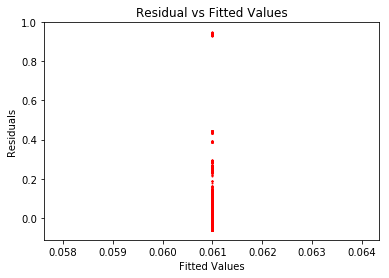

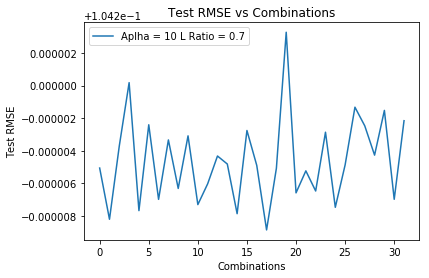

('For alpha: ', 10, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 17, '\tTestRMSE: ', 0.10419124609438012)
('Training MSE for each fold : ', [0.010838328407724715, 0.010545677753974102, 0.010995989196763123, 0.010668809734169176, 0.010677945502221767, 0.010814206926389437, 0.011195787258599672, 0.010729495993259227, 0.011174614837120005, 0.01091337802515094], '\n\n')
('Testing MSE for each fold : ', [0.011010245417964573, 0.01364368580938894, 0.009591133726729166, 0.012535363608193505, 0.012454082100352872, 0.011227646121423084, 0.00779471926130681, 0.01199050490317075, 0.007982749766823422, 0.010334202899513579], '\n\n')
('Training RMSE:', 0.10418936300571771)
('Testing RMSE:', 0.10419420982706606)


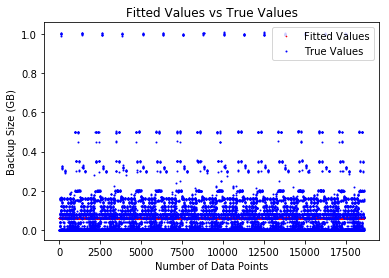

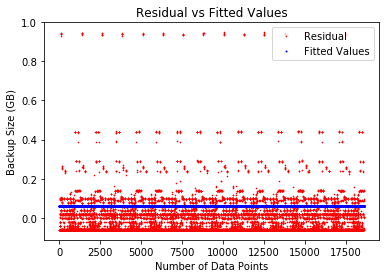

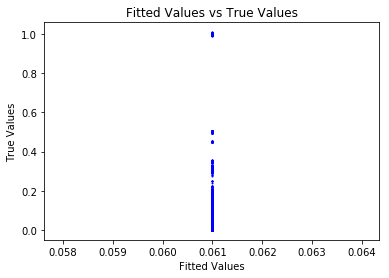

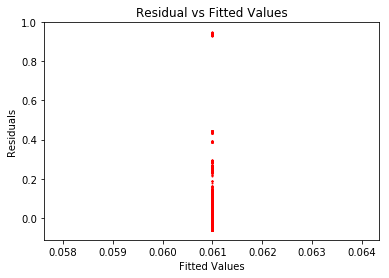

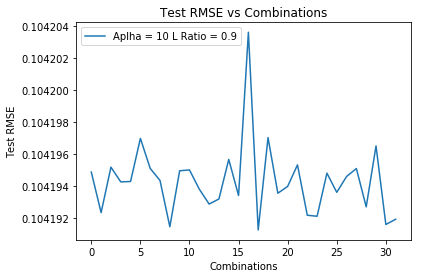

('For alpha: ', 10, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 0, '\tTestRMSE: ', 0.10419129131847095)
('Training MSE for each fold : ', [0.010967247295549319, 0.011067054086250078, 0.010949941226774465, 0.01064286474587052, 0.01084950177400341, 0.010882116513818088, 0.010516898858954885, 0.010741793612935736, 0.011152117023974235, 0.010784313616162444], '\n\n')
('Testing MSE for each fold : ', [0.009849748271533825, 0.008953008634411435, 0.010005487277003261, 0.012771127579324004, 0.010909332476174233, 0.010616468292820428, 0.013904503061189635, 0.011878589217598283, 0.008187303682482848, 0.011496984517695898], '\n\n')
('Training RMSE:', 0.10418917830287998)
('Testing RMSE:', 0.10419815401926939)


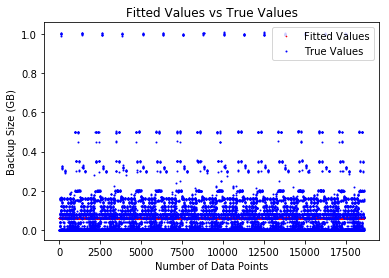

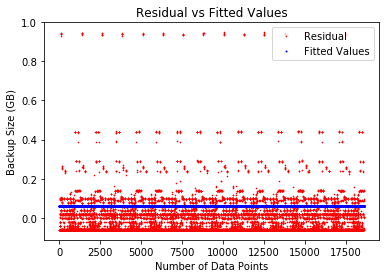

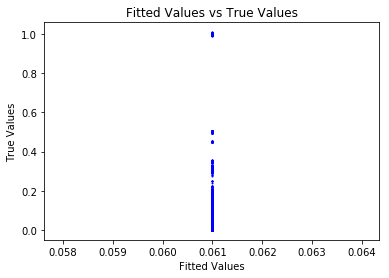

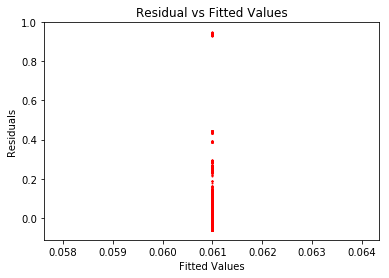

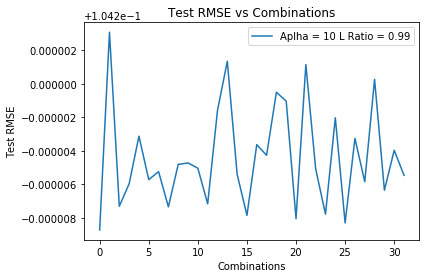

('For alpha: ', 10, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 16, '\tTestRMSE: ', 0.10419214558935931)
('Training MSE for each fold : ', [0.011047808357494453, 0.011025619801085506, 0.010728354961848199, 0.01108980635510079, 0.010773476297240816, 0.010486401361536208, 0.01064432064706997, 0.010857451070279911, 0.011082173914645421, 0.010818799309572085], '\n\n')
('Testing MSE for each fold : ', [0.00912604196769184, 0.00932463617229373, 0.011999519969136516, 0.008747800075171832, 0.011593479588477932, 0.014179595750935175, 0.012756496246311758, 0.010838075072170621, 0.008814391199532753, 0.011185825051312269], '\n\n')
('Training RMSE:', 0.10418935265941207)
('Testing RMSE:', 0.10419494282019374)


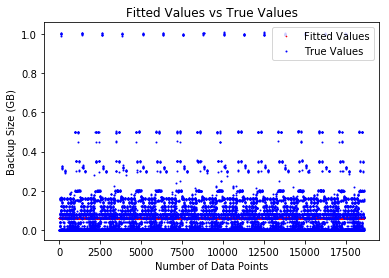

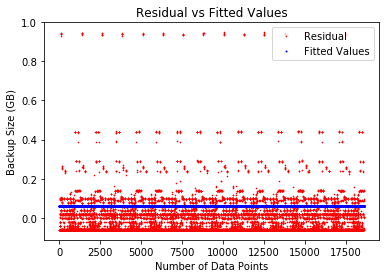

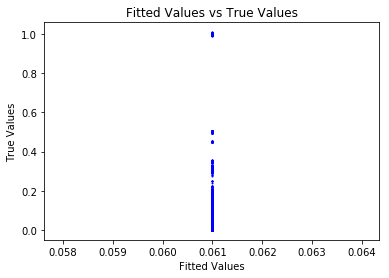

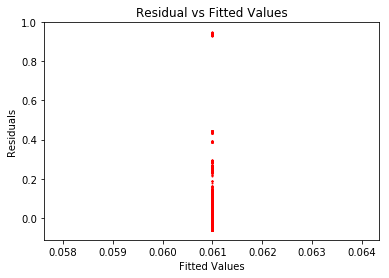

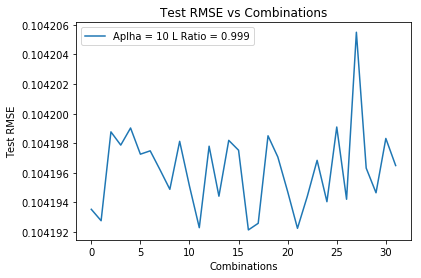

('For alpha: ', 50, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 2, '\tTestRMSE: ', 0.10341244894068209)
('Training MSE for each fold : ', [0.010837006825500805, 0.010982340760111564, 0.01070934997236211, 0.01063911129937047, 0.01062465673815304, 0.010703327798009045, 0.010857680010326484, 0.010649387510314818, 0.010258095941102656, 0.010668057389691114], '\n\n')
('Testing MSE for each fold : ', [0.009333444963265542, 0.008092801814262487, 0.01055266928283931, 0.011187044175433017, 0.011330910278283446, 0.010578264134380655, 0.00921918159347004, 0.011100664931049989, 0.014598246839180564, 0.010953367192482294], '\n\n')
('Training RMSE:', 0.10340648637534404)
('Testing RMSE:', 0.10341498692387256)


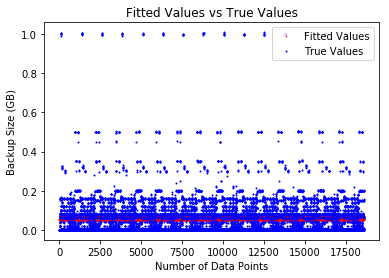

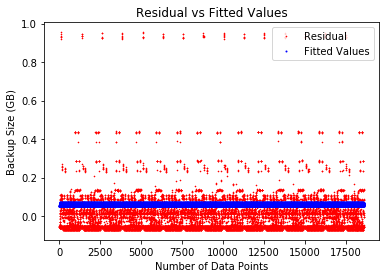

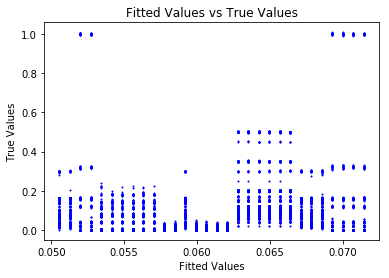

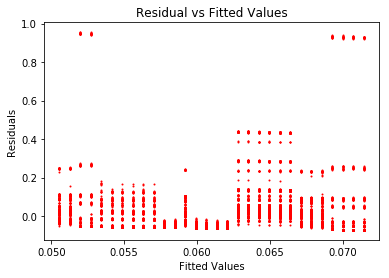

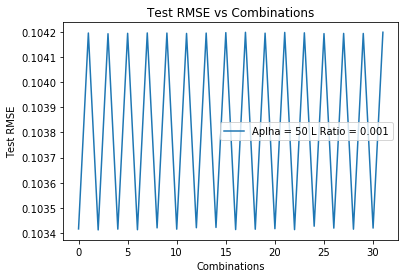

('For alpha: ', 50, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 3, '\tTestRMSE: ', 0.1041909024538071)
('Training MSE for each fold : ', [0.010994639884650017, 0.010883025049478265, 0.010740232610726394, 0.010758755106714517, 0.010762594639774779, 0.011143996904996824, 0.011014261440029288, 0.010750123941533499, 0.010790970686187368, 0.010715964627782775], '\n\n')
('Testing MSE for each fold : ', [0.009603519085784738, 0.010607754938285167, 0.01189376001829849, 0.011725953998264312, 0.011691415581872653, 0.008259421142510968, 0.00942735023731271, 0.011804159913268313, 0.011436408371875853, 0.012111771077128713], '\n\n')
('Training RMSE:', 0.10418952197408037)
('Testing RMSE:', 0.10419285693587729)


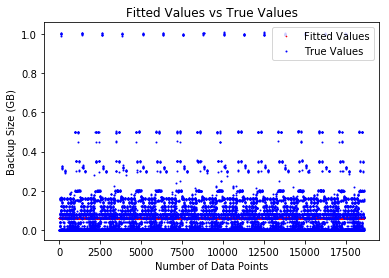

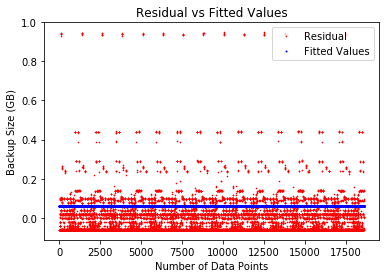

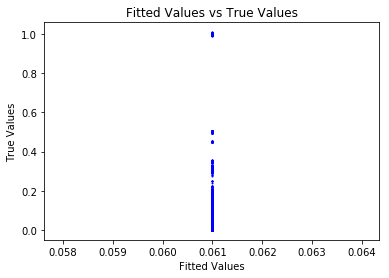

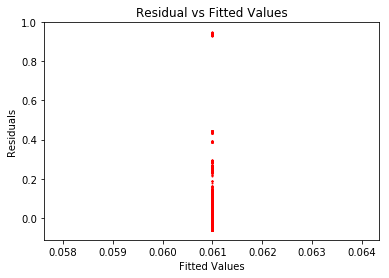

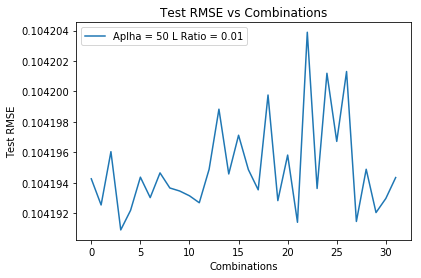

('For alpha: ', 50, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 9, '\tTestRMSE: ', 0.10419032608841562)
('Training MSE for each fold : ', [0.010433496781686492, 0.010804402887623339, 0.011085150747247446, 0.010697084966358503, 0.011021653117420545, 0.010971881874673864, 0.010899665541960082, 0.010993805216076286, 0.010500030791414964, 0.011146901486241886], '\n\n')
('Testing MSE for each fold : ', [0.014653735482845345, 0.011315171264934915, 0.008788827617006405, 0.012282639989690614, 0.009360420126055962, 0.009808217589279713, 0.01045796927114938, 0.009611027582842192, 0.014057959815725649, 0.008234047738311004], '\n\n')
('Training RMSE:', 0.10418928611460172)
('Testing RMSE:', 0.10419693684453549)


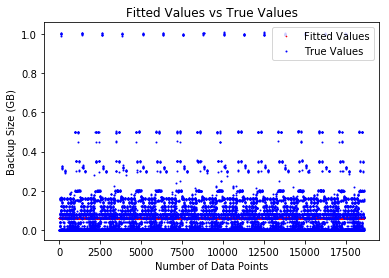

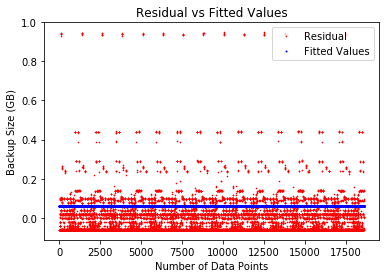

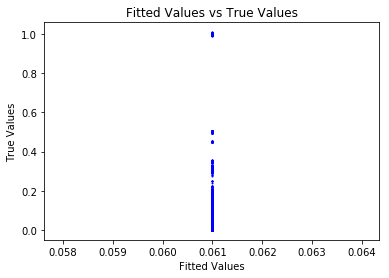

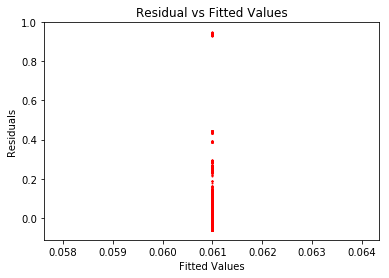

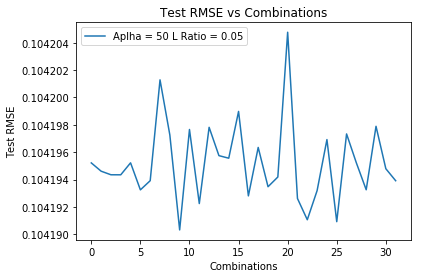

('For alpha: ', 50, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 26, '\tTestRMSE: ', 0.10419068264926552)
('Training MSE for each fold : ', [0.011024254230508622, 0.010713832448602531, 0.010789562162204247, 0.011037669090823028, 0.011018676769495979, 0.010684181769039413, 0.010844568131709371, 0.010888017588877532, 0.010632255585571368, 0.010921231058405789], '\n\n')
('Testing MSE for each fold : ', [0.009337768283363, 0.012130250841786852, 0.011448721445609248, 0.009217337965318748, 0.009388363798778205, 0.012397185078248872, 0.010954327197633501, 0.01056280401954468, 0.012866219997745384, 0.010264262491194383], '\n\n')
('Training RMSE:', 0.10418937030006366)
('Testing RMSE:', 0.10419560505089592)


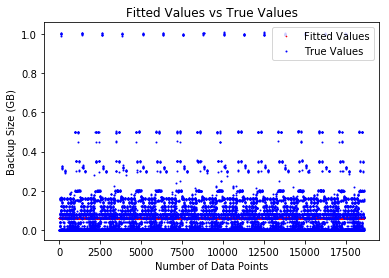

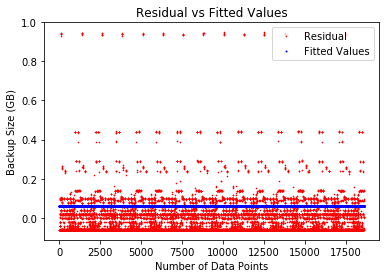

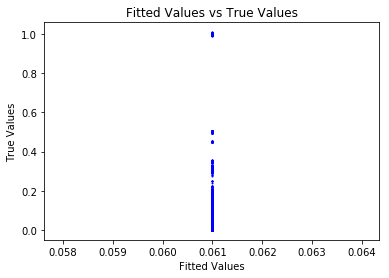

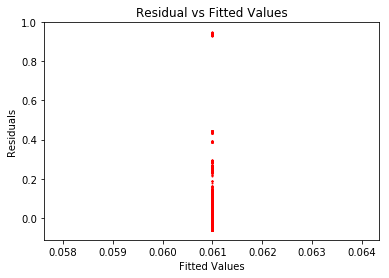

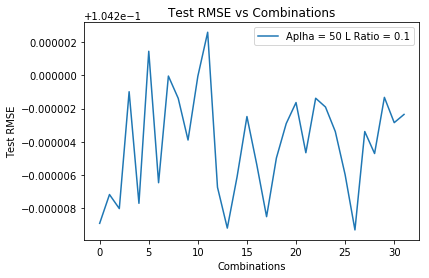

('For alpha: ', 50, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 14, '\tTestRMSE: ', 0.10419211679394154)
('Training MSE for each fold : ', [0.011021190246910362, 0.01071964410587739, 0.011022191241800183, 0.010593527883929085, 0.010979038267273037, 0.011176646708235696, 0.01088419875863188, 0.01025372020817402, 0.011074513730809326, 0.010828278159692534], '\n\n')
('Testing MSE for each fold : ', [0.009365099694087185, 0.012078879612753286, 0.009355471394321363, 0.013213878237095194, 0.009745379035139154, 0.007966245422470871, 0.01059717471902353, 0.016281776329456665, 0.008884248633847347, 0.011101687952090314], '\n\n')
('Training RMSE:', 0.10418874666264755)
('Testing RMSE:', 0.10420644943106205)


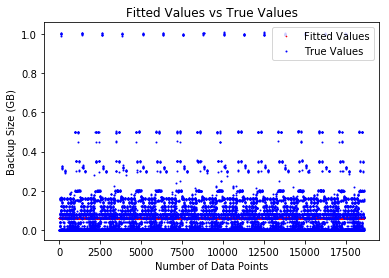

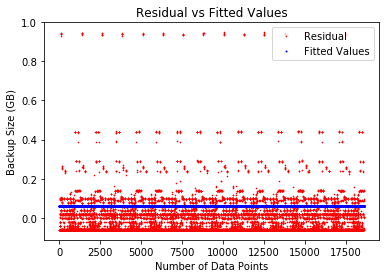

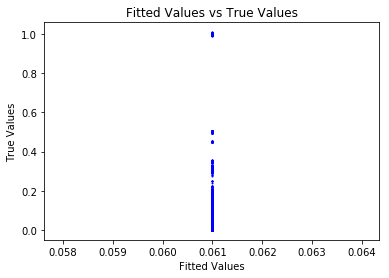

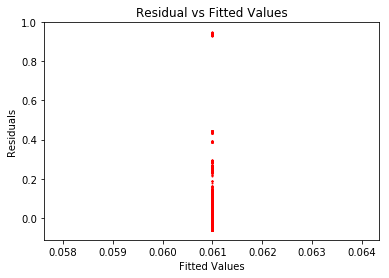

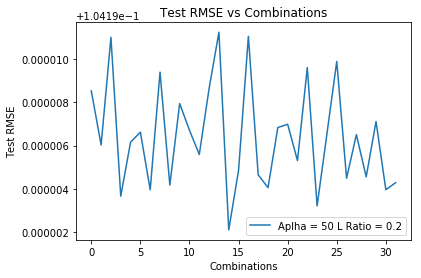

('For alpha: ', 50, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 2, '\tTestRMSE: ', 0.10419195835169733)
('Training MSE for each fold : ', [0.010821966816950636, 0.010719677733486933, 0.010817769448766204, 0.011163466230286611, 0.010782481657872895, 0.010875776814794643, 0.010563758751623983, 0.011031507843625485, 0.010844922154237317, 0.01093297577576327], '\n\n')
('Testing MSE for each fold : ', [0.011158247214661549, 0.012077682007835348, 0.011194886124308277, 0.008086024510388437, 0.01151290222264879, 0.010673015609101619, 0.01348173970919725, 0.009271470912879111, 0.010950607133991591, 0.010158290089605334], '\n\n')
('Training RMSE:', 0.10418939640261286)
('Testing RMSE:', 0.10419446508074089)


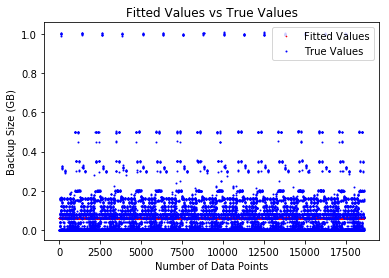

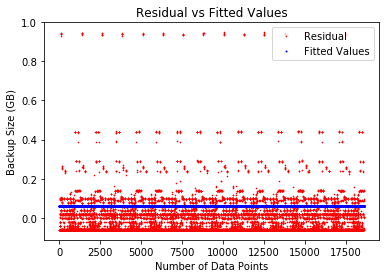

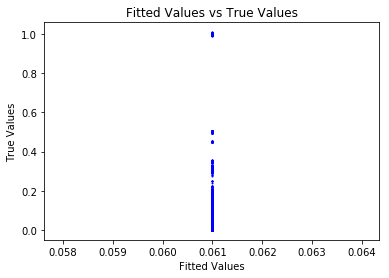

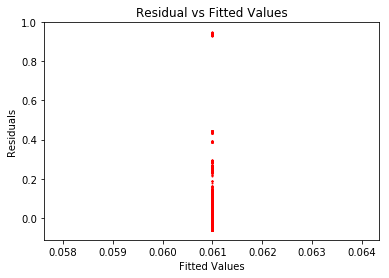

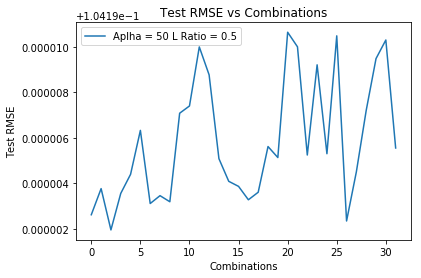

('For alpha: ', 50, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 26, '\tTestRMSE: ', 0.10419169422218436)
('Training MSE for each fold : ', [0.010811786285188111, 0.010934805561775061, 0.010866870431695885, 0.010770240124673746, 0.011009869275411215, 0.011203951126643096, 0.010772992996862615, 0.010715093398337063, 0.010710876350477223, 0.01075782259368346], '\n\n')
('Testing MSE for each fold : ', [0.0112487345143314, 0.01014227722803185, 0.010753575034067943, 0.011623388942977686, 0.009466718780168245, 0.007720474902570583, 0.011598068379663349, 0.012119382867092429, 0.012157659509004087, 0.011736341205836541], '\n\n')
('Training RMSE:', 0.10418939876242087)
('Testing RMSE:', 0.10419530765046194)


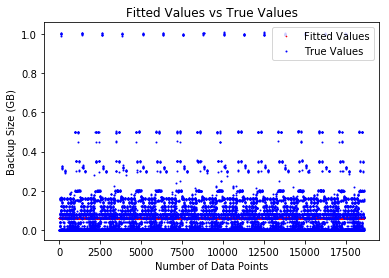

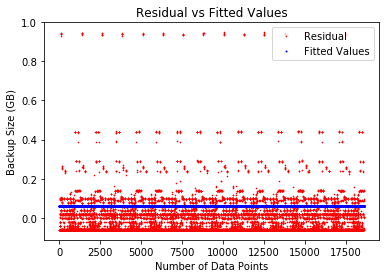

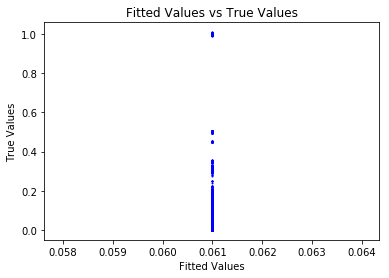

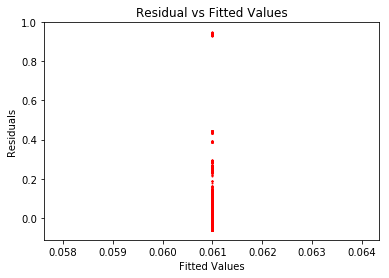

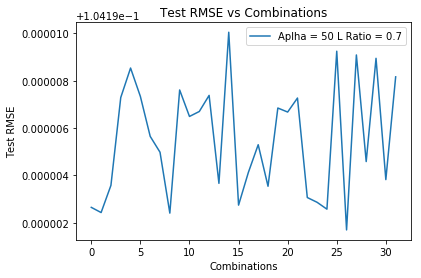

('For alpha: ', 50, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 12, '\tTestRMSE: ', 0.10419284421045116)
('Training MSE for each fold : ', [0.010958081475960368, 0.010762721791003533, 0.01073673626742049, 0.010935530187579794, 0.010896093544213307, 0.01097900399246501, 0.010905501721655901, 0.01054863336819927, 0.011084328344856472, 0.010747330508348982], '\n\n')
('Testing MSE for each fold : ', [0.009933043001819613, 0.011690886627798188, 0.011924475410276603, 0.010135351836318258, 0.010490054908059139, 0.009745381172710732, 0.01040540850491087, 0.013620192986262722, 0.008796496368702162, 0.011829751704191541], '\n\n')
('Training RMSE:', 0.10418923226596073)
('Testing RMSE:', 0.10419742920103636)


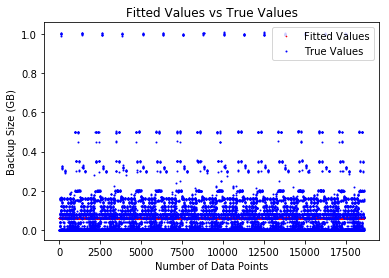

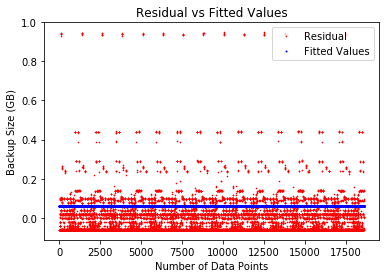

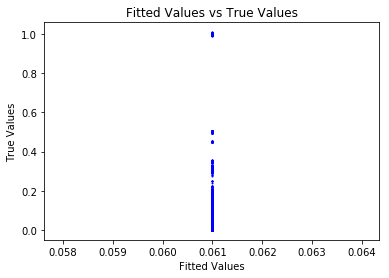

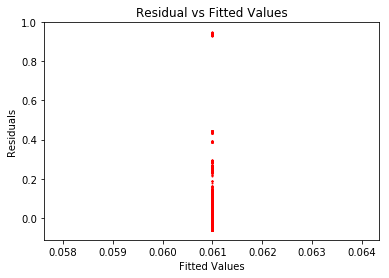

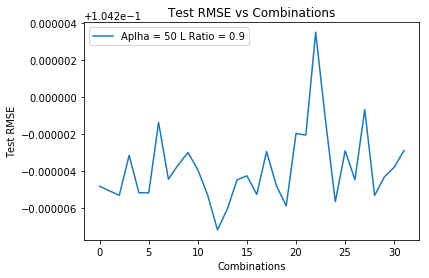

('For alpha: ', 50, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 7, '\tTestRMSE: ', 0.10419088512817475)
('Training MSE for each fold : ', [0.010801088309928026, 0.010944865538947956, 0.01077700282750476, 0.010967871531293104, 0.0110171078328837, 0.011067767612013299, 0.010778113045599785, 0.010592955734256237, 0.01097565615038105, 0.010631933545717101], '\n\n')
('Testing MSE for each fold : ', [0.011345056807127083, 0.010051620674662807, 0.011561753316217059, 0.009844550241578235, 0.009401202468343488, 0.008945297203451299, 0.01155188488552246, 0.013220082061872251, 0.009773846814864841, 0.012869470818979059], '\n\n')
('Training RMSE:', 0.10418942466897733)
('Testing RMSE:', 0.10419441697740747)


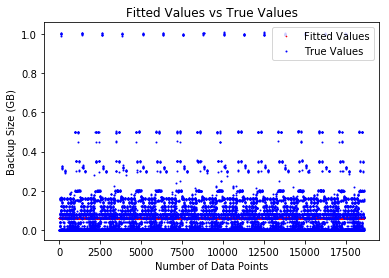

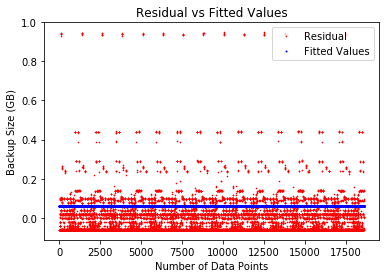

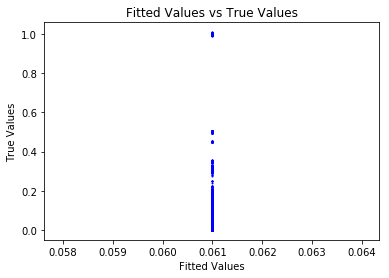

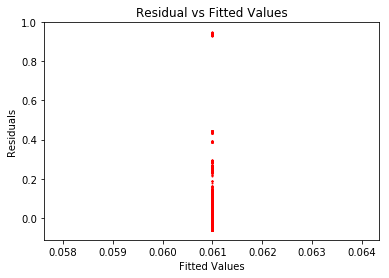

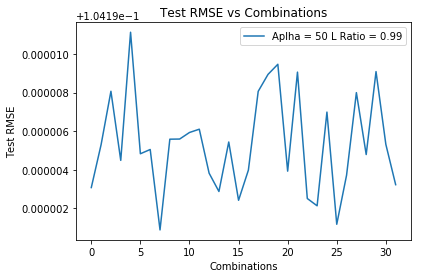

('For alpha: ', 50, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 30, '\tTestRMSE: ', 0.10419188213448657)
('Training MSE for each fold : ', [0.010843641908589953, 0.010870884021896874, 0.010792867375531263, 0.010804722517130149, 0.01086281242686605, 0.010906528784318418, 0.010901975197225165, 0.0109071215029384, 0.01084429339407041, 0.010819584679017497], '\n\n')
('Testing MSE for each fold : ', [0.010962062192041174, 0.010717748421794383, 0.011418998049471227, 0.011312525342889563, 0.010789803835518703, 0.010397054817748795, 0.010437746947283518, 0.010390835603425939, 0.010956410567779835, 0.011179919128244734], '\n\n')
('Training RMSE:', 0.10418945810761479)
('Testing RMSE:', 0.1041936202011418)


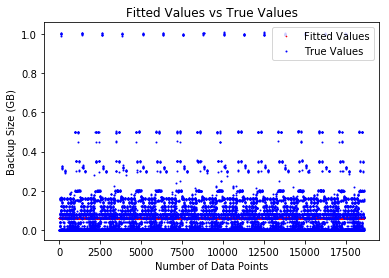

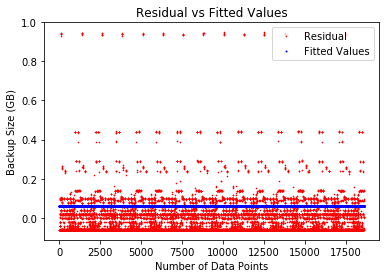

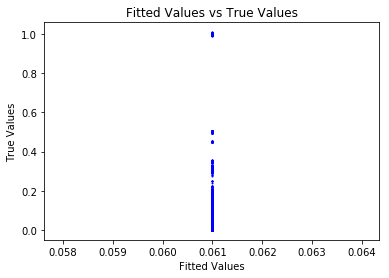

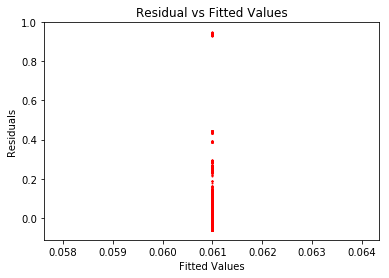

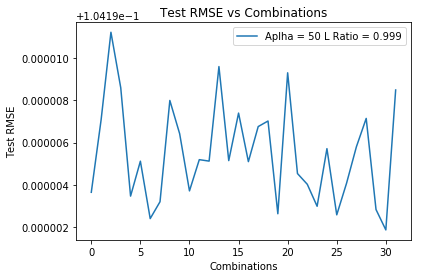

('For alpha: ', 100, '\tFor L Ratio: ', 0.001, '\tBest combination: ', 10, '\tTestRMSE: ', 0.10391010273732072)
('Training MSE for each fold : ', [0.010679699301411895, 0.011023771104908871, 0.010970645931066699, 0.010736232216076298, 0.010786233641457697, 0.010819416377207665, 0.010920492567172634, 0.010593268946562566, 0.010608667999142117, 0.01082320444266791], '\n\n')
('Testing MSE for each fold : ', [0.011828771289589816, 0.008711612142067681, 0.009188322901074214, 0.011347791139595168, 0.010862304764209331, 0.010612957373926401, 0.009697891875131058, 0.012629891953100457, 0.01254657980271239, 0.010548455743253216], '\n\n')
('Training RMSE:', 0.10390458725565217)
('Testing RMSE:', 0.10391081704262543)


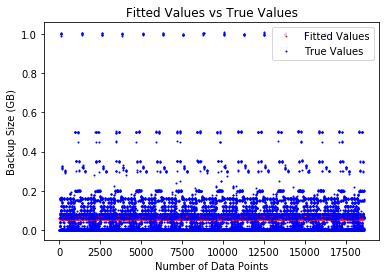

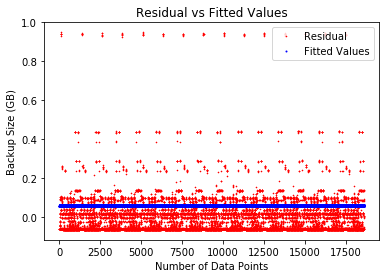

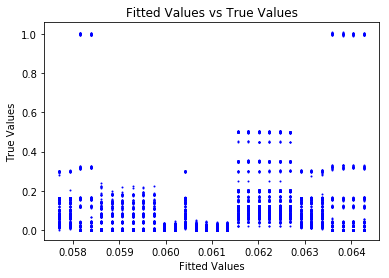

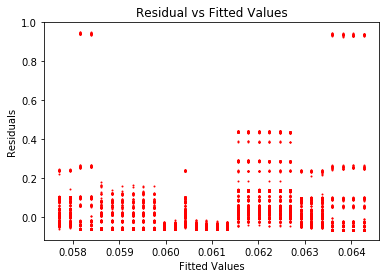

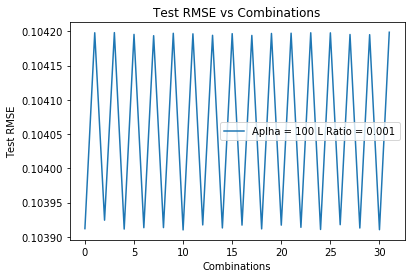

('For alpha: ', 100, '\tFor L Ratio: ', 0.01, '\tBest combination: ', 27, '\tTestRMSE: ', 0.1041913377961106)
('Training MSE for each fold : ', [0.01065733444023267, 0.010543895621723146, 0.011007853453084842, 0.01085691452771996, 0.01110985601199565, 0.011169706997601732, 0.010677484947768387, 0.010613361224505015, 0.010804722590894074, 0.011112894080966383], '\n\n')
('Testing MSE for each fold : ', [0.012640890553418304, 0.013659855303890838, 0.009486699477736204, 0.010842630210355765, 0.008566432532305905, 0.008029448349538096, 0.012457877488359293, 0.013034901791721157, 0.011312762448563768, 0.008537838543432397], '\n\n')
('Training RMSE:', 0.10418926235293724)
('Testing RMSE:', 0.1041966106451269)


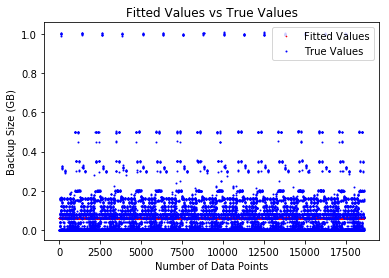

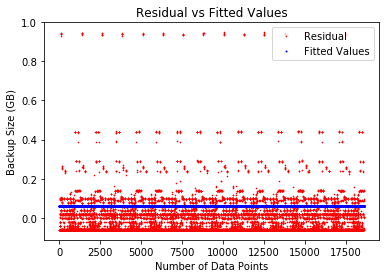

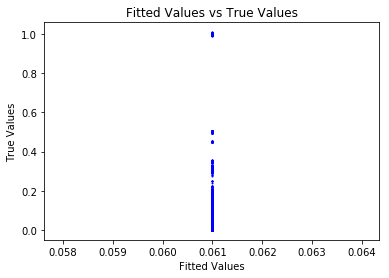

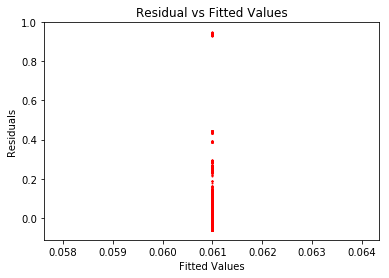

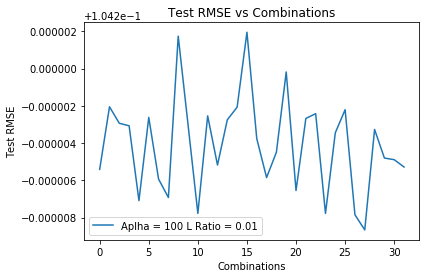

('For alpha: ', 100, '\tFor L Ratio: ', 0.05, '\tBest combination: ', 12, '\tTestRMSE: ', 0.1041908993611499)
('Training MSE for each fold : ', [0.010591556270894443, 0.010770432471018021, 0.010851854064202544, 0.011127183387776761, 0.010777614386432384, 0.010938775260011465, 0.011005721087814732, 0.010718091002882256, 0.010939754057779303, 0.01083356948801446], '\n\n')
('Testing MSE for each fold : ', [0.013230701409681677, 0.01162137993952291, 0.010888183385584388, 0.008410948279784804, 0.01155666691444295, 0.01010599164250089, 0.009503525786166913, 0.012091926054626669, 0.01009800571858272, 0.01105284791721545], '\n\n')
('Training RMSE:', 0.10418951553626994)
('Testing RMSE:', 0.10419221518333764)


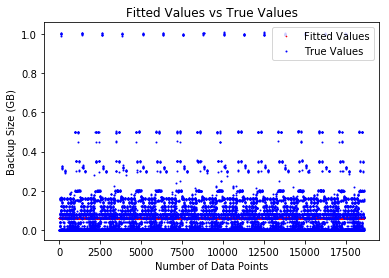

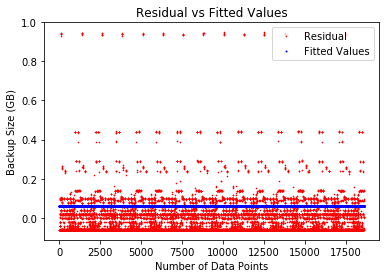

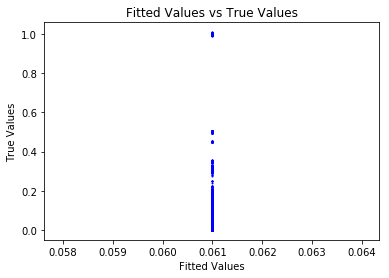

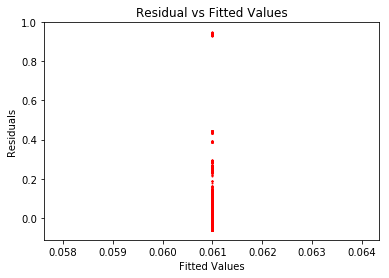

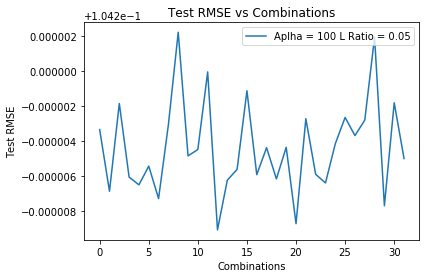

('For alpha: ', 100, '\tFor L Ratio: ', 0.1, '\tBest combination: ', 14, '\tTestRMSE: ', 0.10419073812743393)
('Training MSE for each fold : ', [0.010892804109854192, 0.011077577424992088, 0.0109842036248005, 0.010800194995932273, 0.010873645169215511, 0.010933596573111833, 0.011051329224124065, 0.010728074829704275, 0.010808681827785747, 0.01040374826822825], '\n\n')
('Testing MSE for each fold : ', [0.010521851194975186, 0.008857129354295529, 0.009697197822218917, 0.011353036984221462, 0.010692444386996392, 0.010152569329833331, 0.0090945662261286, 0.012004196392858007, 0.011277182332174587, 0.014926569571802833], '\n\n')
('Training RMSE:', 0.10418918180298219)
('Testing RMSE:', 0.10420016487295249)


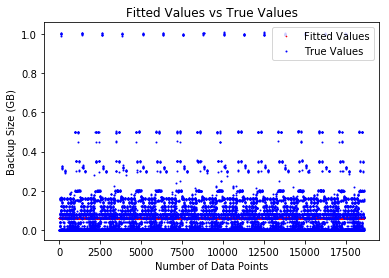

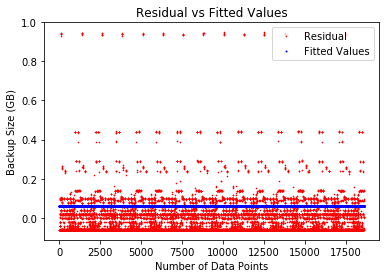

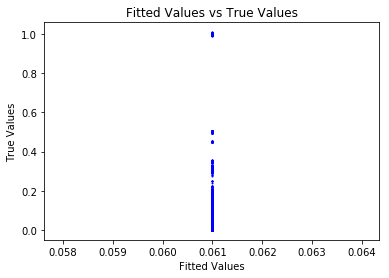

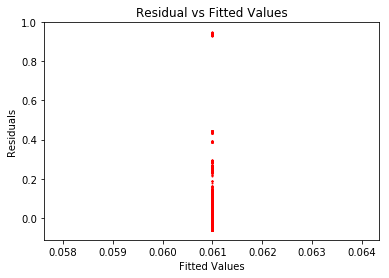

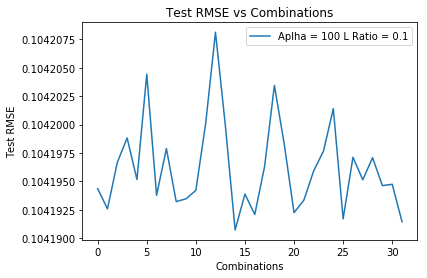

('For alpha: ', 100, '\tFor L Ratio: ', 0.2, '\tBest combination: ', 0, '\tTestRMSE: ', 0.1041903066551212)
('Training MSE for each fold : ', [0.011197399962668362, 0.010782565769591534, 0.010760872815483498, 0.010745503629848852, 0.010834864605148299, 0.010582160640674777, 0.011033637280439636, 0.010782004448892258, 0.01101168721473464, 0.010823513022396765], '\n\n')
('Testing MSE for each fold : ', [0.00777979296142988, 0.01151175299159944, 0.011706939484015315, 0.011845268249351322, 0.011041440091191054, 0.01331863317187288, 0.009252686183326543, 0.011516735405792377, 0.009449667620045675, 0.011143389523112078], '\n\n')
('Training RMSE:', 0.1041893513704153)
('Testing RMSE:', 0.10419515616463972)


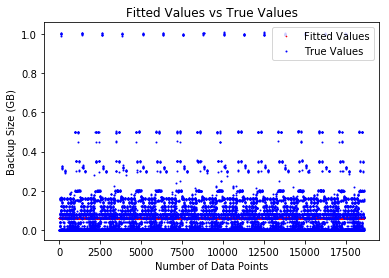

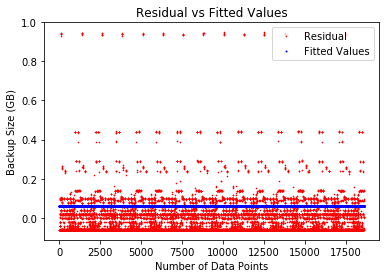

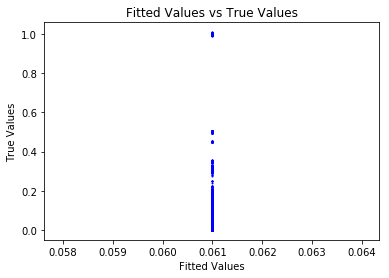

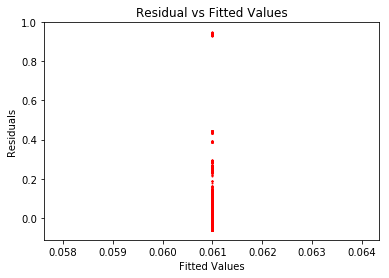

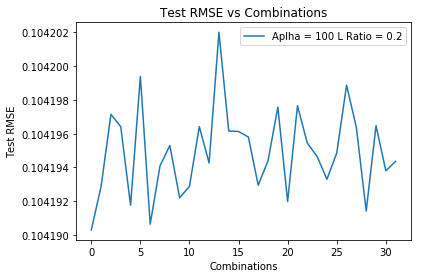

('For alpha: ', 100, '\tFor L Ratio: ', 0.5, '\tBest combination: ', 29, '\tTestRMSE: ', 0.10419198359035596)
('Training MSE for each fold : ', [0.011050742148577911, 0.010765859962910254, 0.010918996872175107, 0.010736523801359739, 0.010695862496160577, 0.010779204693884952, 0.010864091560178724, 0.011000789341017812, 0.010906737966910898, 0.01083553797475075], '\n\n')
('Testing MSE for each fold : ', [0.009099217236742918, 0.011662259854021922, 0.010285798221068598, 0.011926012767264923, 0.012292501336276247, 0.011543178457734908, 0.010778092657665444, 0.009547987889095605, 0.010394070675611872, 0.011035131092313027], '\n\n')
('Training RMSE:', 0.10418941732149514)
('Testing RMSE:', 0.10419416979264985)


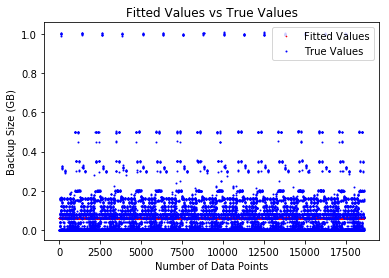

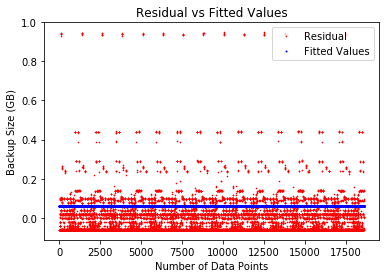

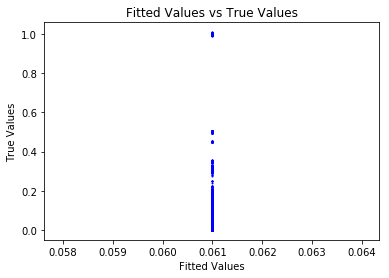

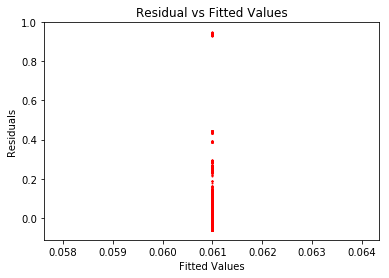

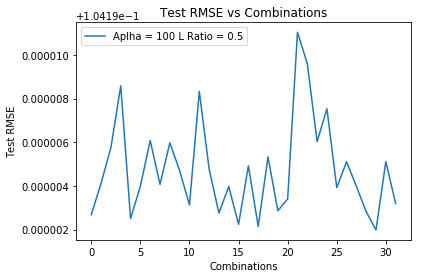

('For alpha: ', 100, '\tFor L Ratio: ', 0.7, '\tBest combination: ', 1, '\tTestRMSE: ', 0.10419124160860385)
('Training MSE for each fold : ', [0.011001259865685535, 0.010971985052585936, 0.010442126278919349, 0.010712496426394843, 0.010909746495253447, 0.010687647651278595, 0.010910904549853969, 0.011010793000119593, 0.011066164348777404, 0.010841256469020032], '\n\n')
('Testing MSE for each fold : ', [0.009543723248704691, 0.009807556357052227, 0.01457679961301292, 0.012142654012409262, 0.010367375066669432, 0.012366618888470328, 0.010356936410043174, 0.009458895150600069, 0.00895846521205676, 0.01098360572289355], '\n\n')
('Training RMSE:', 0.10418943331158331)
('Testing RMSE:', 0.10419339215224371)


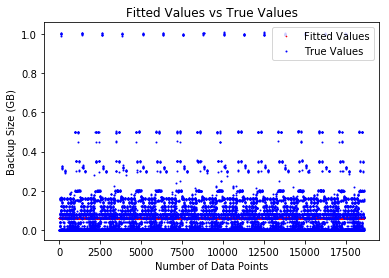

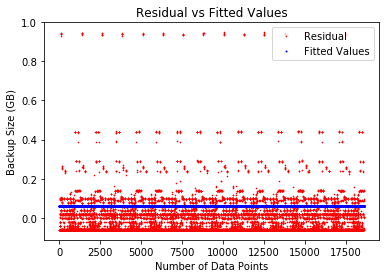

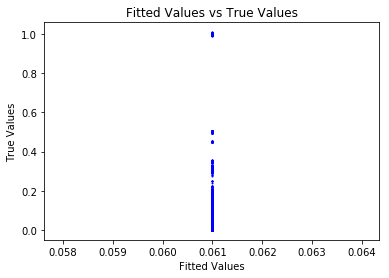

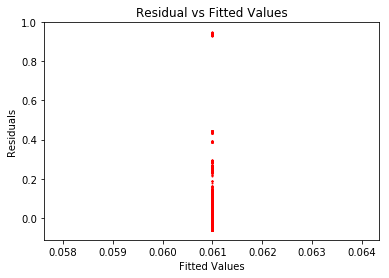

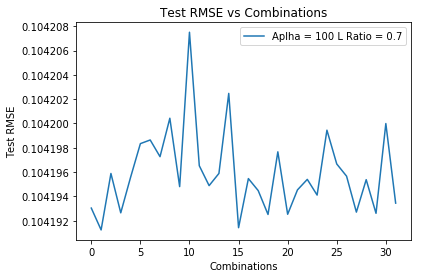

('For alpha: ', 100, '\tFor L Ratio: ', 0.9, '\tBest combination: ', 1, '\tTestRMSE: ', 0.10419103249640768)
('Training MSE for each fold : ', [0.01072401361234766, 0.010991077472974986, 0.010753968547227963, 0.01097758673357324, 0.01081045509090023, 0.01064712369966133, 0.010708833887580836, 0.010979519308745835, 0.010746743177115976, 0.011214746700242204], '\n\n')
('Testing MSE for each fold : ', [0.012040033934012635, 0.00963533444059423, 0.011769065396713293, 0.009757046750161598, 0.011260707160118686, 0.012732434908382896, 0.012175203972637232, 0.009741117866702174, 0.011834695955836885, 0.007622592566676453], '\n\n')
('Training RMSE:', 0.10418928362858161)
('Testing RMSE:', 0.10419608099724101)


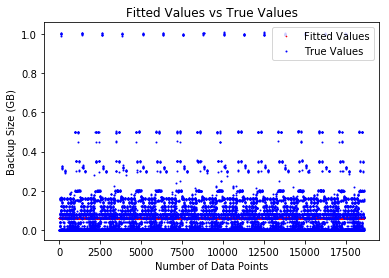

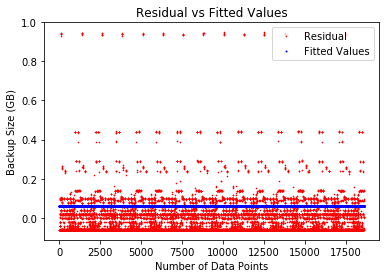

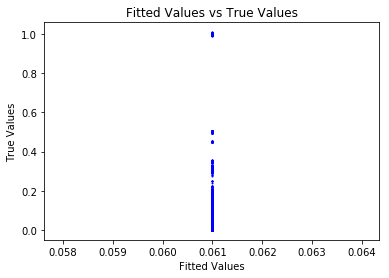

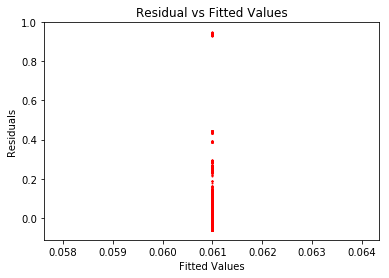

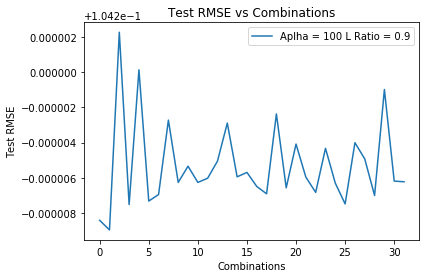

('For alpha: ', 100, '\tFor L Ratio: ', 0.99, '\tBest combination: ', 5, '\tTestRMSE: ', 0.10419123189838825)
('Training MSE for each fold : ', [0.010920822083918138, 0.010748633379729245, 0.01082216772827491, 0.010659809933499262, 0.010995470225195654, 0.011019598776011155, 0.010714519528366035, 0.010801257079805306, 0.010932501827090373, 0.010939758567640888], '\n\n')
('Testing MSE for each fold : ', [0.01026766639988193, 0.011817613910007055, 0.011155418366035617, 0.01261700275709425, 0.009597005470742928, 0.009378786373780893, 0.012124069297451079, 0.01134357365711738, 0.010162003506815552, 0.010096679685083374], '\n\n')
('Training RMSE:', 0.10418950961086772)
('Testing RMSE:', 0.10419204356572054)


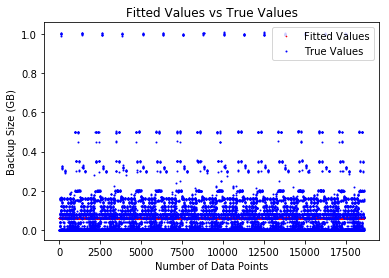

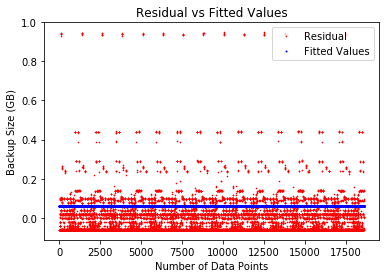

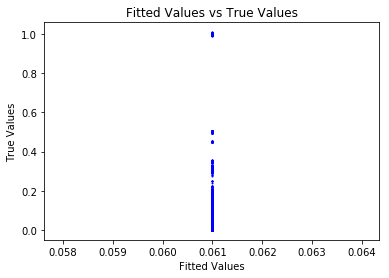

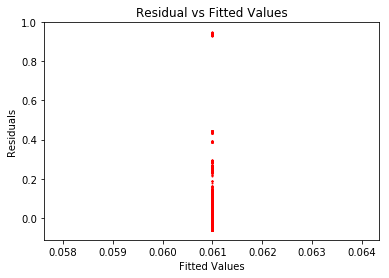

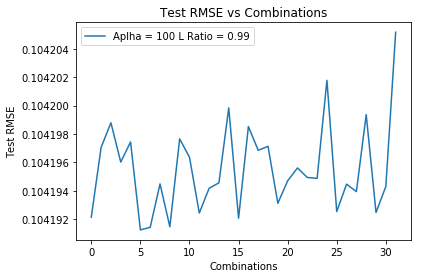

('For alpha: ', 100, '\tFor L Ratio: ', 0.999, '\tBest combination: ', 14, '\tTestRMSE: ', 0.10419258290404354)
('Training MSE for each fold : ', [0.010816149666578538, 0.011111291479488914, 0.010805579541892998, 0.010844021524868344, 0.010435335576128604, 0.010856728598851074, 0.01084508405350473, 0.011088624526979703, 0.010948112778962705, 0.01080307930433359], '\n\n')
('Testing MSE for each fold : ', [0.011209746056874704, 0.008555160428528802, 0.011304626472858556, 0.010958852752786522, 0.014639356220598735, 0.010844531349337999, 0.010949928103373002, 0.008758414583094625, 0.010021577618564606, 0.011328458653942297], '\n\n')
('Training RMSE:', 0.1041892542691372)
('Testing RMSE:', 0.10419724192125233)


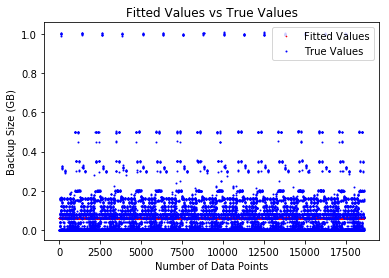

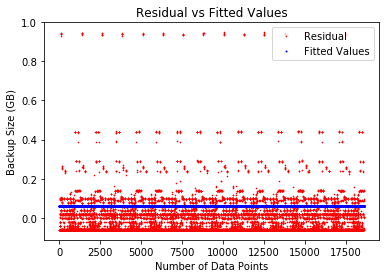

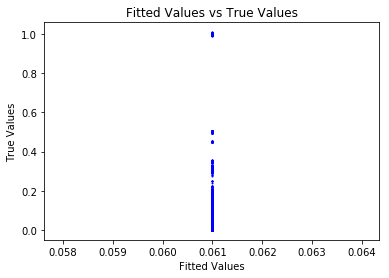

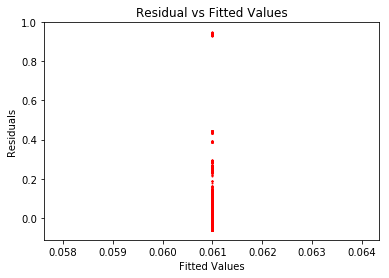

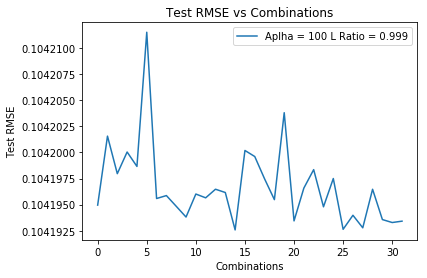

In [16]:
elasticNetDF = df.copy(deep=True)
del elasticNetDF['Backup Time (hour)']
elasticNetMatrix = elasticNetDF.as_matrix()

elasticNetX = elasticNetMatrix[:, 0 : elasticNetMatrix.shape[1] - 1]
elasticNety = elasticNetMatrix[:, elasticNetMatrix.shape[1] - 1].astype('float')

#label encode the entire dataset
elasticNetX = labelEncoder(elasticNetX)

alphas = [0.001, 0.01, 0.1, 0.2, 0.5, 1, 2, 5, 10, 50, 100]
lRatios = [0.001, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 0.99, 0.999]

for alpha in alphas:
    for lRatio in lRatios:
        
        combo_train_rmse = list()
        combo_test_rmse = list()
        best_combination = -1
        best_rmse = float(sys.maxsize)
        bestX = None
        
        for i in range(0, 32):
            binary = bin(i)[2:].zfill(5)

            newX = np.zeros((elasticNetX.shape[0], 1))
            field = 0
            for j in binary:
                if j == '0':
                    #perform label encoding
                    newX = np.concatenate((newX, np.expand_dims(elasticNetX[:, field], axis=1)), axis=1)
                if j == '1':
                    #perform one hot encoding
                    newCol = elasticNetX[:, field]
                    ohe = OneHotEncoder(sparse=False)
                    transformedCol = ohe.fit_transform(newCol.reshape(-1, 1))
                    newX = np.concatenate((newX, transformedCol), axis=1)

                field += 1


            X_final = newX[:,1:]

            kfTrainRMSE, kfTestRMSE, kfPred = regression(X_final, elasticNety, modelName='ElasticNet', plot=False, arg=[alpha, lRatio], verbose=False)

            if kfTestRMSE < best_rmse:
                best_rmse = kfTestRMSE
                best_combination = i
                bestX = X_final

            combo_train_rmse.append(kfTrainRMSE)
            combo_test_rmse.append(kfTestRMSE)

        print("For alpha: ", alpha, "\tFor L Ratio: ", lRatio, "\tBest combination: ", best_combination, "\tTestRMSE: ", best_rmse)
        trainRMSE, testRMSE, pred = regression(bestX, elasticNety, modelName='ElasticNet', plot=True, arg=[alpha, lRatio], verbose=True)
        label = 'Aplha = ' + str(alpha) + " L Ratio = " + str(lRatio)
        plt.plot(comboList, combo_test_rmse, label=label)    
        plt.xlabel('Combinations')
        plt.ylabel('Test RMSE')
        plt.title('Test RMSE vs Combinations')
        plt.legend()
        plt.show()

In [121]:
#Coefficients for the best Elastic Net Model

ElasticNet_model = ElasticNet(alpha= 0.001 , l1_ratio = 0.01)
ElasticNet_model.fit(X_final, elasticNety)
ElasticNet_model.coef_

array([-6.12966212e-04, -0.00000000e+00,  2.15189235e-04, -1.80065161e-04,
        1.94737612e-04, -4.54012864e-05,  0.00000000e+00,  6.81518799e-04,
        0.00000000e+00,  0.00000000e+00, -3.96005464e-04,  5.81585405e-04,
       -1.66324078e-05,  0.00000000e+00, -1.55352592e-04, -4.13800278e-03,
        4.04292942e-02,  4.64458066e-03,  2.87608419e-03, -3.68651976e-03,
       -1.12363272e-02, -1.86037890e-02, -2.00687017e-02, -2.09069711e-02,
        7.64812519e-03,  3.31624137e-02, -1.96191995e-03,  1.90096582e-03,
        3.99985586e-02, -1.15288180e-02, -3.65344637e-02, -5.36604278e-02,
        7.14724336e-02, -0.00000000e+00,  8.43653166e-04, -8.97633787e-05,
       -0.00000000e+00, -1.65507960e-03, -1.25271000e-03, -7.92056059e-04,
       -1.82842996e-03,  3.77417704e-05, -6.75693656e-04, -6.80038742e-04,
       -3.62232852e-04,  5.24344769e-04, -3.05027961e-04, -6.54451543e-04,
       -7.01673926e-04, -4.40164389e-04,  3.23690275e-03,  3.78432433e-03,
        3.96844927e-03,  

## Random Forest

In [7]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from math import sqrt
from sklearn.metrics import mean_squared_error
import sys

def rfRegression(X, y, modelName, arg=None, verbose=True, plot=True):
    
    
    kf = KFold(n_splits=10, shuffle=True)
    
    trainMSE = list()
    testMSE = list()
    oob = list()
    bestTestMSE = float(sys.maxsize)
    bestModel = None
    
    for train_index, test_index in kf.split(X):
        model = getModel(modelName, arg)
            
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

        model.fit(X_train, y_train)
        predictionTest = model.predict(X_test)
        predictionTrain = model.predict(X_train)

        train_mse = mean_squared_error(y_train, predictionTrain)
        test_mse = mean_squared_error(y_test, predictionTest)
        
        if test_mse < bestTestMSE:
            bestTestMSE = test_mse
            bestModel = model
            
        trainMSE.append(train_mse)
        testMSE.append(test_mse)
        oob.append(1 - model.oob_score_)

    if verbose:
        print("Training MSE for each fold : ", trainMSE, "\n\n")
        print("Testing MSE for each fold : ", testMSE, "\n\n")
        print("OOB Error for each fold : ", oob, "\n\n")

    bestModel = getModel(modelName, arg)
    bestModel.fit(X, y)    
    prediction = bestModel.predict(X)
    
    if plot:
        plt.plot(prediction, 'rx', markersize=1, label="Fitted Values" )
        plt.plot(y, 'bo', markersize=1, label = "True Values")
        plt.xlabel('Number of Data Points')
        plt.ylabel("Backup Size (GB)")
        plt.legend()
        plt.title('Fitted Values vs True Values')
        plt.show()

        residual = y - prediction
        plt.plot(residual,'rx', markersize=1, label="Residual")
        plt.plot(prediction,'bo', markersize=1, label="Fitted Values")
        plt.title('Residual vs Fitted Values')
        plt.xlabel('Number of Data Points')
        plt.ylabel("Backup Size (GB)")
        plt.legend()
        plt.show()
    
        plt.plot(prediction, y, 'bo', markersize=1)
        plt.title('Fitted Values vs True Values')
        plt.xlabel('Fitted Values')
        plt.ylabel('True Values')
        plt.show()
    
        plt.plot(prediction, residual, 'ro', markersize=1)
        plt.title('Residual vs Fitted Values')
        plt.xlabel('Fitted Values')
        plt.ylabel('Residuals')
        plt.show()
    
    return trainMSE, testMSE, oob

## 2(b)(i)

c:\users\anoos\appdata\local\programs\python\python36\lib\site-packages\sklearn\ensemble\forest.py:724: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
c:\users\anoos\appdata\local\programs\python\python36\lib\site-packages\sklearn\ensemble\forest.py:724: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
c:\users\anoos\appdata\local\programs\python\python36\lib\site-packages\sklearn\ensemble\forest.py:724: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
c:\users\anoos\appdata\local\programs\python\python36\lib\site-packages\sklearn\ensemble\forest.py:724: UserWarning: Some inputs do not have OOB scores. T

Training MSE for each fold :  [0.00574380131364215, 0.005848790668475817, 0.005862637502811115, 0.005838344626637879, 0.005991398288767987, 0.005558379516184416, 0.005710813985630186, 0.005822633038413584, 0.005872698693073967, 0.0055750744697369995] 


Testing MSE for each fold :  [0.006574342118588233, 0.004794721569250043, 0.004611596816448797, 0.004853359298045155, 0.0034803892255370083, 0.008267540821364036, 0.006883973490760807, 0.004969388286256958, 0.0054362245753947795, 0.008131681925692122] 


OOB Error for each fold :  [0.5354193412919699, 0.5359357747071894, 0.5351281616832769, 0.5346461212504066, 0.5419911638276029, 0.5278627528457901, 0.5347418225913863, 0.5355582758399026, 0.5383414572863597, 0.5275283106344172] 




c:\users\anoos\appdata\local\programs\python\python36\lib\site-packages\sklearn\ensemble\forest.py:724: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


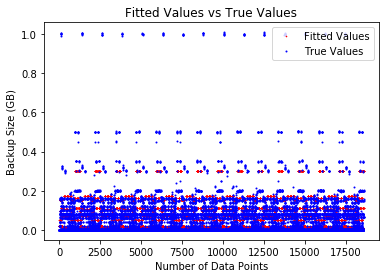

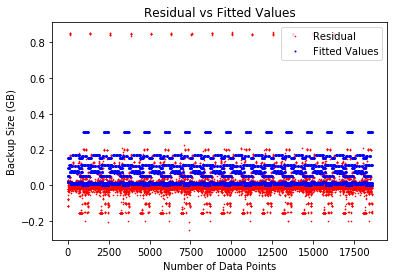

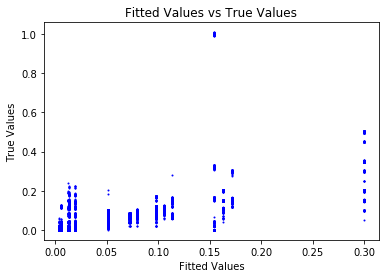

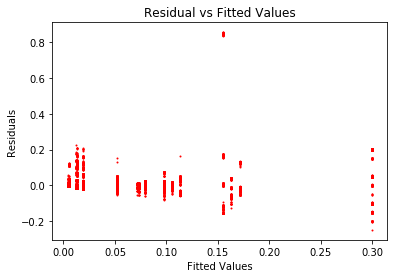

Train RMSE:  0.07604246978062594
Test RMSE:  0.07615984383343886
OOB Error:  0.5347153181958302


In [11]:
rfDataFrame = df.copy(deep=True)
del rfDataFrame['Backup Time (hour)']
rfDataMatrix = rfDataFrame.as_matrix()


rfX = rfDataMatrix[:, 0 : rfDataMatrix.shape[1] - 1]
rfy = rfDataMatrix[:, rfDataMatrix.shape[1] - 1]
rfX = labelEncoder(rfX)

#num_estimators = 20
#max_depth = 4
#max_features = 5
args = [20, 4, 5]

rfTrainMSE, rfTestMSE, rfOOB = rfRegression(rfX, rfy, modelName='RandomForestRegressor', arg=args)

rfTrainRMSE = sqrt(sum(rfTrainMSE) / len(rfTrainMSE))
rfTestRMSE = sqrt(sum(rfTestMSE) / len(rfTestMSE))

print("Train RMSE: ", rfTrainRMSE)
print("Test RMSE: ", rfTestRMSE)
print("OOB Error: ", (sum(rfOOB) / len(rfOOB)))

## 2(b)(ii)

In [20]:
from sklearn import tree
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold
from math import sqrt
from sklearn.metrics import mean_squared_error
import sys

def rfRegression2(X, y, modelName, arg=None, verbose=True, plot=True):
    
    
    kf = KFold(n_splits=10, shuffle=True)
    
    trainMSE = list()
    testMSE = list()
    oob = list()
    bestTestMSE = float(sys.maxsize)
    bestModel = None
    
    for train_index, test_index in kf.split(X):
        model = getModel(modelName, arg)
            
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

        model.fit(X_train, y_train)
        predictionTest = model.predict(X_test)
        predictionTrain = model.predict(X_train)

        train_mse = mean_squared_error(y_train, predictionTrain)
        test_mse = mean_squared_error(y_test, predictionTest)
        
        if test_mse < bestTestMSE:
            bestTestMSE = test_mse
            bestModel = model
            
        trainMSE.append(train_mse)
        testMSE.append(test_mse)
        oob.append(1 - model.oob_score_)
    
    return trainMSE, testMSE, oob, bestModel

/anaconda/lib/python2.7/site-packages/sklearn/ensemble/forest.py:723: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "


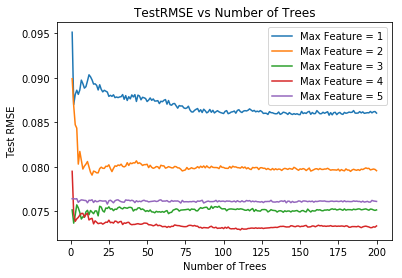

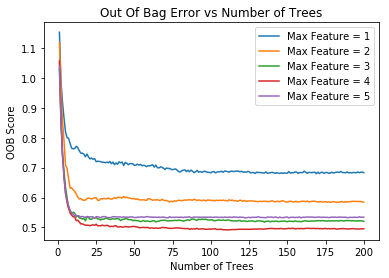



Best Model
('Number of Trees = ', 111)
('Max Features = ', 4)
('Test RMSE = ', 0.07291689560179437)
('Training MSE for each fold : ', [0.005211181368696517, 0.005394105285824559, 0.005291550205515141, 0.005344910704289004, 0.0051139846520242465, 0.005345575773931238, 0.0053537496600958795, 0.005231994292537492, 0.005366016166999447, 0.005397477948718851], '\n\n')
('Testing MSE for each fold : ', [0.0062998951635587115, 0.0046535121890736745, 0.005236660713190756, 0.00462757312617608, 0.007667235055847896, 0.004931663239788419, 0.004172989918612847, 0.0061384137410966915, 0.004845505093307934, 0.004647774792727166], '\n\n')
('OOB Error for each fold : ', [0.4887327706623972, 0.49705053321462844, 0.492916207998219, 0.4910551659027076, 0.4883652911809515, 0.49245043254881016, 0.48837461654163294, 0.48807623666601474, 0.49422585182092416, 0.4960901428529967], '\n\n')


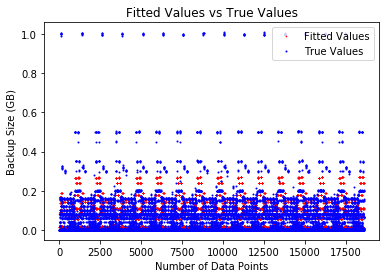

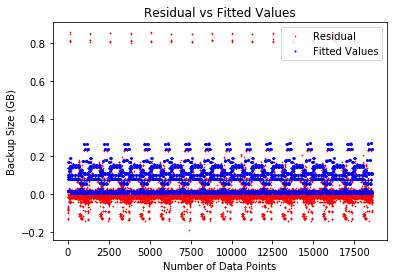

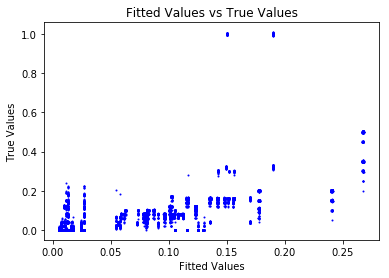

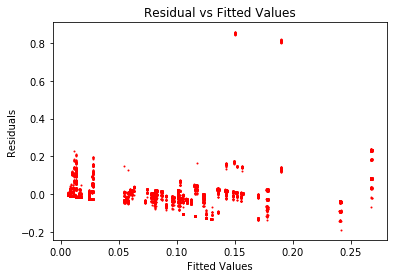

In [21]:
from collections import defaultdict
rfDataFrame = df.copy(deep=True)
del rfDataFrame['Backup Time (hour)']
rfDataMatrix = rfDataFrame.as_matrix()


rfX = rfDataMatrix[:, 0 : rfDataMatrix.shape[1] - 1]
rfy = rfDataMatrix[:, rfDataMatrix.shape[1] - 1]
rfX = labelEncoder(rfX)
featureTestRMSE = defaultdict(list)
featureOOB = defaultdict(list)

trees = list(range(1, 201))

bestArgs = None
bestTestRMSE = float(sys.maxsize)

for num_trees in trees:
    avg_oob_errors_tree = list()
    avg_test_rmse_tree = list()
    
    for max_feature in range(1,6):

        args = [num_trees, 4, max_feature]

        rfTrainMSE, rfTestMSE, rfOOB = rfRegression(rfX, rfy, modelName='RandomForestRegressor', arg=args, plot=False, verbose=False)

        rfTrainRMSE = sqrt(sum(rfTrainMSE) / len(rfTrainMSE))
        rfTestRMSE = sqrt(sum(rfTestMSE) / len(rfTestMSE))

        avg_oob_error = sum(rfOOB)/len(rfOOB)
        
        featureTestRMSE[max_feature].append(rfTestRMSE)
        featureOOB[max_feature].append(avg_oob_error)
        
        if rfTestRMSE < bestTestRMSE:
            bestArgs = args
            bestTestRMSE = rfTestRMSE

for maxFeature in featureTestRMSE:
    label = "Max Feature = " + str(maxFeature)
    plt.plot(trees, featureTestRMSE[maxFeature], label=label)
    
plt.title('TestRMSE vs Number of Trees')
plt.xlabel('Number of Trees')
plt.ylabel('Test RMSE')
plt.legend()
plt.show()

for maxFeature in featureOOB:
    label = "Max Feature = " + str(maxFeature)
    plt.plot(trees, featureOOB[maxFeature], label=label)
    
plt.title('Out Of Bag Error vs Number of Trees')
plt.xlabel('Number of Trees')
plt.ylabel('OOB Score')
plt.legend()
plt.show()


print("\n\nBest Model")
print("Number of Trees = ", bestArgs[0])
print("Max Features = ", bestArgs[2])
print("Test RMSE = ", bestTestRMSE)

rfRegression(rfX, rfy, modelName='RandomForestRegressor', arg=bestArgs)

_, _, _, bestrfModel = rfRegression2(rfX, rfy, modelName='RandomForestRegressor', arg=bestArgs, plot=False, verbose=False)

rfb = bestrfModel.estimators_[0].fit(rfX, rfy)

tree.export_graphviz(rfb, out_file='tree.dot') 

## 2(b)(iii)

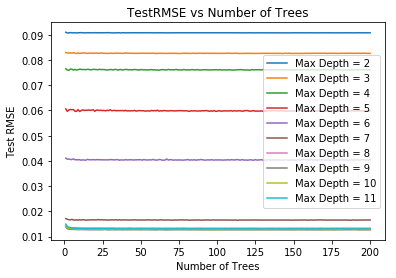

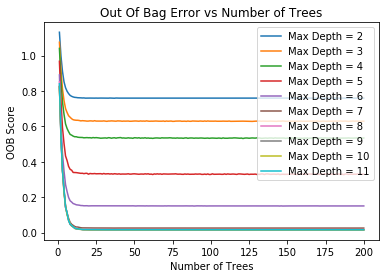



Best Model
('Number of Trees = ', 60)
('Max Depth = ', 9)
('Test RMSE = ', 0.012628837803137626)
('Training MSE for each fold : ', [0.00013309644811066365, 0.00013687589832608537, 0.00013780151448544159, 0.00013134666124860642, 0.000135048198798056, 0.0001344702697922313, 0.00013664730107993433, 0.0001370189461541609, 0.0001365932643948435, 0.00013284510449594782], '\n\n')
('Testing MSE for each fold : ', [0.0001760747229607829, 0.00014379503383439357, 0.00014098044456247136, 0.00019478558381712672, 0.00016211751194778284, 0.00017459411692925765, 0.0001470584666630196, 0.00014839602194252692, 0.0001434615627353885, 0.00017969372723757512], '\n\n')
('OOB Error for each fold : ', [0.014787805109091057, 0.015174002445186519, 0.015058461137121948, 0.014833807344613148, 0.014942182582489805, 0.014593290882987664, 0.014909649127651248, 0.014973797862512073, 0.015078684515489327, 0.014615954882824744], '\n\n')


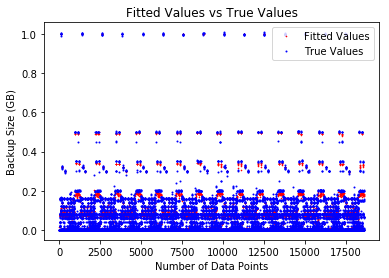

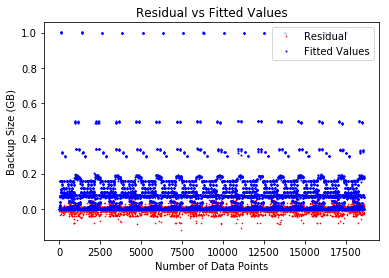

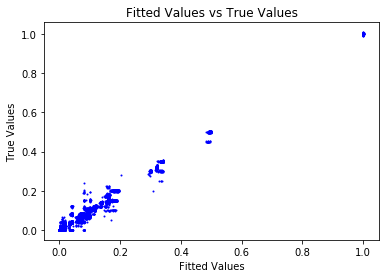

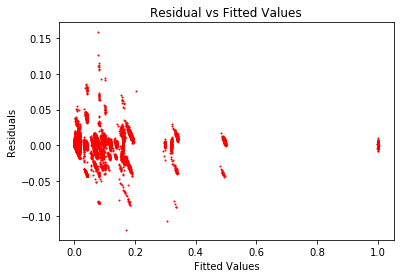

([0.00013309644811066365,
  0.00013687589832608537,
  0.00013780151448544159,
  0.00013134666124860642,
  0.000135048198798056,
  0.0001344702697922313,
  0.00013664730107993433,
  0.0001370189461541609,
  0.0001365932643948435,
  0.00013284510449594782],
 [0.0001760747229607829,
  0.00014379503383439357,
  0.00014098044456247136,
  0.00019478558381712672,
  0.00016211751194778284,
  0.00017459411692925765,
  0.0001470584666630196,
  0.00014839602194252692,
  0.0001434615627353885,
  0.00017969372723757512],
 [0.014787805109091057,
  0.015174002445186519,
  0.015058461137121948,
  0.014833807344613148,
  0.014942182582489805,
  0.014593290882987664,
  0.014909649127651248,
  0.014973797862512073,
  0.015078684515489327,
  0.014615954882824744])

In [28]:
from collections import defaultdict
rfDataFrame = df.copy(deep=True)
del rfDataFrame['Backup Time (hour)']
rfDataMatrix = rfDataFrame.as_matrix()

rfX = rfDataMatrix[:, 0 : rfDataMatrix.shape[1] - 1]
rfy = rfDataMatrix[:, rfDataMatrix.shape[1] - 1]
rfX = labelEncoder(rfX)

depthTestRMSE = defaultdict(list)
depthOOB = defaultdict(list)

trees = list(range(1, 201))
bestArgs = None
bestTestRMSE = float(sys.maxsize)


for num_trees in trees:
    avg_oob_errors_tree = list()
    avg_test_rmse_tree = list()
    
    for max_depth in range(2,12):

        args = [num_trees, max_depth, 5]

        rfTrainMSE, rfTestMSE, rfOOB = rfRegression(rfX, rfy, modelName='RandomForestRegressor', arg=args, plot=False, verbose=False)

        rfTrainRMSE = sqrt(sum(rfTrainMSE) / len(rfTrainMSE))
        rfTestRMSE = sqrt(sum(rfTestMSE) / len(rfTestMSE))

        avg_oob_error = sum(rfOOB)/len(rfOOB)

        depthTestRMSE[max_depth].append(rfTestRMSE)
        depthOOB[max_depth].append(avg_oob_error)
        
        if rfTestRMSE < bestTestRMSE:
            bestArgs = args
            bestTestRMSE = rfTestRMSE

for maxDepth in depthTestRMSE:
    label = "Max Depth = " + str(maxDepth)
    plt.plot(trees, depthTestRMSE[maxDepth], label=label)
    
plt.title('TestRMSE vs Number of Trees')
plt.xlabel('Number of Trees')
plt.ylabel('Test RMSE')
plt.legend()
plt.show()

for maxDepth in depthOOB:
    label = "Max Depth = " + str(maxDepth)
    plt.plot(trees, depthOOB[maxDepth], label=label)
    
plt.title('Out Of Bag Error vs Number of Trees')
plt.xlabel('Number of Trees')
plt.ylabel('OOB Score')
plt.legend()
plt.show()


print("\n\nBest Model")
print("Number of Trees = ", bestArgs[0])
print("Max Depth = ", bestArgs[1])
print("Test RMSE = ", bestTestRMSE)
rfRegression(rfX, rfy, modelName='RandomForestRegressor', arg=bestArgs)

## 2(b)iv

In [72]:
# The best features from the previous part are used here to report the feature importances from our data.
# Best model we got from the previous part is,
# n_estimators = 60, max_depth = 9, max_features = 5 

model = RandomForestRegressor(n_estimators=60, max_depth=9, max_features=5, oob_score=True, random_state=0)
model.fit(rfX, rfy)
model.feature_importances_

array([0.00144996, 0.32155655, 0.39641834, 0.27336781, 0.00720733])

## 2(b)v

[7.58731376e-05 3.44087885e-01 9.01154596e-02 4.78777945e-01
 8.69428369e-02]


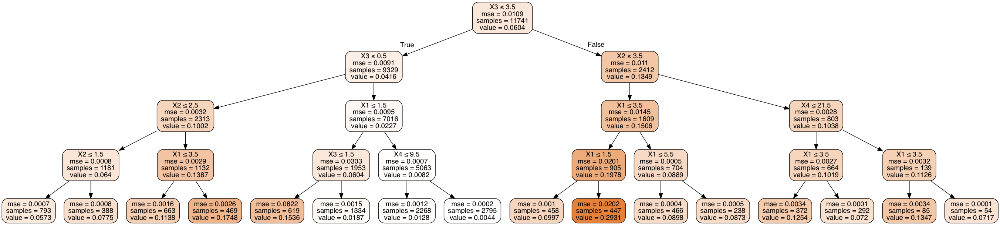

In [74]:
# For visualiztion we have to give the max_depth as 4. So, for this depth, the best combination is as per Part 2(b)ii,
# # n_estimators = 111, max_depth = 4, max_features = 4 

dot_data = StringIO()

model = RandomForestRegressor(n_estimators=111, max_depth=4, max_features=4, oob_score=True, random_state=0)
model.fit(rfX, rfy)
    
export_graphviz(model.estimators_[0], out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())

print (model.feature_importances_)

Image(graph.create_png())

## Neural Network

## 2(c)

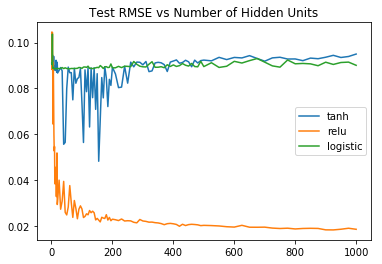

('\n\nBest Combination: ', ('relu', 925))
('Training MSE for each fold : ', [0.00017540939240373186, 0.00016080143184088135, 0.0001758048095390168, 0.0001685100980207263, 0.0002153564824175529, 0.00016980807624941322, 0.00017428669366702617, 0.0001511747414093922, 0.0002267531050645658, 0.0001498990948755366], '\n\n')
('Testing MSE for each fold : ', [0.0003451165173456554, 0.0003337461442213832, 0.0003652856271606912, 0.0003053720705822618, 0.000367114405702143, 0.0003756755707752657, 0.00030533245708604003, 0.00028879830583906723, 0.000367945345863736, 0.0003237012451541483], '\n\n')
('Training RMSE:', 0.013295878780614102)
('Testing RMSE:', 0.018379574776719924)


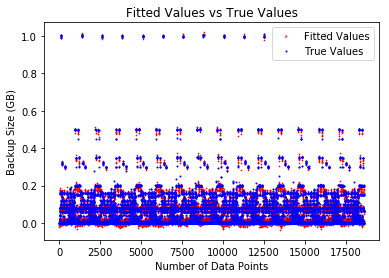

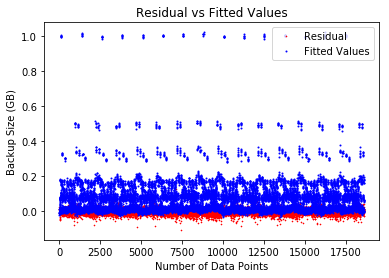

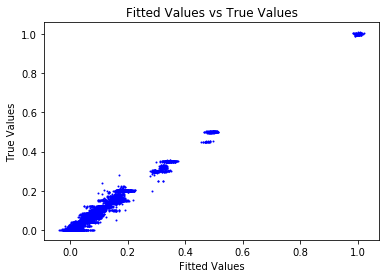

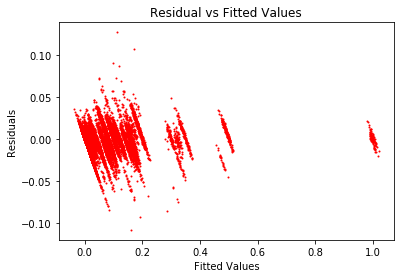

(0.013295878780614102,
 0.018379574776719924,
 array([ 0.009448  , -0.02154248, -0.00888207, ...,  0.17439076,
         0.19423299,  0.16237636]))

In [30]:
from collections import defaultdict
nn_df = df.copy(deep=True)
del nn_df['Backup Time (hour)']

nn_data = nn_df.as_matrix()
nn_X = nn_data[:, 0 : nn_data.shape[1] - 1]
nn_y = nn_data[:, nn_data.shape[1] - 1]

#label encode the entire dataset
nn_X = labelEncoder(nn_X)

ohe = OneHotEncoder(sparse=False)

nn_X = ohe.fit_transform(nn_X)

best_combination = -1
best_rmse = float(sys.maxsize)

activations = ['tanh', 'relu', 'logistic']

combo_train_rmse = defaultdict(list)
combo_test_rmse = defaultdict(list)

nhu = list(range(1, 20)) + list(range(20, 200, 5)) + list(range(200,500, 10)) + list(range(500, 1025, 25))

for act in activations:
    for num_hidden_units in nhu:
        
        args = [act, num_hidden_units]
        nnTrainRMSE, nnTestRMSE, nnPredictions = regression(nn_X, nn_y, modelName='MLPRegressor', arg=args, plot=False, verbose=False)
            
        if nnTestRMSE < best_rmse:
            best_rmse = nnTestRMSE
            best_combination = (act, num_hidden_units)
            
        combo_test_rmse[act].append(nnTestRMSE)


plt.plot(nhu, combo_test_rmse['tanh'], label='tanh')
plt.plot(nhu, combo_test_rmse['relu'], label='relu')
plt.plot(nhu, combo_test_rmse['logistic'], label='logistic')
plt.legend()
plt.title('Test RMSE vs Number of Hidden Units')
plt.show()
print("\n\nBest Combination: ", best_combination)
bestArg = [best_combination[0], best_combination[1]]
regression(nn_X, nn_y, modelName='MLPRegressor', arg=bestArg)

## 2(d)(i)

('\n\nWorkflow: ', 'work_flow_0')
('Training MSE for each fold : ', [0.0018605178914278282, 0.0018400599073349613, 0.0018425930639440927, 0.0018624065553091175, 0.0018580407053937133, 0.001858425077122738, 0.0018726066978895048, 0.0018423848024213382, 0.0018175363874000745, 0.0018235696594069639], '\n\n')
('Testing MSE for each fold : ', [0.0017394137024319917, 0.0019231814237174497, 0.001898300986505991, 0.0017211144843651573, 0.0017647186903408333, 0.0017574015021376683, 0.001632524304185584, 0.0019003086410470937, 0.0021276144472721385, 0.0020711117810648092], '\n\n')
('Training RMSE:', 0.04298620795982164)
('Testing RMSE:', 0.04305309508394108)


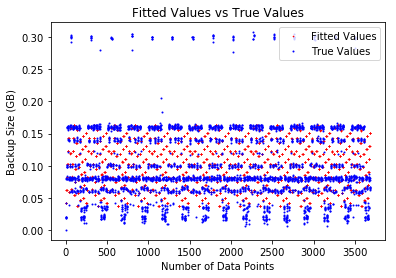

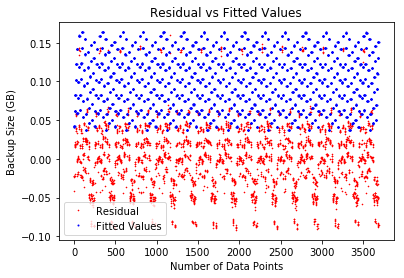

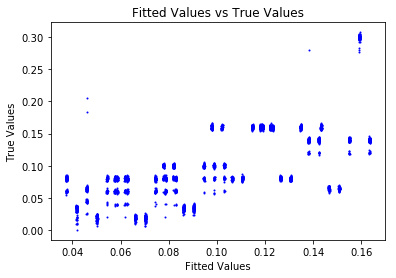

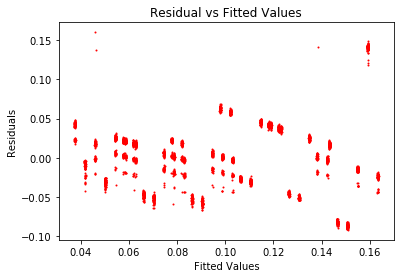

('\n\nWorkflow: ', 'work_flow_2')
('Training MSE for each fold : ', [0.0018158629498025755, 0.0017732012896868395, 0.0018154978412239899, 0.0017993444712690323, 0.0017816908008103328, 0.0018199346388040217, 0.001778489161168981, 0.0017634391907141794, 0.0017194752359314428, 0.0017756208071545], '\n\n')
('Testing MSE for each fold : ', [0.0015072342240755822, 0.0018910748743721352, 0.0015074822174640594, 0.0016537149255490577, 0.001814308558763104, 0.0014683499999139826, 0.001841027666757625, 0.0019792077889532436, 0.0023729382606520687, 0.0018656183359298817], '\n\n')
('Training RMSE:', 0.042240450265788945)
('Testing RMSE:', 0.04230952239440991)


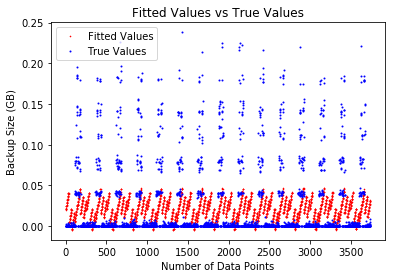

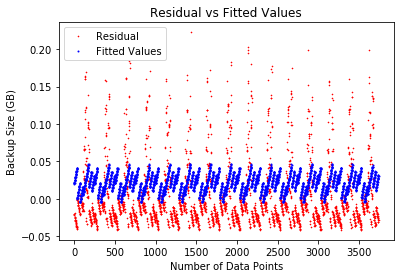

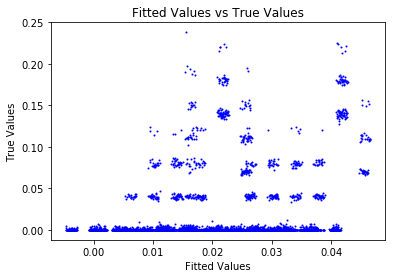

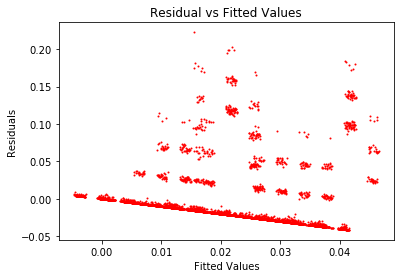

('\n\nWorkflow: ', 'work_flow_3')
('Training MSE for each fold : ', [5.0765231798755794e-05, 5.131622231727836e-05, 5.189937264941536e-05, 4.916708258369479e-05, 5.0387865922302955e-05, 5.051700128142482e-05, 5.217426627796942e-05, 4.946016195953574e-05, 5.082631760344692e-05, 5.0062127270854225e-05], '\n\n')
('Testing MSE for each fold : ', [4.9816555473453196e-05, 4.483087164183128e-05, 3.9604229182917675e-05, 6.42062628821576e-05, 5.3200220816809965e-05, 5.203052546767085e-05, 3.7125432308846064e-05, 6.158181612199784e-05, 4.923001085534781e-05, 5.611989879978254e-05], '\n\n')
('Training RMSE:', 0.0071174128000606966)
('Testing RMSE:', 0.00712562855859618)


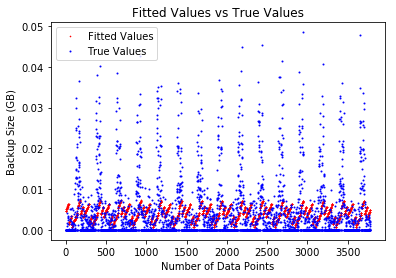

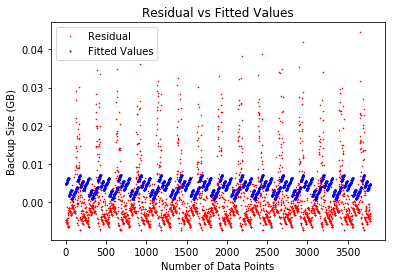

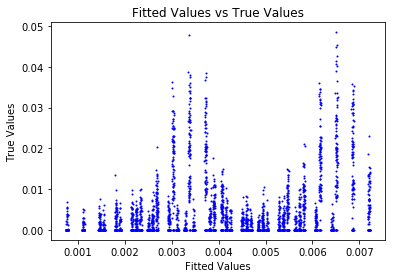

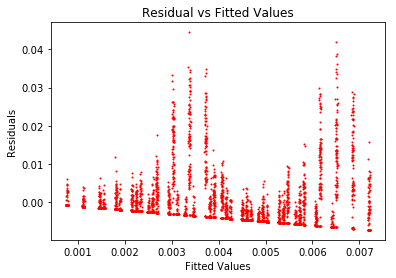

('\n\nWorkflow: ', 'work_flow_1')
('Training MSE for each fold : ', [0.024698796725253193, 0.02572118386653901, 0.026732198902418354, 0.025531656953792232, 0.026521552082265393, 0.02499387574380231, 0.025218480385756192, 0.025186829496689066, 0.025007585469228683, 0.02523625826092267], '\n\n')
('Testing MSE for each fold : ', [0.03260111757501785, 0.023395545486045104, 0.01434604218820418, 0.025095880548880366, 0.016240747658414857, 0.029952723504878653, 0.027937788364929203, 0.028228952669522467, 0.02982971081358937, 0.02775488034357248], '\n\n')
('Training RMSE:', 0.1596397249705308)
('Testing RMSE:', 0.15980719293982187)


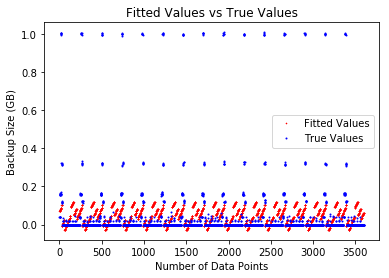

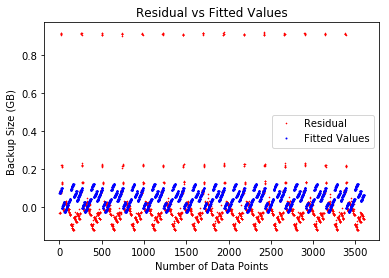

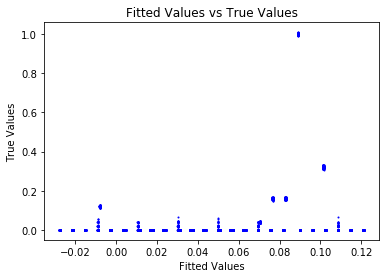

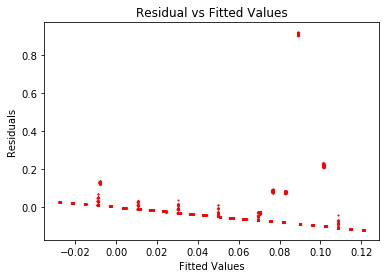

('\n\nWorkflow: ', 'work_flow_4')
('Training MSE for each fold : ', [0.010566944647262018, 0.010902127336703333, 0.010587898923994173, 0.010728405677147926, 0.010413888538513945, 0.010380769519574423, 0.010354372938457458, 0.010883288215283967, 0.010472082429623492, 0.010828521979434244], '\n\n')
('Testing MSE for each fold : ', [0.011046400751514359, 0.008028516035065438, 0.010853719675660851, 0.009607878036435384, 0.01242401253904215, 0.012726363767636613, 0.012979474642650469, 0.008198062990206052, 0.011895681453202061, 0.008689977849287997], '\n\n')
('Training RMSE:', 0.10301373704802431)
('Testing RMSE:', 0.10317465180009157)


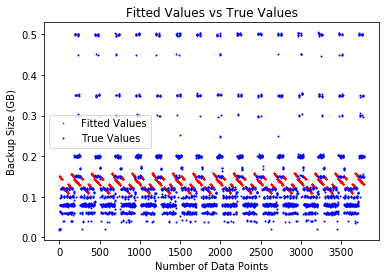

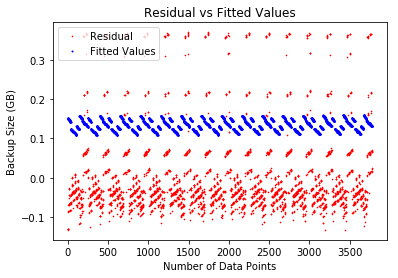

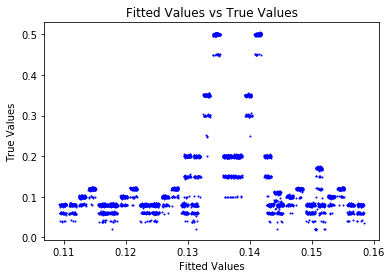

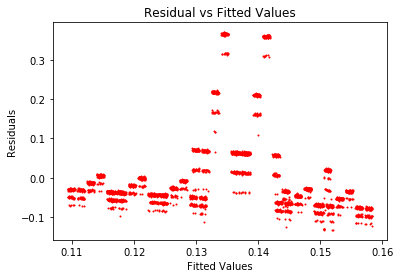

('Average Test RMSE obtained: ', 0.10317465180009157)


In [31]:
wf_test_RMSE = list()

for work_flow in df['Work-Flow-ID'].unique():
    
    #Get the data for this workflow
    df_work_flow = df.loc[df['Work-Flow-ID'] == work_flow]
    del df_work_flow['Backup Time (hour)']
    del df_work_flow['Work-Flow-ID']
    wfMatrix = df_work_flow.as_matrix()
    
    wfX = wfMatrix[:, 0 : wfMatrix.shape[1] - 1]
    wfy = wfMatrix[:, wfMatrix.shape[1] - 1].astype('float')

    #label encode the entire dataset
    wfX = labelEncoder(wfX)
    
    print("\n\nWorkflow: ", work_flow)
    wfTrainRMSE, wfTestRMSE, wfPredictions = regression(wfX, wfy, modelName='LinearRegression', plot=True, verbose=True)
    wf_test_RMSE.append(wfTestRMSE)
    
print("Average Test RMSE obtained: ", wfTestRMSE)
    

## 2(d)(ii)

('Running For Degree: ', 2)
('Workflow ID: ', 'work_flow_0')


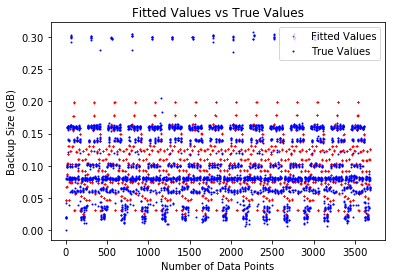

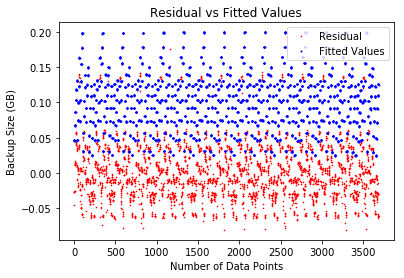

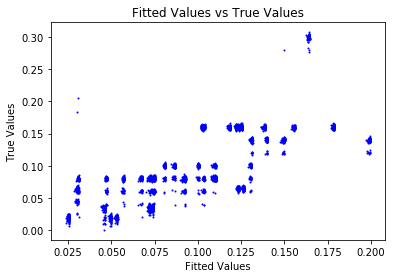

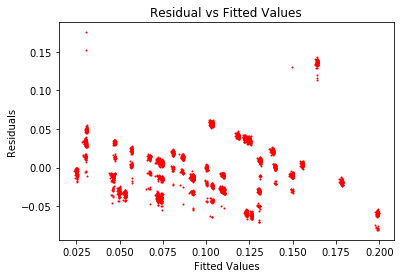

('Workflow ID: ', 'work_flow_2')


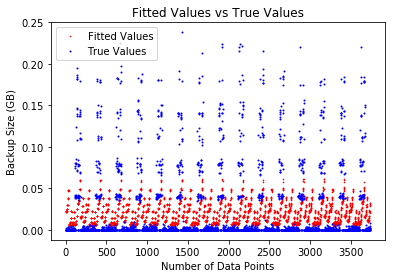

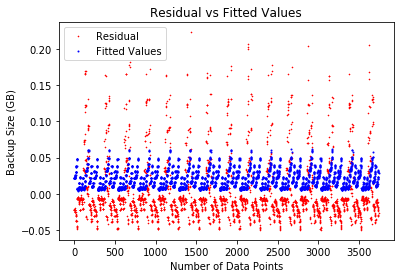

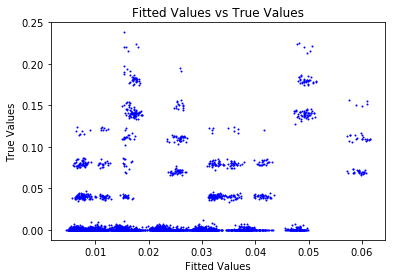

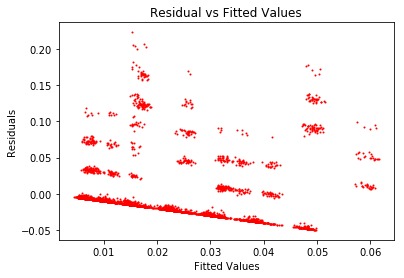

('Workflow ID: ', 'work_flow_3')


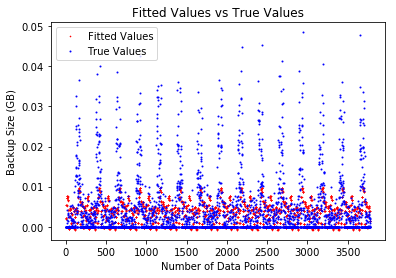

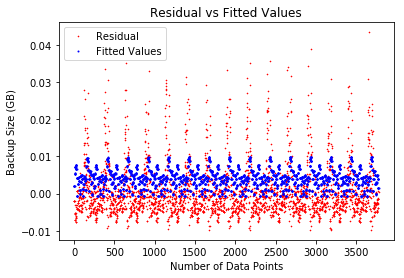

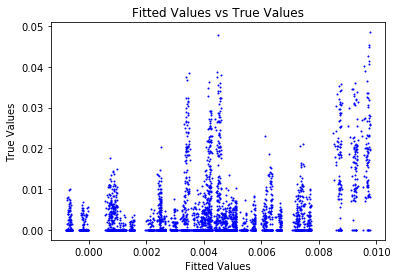

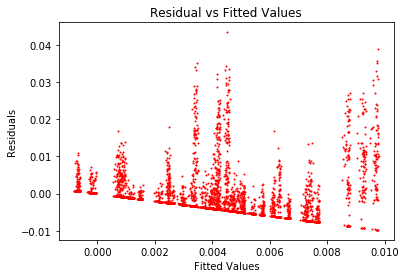

('Workflow ID: ', 'work_flow_1')


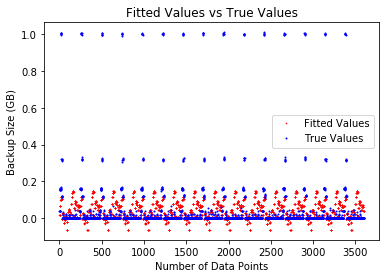

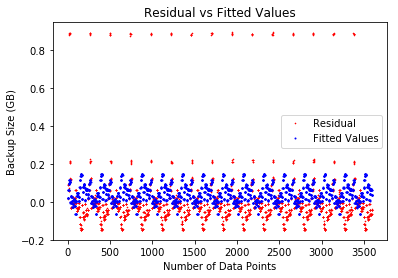

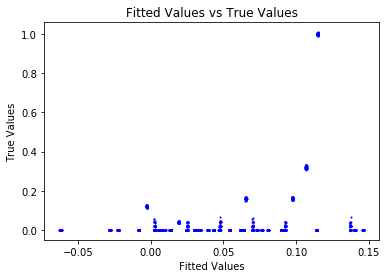

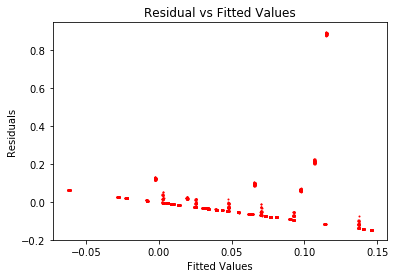

('Workflow ID: ', 'work_flow_4')


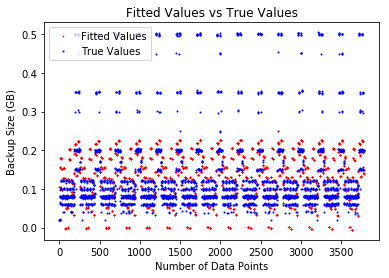

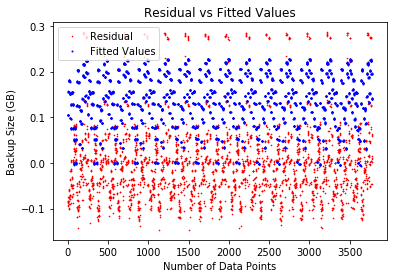

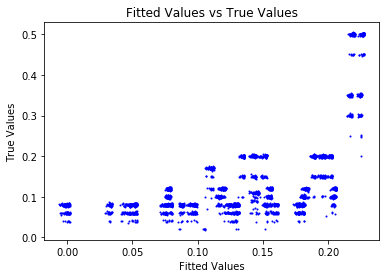

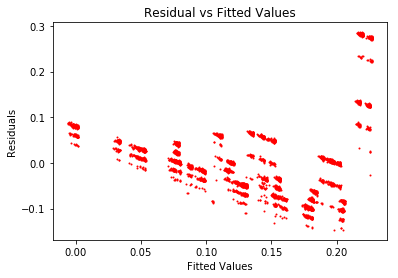

('Running For Degree: ', 3)
('Workflow ID: ', 'work_flow_0')


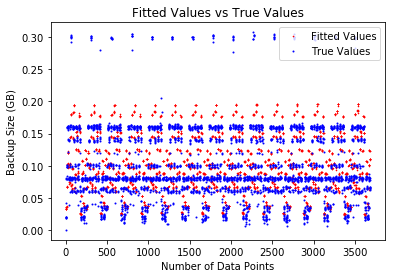

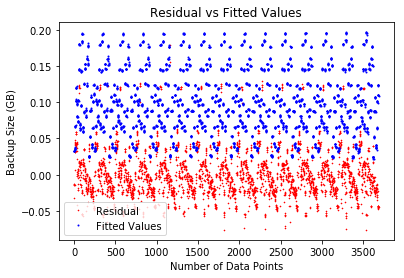

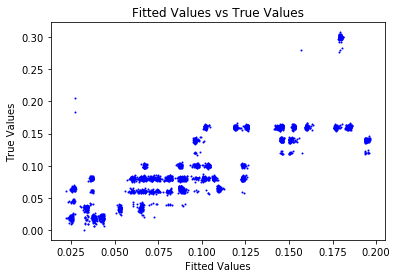

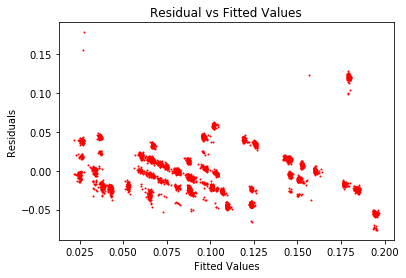

('Workflow ID: ', 'work_flow_2')


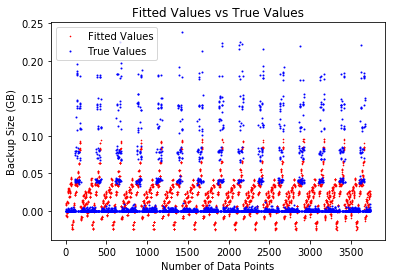

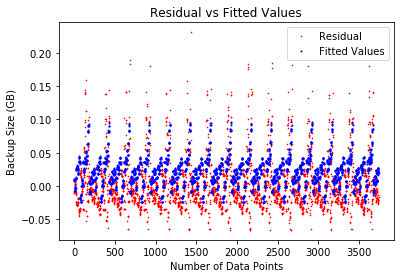

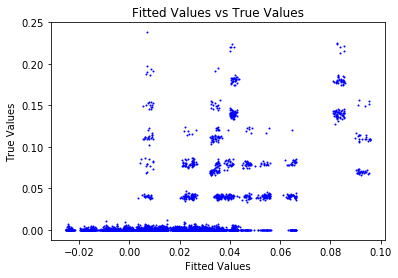

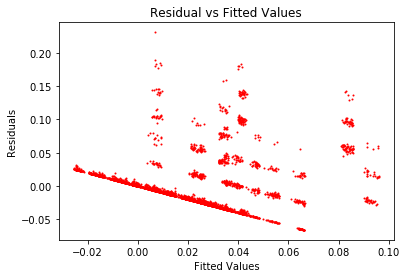

('Workflow ID: ', 'work_flow_3')


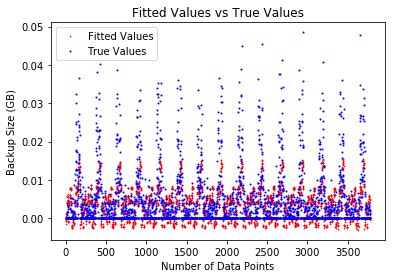

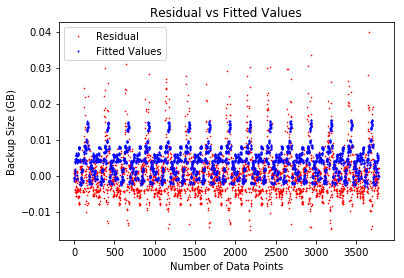

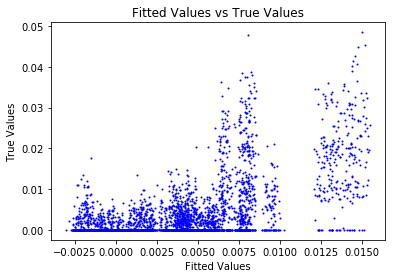

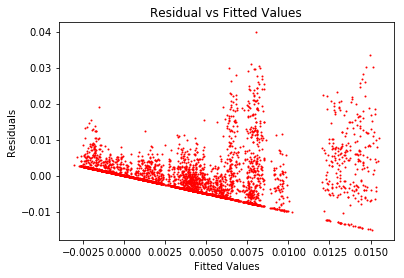

('Workflow ID: ', 'work_flow_1')


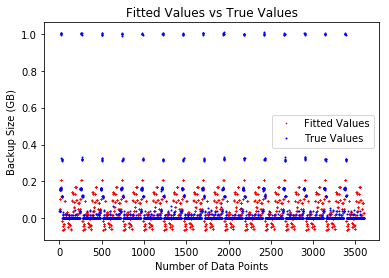

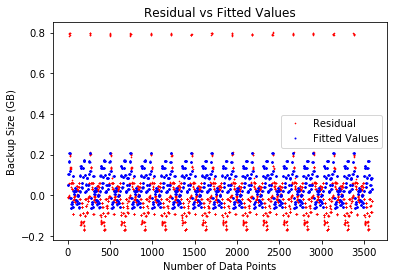

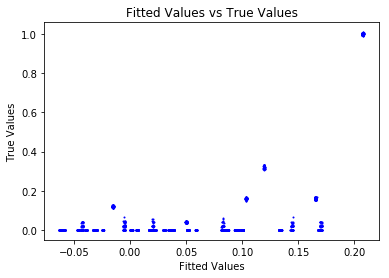

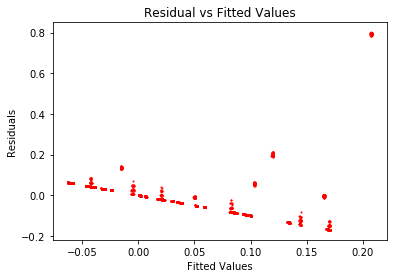

('Workflow ID: ', 'work_flow_4')


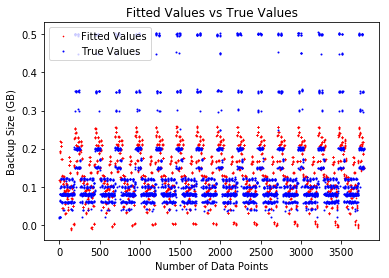

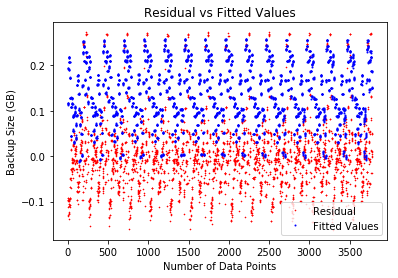

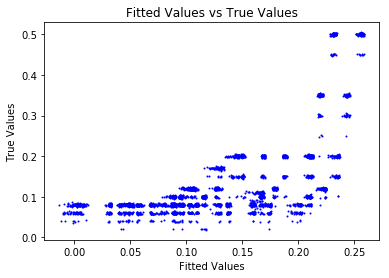

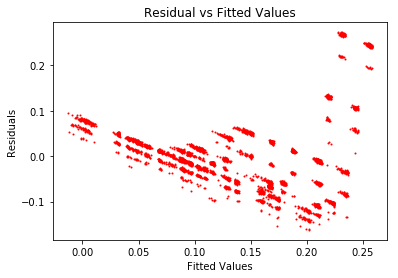

('Running For Degree: ', 4)
('Workflow ID: ', 'work_flow_0')


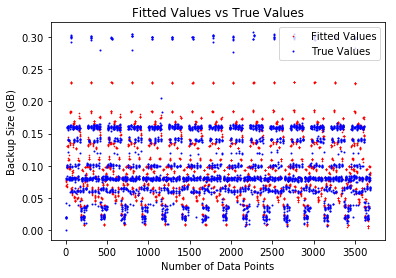

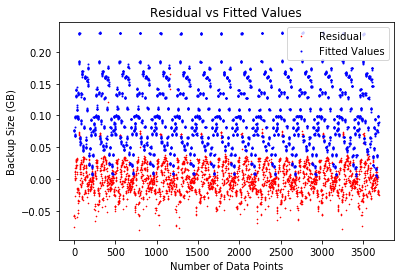

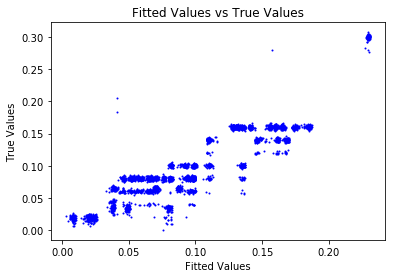

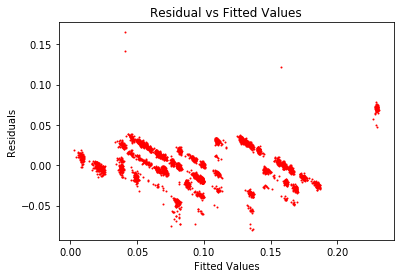

('Workflow ID: ', 'work_flow_2')


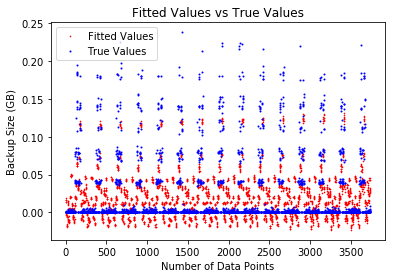

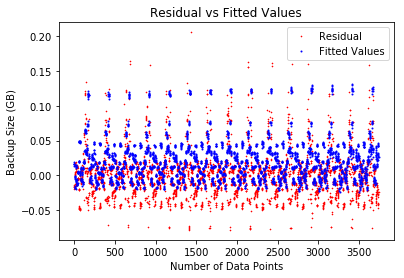

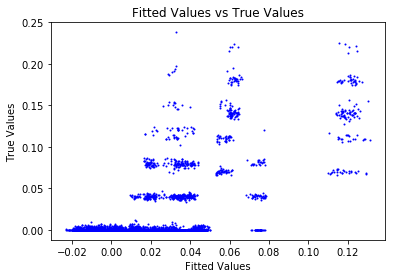

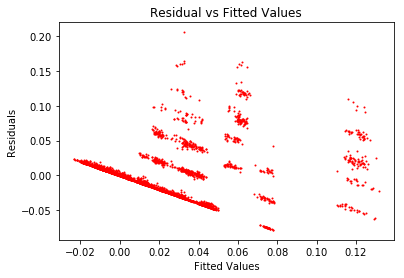

('Workflow ID: ', 'work_flow_3')


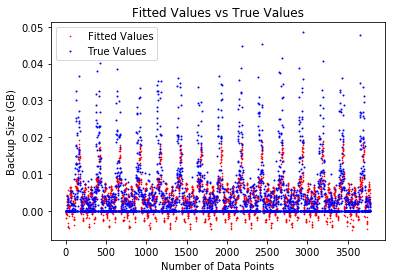

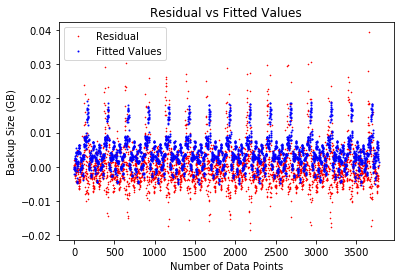

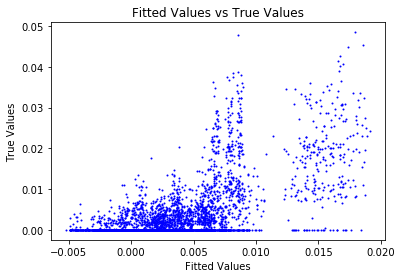

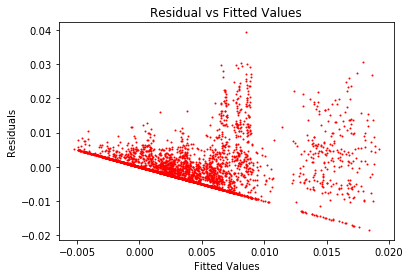

('Workflow ID: ', 'work_flow_1')


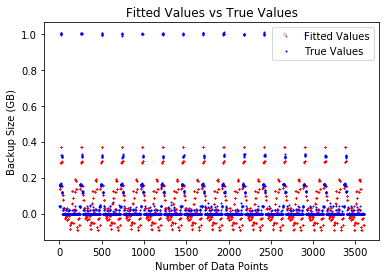

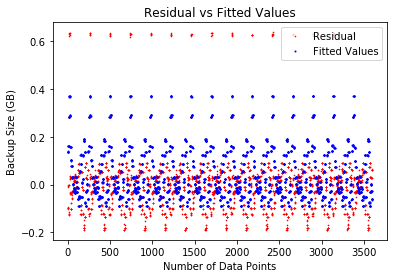

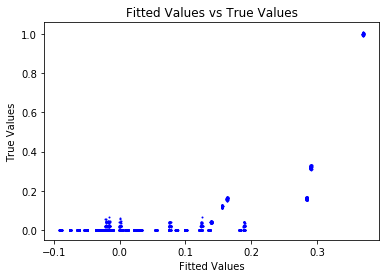

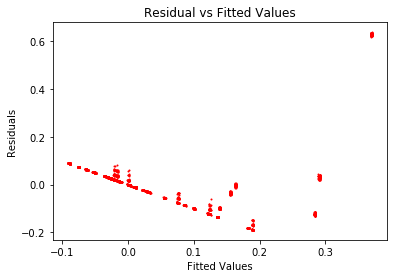

('Workflow ID: ', 'work_flow_4')


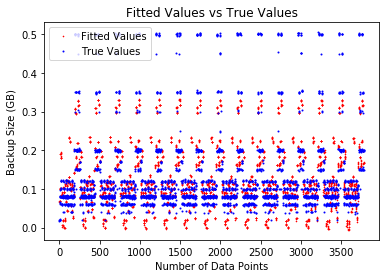

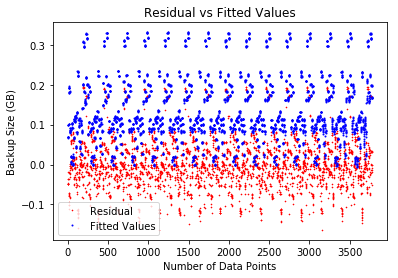

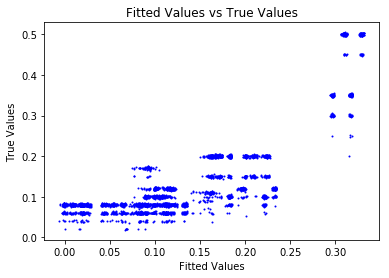

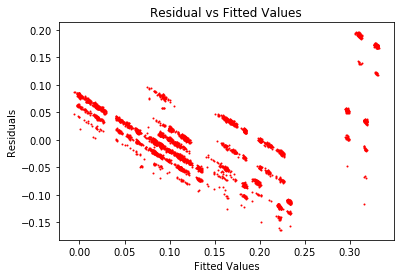

('Running For Degree: ', 5)
('Workflow ID: ', 'work_flow_0')


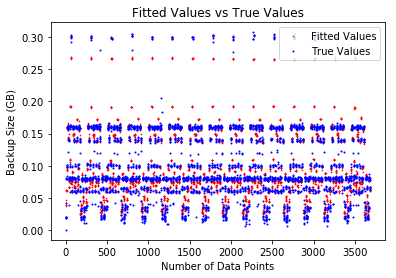

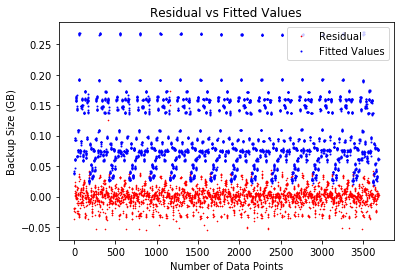

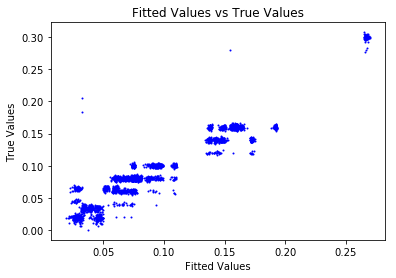

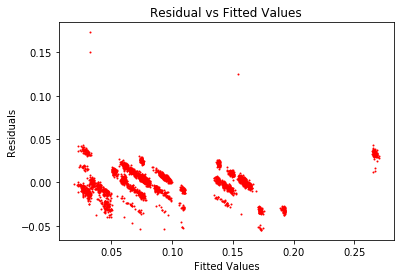

('Workflow ID: ', 'work_flow_2')


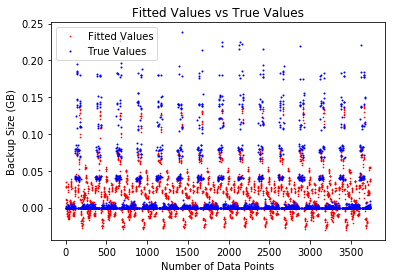

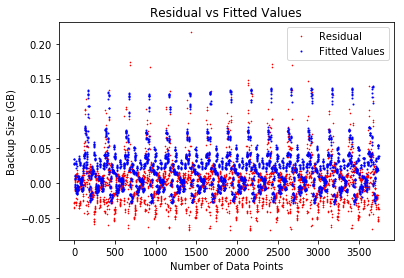

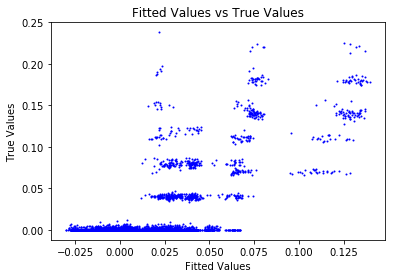

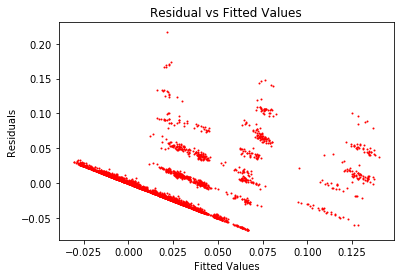

('Workflow ID: ', 'work_flow_3')


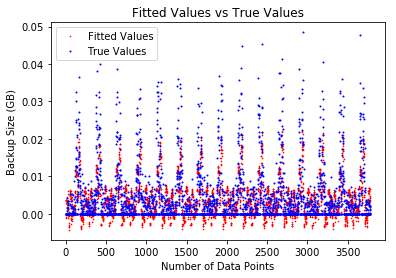

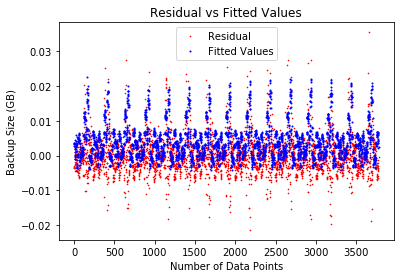

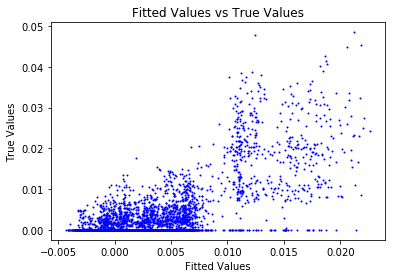

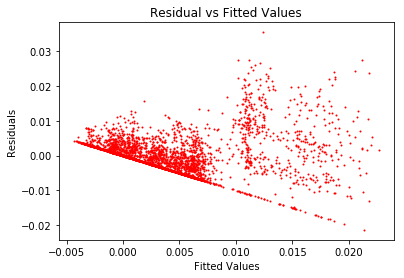

('Workflow ID: ', 'work_flow_1')


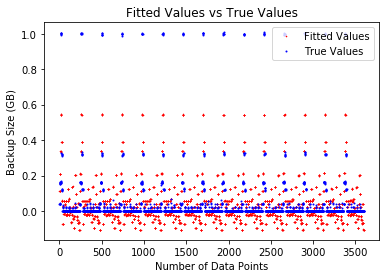

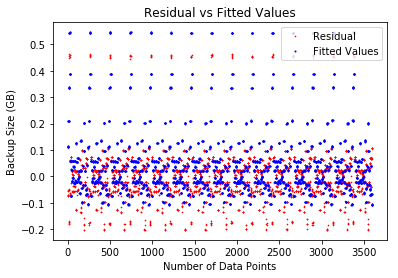

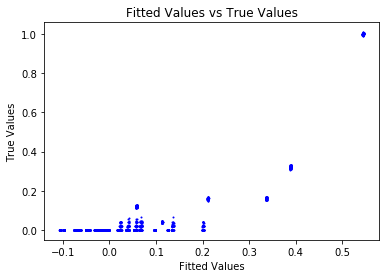

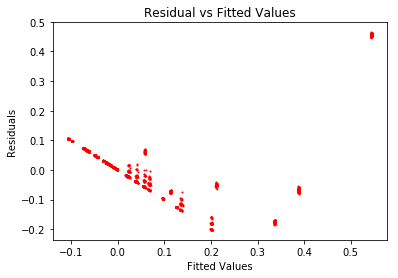

('Workflow ID: ', 'work_flow_4')


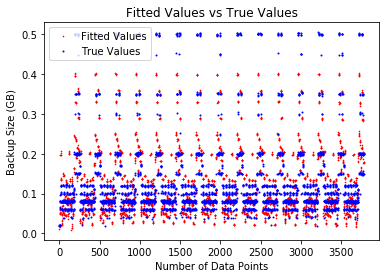

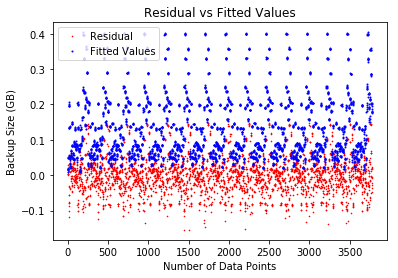

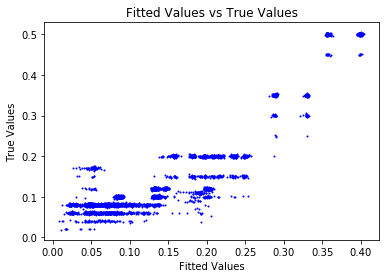

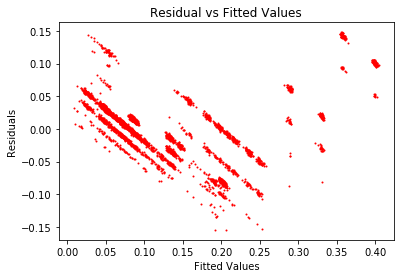

('Running For Degree: ', 6)
('Workflow ID: ', 'work_flow_0')


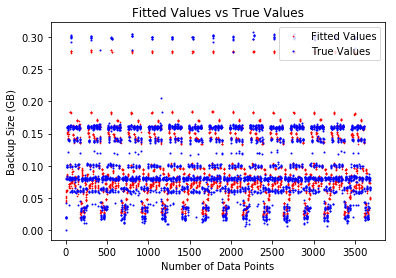

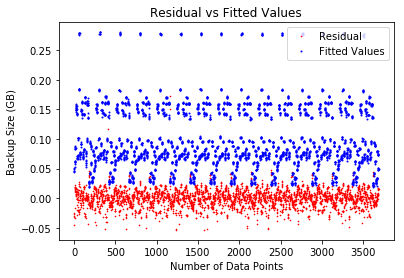

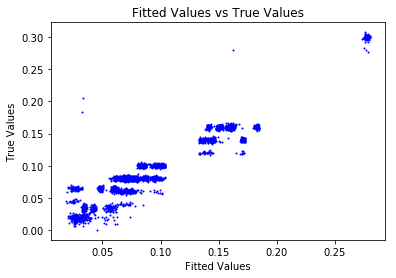

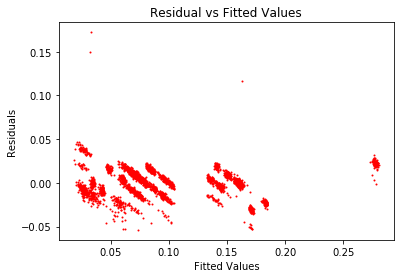

('Workflow ID: ', 'work_flow_2')


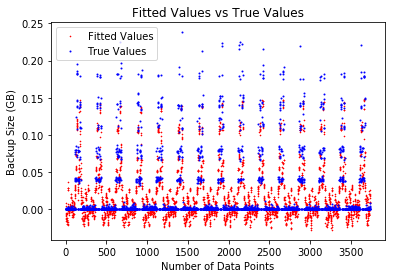

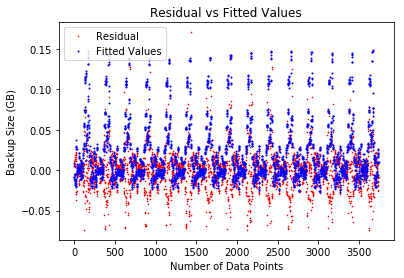

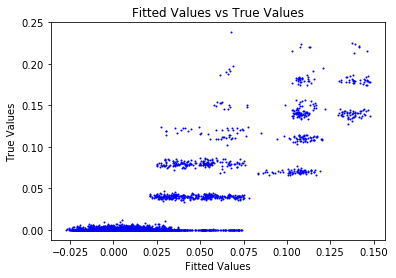

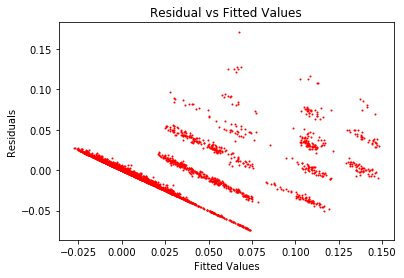

('Workflow ID: ', 'work_flow_3')


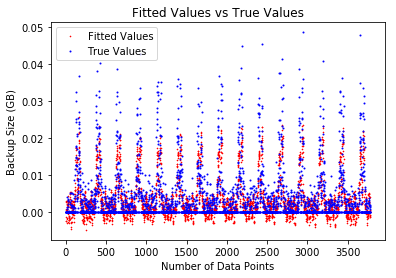

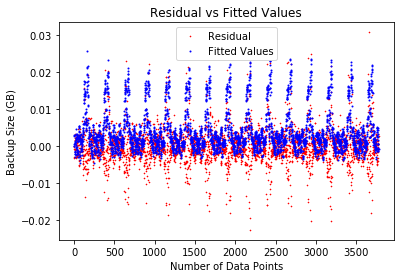

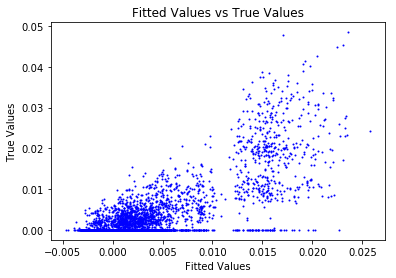

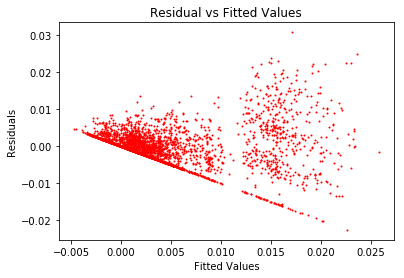

('Workflow ID: ', 'work_flow_1')


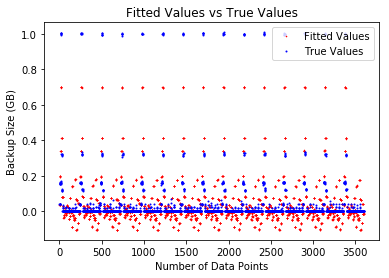

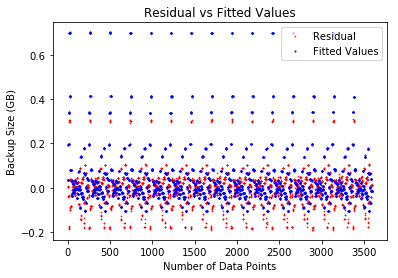

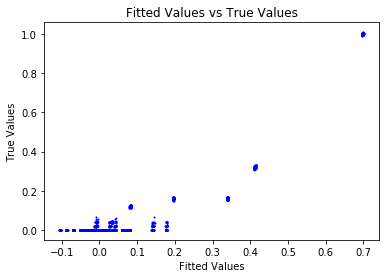

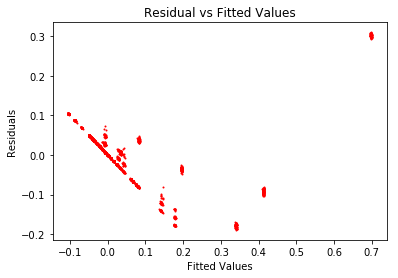

('Workflow ID: ', 'work_flow_4')


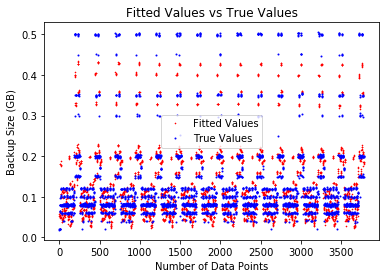

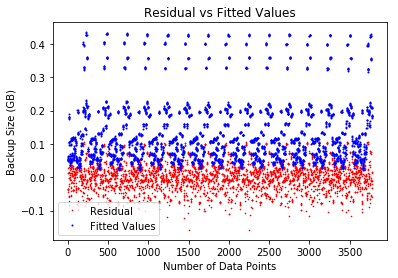

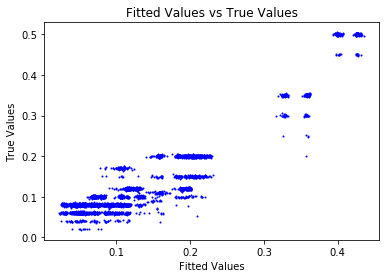

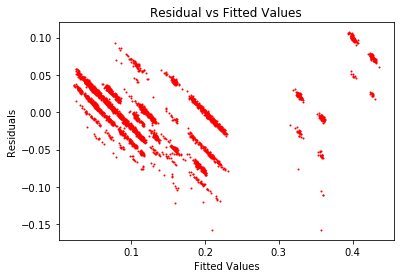

('Running For Degree: ', 7)
('Workflow ID: ', 'work_flow_0')


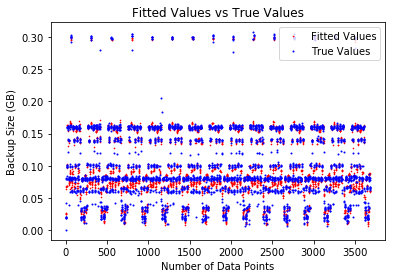

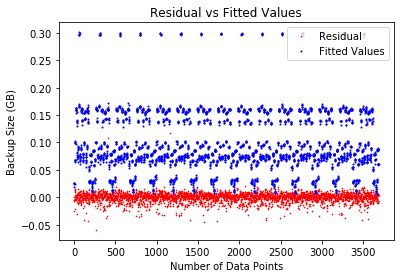

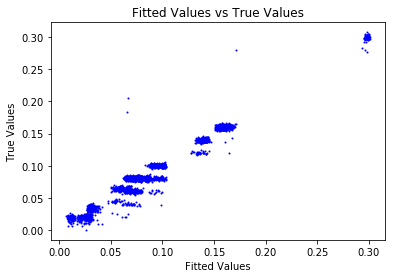

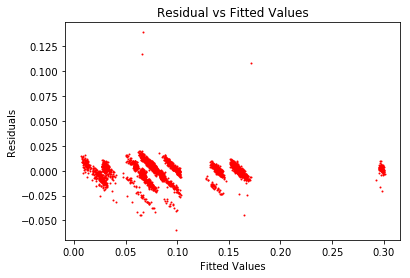

('Workflow ID: ', 'work_flow_2')


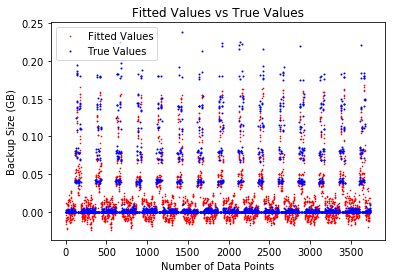

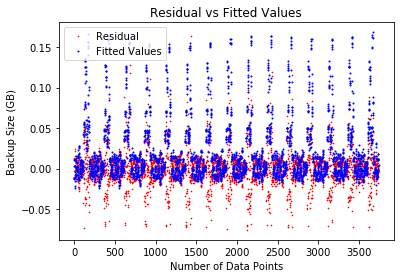

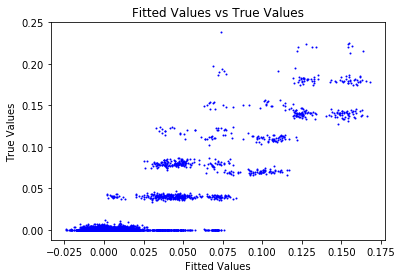

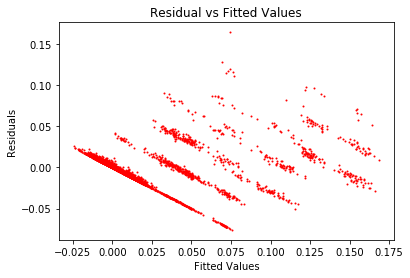

('Workflow ID: ', 'work_flow_3')


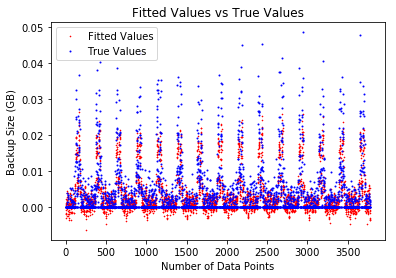

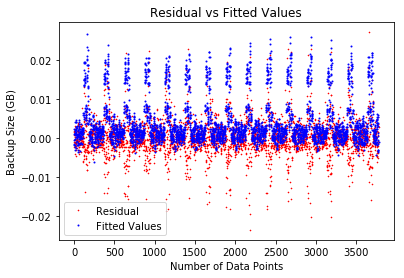

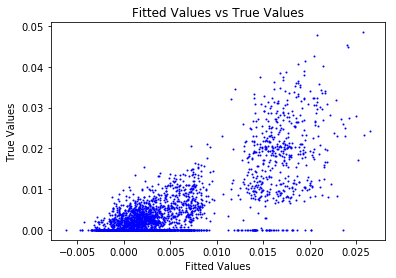

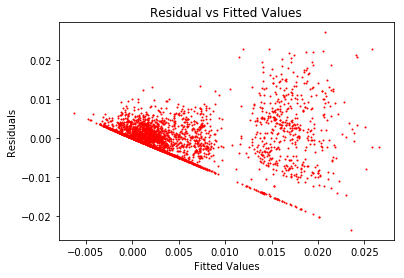

('Workflow ID: ', 'work_flow_1')


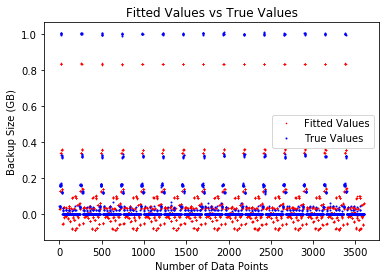

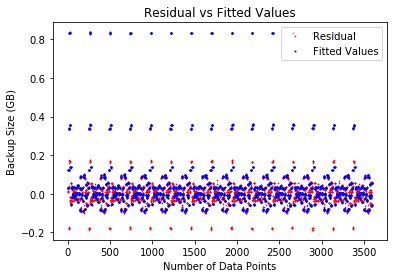

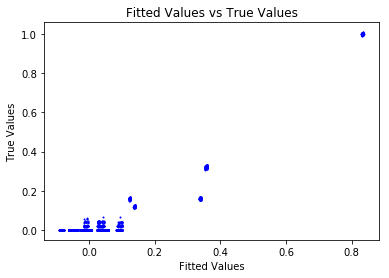

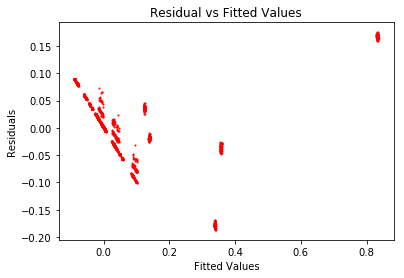

('Workflow ID: ', 'work_flow_4')


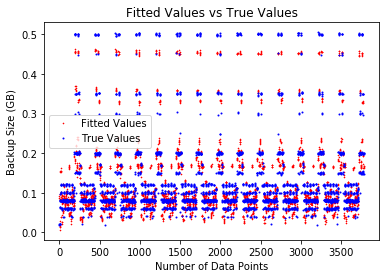

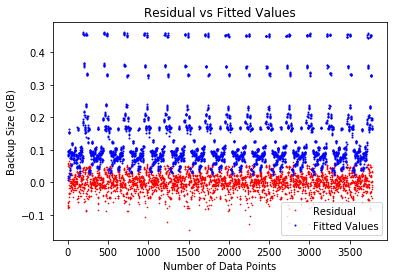

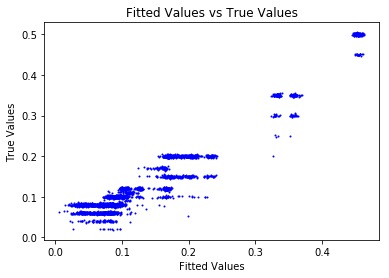

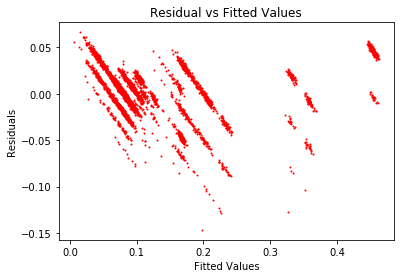

('Running For Degree: ', 8)
('Workflow ID: ', 'work_flow_0')


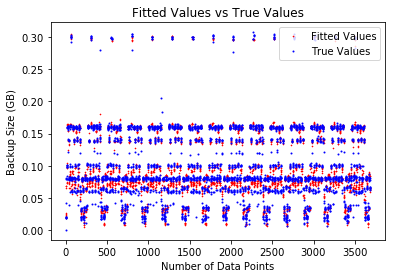

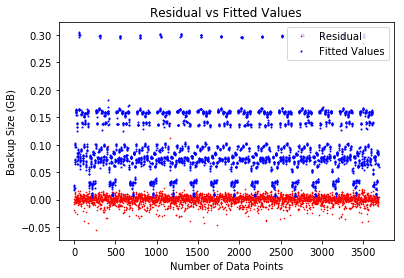

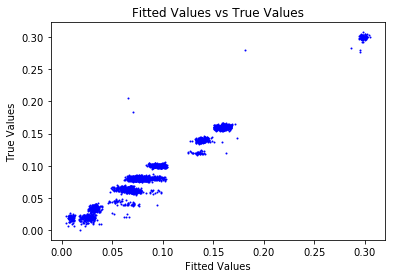

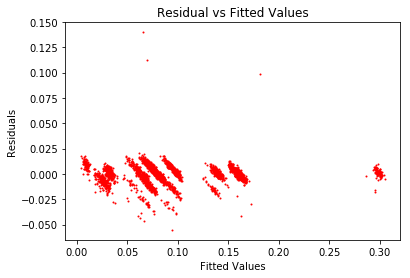

('Workflow ID: ', 'work_flow_2')


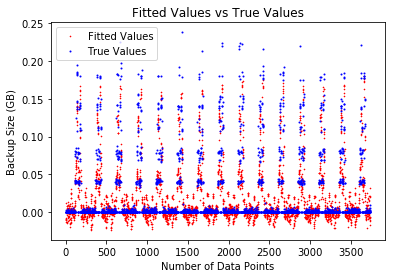

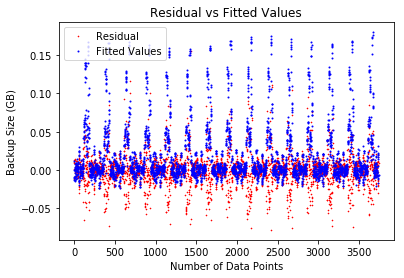

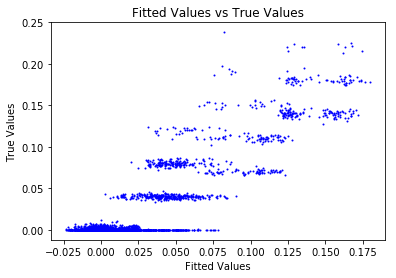

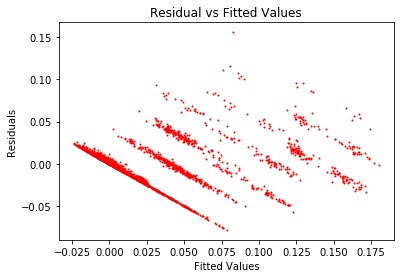

('Workflow ID: ', 'work_flow_3')


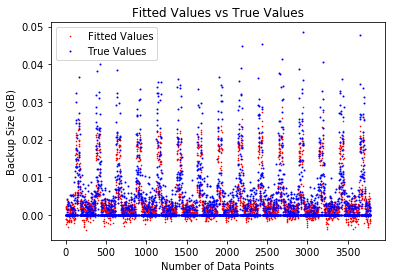

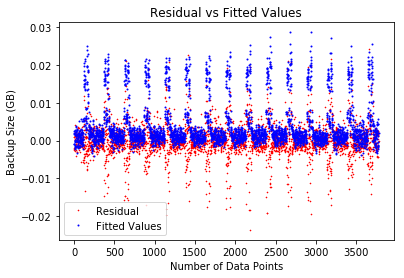

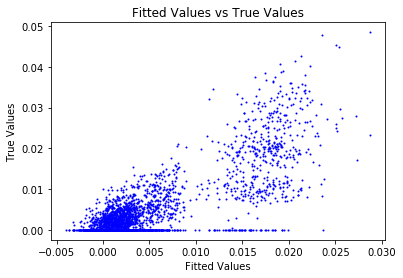

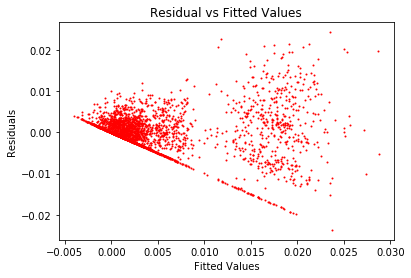

('Workflow ID: ', 'work_flow_1')


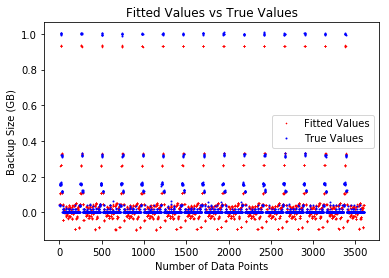

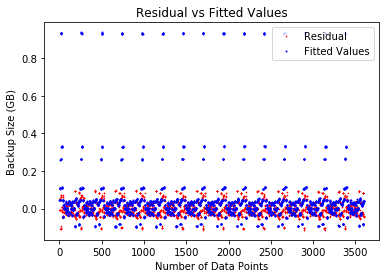

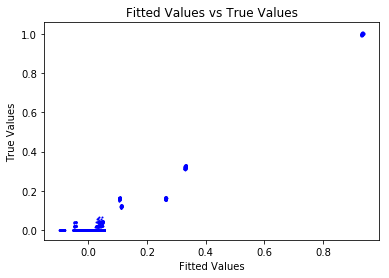

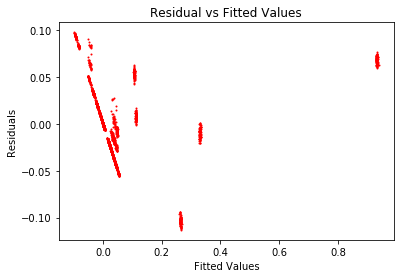

('Workflow ID: ', 'work_flow_4')


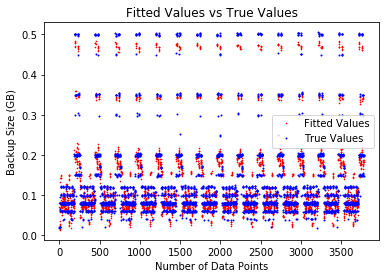

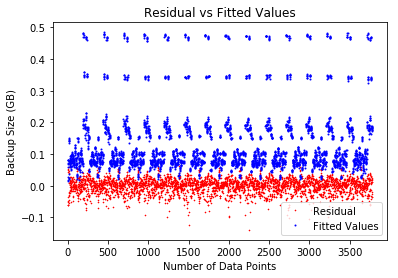

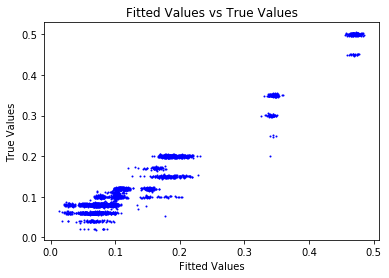

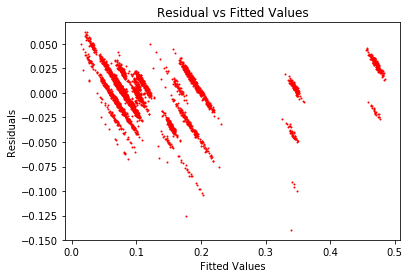

('Running For Degree: ', 9)
('Workflow ID: ', 'work_flow_0')


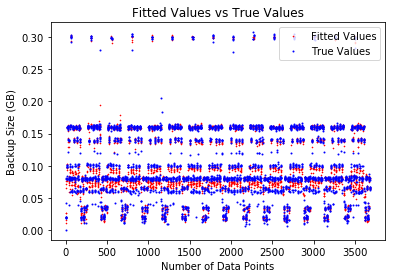

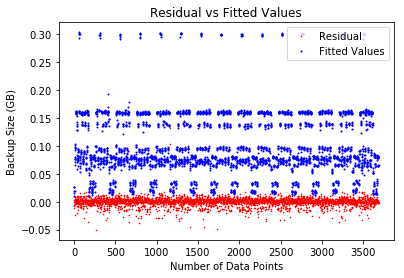

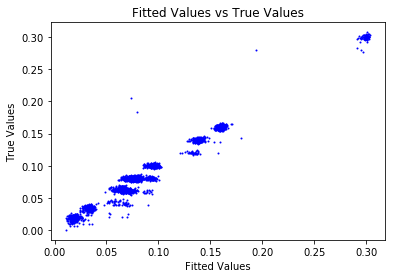

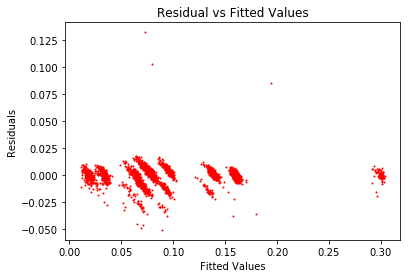

('Workflow ID: ', 'work_flow_2')


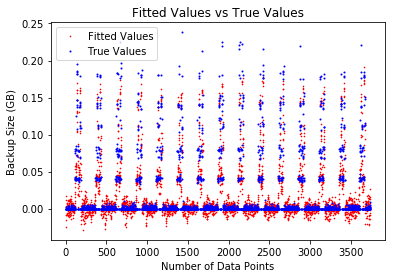

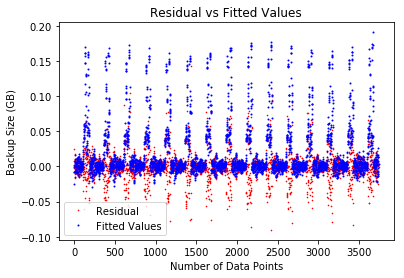

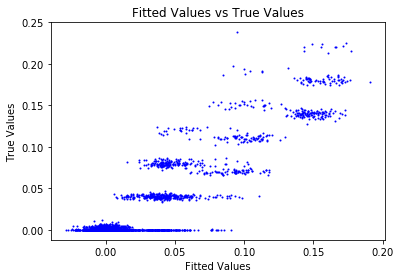

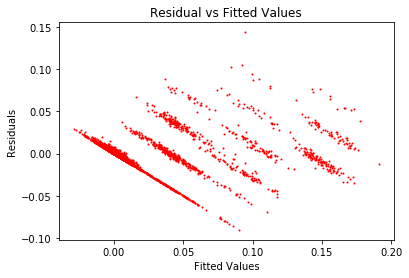

('Workflow ID: ', 'work_flow_3')


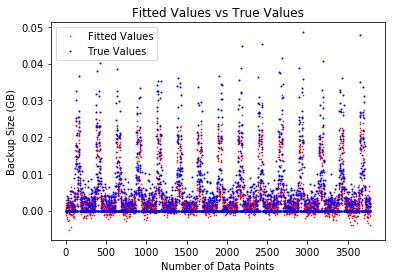

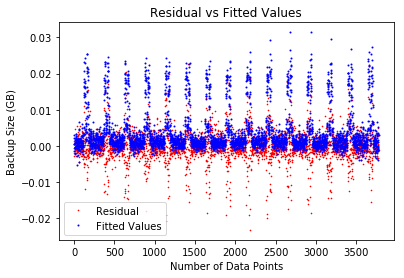

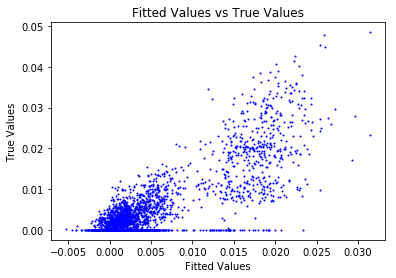

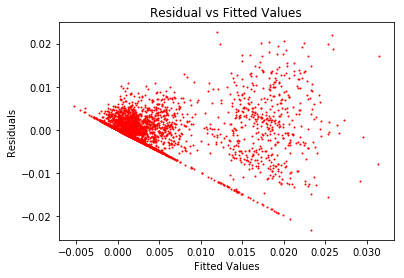

('Workflow ID: ', 'work_flow_1')


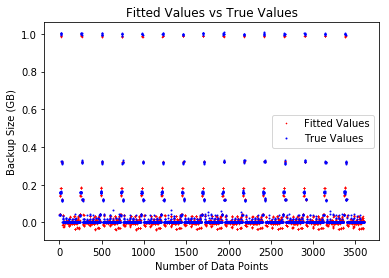

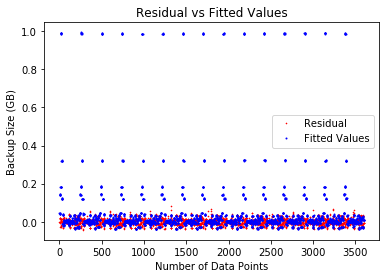

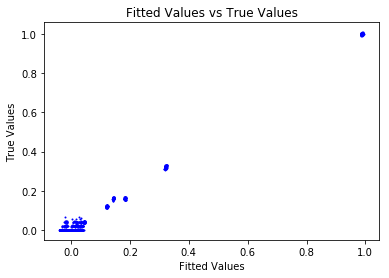

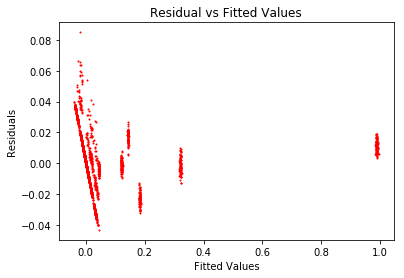

('Workflow ID: ', 'work_flow_4')


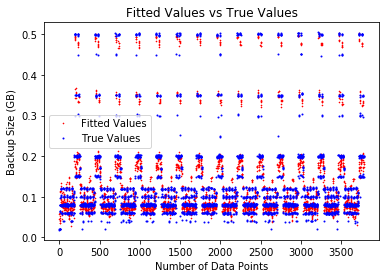

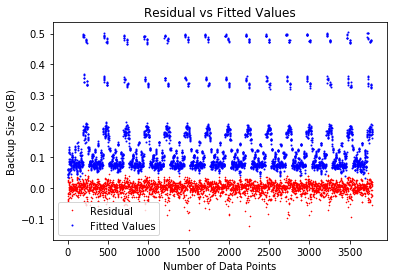

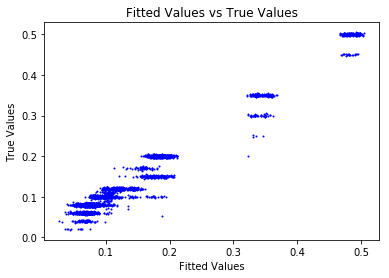

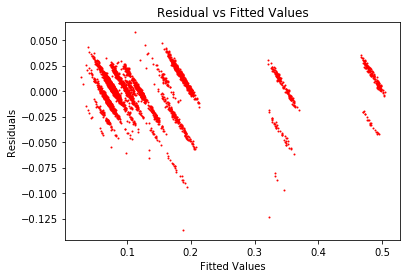

('Running For Degree: ', 10)
('Workflow ID: ', 'work_flow_0')


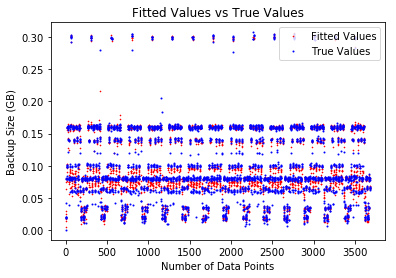

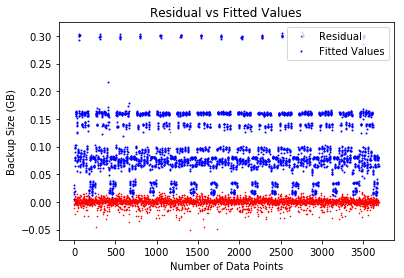

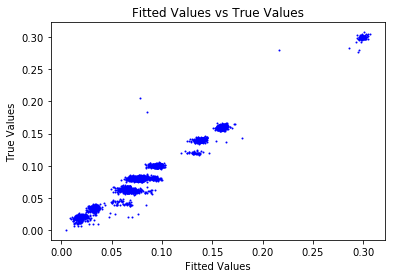

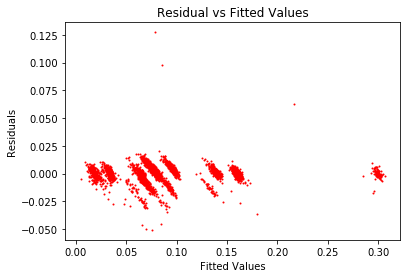

('Workflow ID: ', 'work_flow_2')


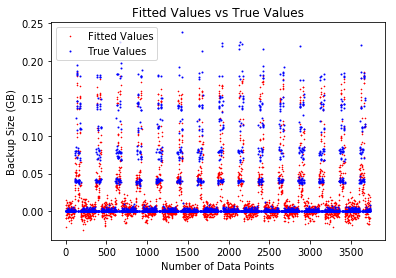

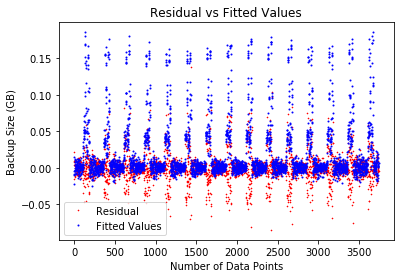

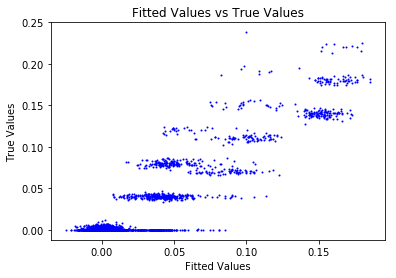

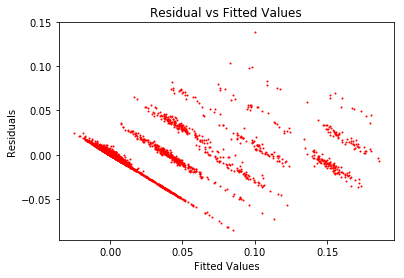

('Workflow ID: ', 'work_flow_3')


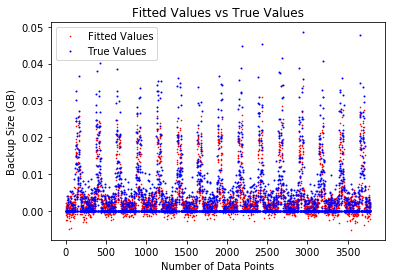

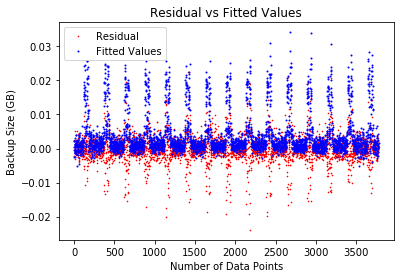

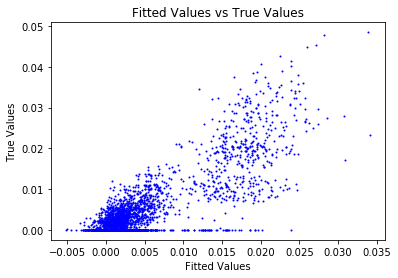

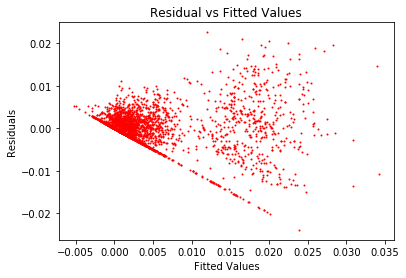

('Workflow ID: ', 'work_flow_1')


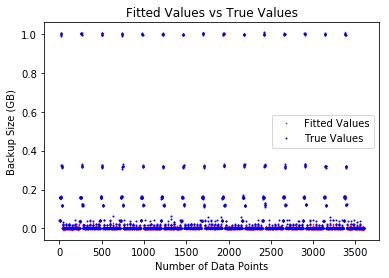

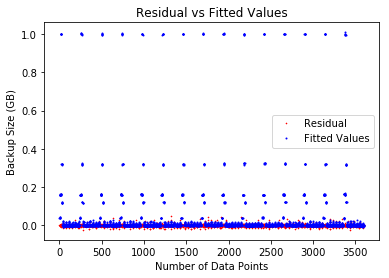

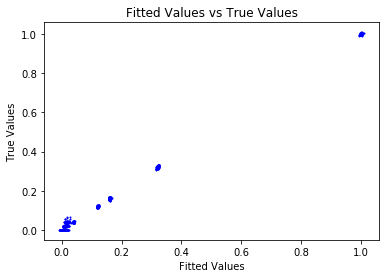

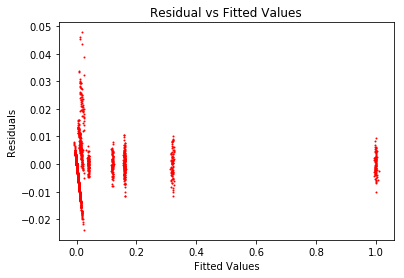

('Workflow ID: ', 'work_flow_4')


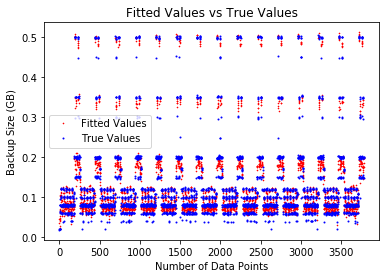

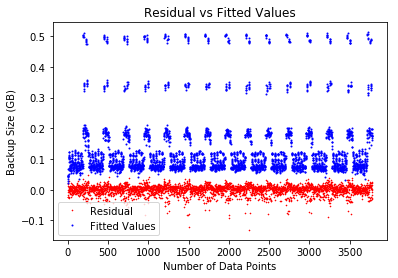

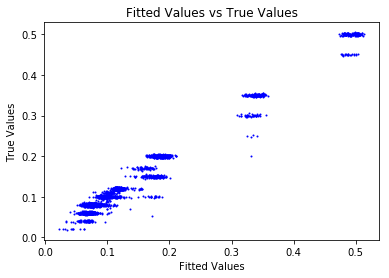

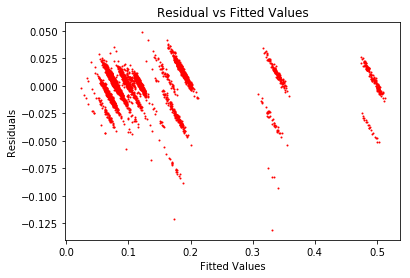

('Running For Degree: ', 11)
('Workflow ID: ', 'work_flow_0')


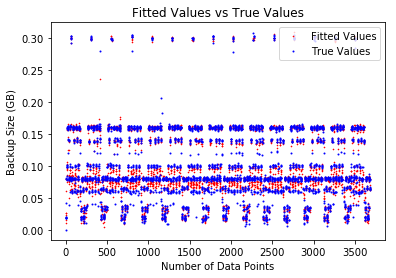

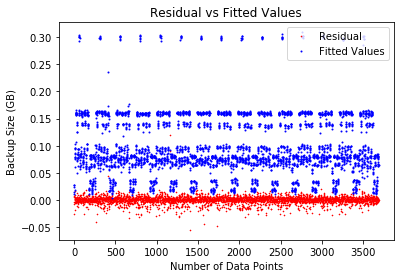

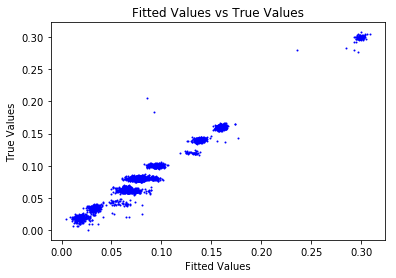

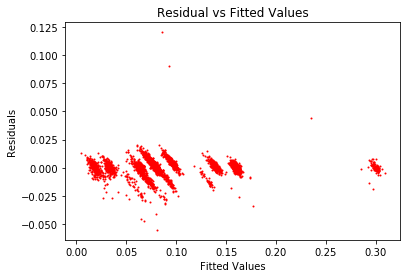

('Workflow ID: ', 'work_flow_2')


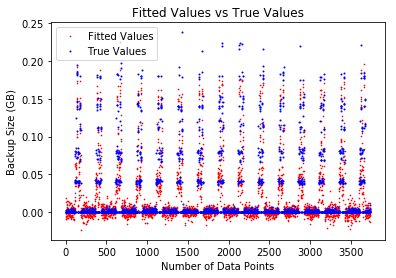

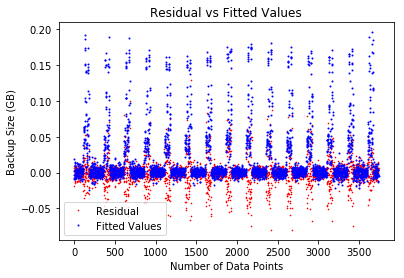

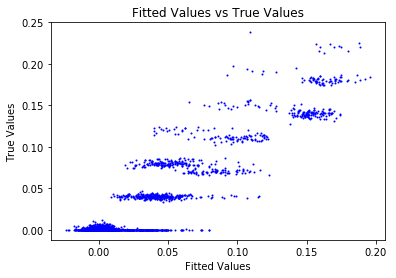

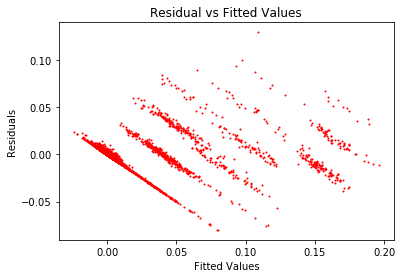

('Workflow ID: ', 'work_flow_3')


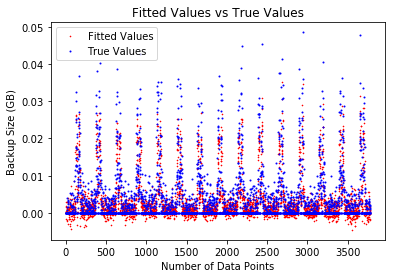

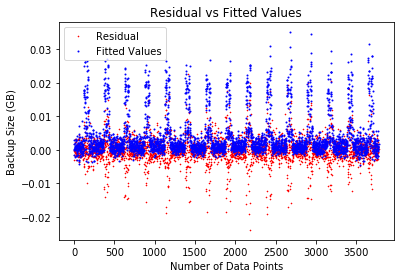

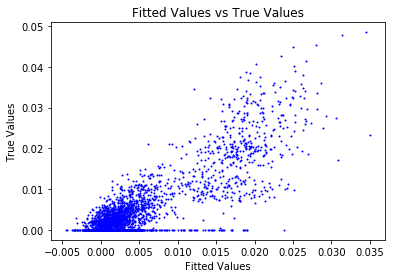

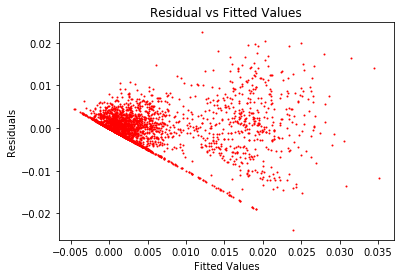

('Workflow ID: ', 'work_flow_1')


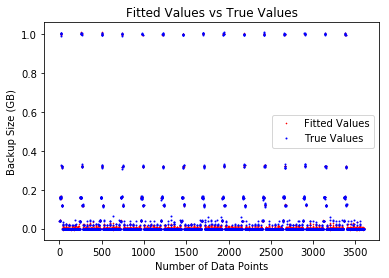

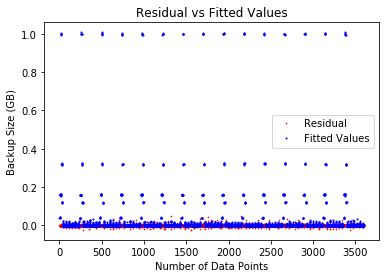

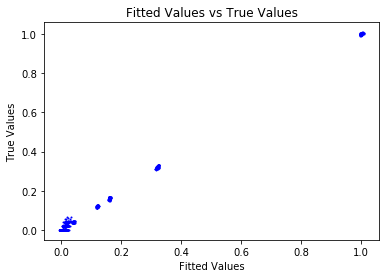

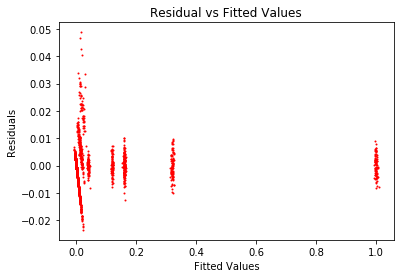

('Workflow ID: ', 'work_flow_4')


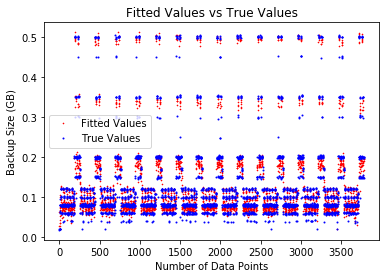

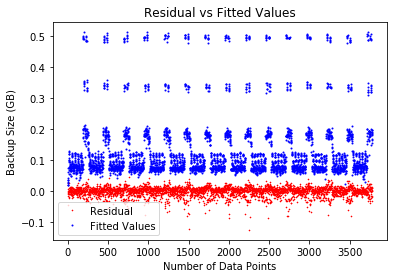

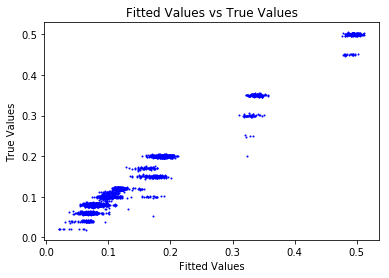

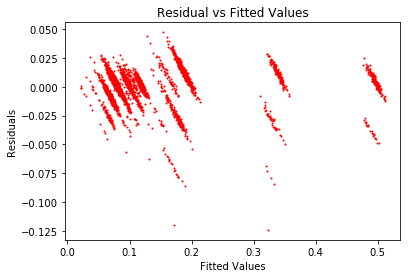

('Running For Degree: ', 12)
('Workflow ID: ', 'work_flow_0')


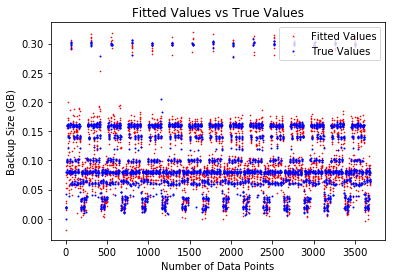

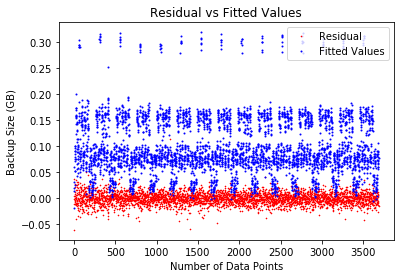

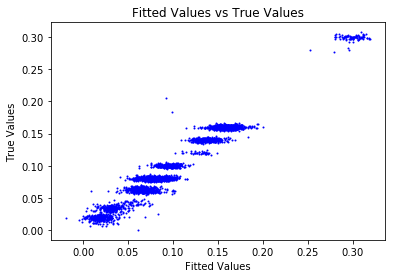

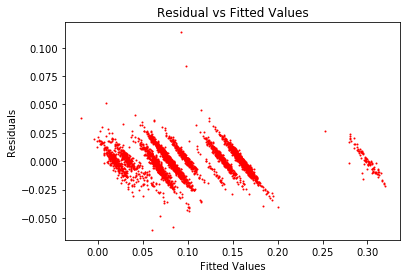

('Workflow ID: ', 'work_flow_2')


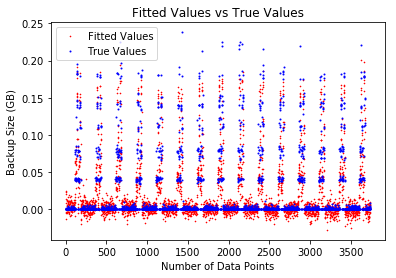

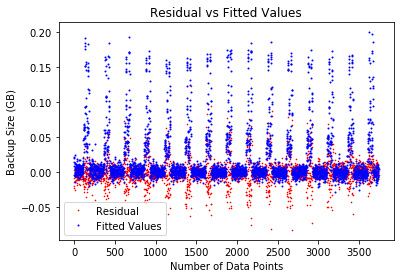

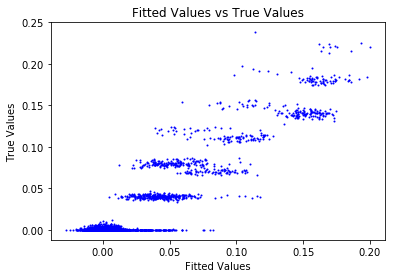

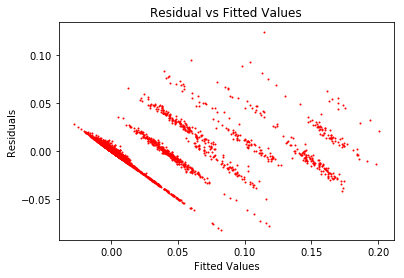

('Workflow ID: ', 'work_flow_3')


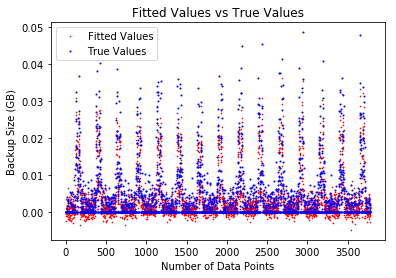

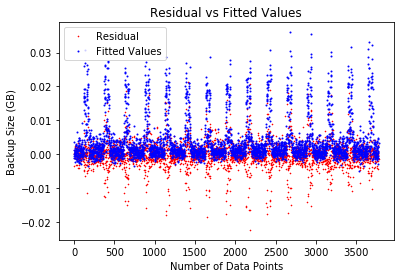

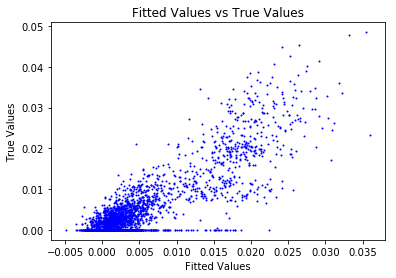

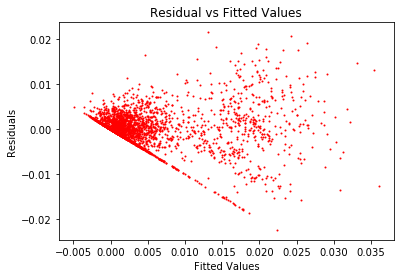

('Workflow ID: ', 'work_flow_1')


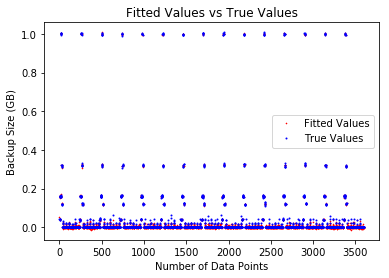

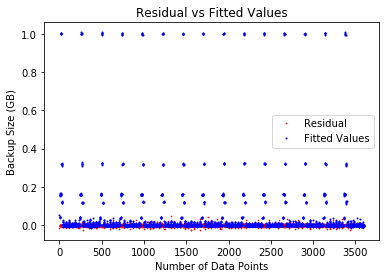

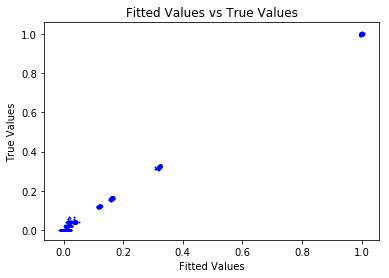

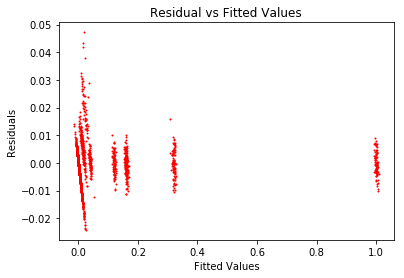

('Workflow ID: ', 'work_flow_4')


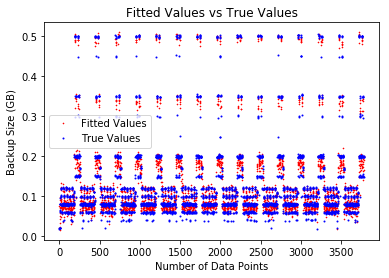

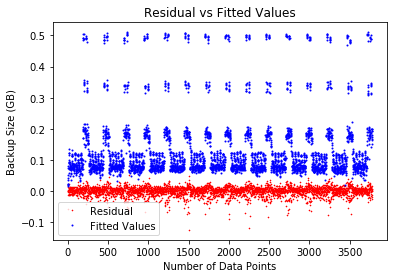

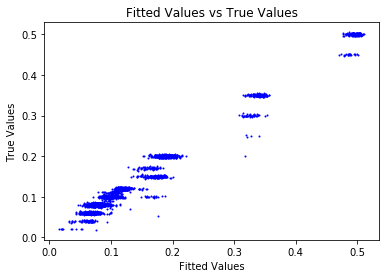

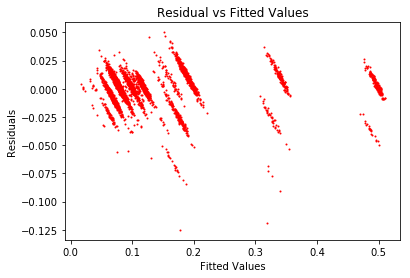

('Running For Degree: ', 13)
('Workflow ID: ', 'work_flow_0')


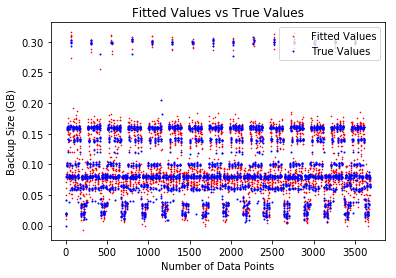

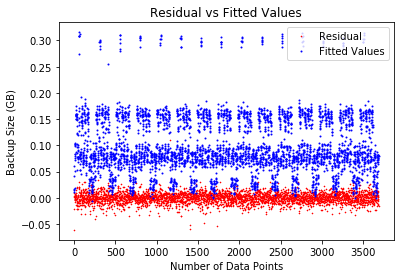

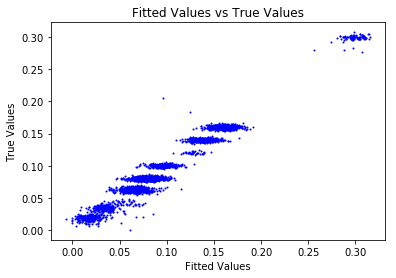

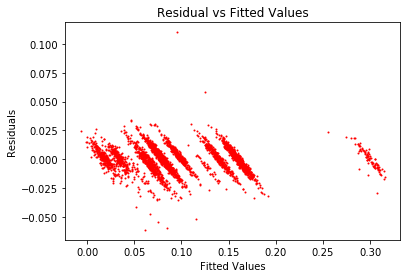

('Workflow ID: ', 'work_flow_2')


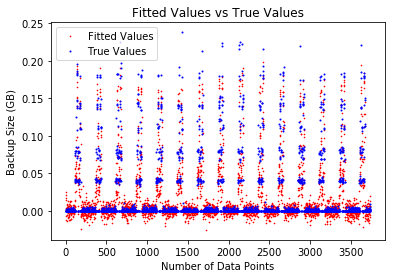

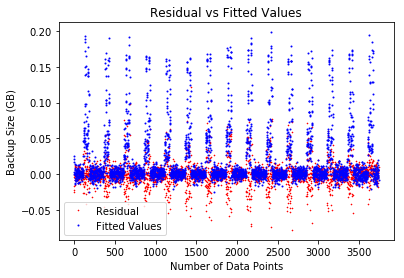

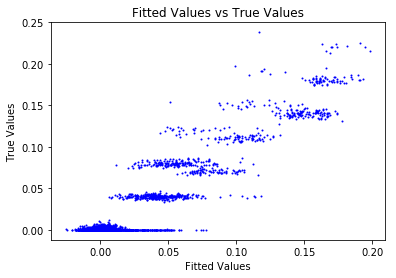

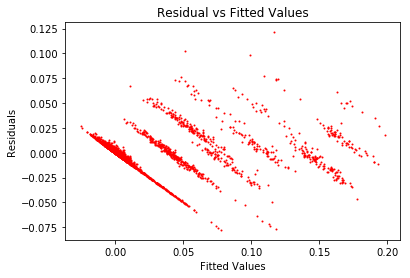

('Workflow ID: ', 'work_flow_3')


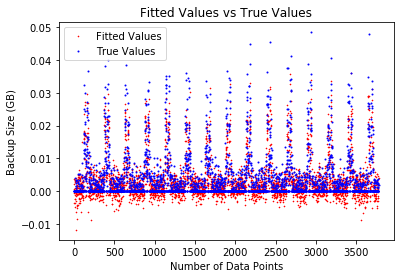

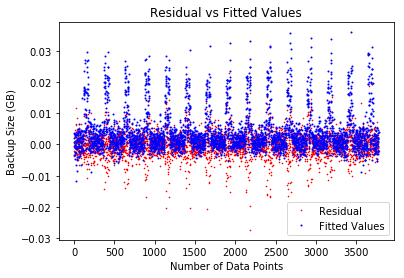

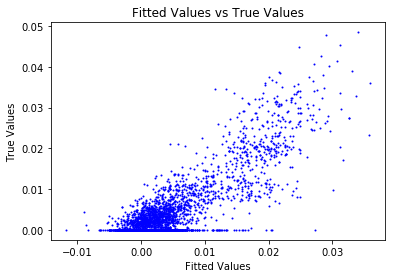

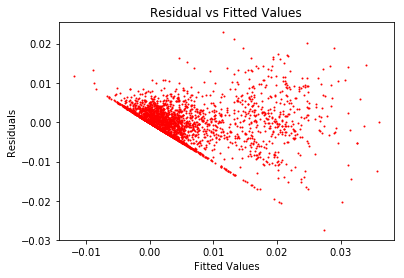

('Workflow ID: ', 'work_flow_1')


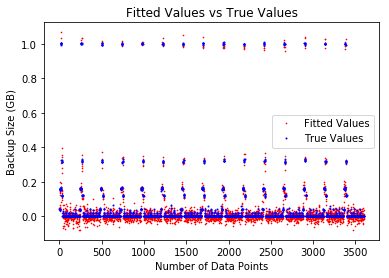

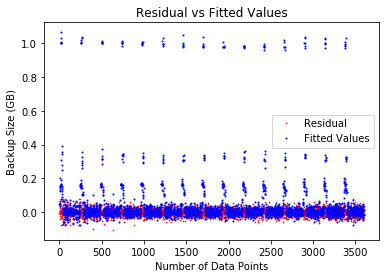

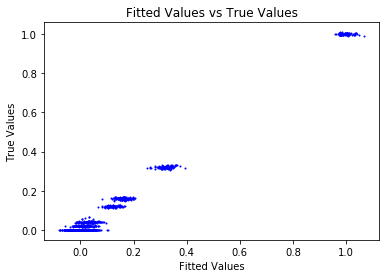

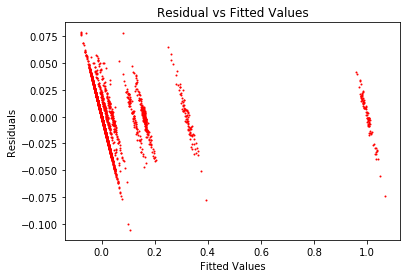

('Workflow ID: ', 'work_flow_4')


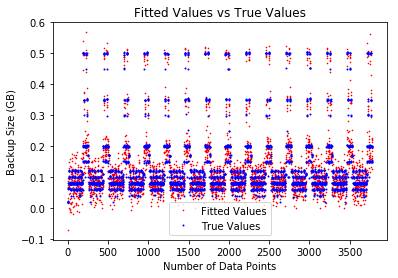

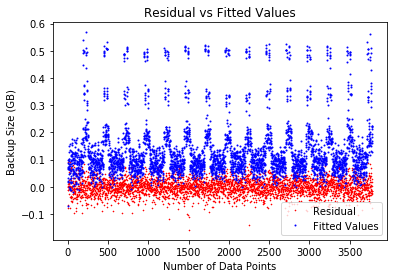

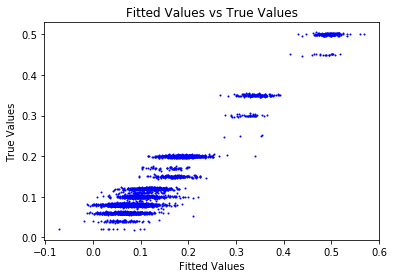

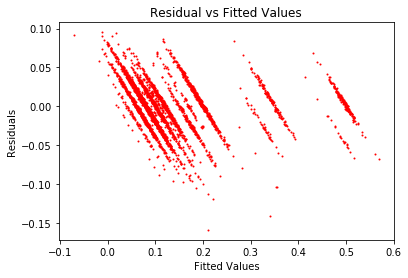

('Running For Degree: ', 14)
('Workflow ID: ', 'work_flow_0')


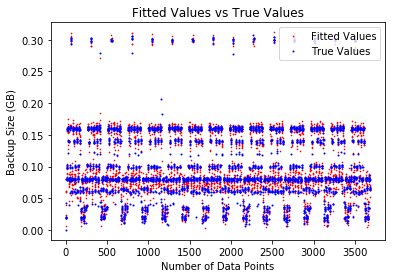

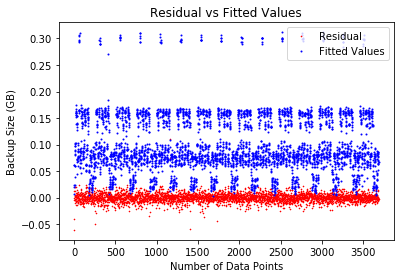

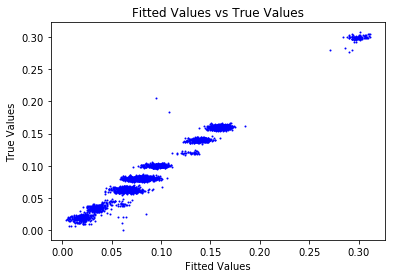

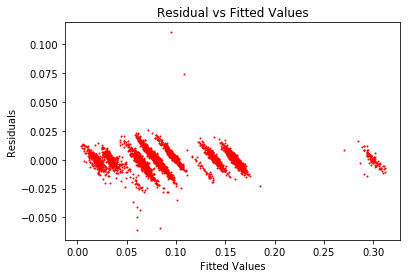

('Workflow ID: ', 'work_flow_2')


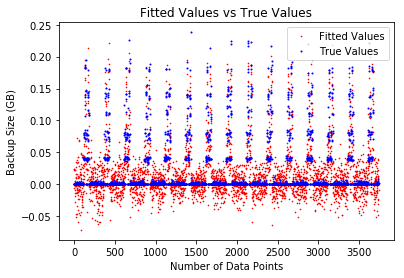

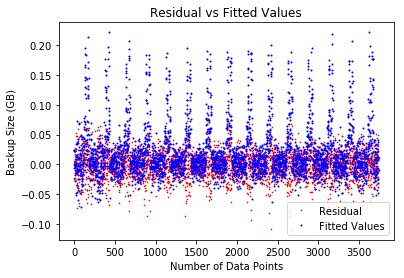

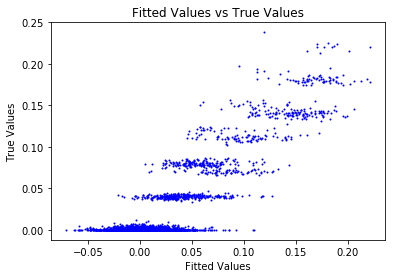

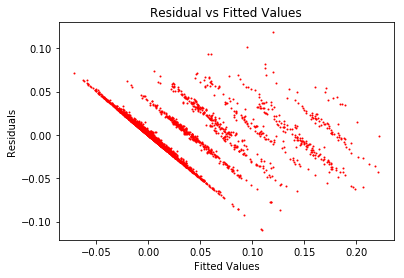

('Workflow ID: ', 'work_flow_3')


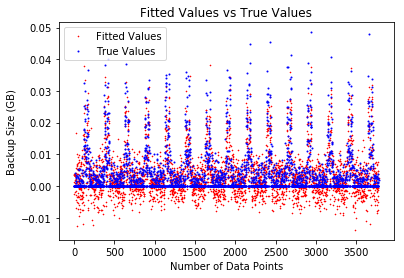

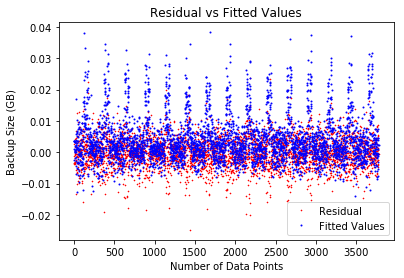

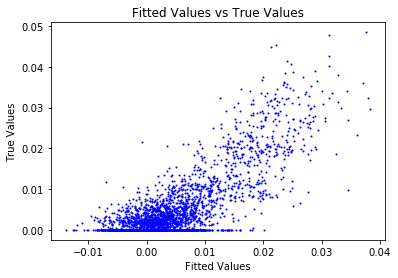

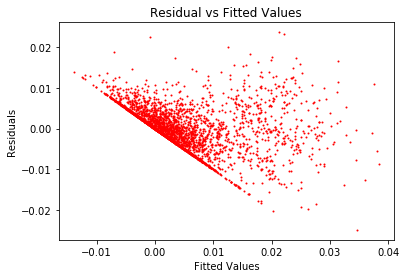

('Workflow ID: ', 'work_flow_1')


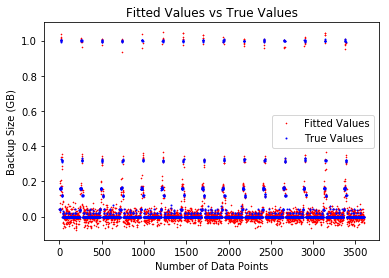

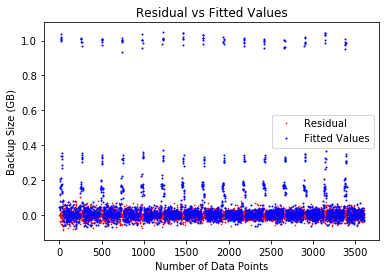

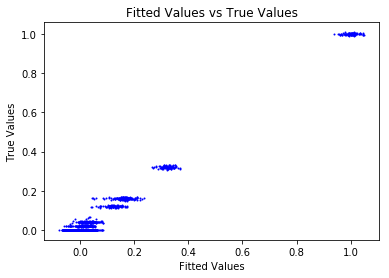

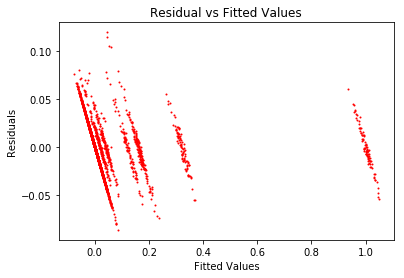

('Workflow ID: ', 'work_flow_4')


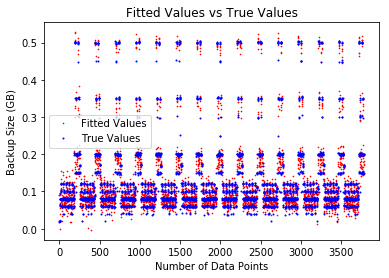

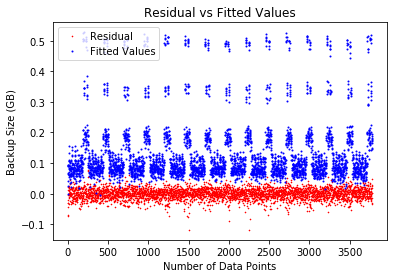

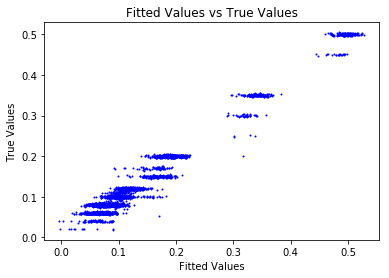

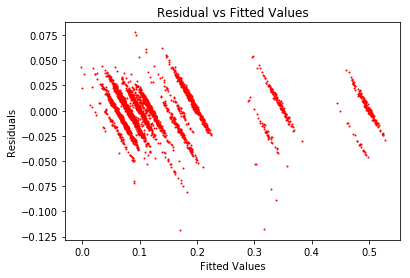

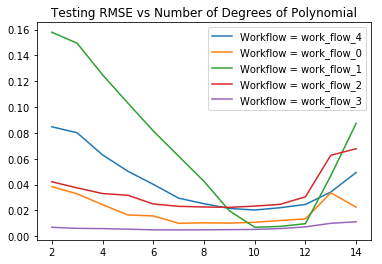

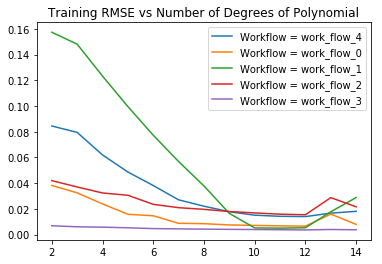

In [32]:
from sklearn.preprocessing import PolynomialFeatures
from collections import defaultdict

polyTrainRMSE = defaultdict(list)
polyTestRMSE = defaultdict(list)
degrees = list(range(2, 15))
               
for degree in degrees:
    
    print("Running For Degree: ", degree)
    wf_test_RMSE = list()
    wf_train_RMSE = list()
    for work_flow in df['Work-Flow-ID'].unique():

        #Get the data for this workflow
        df_work_flow = df.loc[df['Work-Flow-ID'] == work_flow]
        del df_work_flow['Backup Time (hour)']
        del df_work_flow['Work-Flow-ID']
        wfMatrix = df_work_flow.as_matrix()

        wfX = wfMatrix[:, 0 : wfMatrix.shape[1] - 1]
        wfy = wfMatrix[:, wfMatrix.shape[1] - 1].astype('float')

        #label encode the entire dataset
        wfX = labelEncoder(wfX)
        poly = PolynomialFeatures(degree=degree)
        wfX = poly.fit_transform(wfX)
        
        print("Workflow ID: ", work_flow)
        wfTrainRMSE, wfTestRMSE, wfPredictions = regression(wfX, wfy, modelName='LinearRegression', plot=True, verbose=False)

        polyTrainRMSE[work_flow].append(wfTrainRMSE)
        polyTestRMSE[work_flow].append(wfTestRMSE)

for wf in polyTestRMSE:
    label = "Workflow = " + str(wf)
    plt.plot(degrees, polyTestRMSE[wf], label=label)
    
plt.title('Testing RMSE vs Number of Degrees of Polynomial')
plt.legend()
plt.show()

for wf in polyTrainRMSE:
    label = "Workflow = " + str(wf)
    plt.plot(degrees, polyTrainRMSE[wf], label=label)
    
plt.title('Training RMSE vs Number of Degrees of Polynomial')
plt.legend()
plt.show()

## KNN Regression

## 2(e) with one hot encoding

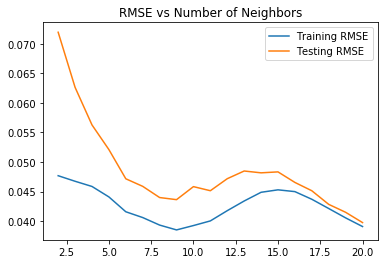

('Best Model for ', 20, 'Neighbours')
('Training MSE for each fold : ', [0.0015387207993034593, 0.0015491532574065706, 0.001558024730439333, 0.001532964658388741, 0.0015315761753508736, 0.001446819421856377, 0.0015833590773436158, 0.0014962062888235152, 0.001531436369030456, 0.0015132261968101026], '\n\n')
('Testing MSE for each fold : ', [0.0015417569257800564, 0.0012819462769335468, 0.0011906132368736016, 0.0016679943395543437, 0.0014628676488194418, 0.002188007401477137, 0.0012684739725153168, 0.001820893036033365, 0.0016295852810999172, 0.0016797840956574526], '\n\n')
('Training RMSE:', 0.039091542531285516)
('Testing RMSE:', 0.03966348725811206)


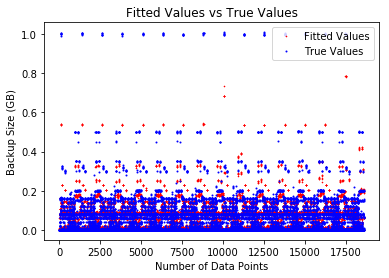

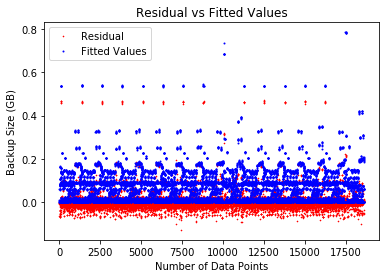

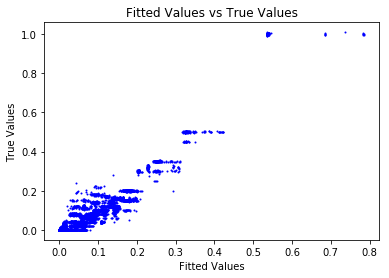

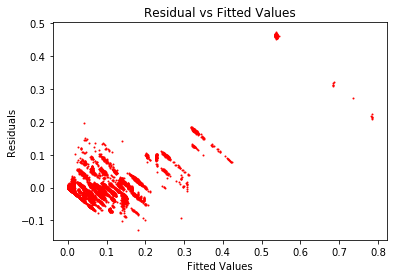

(0.039091542531285516,
 0.03966348725811206,
 array([0.06220905, 0.00240798, 0.00630088, ..., 0.20007292, 0.19240342,
        0.18745441]))

In [33]:
kNNDF = df.copy(deep=True)
del kNNDF['Backup Time (hour)']

kNNMatrix = kNNDF.as_matrix()

kNNX = kNNMatrix[:, 0 : kNNMatrix.shape[1] - 1]
kNNy = kNNMatrix[:, kNNMatrix.shape[1] - 1].astype('float')

#label encode the entire dataset
kNNX = labelEncoder(kNNX)
ohe = OneHotEncoder(sparse=False)

kNNX = ohe.fit_transform(kNNX)

neighbors = list(range(2, 21))
nTrainRMSE = list()
nTestRMSE = list()
bestModel = None
bestRMSE = float(sys.maxsize)
for neighbor in neighbors:
    
    kNNTrainRMSE, kNNTestRMSE, kNNPred = regression(kNNX, kNNy, modelName='KNeighborsRegressor', arg=[neighbor], plot=False, verbose=False)
    
    nTrainRMSE.append(kNNTrainRMSE)
    nTestRMSE.append(kNNTestRMSE)
    
    if kNNTestRMSE < bestRMSE:
        bestModel = neighbor
        bestRMSE = kNNTestRMSE
    
plt.plot(neighbors, nTrainRMSE, label="Training RMSE")
plt.plot(neighbors, nTestRMSE, label="Testing RMSE")
plt.title('RMSE vs Number of Neighbors')
plt.legend()
plt.show()

print("Best Model for ", bestModel, "Neighbours")
regression(kNNX, kNNy, modelName='KNeighborsRegressor', arg=[bestModel], plot=True, verbose=True)

## 2(e) with label encoding

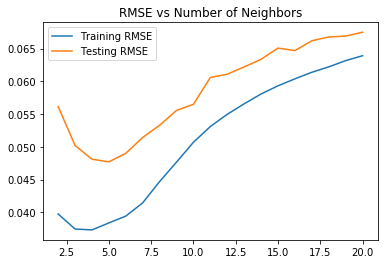

('Best Model for ', 5, 'Neighbours')
('Training MSE for each fold : ', [0.0014585112015865558, 0.001488176641860488, 0.0014604039141543153, 0.0014202595114468416, 0.0014547956272968194, 0.0014548568313676692, 0.0014670331297294854, 0.001565966293768519, 0.001488200960199726, 0.0015186556947124892], '\n\n')
('Testing MSE for each fold : ', [0.0018184390346741076, 0.0030525941435245616, 0.0017800863054355622, 0.002802571271700849, 0.0028905760356397704, 0.002366403450933437, 0.0029162467711607958, 0.0019418726830754385, 0.0014126628737706993, 0.0031761063508179937], '\n\n')
('Training RMSE:', 0.0384406813234663)
('Testing RMSE:', 0.049150339694383816)


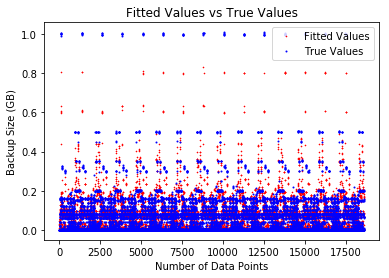

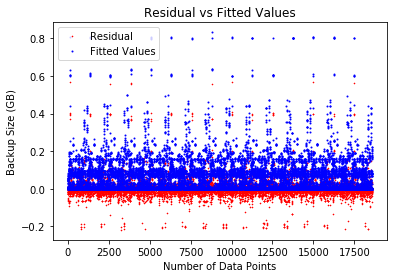

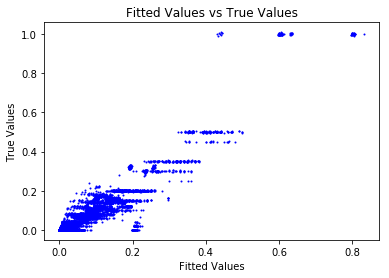

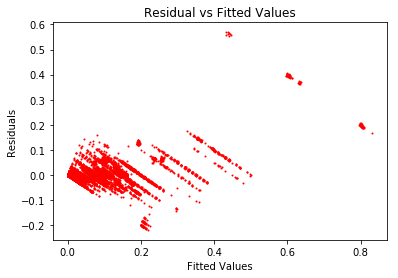

(0.0384406813234663,
 0.049150339694383816,
 array([0.04794777, 0.        , 0.02374277, ..., 0.17482022, 0.16525823,
        0.16956145]))

In [34]:
kNNDF = df.copy(deep=True)
del kNNDF['Backup Time (hour)']

kNNMatrix = kNNDF.as_matrix()

kNNX = kNNMatrix[:, 0 : kNNMatrix.shape[1] - 1]
kNNy = kNNMatrix[:, kNNMatrix.shape[1] - 1].astype('float')

#label encode the entire dataset
kNNX = labelEncoder(kNNX)

neighbors = list(range(2, 21))
nTrainRMSE = list()
nTestRMSE = list()
bestModel = None
bestRMSE = float(sys.maxsize)
for neighbor in neighbors:
    
    kNNTrainRMSE, kNNTestRMSE, kNNPred = regression(kNNX, kNNy, modelName='KNeighborsRegressor', arg=[neighbor], plot=False, verbose=False)
    
    nTrainRMSE.append(kNNTrainRMSE)
    nTestRMSE.append(kNNTestRMSE)
    
    if kNNTestRMSE < bestRMSE:
        bestModel = neighbor
        bestRMSE = kNNTestRMSE
    
plt.plot(neighbors, nTrainRMSE, label="Training RMSE")
plt.plot(neighbors, nTestRMSE, label="Testing RMSE")
plt.title('RMSE vs Number of Neighbors')
plt.legend()
plt.show()

print("Best Model for ", bestModel, "Neighbours")
regression(kNNX, kNNy, modelName='KNeighborsRegressor', arg=[bestModel], plot=True, verbose=True)

## END OF PROJECT